## Germany & neighbors PV Cut Scenario due to Volcanic Eruption with 130 €/t CO2 price. Transmission Expansion is not allowed

In [1]:
import pypsa 
import matplotlib.pyplot as plt
plt.style.use("bmh")
import pandas as pd
from pypsa.plot import add_legend_patches
import gurobipy
import cartopy.crs as ccrs
from pypsa.optimization import optimize
import matplotlib.cm as cm
import numpy as np
import xarray as xr
import seaborn as sns
import os

pd.set_option("display.max_rows", None)  # Display all rows
pd.set_option("display.max_columns", None)  # Display all columns


# Base Scenario

## Import Network

In [2]:
n = pypsa.Network("C:\\Users\\Jeremy\\Documents\\MasterThesis\\Models\\Model_DE\\20240405_20nodes\\elec_s_20_ec_lv1.5_3h.nc")

INFO:pypsa.io:Imported network elec_s_20_ec_lv1.5_3h.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


In [3]:
# add co2price
co2_price = 130 #€/t

for index in n.generators.index:
    emission = n.carriers.co2_emissions.filter(like= n.generators.carrier[index]) #t/MWh_th
    n.generators.at[index,'marginal_cost'] = n.generators.at[index,'marginal_cost'] + (emission * co2_price/n.generators.at[index,'efficiency']) # €/MWhel

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18236\3184507867.py:6: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  n.generators.at[index,'marginal_cost'] = n.generators.at[index,'marginal_cost'] + (emission * co2_price/n.generators.at[index,'efficiency']) # €/MWhel


In [4]:
for c in n.iterate_components(list(n.components.keys())[2:]):
    print("Component '{}' has {} entries".format(c.name,len(c.df)))

Component 'Bus' has 20 entries
Component 'Carrier' has 21 entries
Component 'GlobalConstraint' has 1 entries
Component 'Line' has 27 entries
Component 'LineType' has 34 entries
Component 'TransformerType' has 14 entries
Component 'Link' has 28 entries
Component 'Load' has 20 entries
Component 'Generator' has 261 entries
Component 'StorageUnit' has 65 entries


In [5]:
#remove nuclear fleet from germany
n.generators.loc[n.generators.index.str.startswith('DE') & n.generators.index.str.endswith('nuclear'), 'p_nom'] = 0


In [6]:
# set marginal cost of load shedding to 3000€/MWh
for bus in n.generators.bus:
    for index in n.generators.index:
        if not bus.endswith('H2') and index.endswith('load'):
            n.generators.loc[index, 'marginal_cost'] = 3000

#edit load shedding's unit from kW to MW
for index in n.generators.index:
    if index.endswith('load') and not index.endswith('H2 load'):
        n.generators.loc[index, 'sign'] = 1

#### Import solved model, if no changes to the model have been made

In [7]:
def import_nc_file(directory, filename):
    # Construct the full path to the .nc file
    file_path = os.path.join(directory, filename)
    
    # Open the NetCDF file using xarray
    ds = pypsa.Network(file_path)
    
    return ds
directory = os.getcwd()
dir = 'c:\\Users\\Jeremy\\Documents\\MasterThesis\\Models\\Model_DE\\20240405_20nodes'


In [8]:
#solve network
#n.optimize(solver_name='gurobi')
filename = "base_DE_20nodes_1.0_solved.nc"
n = import_nc_file(dir, filename)
contingency = 'pv'
n.name = f'base_{contingency}'

INFO:pypsa.io:Imported network base_DE_20nodes_1.0_solved.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


### Export model for later use

In [9]:
#file = "base_DE_20nodes_1.0_solved.nc"
#output_path = os.path.join(dir, file)

#n.export_to_netcdf(output_path)

In [10]:
def system_cost(n): #n.statistics.capex()
    stat = n.statistics()
    tsc = stat['Capital Expenditure'] + stat['Operational Expenditure']
    return tsc.droplevel(0).div(1e6) # million €/a

In [11]:
tot_cos_base=n.objective/1e9
system_cost_base = system_cost(n)
marg_price_region_base = n.buses_t.marginal_price.mean()
stat_base = n.statistics()

## Plot Network

<function matplotlib.pyplot.show(close=None, block=None)>

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '
c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '
c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


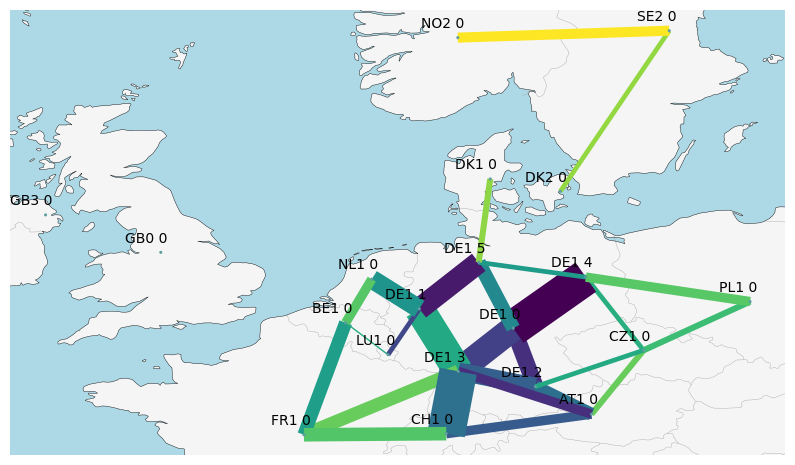

In [12]:
loading = (n.lines_t.p0.abs().mean().sort_index()/(n.lines.s_nom_opt*n.lines.s_max_pu).sort_index()).fillna(0.)

fig, ax = plt.subplots(
    figsize=(10,10),
    subplot_kw={"projection": ccrs.PlateCarree()}
)

n.plot(
    ax=ax,
    branch_components=["Line"],
    line_widths=n.lines.s_nom_opt/1e3, #GW
    line_colors=loading,
    line_cmap=plt.cm.viridis,
    color_geomap=True,
    bus_sizes=0.003
)

bus = n.buses
region = []
for index, row in bus.iterrows():
    x = row['x']
    y = row['y']
    if "H2" in index:
        pass
    else:
        region.append(index)
        ax.annotate(
        index,
        xy=(x, y),
        xytext=(5, 5),  # Adjust the position of the annotation
        textcoords="offset points",
        ha='right', va='bottom'
    )

plt.show


## Installed Capacity Map Plot

In [13]:
#color list for installed cap
tech_list = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().unstack().columns.tolist()
tech_list.remove('load')
color_cap = []

for i in range(len(tech_list)):
    for j in range(len(n.carriers.index)):
        if tech_list[i] == n.carriers.index[j]:
            color_cap.append(n.carriers.color[j])
            break  # break the inner loop once a match is found  

cap = n.generators[n.generators['carrier']!='load'].groupby(['bus', 'carrier']).p_nom_opt.sum()

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18236\3847545614.py:9: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  color_cap.append(n.carriers.color[j])


c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


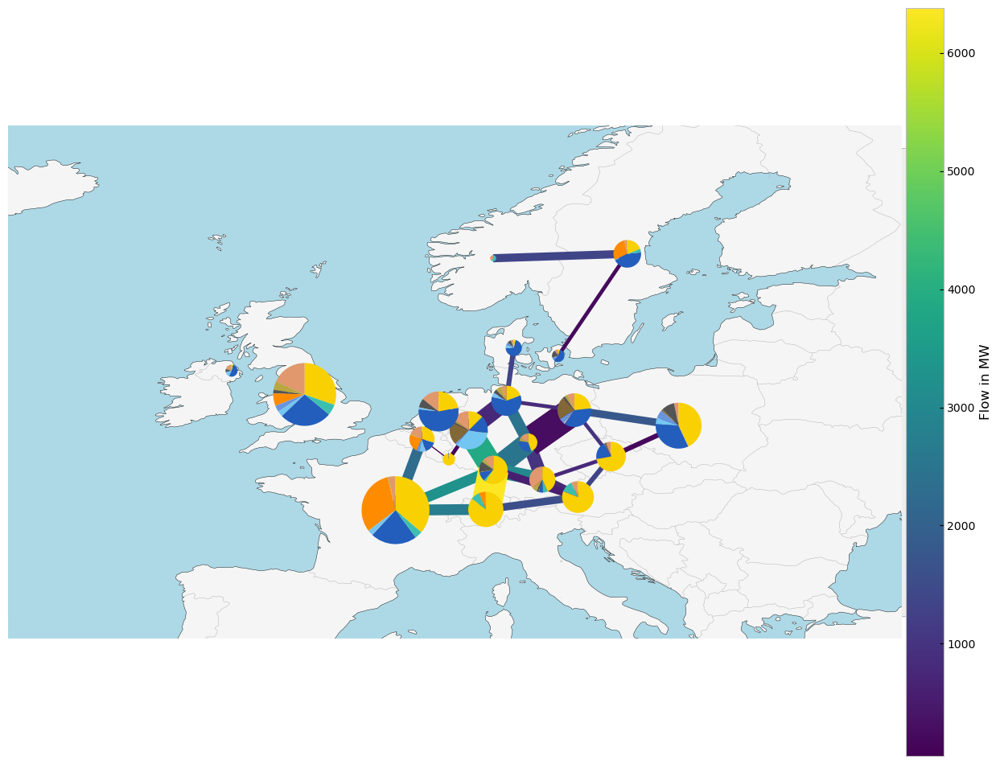

In [14]:
fig, ax = plt.subplots(
    figsize=(15,15),
    subplot_kw={"projection": ccrs.PlateCarree()}
)

collection = n.plot(
    bus_sizes=cap / 5e4,
    bus_colors = color_cap,
    margin=0.5,
    #flow="mean",
    line_widths=n.lines.s_nom_opt/1e3, #GW
    link_widths=0,
    color_geomap=True,
    line_colors=n.lines_t.p0.mean().abs(),
)
        
plt.colorbar(collection[2], fraction=0.04, pad=0.004, label="Flow in MW")
plt.show()

## Generation Map Plot

In [15]:
#color list for energy generated 
tech_list_gen_table = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().unstack().columns.tolist()
colors_gen_table = []

for i in range(len(tech_list_gen_table)):
    for j in range(len(n.carriers.index)):
        if tech_list_gen_table[i] == n.carriers.index[j]:
            colors_gen_table.append(n.carriers.color[j])
            break  # break the inner loop once a match is found 

#Adjust Load shedding's unit to MW from kW
#for column in n.generators_t.p.columns:
#    if column.endswith('load') and not column.endswith('H2 load'):
#        n.generators_t.p[column]/=1e3
        

gen = n.generators.assign(g=n.generators_t.p.mean()).groupby(["bus", "carrier"]).g.sum()

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18236\971004373.py:8: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_gen_table.append(n.carriers.color[j])


c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


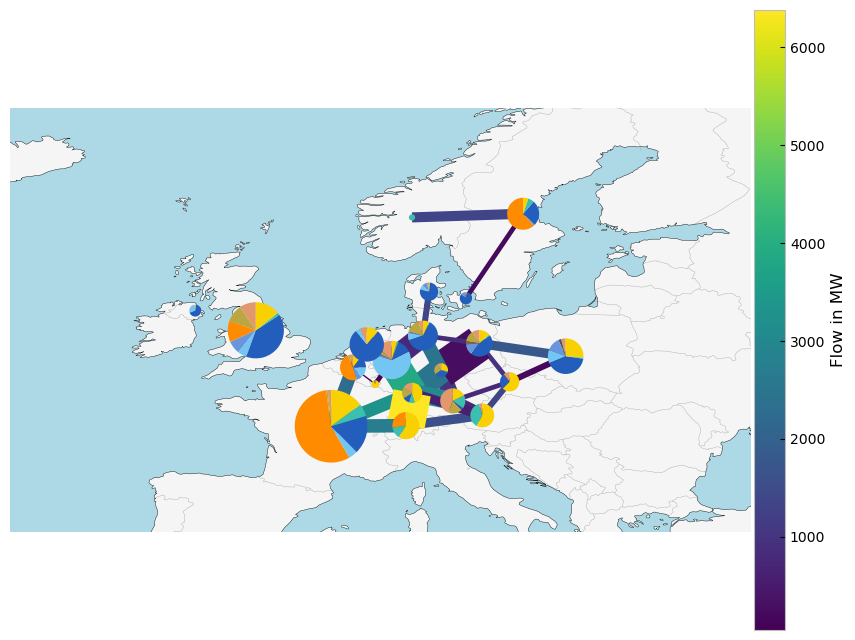

In [16]:
carriers = n.generators.carrier.unique()

plt.figure(figsize =(10,10))

collection = n.plot(
    bus_sizes=gen / 1e4,
    bus_colors = colors_gen_table,
    margin=0.5,
    #flow="mean",
    line_widths=n.lines.s_nom_opt/1e3, #GW
    link_widths=0,
    color_geomap=True,
    line_colors=n.lines_t.p0.mean().abs(),
)
plt.colorbar(collection[2], fraction=0.04, pad=0.004, label="Flow in MW")
plt.show()

## Installed Capacity

<Figure size 640x480 with 0 Axes>

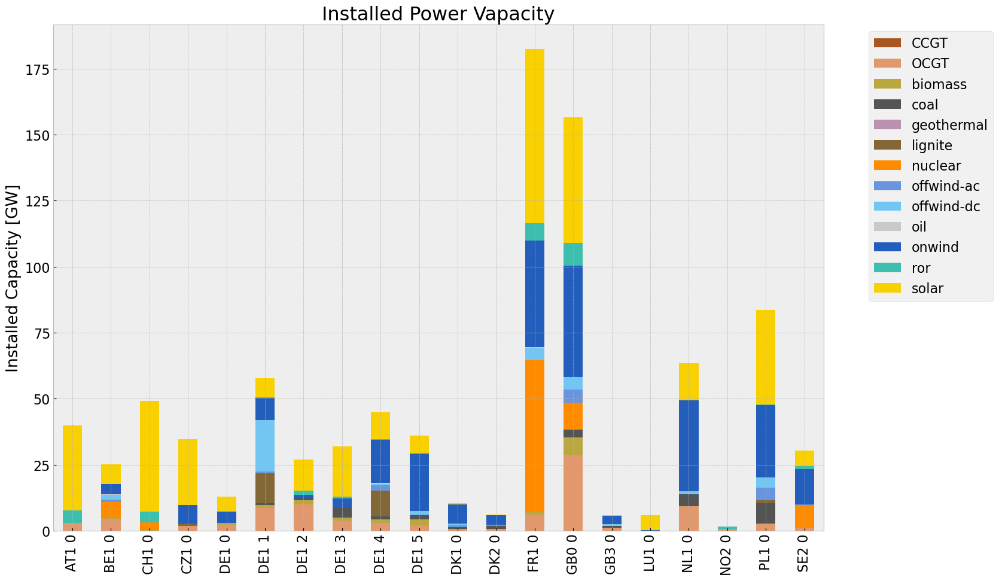

In [17]:
def inst_cap_table(n,colors):

    capacities = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
    capacities.fillna(0, inplace=True)
    gen = (capacities.unstack()/1000).drop(columns=['load'],inplace=False)
    gen.fillna(0, inplace=True)

    plt.figure()
    plt.rcParams.update({'font.size': 16})

    gen.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=colors,
                                grid=True,
                                xlabel="",
                                ylabel="Installed Capacity [GW]",
                                title=f"Installed Power Vapacity"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

     # Save plot to the current working directory
    filename = f"{n.name}_installed_cap.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
    
    plt.show()

    

    return capacities

# consolidated istalled cap without load_shedding

#capacities_base = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_base.fillna(0, inplace=True)
#gen = (capacities_base.unstack()/1000).drop(columns=['load'],inplace=False)

capacities_base = inst_cap_table(n, color_cap)

<Figure size 640x480 with 0 Axes>

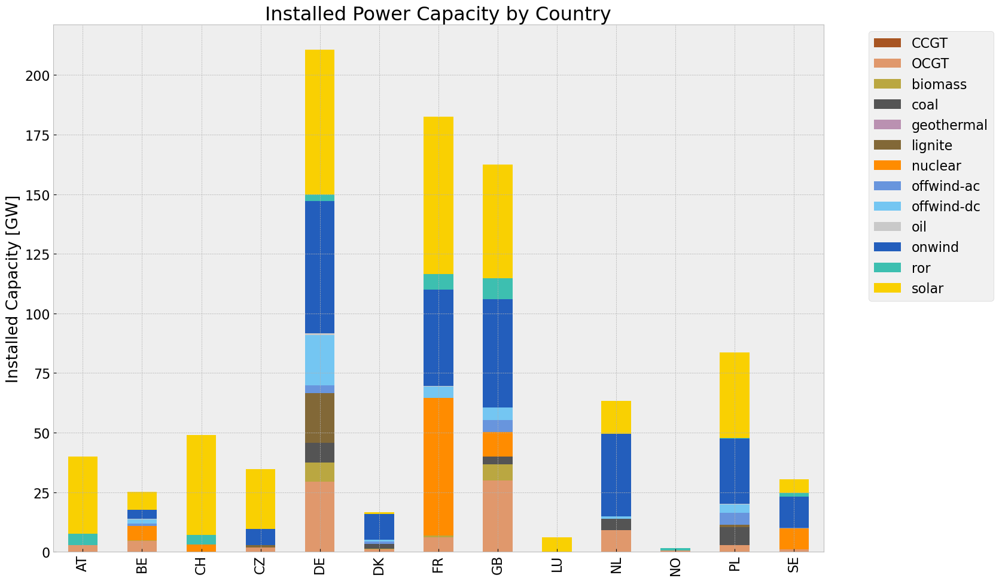

In [18]:
#aggregate installed capacities by country
def inst_cap_table_country(n,colors):
    
    model = n
    capacities = model.generators
    capacities['country'] = capacities['bus'].str[:2]
    capacities = capacities.groupby(['country', 'carrier']).p_nom_opt.sum()
    capacities.fillna(0, inplace=True)
    gen = (capacities.unstack()/1000).drop(columns=['load'],inplace=False)
    gen.fillna(0, inplace=True)

    plt.figure()
    plt.rcParams.update({'font.size': 16})

    gen.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=colors,
                                grid=True,
                                xlabel="",
                                ylabel="Installed Capacity [GW]",
                                title=f"Installed Power Capacity by Country"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

    # Save plot to the current working directory
    filename = f"{n.name}_installed_cap_country.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)

    plt.show()
    
     

    return gen

cap_base_country= inst_cap_table_country(n, color_cap)

## Generation

<Figure size 640x480 with 0 Axes>

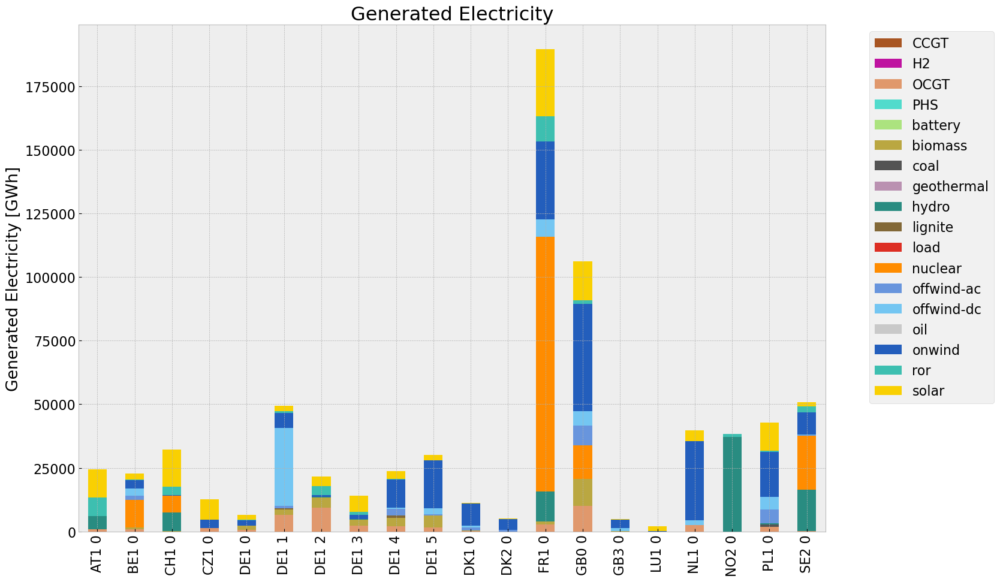

In [19]:
def gen_power_table(n):

    carrier_gen = list(n.generators.carrier.unique())
    carrier_sto = list(n.storage_units.carrier.unique())
    carrier = carrier_gen + carrier_sto

    gen_df = n.generators[["carrier","bus","p_nom_opt"]]
    sto_df = n.storage_units[["carrier","bus","p_nom_opt"]]
    tot_df = pd.concat([gen_df, sto_df])
    tot_series = pd.Series(index = tot_df.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

    gen_sto = n.storage_units_t.p.sum()
    gen_gen = n.generators_t.p.sum()
    gen = pd.concat([gen_sto, gen_gen])
    gen = gen.clip(lower=0)

    for r in region:
            for tech in carrier:
                key = f"{r} {tech}"
                if key in gen.index:
                    try:
                        tot_series.loc[r, tech] = gen[key]
                    #print(generations.loc[r, tech])
                    except KeyError:
                        print('error')
    #tot_series.fillna(0, inplace=True)

    tot_df = (tot_series.unstack()/1000)
    tot_df.fillna(0,inplace = True)

    #define color dict for tech
    color_dict = {}

    for index, row in n.carriers.iterrows():
        key = index
        value = row['color']
        color_dict[key] = value

    #color list
    colors = [color_dict[cat] for cat in tot_df.columns]

    plt.figure()
    plt.rcParams.update({'font.size': 16})

    tot_df.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=colors,
                                grid=True,
                                xlabel="",
                                ylabel="Generated Electricity [GWh]",
                                title=f"Generated Electricity"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

     # Save plot to the current working directory
    filename = f"{n.name}_gen_elec.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)

    plt.show()

    return tot_df

gen_base = gen_power_table(n)

<Figure size 640x480 with 0 Axes>

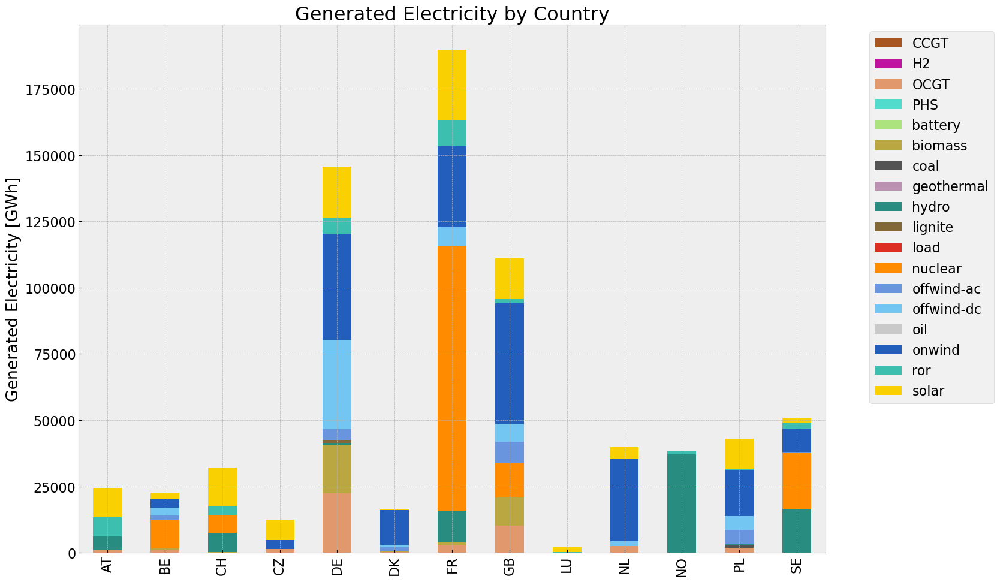

In [20]:
def gen_power_table_country(n):

    carrier_gen = list(n.generators.carrier.unique())
    carrier_sto = list(n.storage_units.carrier.unique())
    carrier = carrier_gen + carrier_sto

    gen_df = n.generators[["carrier","bus","p_nom_opt"]]
    sto_df = n.storage_units[["carrier","bus","p_nom_opt"]]
    tot_df = pd.concat([gen_df, sto_df])
    tot_series = pd.Series(index = tot_df.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

    gen_sto = n.storage_units_t.p.sum()
    gen_gen = n.generators_t.p.sum()
    gen = pd.concat([gen_sto, gen_gen])
    gen = gen.clip(lower=0)

    for r in region:
            for tech in carrier:
                key = f"{r} {tech}"
                if key in gen.index:
                    try:
                        tot_series.loc[r, tech] = gen[key]
                    #print(generations.loc[r, tech])
                    except KeyError:
                        print('error')
    #tot_series.fillna(0, inplace=True)

    tot_df = (tot_series.unstack()/1000)
    tot_df.fillna(0,inplace = True)


    
    tot_df['country'] = tot_df.index.str[:2]
    tot_df = tot_df.groupby(['country']).sum()   
    #generations['load']/=1e3

    #define color dict for tech
    color_dict = {}

    for index, row in n.carriers.iterrows():
        key = index
        value = row['color']
        color_dict[key] = value

    #color list
    colors = [color_dict[cat] for cat in tot_df.columns]


    plt.figure()
    plt.rcParams.update({'font.size': 16})

    tot_df.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=colors,
                                grid=True,
                                xlabel="",
                                ylabel="Generated Electricity [GWh]",
                                title=f"Generated Electricity by Country"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

    # Save plot to the current working directory
    filename = f"{n.name}_gen_elec_country.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)


    plt.show()
    return tot_df

gen_base_country = gen_power_table_country(n)

## Snapshot

In [21]:
sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
tech_list_gen = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum()

#links = n.links_t.p0.groupby(n.links.carrier, axis =1).sum().drop(['DC','H2 electrolysis'], axis=1, inplace =False).head()
tech_list_gen = pd.concat([tech_list_gen, sto], axis=1).columns.tolist()

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18236\318663498.py:1: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18236\318663498.py:2: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  tech_list_gen = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum()


In [22]:
colors_gen = []

for i in range(len(tech_list_gen)):
    for j in range(len(n.carriers.index)):
        if tech_list_gen[i] == n.carriers.index[j]:
            colors_gen.append(n.carriers.color[j])
            break  # break the inner loop once a match is found  

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18236\4040974225.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_gen.append(n.carriers.color[j])


In [23]:
def gen_curve(n, start, end, colors,ctr):

    plt.rcParams.update({'font.size': 16})

    #import export 
    lines_ctr_bus0 = n.lines[n.lines['bus0'].str.startswith(ctr) & ~n.lines['bus1'].str.startswith(ctr)].index
    lines_ctr_bus1 = n.lines[n.lines['bus1'].str.startswith(ctr) & ~n.lines['bus0'].str.startswith(ctr)].index
    links_ctr_bus0 = n.links[n.links['bus0'].str.startswith(ctr) & ~n.links['bus1'].str.startswith(ctr)].index
    links_ctr_bus1 = n.links[n.links['bus1'].str.startswith(ctr) & ~n.links['bus0'].str.startswith(ctr)].index


    df_lines_ctr_bus0 = n.lines_t.p0[lines_ctr_bus0]
    df_lines_ctr_bus1 = n.lines_t.p1[lines_ctr_bus1]
    df_links_ctr_bus0 = n.links_t.p0[links_ctr_bus0]
    df_links_ctr_bus1 = n.links_t.p1[links_ctr_bus1]


    import_export = pd.concat([df_lines_ctr_bus0, df_lines_ctr_bus1, df_links_ctr_bus0, df_links_ctr_bus1], axis=1).sum(axis=1)*-1 #MW

    columns_gen = [col for col in  n.generators_t.p.columns if col.startswith(ctr)]
    p_country = n.generators_t.p[columns_gen]

    p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
    

    #add import color
    colors.append('#133337') #for Import

    #p_by_carrier['load'] /= 1e3

    #links fuel cell
    #links = n.links_t.p1.groupby(n.links.carrier, axis=1).sum().div(1e3)
    #links = links.drop(columns='DC', inplace=False)
    #links['H2 fuel cell']*=-1
       
    # join generator, lines, links, and storage unit
    if not n.storage_units.empty:
        col_sto = [col for col in  n.storage_units_t.p.columns if col.startswith(ctr)]
        sto_ctr = n.storage_units_t.p[col_sto]
        sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW     
        p_by_carrier = pd.concat([p_by_carrier, sto], axis=1)
        p_by_carrier['Import/Export'] = import_export 
        p_by_carrier = p_by_carrier.div(1e3) #GW
        
    p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')

    start_date = start
    end_date = end
    
    # Create a date range for the specified time range
    time = pd.date_range(start=start_date, end=end_date, freq='3H')
    
    fig, ax = plt.subplots(figsize=(20, 10))
    
    #p_no_H = p_by_carrier.drop(columns = 'H2 electrolysis', inplace = False)
    p_by_carrier.where(p_by_carrier>0).loc[time].plot.area(
        ax=ax,
        linewidth=0,
        color=colors,
        grid=True,

    )
    
    charge = p_by_carrier.where(p_by_carrier<0).dropna(how='all', axis=1).loc[time]
    
    
    if not charge.empty:

        charge.plot.area(
            ax=ax,
            linewidth=0,
            color=["yellowgreen", "magenta", "purple", "grey"],
            grid=True,
        )
    
    col_load = [col for col in  n.loads_t.p_set.columns if col.startswith(ctr)]
    loads_ctr = n.loads_t.p_set[col_load]
    loads = loads_ctr.sum(axis=1).div(1e3)
    loads.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
    
    loads.loc[time].plot(ax=ax, c='k',grid=True)


    plt.legend(loc=(1.05,0))
    
    ax.set_ylabel("Power [GW]")
    ax.set_title(f"Hourly Electricity Production")
    ax.set_ylim(-50,150)
    # Save plot to the current working directory
    fig.tight_layout()
    filename = f"{n.name}_gen_{start}_to_{end}.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)


    
    

In [24]:
#e_balance = n.statistics.energy_balance(aggregate_time=False, aggregate_bus=False).loc[:, :, "AC",:].droplevel(2)
#e_balance.to_excel('energybalance.xlsx', index=True) 


In [25]:
#tes = n.statistics.energy_balance(aggregate_time=False, aggregate_bus=False).loc[:, :, "AC", :].droplevel(2)
#tes.to_csv('energybalance.csv', index=True)

In [26]:
#n.loads_t.p_set.sum(axis=1).loc[pd.date_range(start='2013-01-08', end='2013-01-14', freq='3H')].div(1e3).plot(ax=ax, c='k',grid=True)


In [27]:
#p_by_carrier.where(p_by_carrier>0).loc[pd.date_range(start='2013-01-08', end='2013-01-14', freq='3H')].sum(axis=1)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18236\3440809909.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18236\3440809909.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18236\3440809909.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18236\3440809909.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='3H')
c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pandas\plotting\_matplotlib\core.py:1794: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  ax.set_ylim(None, 0)
C:\Users\Jeremy\AppDa

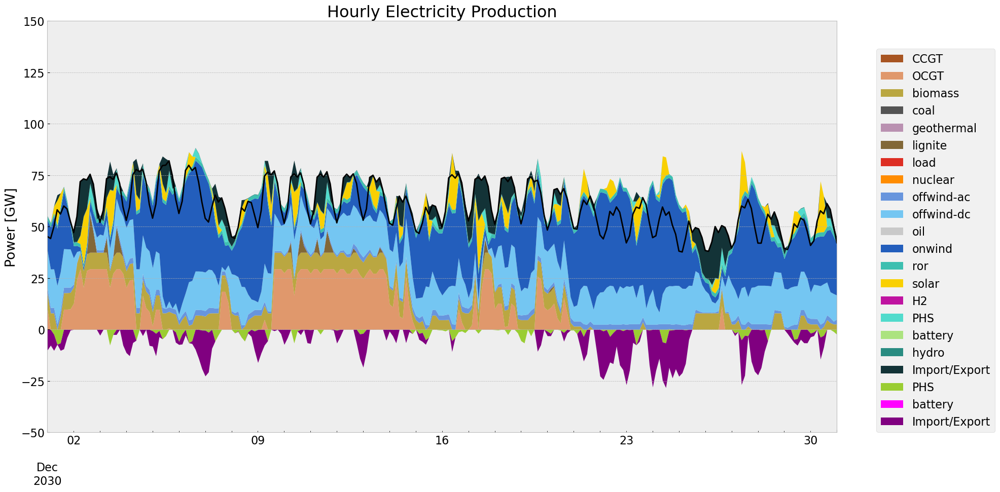

In [28]:
# winter
gen_curve(n, '2030-12-01', '2030-12-31', colors_gen,'DE')

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18236\3440809909.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18236\3440809909.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18236\3440809909.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18236\3440809909.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='3H')
c:\Users\

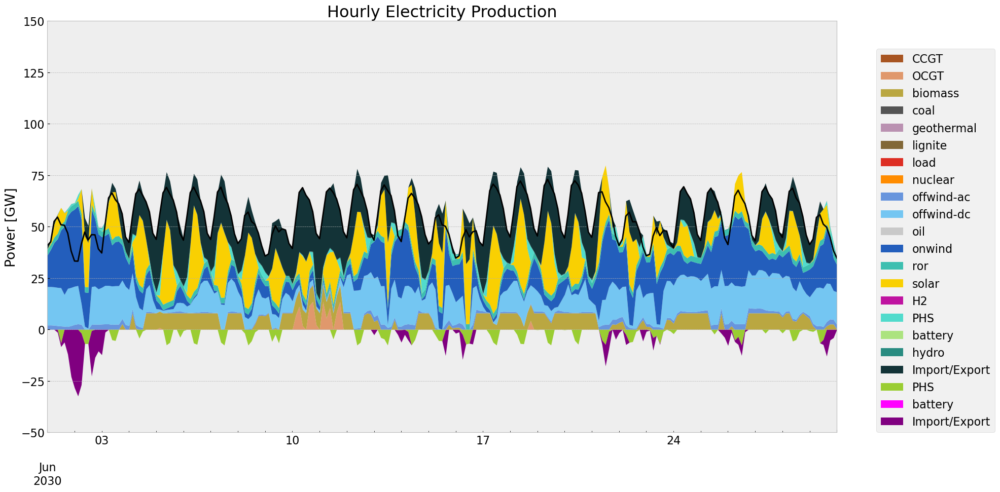

In [29]:
#summer
gen_curve(n, '2030-06-01', '2030-06-30', colors_gen,'DE')

In [30]:
def gen_curve_tot(n, start, end, colors):

    plt.rcParams.update({'font.size': 16})

    p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
    
    # join generator, lines, links, and storage unit
    if not n.storage_units.empty:
        sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW     
        p_by_carrier = pd.concat([p_by_carrier, sto], axis=1)
        p_by_carrier = p_by_carrier.div(1e3) #GW
        
    p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')

    start_date = start
    end_date = end
    
    # Create a date range for the specified time range
    time = pd.date_range(start=start_date, end=end_date, freq='3H')
    
    fig, ax = plt.subplots(figsize=(20, 10))
    
    #p_no_H = p_by_carrier.drop(columns = 'H2 electrolysis', inplace = False)
    p_by_carrier.where(p_by_carrier>0).loc[time].plot.area(
        ax=ax,
        linewidth=0,
        color=colors,
        grid=True,

    )
    
    charge = p_by_carrier.where(p_by_carrier<0).dropna(how='all', axis=1).loc[time]
    
    
    if not charge.empty:

        charge.plot.area(
            ax=ax,
            linewidth=0,
            color=["yellowgreen", "magenta", "purple", "grey"],
            grid=True,
        )
    
    loads = n.loads_t.p_set.sum(axis=1).div(1e3)
    loads.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
    
    loads.loc[time].plot(ax=ax, c='k',grid=True)


    plt.legend(loc=(1.05,0))
    ax.set_ylim(-50,370)
    fig.tight_layout()

    # Adjust the spacing around the plot (add extra space at the top)
    fig.subplots_adjust(top=0.95, right=0.85, left = 0.05)
    
    ax.set_ylabel("Power [GW]")
    ax.set_title(f"Hourly Electricity Production")

    filename = f"{n.name}_gen_{start}_to_{end}_total.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    
    plt.savefig(output_path)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18236\2535220694.py:5: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18236\2535220694.py:9: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18236\2535220694.py:13: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18236\2535220694.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, fr

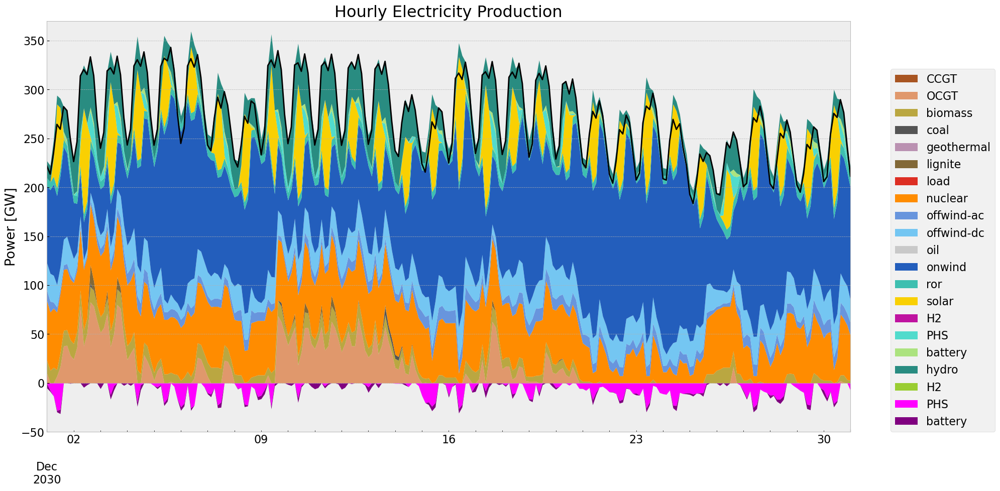

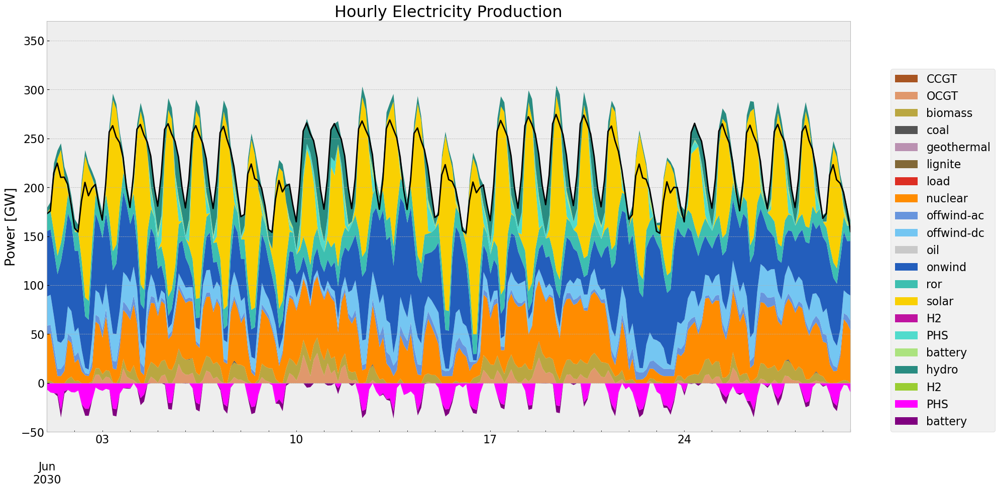

In [31]:
#generation curve all countries
#winter
gen_curve_tot(n, '2030-12-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n, '2030-06-01', '2030-06-30', colors_gen)

## Storage

In [32]:
def inst_store_table(n):
    
    plt.rcParams.update({'font.size': 16})
    storage = n.storage_units
    storage['country'] = storage['bus'].str[:2]

    (storage.groupby(['country','carrier']).p_nom_opt.sum().unstack()/1000).plot.bar(figsize=(17,10),
                                stacked=True,
                                color=["#bf13a0","#51dbcc","#ace37f","#298c81"],
                                grid=True,
                                xlabel="",
                                ylabel="Installed capacity [GW]",
                                title=f"Installed Power Capacity of Storage Systems By Country",
                                #ylim=[0,20]
    )
    store = storage.groupby(['country','carrier']).p_nom_opt.sum()/1000 #GW
    store.fillna(0, inplace=True)

    plt.tight_layout()

    filename = f"{n.name}_installed_storage.png" if hasattr(n, 'name') else "installed_storage.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
    
    return store

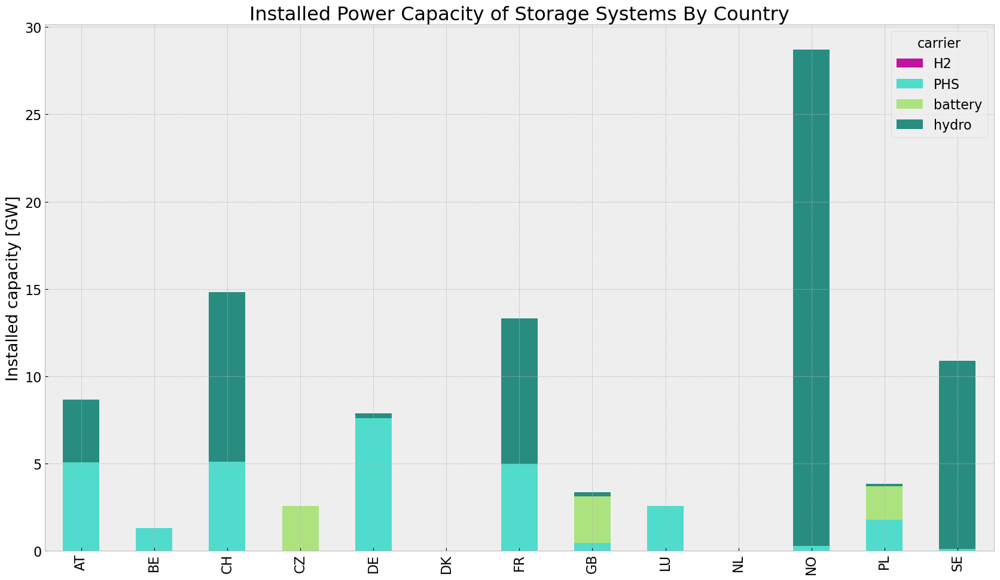

In [33]:
store_base = inst_store_table(n)

In [34]:
def state_of_charge_plot(n, start_date, end_date):
    
    soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)

    soc.index = pd.date_range(start= '2030-01-01 00:00' , end= '2030-12-31 21:00', freq='3H')

    plt.rcParams.update({'font.size': 16})

    fig, ax = plt.subplots(figsize=(17,10))

    time = pd.date_range(start= start_date , end= end_date, freq='3H')

    soc.loc[time].plot(ax=ax,
        grid=True,
        ylabel="State of charge [GWh]",
        xlabel="Time",
        title=f"State of charge of Storage Systems",
        linewidth=1.5,
    )
    plt.tight_layout()
    filename = f"{n.name}_soc.png" if hasattr(n, 'name') else "soc.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)



plt.show(n)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18236\3440348564.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18236\3440348564.py:5: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  soc.index = pd.date_range(start= '2030-01-01 00:00' , end= '2030-12-31 21:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18236\3440348564.py:11: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start= start_date , end= end_date, freq='3H')


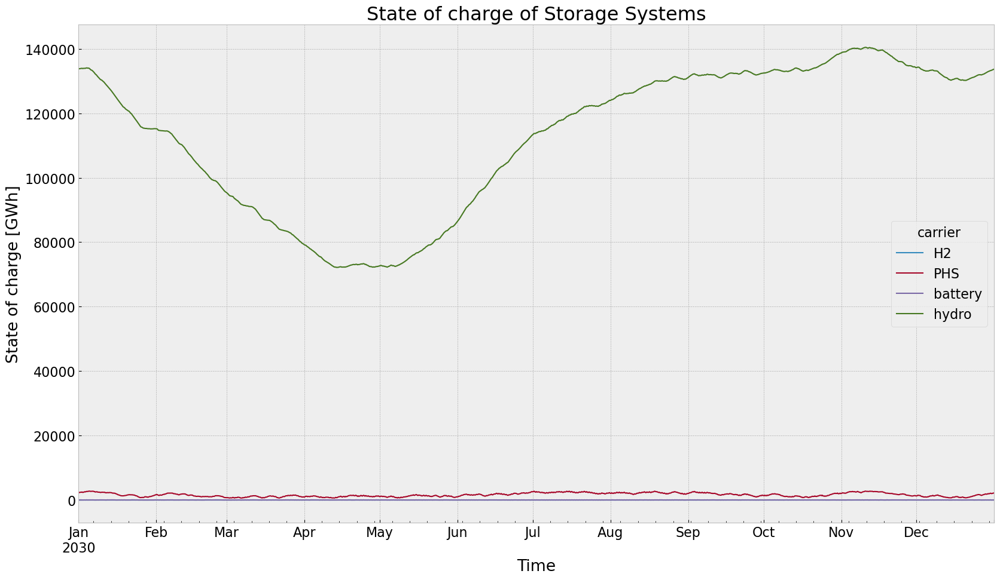

In [35]:
state_of_charge_plot(n, '2030-01-01 00:00', '2030-12-31 21:00')

## Electricity Price

In [36]:
def price_dur_curve_plot(n):

    #buses without store
    columns_to_keep =[]

    for i in n.buses_t.marginal_price.columns.tolist():
        if not i.endswith('H2'):
            columns_to_keep.append(i)
    
    price_dur_curve = pd.DataFrame()
    for region in columns_to_keep:
        price_dur_curve[region] = n.buses_t.marginal_price[region].sort_values(ascending=False).reset_index(drop=True)

    plt.rcParams.update({'font.size': 16})

    fig, ax = plt.subplots(figsize=(17,10))

    price_dur_curve.plot(ax=ax,
                    grid=True,
                    ylabel="Marginal price [€/MWh]",
                    xlabel="Time steps",
                    title=f"Duration curves of the marginal price",
                    linewidth=3,
)
    plt.tight_layout()
    filename = f"{n.name}_pd_curve.png" if hasattr(n, 'name') else "pd_curve.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
plt.show()

In [37]:
#columns_to_keep =[]

#for i in n.buses_t.marginal_price.columns.tolist():
    #if not i.endswith('H2'):
        #columns_to_keep.append(i)

#buses without store
#columns_to_keep =[]

#price_dur_curve = pd.DataFrame()
#for region in columns_to_keep:
    #price_dur_curve[region] = n.buses_t.marginal_price[region].sort_values(ascending=False).reset_index(drop=True)


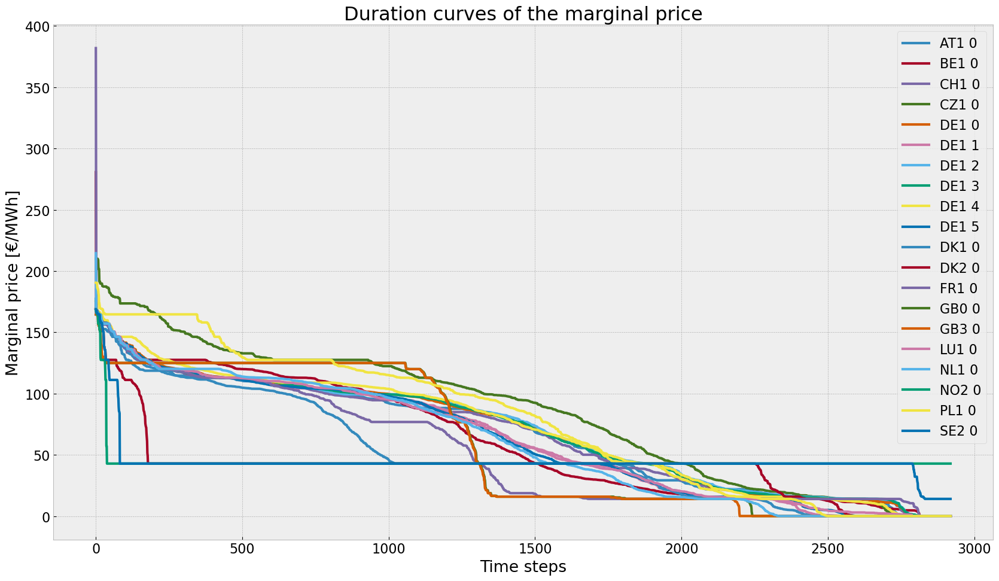

In [38]:
price_dur_curve_plot(n)

In [39]:
#demand weighted average electricity price
def price_regions_table(n):

    plt.rcParams.update({'font.size': 16})

    fig, ax = plt.subplots(figsize=(17,10))
    
    price_df = pd.Series(dtype='float64')

    for price_index in n.buses_t.marginal_price.columns:
        for load_index in  n.loads_t.p_set.columns:
            if price_index == load_index:
                sumweight = (n.buses_t.marginal_price[price_index]*n.loads_t.p_set[load_index]).sum()
                weight = n.loads_t.p_set[load_index].sum()
                weighted_eprice = sumweight/weight
                price_df[price_index] = weighted_eprice

    
    price_df.plot.bar(ax=ax,
                    grid=True,
                    ylabel="Marginal price [€/MWh]",
                    xlabel="Region",
                    title=f"Demand-Weighted Average Marginal Price",
                    linewidth=3,
    )
    fig.tight_layout()                
    filename = f"{n.name}_average_eprice.png" if hasattr(n, 'name') else "pd_curve.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)                                    
    


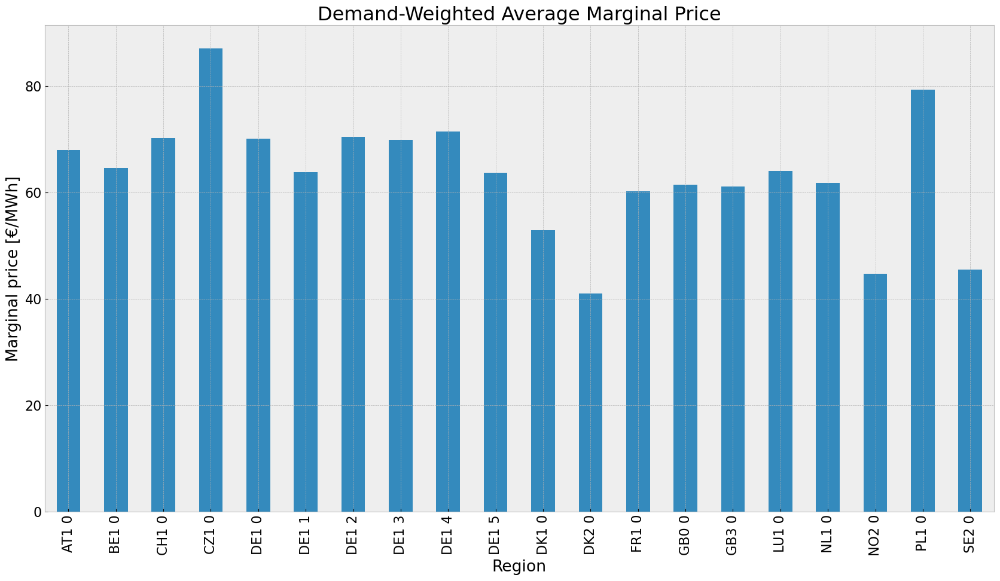

In [40]:
price_regions_table(n)

In [41]:
def price_regions(n):
    # Assuming 'n.buses_t.marginal_price' returns a DataFrame or similar structure with 'mean()' method

    price_df = pd.Series(dtype='float64')

    for price_index in n.buses_t.marginal_price.columns:
        for load_index in  n.loads_t.p_set.columns:
            if price_index == load_index:
                sumweight = (n.buses_t.marginal_price[price_index]*n.loads_t.p_set[load_index]).sum()
                weight = n.loads_t.p_set[load_index].sum()
                weighted_eprice = sumweight/weight
                price_df[price_index] = weighted_eprice

    #hprice = mean_p.filter(like='H2')
    #eprice = mean_p.drop(hprice.index)

    # Setup figure and subplots with 1 row and 2 columns
    fig, ax = plt.subplots(subplot_kw={"projection": ccrs.PlateCarree()}, figsize=(8, 8))

    # Plot for eprice
    hb= plt.hexbin(
        n.buses.x,
        n.buses.y,
        gridsize=20,
        C=price_df,
        cmap=plt.cm.jet,
        zorder=3,
    )

    n.plot(ax=ax, line_widths=pd.Series(0.5, n.lines.index), bus_sizes=0)  # Plot network on the second subplot

    ax.set_title("Demand-Weighted Average Marginal Price")
    
    cb = fig.colorbar(hb, ax=ax, location='bottom')
    cb.set_label("Mean Electricity Marginal Price (EUR/MWh)")

    fig.tight_layout()
    filename = f"{n.name}_price_map.png" if hasattr(n, 'name') else "pd_curve.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
    

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


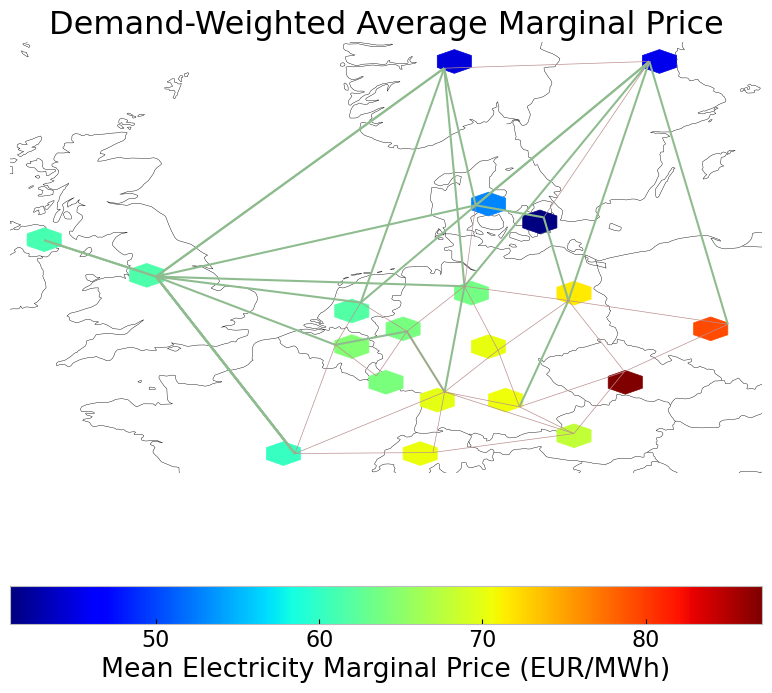

In [42]:
price_regions(n)

## Emission

In [43]:
def em_table(n):
    carrier = n.generators.carrier.unique()
    df_tot_generation = n.generators_t.p.sum()

    generations = pd.Series(index = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

    for r in region:
        for tech in carrier:
            key = f"{r} {tech}"
            if key in df_tot_generation.index:
                try:
                    generations.loc[r, tech] = df_tot_generation[key]
                    #print(generations.loc[r, tech])
                except KeyError:
                    print('error')
    generations.fillna(0, inplace=True)

    generations = (generations.unstack())#MWh

    #mean efficiency of each carrier
    eff = n.generators.groupby('carrier').efficiency.mean()

    e = generations.sum()
    emission = []

    for index in e.index:
        for index_c in n.carriers.index:
            for index_eff in eff.index:
                if index == index_c == index_eff:
                    em = n.carriers.loc[index_c,"co2_emissions"]
                    emission.append(em)

    df = e.to_frame()
    df.rename(columns={0: 'Generation in MWh'}, inplace=True)
    df['efficiency'] = eff
    df['emissions in Tonnes CO2/MWh'] = emission
    df['emissions in Tonnes CO2']= df['Generation in MWh']/df['efficiency']*df['emissions in Tonnes CO2/MWh']
    df['emissions in Tonnes CO2'].sum() 
    return df

em_base =em_table(n)
em_base

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000e+00
OCGT,4.314198e+07,0.451621,0.1980,1.891434e+07
biomass,3.094121e+07,0.468000,0.0000,0.000000e+00
coal,1.288390e+06,0.329908,0.3361,1.312572e+06
geothermal,0.000000e+00,1.000000,0.1200,0.000000e+00
lignite,1.347177e+06,0.337285,0.4069,1.625233e+06
load,0.000000e+00,1.000000,0.0000,0.000000e+00
nuclear,1.518514e+08,0.326600,0.0000,0.000000e+00
offwind-ac,2.084077e+07,1.000000,0.0000,0.000000e+00


# PV Cut Scenario



In [115]:
#p_max_pu of offwind generators across all regions are subtracted by 10% from 01.06.2013 to 31.12.13
cut_start=pd.to_datetime('2013-02-01 00:00:00')
duration = 180 #days
#cut_end = pd.to_datetime('2013-12-31 21:00:00')
reductionto = 0.25


def pvscenario(n, cut_start, duration, reductionto):
    #copy network
    n_new=n.copy()
    cut_end = cut_start + pd.Timedelta(days= duration)
    #implement pv cut
    for column in n_new.generators_t.p_max_pu.columns:
            if column.endswith('solar'):
                    for index,row in n_new.generators_t.p_max_pu[column].items():
                            if index >= cut_start and index <= cut_end:
                                    new_p_max_pu = n_new.generators_t.p_max_pu.at[index, column] * reductionto #0.9
                                    n_new.generators_t.p_max_pu.at[index, column] = new_p_max_pu
                                    if new_p_max_pu<0:
                                        n_new.generators_t.p_max_pu.at[index, column] = 0
    return n_new

n1 = pvscenario(n, cut_start, duration, reductionto)
n1.name = f'inv_{contingency}'          

## 1. Model: perfect foresight with allowed additional investment

### Allow investment

In [155]:
def allow_inv(n1,n):
    #delete line expansion global constraint
    if 'lv_limit' in n1.global_constraints.index:
        n1.global_constraints = n1.global_constraints.drop('lv_limit')

    #set the optimal capacity of generators from the base scenario as the new minimum capacity 
    for index, value in n1.generators.p_nom_extendable.items():
        if value:  
            n1.generators.at[index, 'p_nom_min'] = n.generators.at[index, 'p_nom_opt']
            n1.generators.at[index, 'p_nom_extendable'] = True

    #set the optimal capacity of storage units from the base scenario as the new minimum capacity 
    for index, value in n1.storage_units.p_nom_extendable.items():
        if value:  
            n1.storage_units.at[index, 'p_nom_min'] = n.storage_units.at[index, 'p_nom_opt']
            n1.storage_units.at[index, 'p_nom_extendbale'] = True

    #set the optimal capacity of lines from the base scenario as the new minimum capacity 
    for index, value in n1.lines.s_nom_extendable.items():
        n1.lines.at[index, 's_nom_extendable'] = True
        if value:  
            n1.lines.at[index, 's_nom_min'] = n.lines.at[index, 's_nom_opt']
            

    #set the optimal capacity of links from the base scenario as the new minimum capacity 
    for index, value in n1.links.p_nom_extendable.items():
        n1.links.at[index, 'p_nom_extendable'] = True
        if value:  
            n1.links.at[index, 'p_nom_min'] = n.links.at[index, 'p_nom_opt'] 
            

allow_inv(n1,n)

In [160]:
n1.optimize(solver_name= "gurobi")
#filename = f'inv_{contingency}.nc'
#n1 = import_nc_file(directory, filename)
n1.name = f'inv_{contingency}'

Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 12/12 [00:05<00:00,  2.18it/s]
INFO:linopy.io: Writing time: 37.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gg68yqgs.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gg68yqgs.lp


Reading time = 11.60 seconds


INFO:gurobipy:Reading time = 11.60 seconds


obj: 3264862 rows, 1521502 columns, 6235899 nonzeros


INFO:gurobipy:obj: 3264862 rows, 1521502 columns, 6235899 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3264862 rows, 1521502 columns and 6235899 nonzeros


INFO:gurobipy:Optimize a model with 3264862 rows, 1521502 columns and 6235899 nonzeros


Model fingerprint: 0xddc28440


INFO:gurobipy:Model fingerprint: 0xddc28440


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [3e-03, 2e+02]


INFO:gurobipy:  Matrix range     [3e-03, 2e+02]


  Objective range  [3e-02, 3e+05]


INFO:gurobipy:  Objective range  [3e-02, 3e+05]


  Bounds range     [1e+00, 2e+10]


INFO:gurobipy:  Bounds range     [1e+00, 2e+10]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 2147233 rows and 372373 columns (presolve time = 5s) ...


INFO:gurobipy:Presolve removed 2147233 rows and 372373 columns (presolve time = 5s) ...


Presolve removed 2147233 rows and 372373 columns


INFO:gurobipy:Presolve removed 2147233 rows and 372373 columns


Presolve time: 6.65s


INFO:gurobipy:Presolve time: 6.65s


Presolved: 1117629 rows, 1149129 columns, 3743375 nonzeros


INFO:gurobipy:Presolved: 1117629 rows, 1149129 columns, 3743375 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Elapsed ordering time = 9s


INFO:gurobipy:Elapsed ordering time = 9s


Elapsed ordering time = 10s


INFO:gurobipy:Elapsed ordering time = 10s


Ordering time: 15.24s


INFO:gurobipy:Ordering time: 15.24s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 172


INFO:gurobipy: Dense cols : 172


 AA' NZ     : 3.984e+06


INFO:gurobipy: AA' NZ     : 3.984e+06


 Factor NZ  : 2.902e+07 (roughly 1.2 GB of memory)


INFO:gurobipy: Factor NZ  : 2.902e+07 (roughly 1.2 GB of memory)


 Factor Ops : 6.154e+09 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 6.154e+09 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   6.27308042e+17 -6.41783483e+18  5.33e+09 6.60e+04  6.61e+13    27s


INFO:gurobipy:   0   6.27308042e+17 -6.41783483e+18  5.33e+09 6.60e+04  6.61e+13    27s


   1   5.31885214e+17 -2.40784828e+18  4.34e+09 2.22e+04  3.77e+13    29s


INFO:gurobipy:   1   5.31885214e+17 -2.40784828e+18  4.34e+09 2.22e+04  3.77e+13    29s


   2   4.72738846e+17 -1.22404109e+18  3.77e+09 9.26e+03  2.77e+13    31s


INFO:gurobipy:   2   4.72738846e+17 -1.22404109e+18  3.77e+09 9.26e+03  2.77e+13    31s


   3   3.42171876e+17 -8.86560814e+17  1.93e+09 5.88e+03  1.58e+13    34s


INFO:gurobipy:   3   3.42171876e+17 -8.86560814e+17  1.93e+09 5.88e+03  1.58e+13    34s


   4   2.85550623e+17 -4.08236104e+17  1.00e+09 1.76e+03  7.36e+12    36s


INFO:gurobipy:   4   2.85550623e+17 -4.08236104e+17  1.00e+09 1.76e+03  7.36e+12    36s


   5   2.24593799e+17 -1.31945968e+17  5.03e+08 4.89e+02  3.44e+12    38s


INFO:gurobipy:   5   2.24593799e+17 -1.31945968e+17  5.03e+08 4.89e+02  3.44e+12    38s


   6   1.04129100e+17 -3.80749730e+16  1.25e+08 1.01e+02  8.68e+11    40s


INFO:gurobipy:   6   1.04129100e+17 -3.80749730e+16  1.25e+08 1.01e+02  8.68e+11    40s


   7   2.05305305e+16 -7.68045638e+15  2.36e+06 4.76e+00  2.78e+10    42s


INFO:gurobipy:   7   2.05305305e+16 -7.68045638e+15  2.36e+06 4.76e+00  2.78e+10    42s


   8   3.26625825e+15 -1.00371917e+15  2.42e+05 1.30e-01  3.11e+09    45s


INFO:gurobipy:   8   3.26625825e+15 -1.00371917e+15  2.42e+05 1.30e-01  3.11e+09    45s


   9   3.55484053e+13 -2.28618690e+14  1.88e+03 1.63e-03  1.15e+08    47s


INFO:gurobipy:   9   3.55484053e+13 -2.28618690e+14  1.88e+03 1.63e-03  1.15e+08    47s


  10   1.14777479e+13 -2.28495699e+13  5.13e+02 1.28e-04  1.46e+07    50s


INFO:gurobipy:  10   1.14777479e+13 -2.28495699e+13  5.13e+02 1.28e-04  1.46e+07    50s


  11   5.90068442e+12 -1.32417768e+13  2.39e+02 7.17e-05  8.00e+06    51s


INFO:gurobipy:  11   5.90068442e+12 -1.32417768e+13  2.39e+02 7.17e-05  8.00e+06    51s


  12   2.71365363e+12 -7.91079677e+12  9.40e+01 4.24e-05  4.37e+06    53s


INFO:gurobipy:  12   2.71365363e+12 -7.91079677e+12  9.40e+01 4.24e-05  4.37e+06    53s


  13   1.38459701e+12 -3.77355990e+12  3.72e+01 2.05e-05  2.10e+06    56s


INFO:gurobipy:  13   1.38459701e+12 -3.77355990e+12  3.72e+01 2.05e-05  2.10e+06    56s


  14   8.97394482e+11 -2.11732387e+12  2.07e+01 1.17e-05  1.22e+06    58s


INFO:gurobipy:  14   8.97394482e+11 -2.11732387e+12  2.07e+01 1.17e-05  1.22e+06    58s


  15   8.13543358e+11 -1.99122514e+12  1.84e+01 1.10e-05  1.14e+06    61s


INFO:gurobipy:  15   8.13543358e+11 -1.99122514e+12  1.84e+01 1.10e-05  1.14e+06    61s


  16   5.27530179e+11 -1.21039722e+12  1.01e+01 6.89e-06  7.04e+05    62s


INFO:gurobipy:  16   5.27530179e+11 -1.21039722e+12  1.01e+01 6.89e-06  7.04e+05    62s


  17   4.66435219e+11 -5.06502704e+11  8.44e+00 3.13e-06  3.94e+05    64s


INFO:gurobipy:  17   4.66435219e+11 -5.06502704e+11  8.44e+00 3.13e-06  3.94e+05    64s


  18   3.72021482e+11 -2.75321081e+11  6.22e+00 1.86e-06  2.62e+05    67s


INFO:gurobipy:  18   3.72021482e+11 -2.75321081e+11  6.22e+00 1.86e-06  2.62e+05    67s


  19   2.77609960e+11 -1.30430030e+11  4.17e+00 1.03e-06  1.65e+05    69s


INFO:gurobipy:  19   2.77609960e+11 -1.30430030e+11  4.17e+00 1.03e-06  1.65e+05    69s


  20   2.19093919e+11 -7.76093946e+10  2.98e+00 7.21e-07  1.20e+05    71s


INFO:gurobipy:  20   2.19093919e+11 -7.76093946e+10  2.98e+00 7.21e-07  1.20e+05    71s


  21   1.99252026e+11 -3.92362420e+10  2.58e+00 5.16e-07  9.64e+04    73s


INFO:gurobipy:  21   1.99252026e+11 -3.92362420e+10  2.58e+00 5.16e-07  9.64e+04    73s


  22   1.83421353e+11 -1.92043764e+10  2.27e+00 3.98e-07  8.19e+04    75s


INFO:gurobipy:  22   1.83421353e+11 -1.92043764e+10  2.27e+00 3.98e-07  8.19e+04    75s


  23   1.39414949e+11 -2.15684620e+09  1.46e+00 3.10e-07  5.72e+04    77s


INFO:gurobipy:  23   1.39414949e+11 -2.15684620e+09  1.46e+00 3.10e-07  5.72e+04    77s


  24   1.23973828e+11  1.32309294e+10  1.16e+00 2.33e-07  4.48e+04    79s


INFO:gurobipy:  24   1.23973828e+11  1.32309294e+10  1.16e+00 2.33e-07  4.48e+04    79s


  25   1.12183915e+11  3.05215138e+10  9.50e-01 1.47e-07  3.30e+04    82s


INFO:gurobipy:  25   1.12183915e+11  3.05215138e+10  9.50e-01 1.47e-07  3.30e+04    82s


  26   9.57302338e+10  3.79412917e+10  6.50e-01 1.11e-07  2.33e+04    86s


INFO:gurobipy:  26   9.57302338e+10  3.79412917e+10  6.50e-01 1.11e-07  2.33e+04    86s


  27   9.08983349e+10  4.44623143e+10  5.62e-01 7.90e-08  1.88e+04    89s


INFO:gurobipy:  27   9.08983349e+10  4.44623143e+10  5.62e-01 7.90e-08  1.88e+04    89s


  28   8.67742667e+10  4.75086332e+10  4.86e-01 6.42e-08  1.59e+04    92s


INFO:gurobipy:  28   8.67742667e+10  4.75086332e+10  4.86e-01 6.42e-08  1.59e+04    92s


  29   7.93552034e+10  5.02936928e+10  3.46e-01 5.10e-08  1.17e+04    96s


INFO:gurobipy:  29   7.93552034e+10  5.02936928e+10  3.46e-01 5.10e-08  1.17e+04    96s


  30   7.72447285e+10  5.34042285e+10  3.02e-01 3.70e-08  9.63e+03    99s


INFO:gurobipy:  30   7.72447285e+10  5.34042285e+10  3.02e-01 3.70e-08  9.63e+03    99s


  31   7.53007078e+10  5.53158427e+10  2.64e-01 2.87e-08  8.07e+03   102s


INFO:gurobipy:  31   7.53007078e+10  5.53158427e+10  2.64e-01 2.87e-08  8.07e+03   102s


  32   7.28691357e+10  5.64297874e+10  2.16e-01 2.35e-08  6.64e+03   106s


INFO:gurobipy:  32   7.28691357e+10  5.64297874e+10  2.16e-01 2.35e-08  6.64e+03   106s


  33   7.11710280e+10  5.72503436e+10  1.81e-01 2.01e-08  5.62e+03   108s


INFO:gurobipy:  33   7.11710280e+10  5.72503436e+10  1.81e-01 2.01e-08  5.62e+03   108s


  34   6.92703650e+10  5.83574376e+10  1.42e-01 1.55e-08  4.41e+03   112s


INFO:gurobipy:  34   6.92703650e+10  5.83574376e+10  1.42e-01 1.55e-08  4.41e+03   112s


  35   6.78866076e+10  5.92833584e+10  1.14e-01 1.19e-08  3.48e+03   115s


INFO:gurobipy:  35   6.78866076e+10  5.92833584e+10  1.14e-01 1.19e-08  3.48e+03   115s


  36   6.63385662e+10  5.97983062e+10  8.29e-02 9.75e-09  2.64e+03   119s


INFO:gurobipy:  36   6.63385662e+10  5.97983062e+10  8.29e-02 9.75e-09  2.64e+03   119s


  37   6.56806975e+10  6.02909124e+10  6.92e-02 7.82e-09  2.18e+03   122s


INFO:gurobipy:  37   6.56806975e+10  6.02909124e+10  6.92e-02 7.82e-09  2.18e+03   122s


  38   6.48777448e+10  6.06629775e+10  5.21e-02 6.36e-09  1.70e+03   125s


INFO:gurobipy:  38   6.48777448e+10  6.06629775e+10  5.21e-02 6.36e-09  1.70e+03   125s


  39   6.45256145e+10  6.10648048e+10  4.45e-02 4.81e-09  1.40e+03   129s


INFO:gurobipy:  39   6.45256145e+10  6.10648048e+10  4.45e-02 4.81e-09  1.40e+03   129s


  40   6.40799416e+10  6.12707734e+10  3.54e-02 4.08e-09  1.13e+03   132s


INFO:gurobipy:  40   6.40799416e+10  6.12707734e+10  3.54e-02 4.08e-09  1.13e+03   132s


  41   6.37751748e+10  6.14798996e+10  2.90e-02 3.29e-09  9.27e+02   136s


INFO:gurobipy:  41   6.37751748e+10  6.14798996e+10  2.90e-02 3.29e-09  9.27e+02   136s


  42   6.36587307e+10  6.15357441e+10  2.66e-02 3.02e-09  8.58e+02   139s


INFO:gurobipy:  42   6.36587307e+10  6.15357441e+10  2.66e-02 3.02e-09  8.58e+02   139s


  43   6.33053329e+10  6.16673042e+10  1.94e-02 3.22e-09  6.62e+02   142s


INFO:gurobipy:  43   6.33053329e+10  6.16673042e+10  1.94e-02 3.22e-09  6.62e+02   142s


  44   6.31132425e+10  6.18018980e+10  1.53e-02 4.55e-09  5.30e+02   146s


INFO:gurobipy:  44   6.31132425e+10  6.18018980e+10  1.53e-02 4.55e-09  5.30e+02   146s


  45   6.29617654e+10  6.19015793e+10  1.23e-02 6.28e-09  4.28e+02   149s


INFO:gurobipy:  45   6.29617654e+10  6.19015793e+10  1.23e-02 6.28e-09  4.28e+02   149s


  46   6.28166321e+10  6.19860538e+10  9.25e-03 7.92e-09  3.36e+02   153s


INFO:gurobipy:  46   6.28166321e+10  6.19860538e+10  9.25e-03 7.92e-09  3.36e+02   153s


  47   6.27269285e+10  6.20724377e+10  7.41e-03 1.03e-08  2.64e+02   156s


INFO:gurobipy:  47   6.27269285e+10  6.20724377e+10  7.41e-03 1.03e-08  2.64e+02   156s


  48   6.26445160e+10  6.21372783e+10  5.72e-03 1.17e-08  2.05e+02   160s


INFO:gurobipy:  48   6.26445160e+10  6.21372783e+10  5.72e-03 1.17e-08  2.05e+02   160s


  49   6.25864899e+10  6.21724402e+10  4.54e-03 1.26e-08  1.67e+02   164s


INFO:gurobipy:  49   6.25864899e+10  6.21724402e+10  4.54e-03 1.26e-08  1.67e+02   164s


  50   6.25355507e+10  6.22066801e+10  3.51e-03 1.37e-08  1.33e+02   166s


INFO:gurobipy:  50   6.25355507e+10  6.22066801e+10  3.51e-03 1.37e-08  1.33e+02   166s


  51   6.25073558e+10  6.22281529e+10  2.95e-03 1.41e-08  1.13e+02   170s


INFO:gurobipy:  51   6.25073558e+10  6.22281529e+10  2.95e-03 1.41e-08  1.13e+02   170s


  52   6.24679063e+10  6.22563395e+10  2.17e-03 1.54e-08  8.55e+01   173s


INFO:gurobipy:  52   6.24679063e+10  6.22563395e+10  2.17e-03 1.54e-08  8.55e+01   173s


  53   6.24408010e+10  6.22782100e+10  1.64e-03 4.73e-08  6.57e+01   177s


INFO:gurobipy:  53   6.24408010e+10  6.22782100e+10  1.64e-03 4.73e-08  6.57e+01   177s


  54   6.24207899e+10  6.22970599e+10  1.25e-03 5.21e-08  5.00e+01   181s


INFO:gurobipy:  54   6.24207899e+10  6.22970599e+10  1.25e-03 5.21e-08  5.00e+01   181s


  55   6.24052212e+10  6.23144441e+10  9.49e-04 4.46e-08  3.67e+01   184s


INFO:gurobipy:  55   6.24052212e+10  6.23144441e+10  9.49e-04 4.46e-08  3.67e+01   184s


  56   6.23948308e+10  6.23246113e+10  7.51e-04 4.04e-08  2.84e+01   188s


INFO:gurobipy:  56   6.23948308e+10  6.23246113e+10  7.51e-04 4.04e-08  2.84e+01   188s


  57   6.23822645e+10  6.23311242e+10  5.16e-04 4.10e-08  2.07e+01   191s


INFO:gurobipy:  57   6.23822645e+10  6.23311242e+10  5.16e-04 4.10e-08  2.07e+01   191s


  58   6.23732618e+10  6.23363246e+10  3.49e-04 4.18e-08  1.49e+01   195s


INFO:gurobipy:  58   6.23732618e+10  6.23363246e+10  3.49e-04 4.18e-08  1.49e+01   195s


  59   6.23676155e+10  6.23407243e+10  2.44e-04 4.00e-08  1.09e+01   198s


INFO:gurobipy:  59   6.23676155e+10  6.23407243e+10  2.44e-04 4.00e-08  1.09e+01   198s


  60   6.23656180e+10  6.23437189e+10  2.06e-04 3.98e-08  8.85e+00   202s


INFO:gurobipy:  60   6.23656180e+10  6.23437189e+10  2.06e-04 3.98e-08  8.85e+00   202s


  61   6.23624709e+10  6.23460360e+10  1.48e-04 3.76e-08  6.64e+00   205s


INFO:gurobipy:  61   6.23624709e+10  6.23460360e+10  1.48e-04 3.76e-08  6.64e+00   205s


  62   6.23613266e+10  6.23479231e+10  1.26e-04 3.54e-08  5.41e+00   209s


INFO:gurobipy:  62   6.23613266e+10  6.23479231e+10  1.26e-04 3.54e-08  5.41e+00   209s


  63   6.23588033e+10  6.23492210e+10  8.07e-05 3.47e-08  3.87e+00   212s


INFO:gurobipy:  63   6.23588033e+10  6.23492210e+10  8.07e-05 3.47e-08  3.87e+00   212s


  64   6.23573686e+10  6.23504757e+10  5.66e-05 3.30e-08  2.78e+00   216s


INFO:gurobipy:  64   6.23573686e+10  6.23504757e+10  5.66e-05 3.30e-08  2.78e+00   216s


  65   6.23559352e+10  6.23512692e+10  3.78e-05 3.07e-08  1.88e+00   220s


INFO:gurobipy:  65   6.23559352e+10  6.23512692e+10  3.78e-05 3.07e-08  1.88e+00   220s


  66   6.23553788e+10  6.23521516e+10  2.54e-05 2.66e-08  1.30e+00   223s


INFO:gurobipy:  66   6.23553788e+10  6.23521516e+10  2.54e-05 2.66e-08  1.30e+00   223s


  67   6.23550472e+10  6.23526966e+10  1.65e-05 2.40e-08  9.50e-01   227s


INFO:gurobipy:  67   6.23550472e+10  6.23526966e+10  1.65e-05 2.40e-08  9.50e-01   227s


  68   6.23549031e+10  6.23531051e+10  1.37e-05 2.19e-08  7.26e-01   230s


INFO:gurobipy:  68   6.23549031e+10  6.23531051e+10  1.37e-05 2.19e-08  7.26e-01   230s


  69   6.23546720e+10  6.23535500e+10  8.48e-06 2.27e-08  4.53e-01   233s


INFO:gurobipy:  69   6.23546720e+10  6.23535500e+10  8.48e-06 2.27e-08  4.53e-01   233s


  70   6.23545933e+10  6.23537185e+10  1.20e-05 2.27e-08  3.53e-01   237s


INFO:gurobipy:  70   6.23545933e+10  6.23537185e+10  1.20e-05 2.27e-08  3.53e-01   237s


  71   6.23544767e+10  6.23539254e+10  1.05e-05 2.01e-08  2.23e-01   241s


INFO:gurobipy:  71   6.23544767e+10  6.23539254e+10  1.05e-05 2.01e-08  2.23e-01   241s


  72   6.23544276e+10  6.23540797e+10  6.58e-06 1.18e-08  1.41e-01   245s


INFO:gurobipy:  72   6.23544276e+10  6.23540797e+10  6.58e-06 1.18e-08  1.41e-01   245s


  73   6.23543959e+10  6.23541383e+10  4.51e-06 8.93e-09  1.04e-01   249s


INFO:gurobipy:  73   6.23543959e+10  6.23541383e+10  4.51e-06 8.93e-09  1.04e-01   249s


  74   6.23543770e+10  6.23541834e+10  3.41e-06 6.71e-09  7.82e-02   252s


INFO:gurobipy:  74   6.23543770e+10  6.23541834e+10  3.41e-06 6.71e-09  7.82e-02   252s


  75   6.23543702e+10  6.23541908e+10  2.94e-06 6.32e-09  7.25e-02   255s


INFO:gurobipy:  75   6.23543702e+10  6.23541908e+10  2.94e-06 6.32e-09  7.25e-02   255s


  76   6.23543624e+10  6.23542262e+10  2.35e-06 4.46e-09  5.50e-02   257s


INFO:gurobipy:  76   6.23543624e+10  6.23542262e+10  2.35e-06 4.46e-09  5.50e-02   257s


  77   6.23543588e+10  6.23542303e+10  2.11e-06 4.25e-09  5.19e-02   259s


INFO:gurobipy:  77   6.23543588e+10  6.23542303e+10  2.11e-06 4.25e-09  5.19e-02   259s


  78   6.23543566e+10  6.23542459e+10  1.95e-06 3.69e-09  4.47e-02   262s


INFO:gurobipy:  78   6.23543566e+10  6.23542459e+10  1.95e-06 3.69e-09  4.47e-02   262s


  79   6.23543515e+10  6.23542529e+10  1.60e-06 3.76e-09  3.98e-02   264s


INFO:gurobipy:  79   6.23543515e+10  6.23542529e+10  1.60e-06 3.76e-09  3.98e-02   264s


  80   6.23543449e+10  6.23542758e+10  1.13e-06 3.72e-09  2.79e-02   267s


INFO:gurobipy:  80   6.23543449e+10  6.23542758e+10  1.13e-06 3.72e-09  2.79e-02   267s


  81   6.23543414e+10  6.23542904e+10  9.00e-07 3.30e-09  2.06e-02   269s


INFO:gurobipy:  81   6.23543414e+10  6.23542904e+10  9.00e-07 3.30e-09  2.06e-02   269s


  82   6.23543385e+10  6.23543004e+10  6.93e-07 2.83e-09  1.54e-02   272s


INFO:gurobipy:  82   6.23543385e+10  6.23543004e+10  6.93e-07 2.83e-09  1.54e-02   272s


  83   6.23543342e+10  6.23543065e+10  4.04e-07 2.51e-09  1.12e-02   274s


INFO:gurobipy:  83   6.23543342e+10  6.23543065e+10  4.04e-07 2.51e-09  1.12e-02   274s


  84   6.23543326e+10  6.23543117e+10  3.02e-07 1.99e-09  8.48e-03   276s


INFO:gurobipy:  84   6.23543326e+10  6.23543117e+10  3.02e-07 1.99e-09  8.48e-03   276s


  85   6.23543317e+10  6.23543139e+10  2.40e-07 1.78e-09  7.19e-03   279s


INFO:gurobipy:  85   6.23543317e+10  6.23543139e+10  2.40e-07 1.78e-09  7.19e-03   279s


  86   6.23543301e+10  6.23543182e+10  1.42e-07 1.31e-09  4.80e-03   281s


INFO:gurobipy:  86   6.23543301e+10  6.23543182e+10  1.42e-07 1.31e-09  4.80e-03   281s


  87   6.23543298e+10  6.23543187e+10  1.24e-07 1.27e-09  4.47e-03   284s


INFO:gurobipy:  87   6.23543298e+10  6.23543187e+10  1.24e-07 1.27e-09  4.47e-03   284s


  88   6.23543291e+10  6.23543216e+10  7.85e-08 1.03e-09  3.01e-03   287s


INFO:gurobipy:  88   6.23543291e+10  6.23543216e+10  7.85e-08 1.03e-09  3.01e-03   287s


  89   6.23543288e+10  6.23543231e+10  6.70e-08 1.36e-09  2.31e-03   290s


INFO:gurobipy:  89   6.23543288e+10  6.23543231e+10  6.70e-08 1.36e-09  2.31e-03   290s


  90   6.23543286e+10  6.23543245e+10  5.27e-08 9.24e-10  1.64e-03   293s


INFO:gurobipy:  90   6.23543286e+10  6.23543245e+10  5.27e-08 9.24e-10  1.64e-03   293s


  91   6.23543282e+10  6.23543262e+10  8.16e-06 5.12e-09  7.96e-04   296s


INFO:gurobipy:  91   6.23543282e+10  6.23543262e+10  8.16e-06 5.12e-09  7.96e-04   296s


  92   6.23543279e+10  6.23543269e+10  2.97e-05 2.34e-09  4.00e-04   298s


INFO:gurobipy:  92   6.23543279e+10  6.23543269e+10  2.97e-05 2.34e-09  4.00e-04   298s


  93   6.23543277e+10  6.23543271e+10  1.75e-05 1.17e-09  2.58e-04   301s


INFO:gurobipy:  93   6.23543277e+10  6.23543271e+10  1.75e-05 1.17e-09  2.58e-04   301s


INFO:gurobipy:


Barrier solved model in 93 iterations and 300.63 seconds (89.28 work units)


INFO:gurobipy:Barrier solved model in 93 iterations and 300.63 seconds (89.28 work units)


Optimal objective 6.23543277e+10


INFO:gurobipy:Optimal objective 6.23543277e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


  601651 variables added to crossover basis                      305s


INFO:gurobipy:  601651 variables added to crossover basis                      305s


  605954 variables added to crossover basis                      310s


INFO:gurobipy:  605954 variables added to crossover basis                      310s


  609389 variables added to crossover basis                      315s


INFO:gurobipy:  609389 variables added to crossover basis                      315s


  612401 variables added to crossover basis                      320s


INFO:gurobipy:  612401 variables added to crossover basis                      320s


INFO:gurobipy:


  504514 DPushes remaining with DInf 0.0000000e+00               322s


INFO:gurobipy:  504514 DPushes remaining with DInf 0.0000000e+00               322s


   96335 DPushes remaining with DInf 0.0000000e+00               344s


INFO:gurobipy:   96335 DPushes remaining with DInf 0.0000000e+00               344s


   29084 DPushes remaining with DInf 0.0000000e+00               352s


INFO:gurobipy:   29084 DPushes remaining with DInf 0.0000000e+00               352s


    5004 DPushes remaining with DInf 0.0000000e+00               356s


INFO:gurobipy:    5004 DPushes remaining with DInf 0.0000000e+00               356s


     766 DPushes remaining with DInf 0.0000000e+00               360s


INFO:gurobipy:     766 DPushes remaining with DInf 0.0000000e+00               360s


       0 DPushes remaining with DInf 0.0000000e+00               364s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00               364s


INFO:gurobipy:Warning: Markowitz tolerance tightened to 0.5


INFO:gurobipy:


  665377 PPushes remaining with PInf 3.0548683e-02               364s


INFO:gurobipy:  665377 PPushes remaining with PInf 3.0548683e-02               364s


  267329 PPushes remaining with PInf 1.2148500e+00              2166s


INFO:gurobipy:  267329 PPushes remaining with PInf 1.2148500e+00              2166s


  252077 PPushes remaining with PInf 1.3784867e+00              2185s


INFO:gurobipy:  252077 PPushes remaining with PInf 1.3784867e+00              2185s


  244024 PPushes remaining with PInf 1.4346663e+00              2200s


INFO:gurobipy:  244024 PPushes remaining with PInf 1.4346663e+00              2200s


  239588 PPushes remaining with PInf 1.4516784e+00              2213s


INFO:gurobipy:  239588 PPushes remaining with PInf 1.4516784e+00              2213s


  231832 PPushes remaining with PInf 1.4641652e+00              2235s


INFO:gurobipy:  231832 PPushes remaining with PInf 1.4641652e+00              2235s


  228696 PPushes remaining with PInf 1.4785634e+00              2241s


INFO:gurobipy:  228696 PPushes remaining with PInf 1.4785634e+00              2241s


  226420 PPushes remaining with PInf 1.4951927e+00              2248s


INFO:gurobipy:  226420 PPushes remaining with PInf 1.4951927e+00              2248s


  224199 PPushes remaining with PInf 1.5200097e+00              2259s


INFO:gurobipy:  224199 PPushes remaining with PInf 1.5200097e+00              2259s


  223395 PPushes remaining with PInf 1.4985843e+00              2264s


INFO:gurobipy:  223395 PPushes remaining with PInf 1.4985843e+00              2264s


  134025 PPushes remaining with PInf 1.5051651e+00              3392s


INFO:gurobipy:  134025 PPushes remaining with PInf 1.5051651e+00              3392s


  127590 PPushes remaining with PInf 1.5010926e+00              3398s


INFO:gurobipy:  127590 PPushes remaining with PInf 1.5010926e+00              3398s


   20246 PPushes remaining with PInf 1.8830562e+00              3504s


INFO:gurobipy:   20246 PPushes remaining with PInf 1.8830562e+00              3504s


    9436 PPushes remaining with PInf 2.0607841e+00              3511s


INFO:gurobipy:    9436 PPushes remaining with PInf 2.0607841e+00              3511s


    5108 PPushes remaining with PInf 2.0441717e+00              3515s


INFO:gurobipy:    5108 PPushes remaining with PInf 2.0441717e+00              3515s


     937 PPushes remaining with PInf 1.6762524e+00              3520s


INFO:gurobipy:     937 PPushes remaining with PInf 1.6762524e+00              3520s


       0 PPushes remaining with PInf 0.0000000e+00              3524s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00              3524s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 1.3505911e+06   3524s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 1.3505911e+06   3524s


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


  939052    6.2354327e+10   0.000000e+00   1.350591e+06   3525s


INFO:gurobipy:  939052    6.2354327e+10   0.000000e+00   1.350591e+06   3525s


  939579    6.2354327e+10   0.000000e+00   2.737128e+05   3531s


INFO:gurobipy:  939579    6.2354327e+10   0.000000e+00   2.737128e+05   3531s


  940049    6.2354327e+10   0.000000e+00   1.617802e+05   3538s


INFO:gurobipy:  940049    6.2354327e+10   0.000000e+00   1.617802e+05   3538s


  940576    6.2354327e+10   0.000000e+00   8.203052e+04   3542s


INFO:gurobipy:  940576    6.2354327e+10   0.000000e+00   8.203052e+04   3542s


  941103    6.2354327e+10   0.000000e+00   6.672682e+04   3546s


INFO:gurobipy:  941103    6.2354327e+10   0.000000e+00   6.672682e+04   3546s


  941630    6.2354327e+10   0.000000e+00   3.166613e+04   3552s


INFO:gurobipy:  941630    6.2354327e+10   0.000000e+00   3.166613e+04   3552s


  942060    6.2354327e+10   0.000000e+00   8.235236e+03   3558s


INFO:gurobipy:  942060    6.2354327e+10   0.000000e+00   8.235236e+03   3558s


  942450    6.2354327e+10   0.000000e+00   4.247615e+03   3564s


INFO:gurobipy:  942450    6.2354327e+10   0.000000e+00   4.247615e+03   3564s


  942840    6.2354327e+10   0.000000e+00   1.820840e+03   3571s


INFO:gurobipy:  942840    6.2354327e+10   0.000000e+00   1.820840e+03   3571s


  943260    6.2354327e+10   0.000000e+00   4.988186e+02   3577s


INFO:gurobipy:  943260    6.2354327e+10   0.000000e+00   4.988186e+02   3577s


  943670    6.2354327e+10   0.000000e+00   3.257073e+01   3582s


INFO:gurobipy:  943670    6.2354327e+10   0.000000e+00   3.257073e+01   3582s


  944197    6.2354327e+10   0.000000e+00   3.526331e-02   3585s


INFO:gurobipy:  944197    6.2354327e+10   0.000000e+00   3.526331e-02   3585s


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Extra simplex iterations after uncrush: 2


INFO:gurobipy:Extra simplex iterations after uncrush: 2


  944500    6.2354327e+10   0.000000e+00   0.000000e+00   3592s


INFO:gurobipy:  944500    6.2354327e+10   0.000000e+00   0.000000e+00   3592s


INFO:gurobipy:


Solved in 944500 iterations and 3591.51 seconds (1889.18 work units)


INFO:gurobipy:Solved in 944500 iterations and 3591.51 seconds (1889.18 work units)


Optimal objective  6.235432744e+10


INFO:gurobipy:Optimal objective  6.235432744e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1521502 primals, 3264862 duals
Objective: 6.24e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-uppe

### Export model for later use

In [203]:
file = f"{n1.name}.nc"
output_path = os.path.join(os.getcwd(), file)
n1.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network inv_pv.nc has generators, carriers, links, storage_units, lines, loads, buses


<xarray.Dataset> Size: 14MB
Dimensions:                               (snapshots: 2920,
                                           investment_periods: 0,
                                           generators_i: 261,
                                           generators_t_p_max_pu_i: 81,
                                           generators_t_p_i: 122,
                                           carriers_i: 21, links_i: 28,
                                           ...
                                           lines_t_loss_i: 27, loads_i: 20,
                                           loads_t_p_set_i: 20,
                                           loads_t_p_i: 20, buses_i: 20,
                                           buses_t_p_i: 20,
                                           buses_t_v_ang_i: 18,
                                           buses_t_marginal_price_i: 20)
Coordinates: (12/26)
  * snapshots                             (snapshots) int64 23kB 0 1 ... 2919
  * investment_periods                    (investment_periods) int64 0B 
  * generators_i                          (generators_i) object 2kB 'AT1 0 CC...
  * generators_t_p_max_pu_i               (generators_t_p_max_pu_i) object 648B ...
  * generators_t_p_i                      (generators_t_p_i) object 976B 'AT1...
  * carriers_i                            (carriers_i) object 168B 'AC' ... '...
    ...                                    ...
  * loads_t_p_set_i                       (loads_t_p_set_i) object 160B 'AT1 ...
  * loads_t_p_i                           (loads_t_p_i) object 160B 'AT1 0' ....
  * buses_i                               (buses_i) object 160B 'AT1 0' ... '...
  * buses_t_p_i                           (buses_t_p_i) object 160B 'AT1 0' ....
  * buses_t_v_ang_i                       (buses_t_v_ang_i) object 144B 'AT1 ...
  * buses_t_marginal_price_i              (buses_t_marginal_price_i) object 160B ...
Data variables: (12/104)
    snapshots_snapshot                    (snapshots) datetime64[ns] 23kB 201...
    snapshots_objective                   (snapshots) float64 23kB 3.0 ... 3.0
    snapshots_generators                  (snapshots) float64 23kB 3.0 ... 3.0
    snapshots_stores                      (snapshots) float64 23kB 3.0 ... 3.0
    investment_periods_objective          (investment_periods) float64 0B 
    investment_periods_years              (investment_periods) float64 0B 
    ...                                    ...
    buses_country                         (buses_i) object 160B 'AT' ... 'SE'
    buses_control                         (buses_i) object 160B 'Slack' ... 'PQ'
    buses_generator                       (buses_i) object 160B 'AT1 0 CCGT' ...
    buses_t_p                             (snapshots, buses_t_p_i) float64 467kB ...
    buses_t_v_ang                         (snapshots, buses_t_v_ang_i) float64 420kB ...
    buses_t_marginal_price                (snapshots, buses_t_marginal_price_i) float64 467kB ...
Attributes:
    network__linearized_uc:      0
    network__multi_invest:       0
    network_name:                inv_pv
    network_objective:           62354327443.41621
    network_objective_constant:  22911281891.38211
    network_pypsa_version:       0.27.0
    network_srid:                4326
    crs:                         {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"Worl...
    meta:                        {}

In [162]:
tot_cos_inv=n1.objective/1e9 # billion €
system_cost_inv = system_cost(n1) #million€/a
marg_price_region_inv = n1.buses_t.marginal_price.mean()
stat_inv = n1.statistics()

<Figure size 640x480 with 0 Axes>

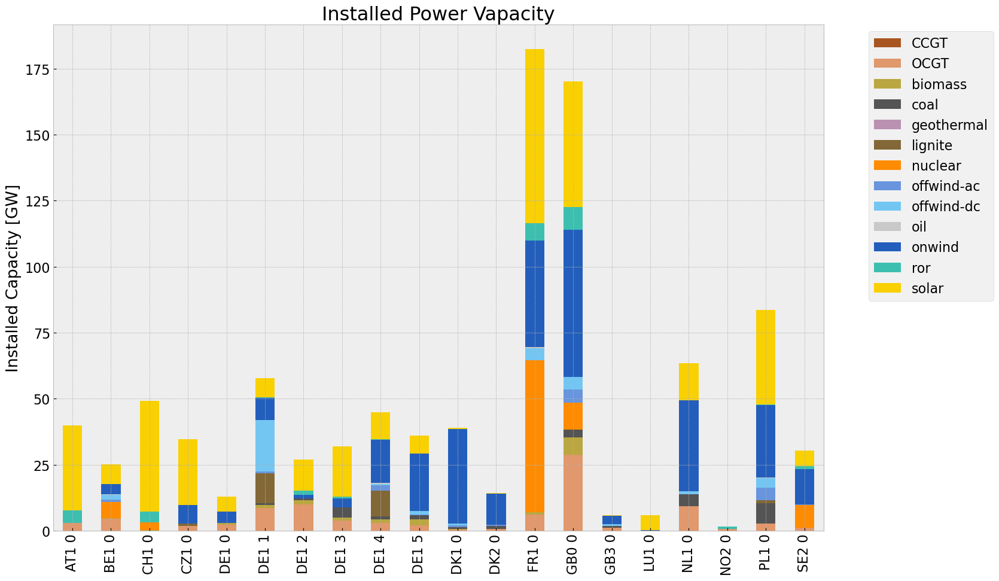

<Figure size 640x480 with 0 Axes>

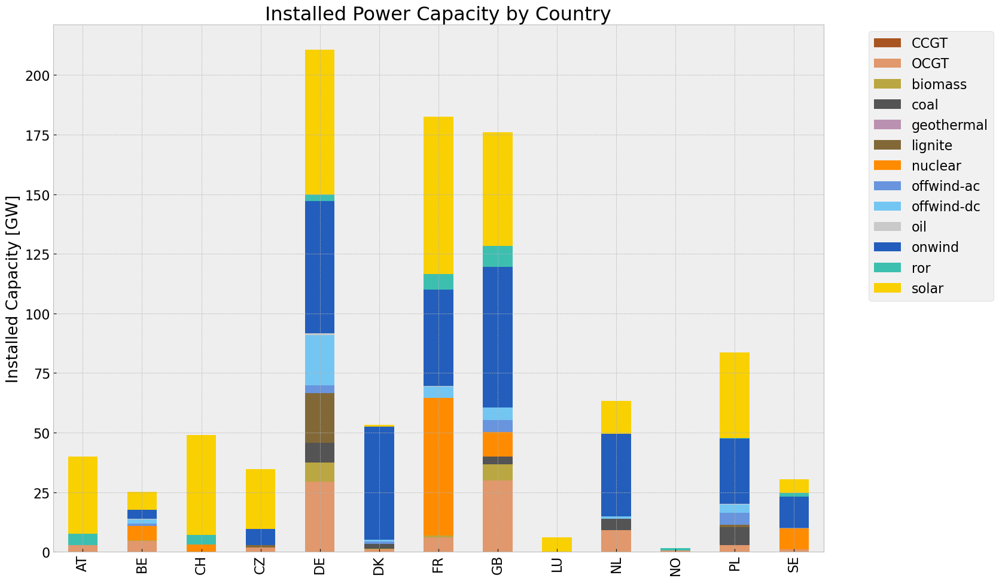

In [163]:
# consolidated istalled cap without load_shedding

#capacities_inv = n1.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_inv.fillna(0, inplace=True)
#gen_1 = (capacities_inv.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_inv = inst_cap_table(n1, color_cap)
cap_inv_country= inst_cap_table_country(n1, color_cap)


### Generation

<Figure size 640x480 with 0 Axes>

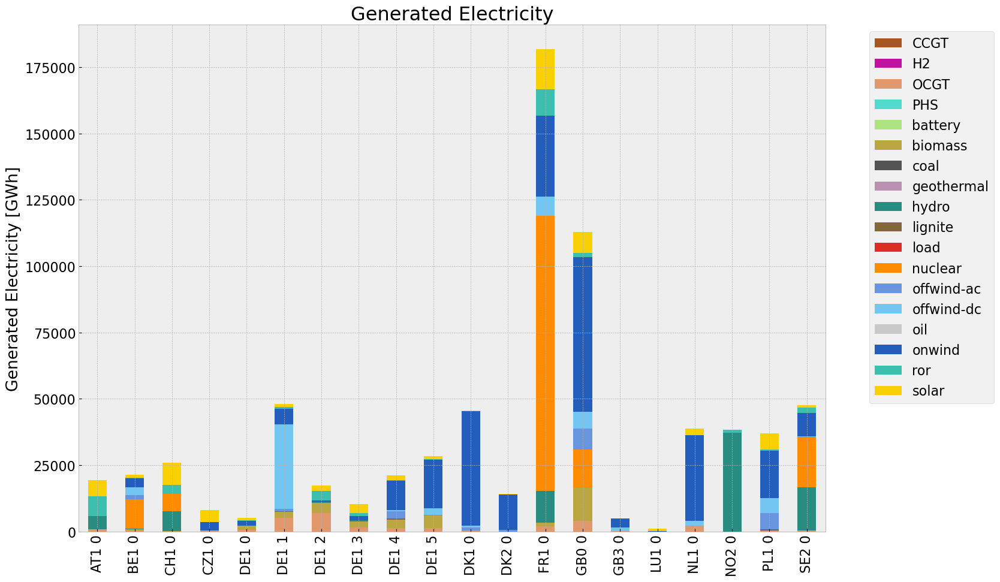

<Figure size 640x480 with 0 Axes>

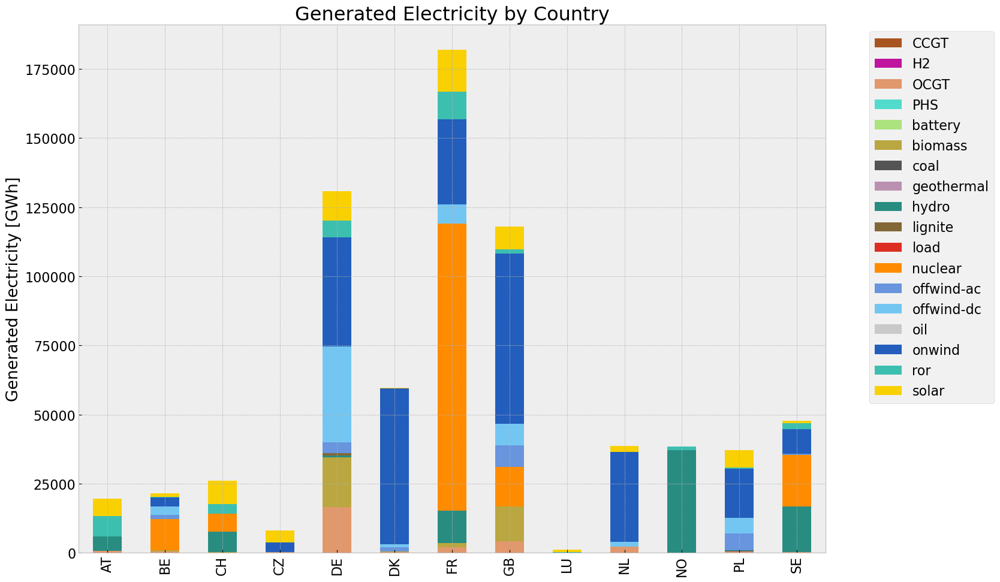

In [164]:
# consolidated generation table
#carrier = n1.generators.carrier.unique()
#df_tot_generation = n1.generators_t.p.sum()

#generations = pd.Series(index = n1.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
        #key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
               # generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
           # except KeyError:
               # print('error')
                
#generations.fillna(0, inplace=True)
#gen_inv = generations.unstack()/1000#Gwh


gen_inv = gen_power_table(n1)
gen_inv_country = gen_power_table_country(n1)

### Snapshot

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18236\3440809909.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18236\3440809909.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18236\3440809909.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18236\3440809909.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='3H')
c:\Users\

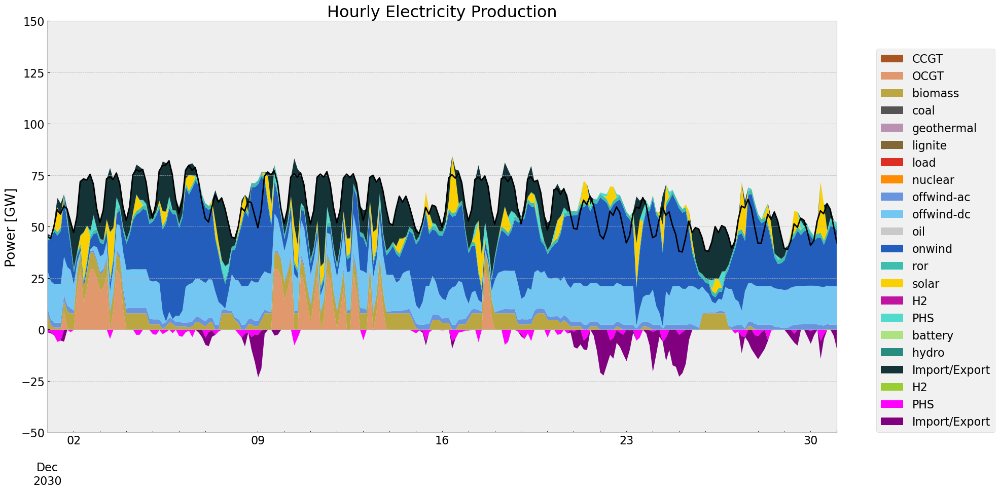

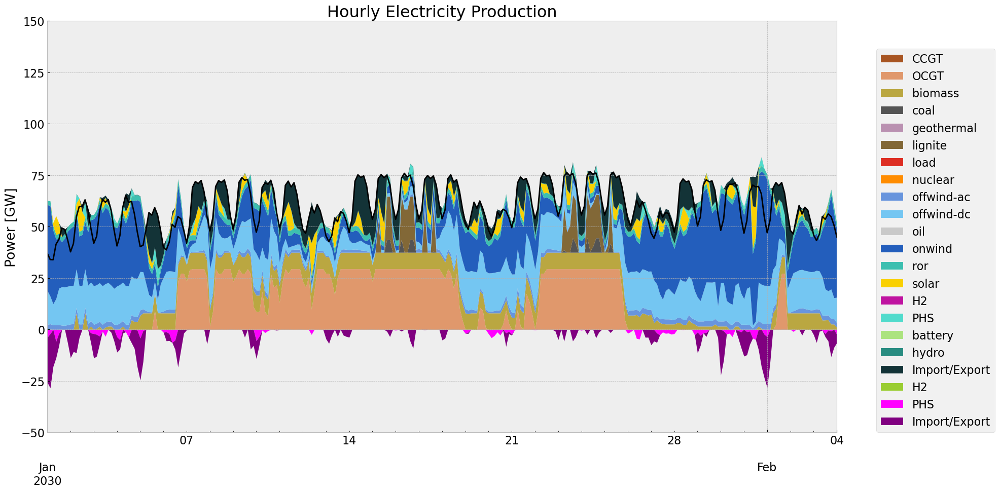

In [165]:
gen_curve(n1, '2030-12-01', '2030-12-31', colors_gen,'DE')
gen_curve(n1, '2030-01-1', '2030-02-04', colors_gen,'DE')


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18236\2535220694.py:5: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18236\2535220694.py:9: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18236\2535220694.py:13: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18236\2535220694.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, fr

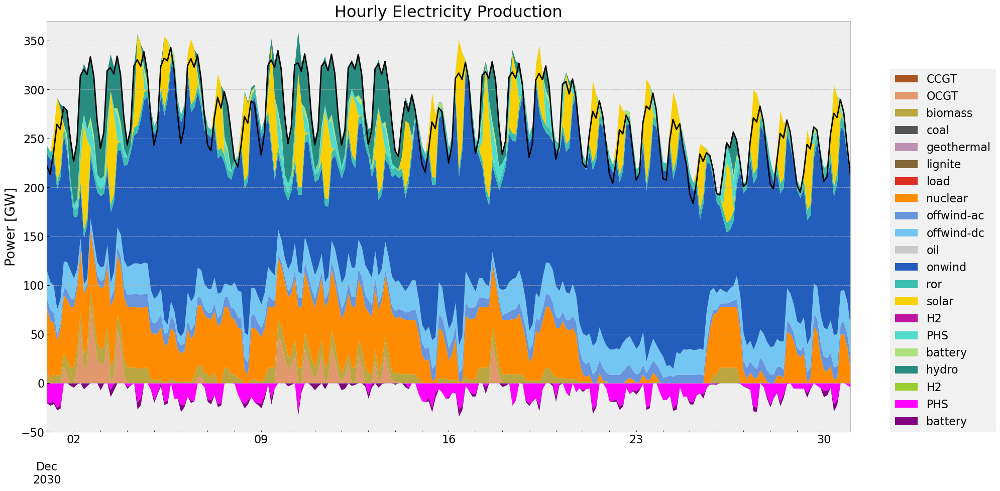

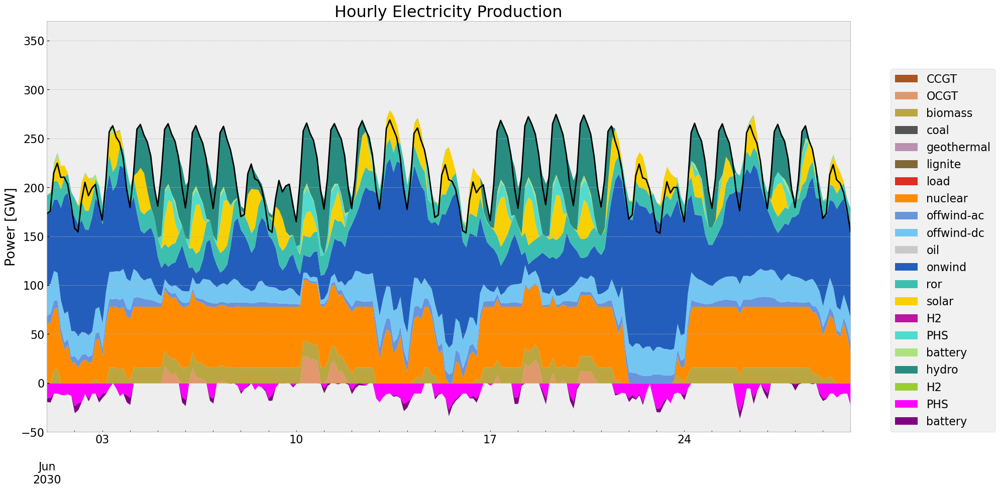

In [166]:
#generation curve all countries
#winter
gen_curve_tot(n1, '2030-12-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n1, '2030-06-01', '2030-06-30', colors_gen)

### Storage

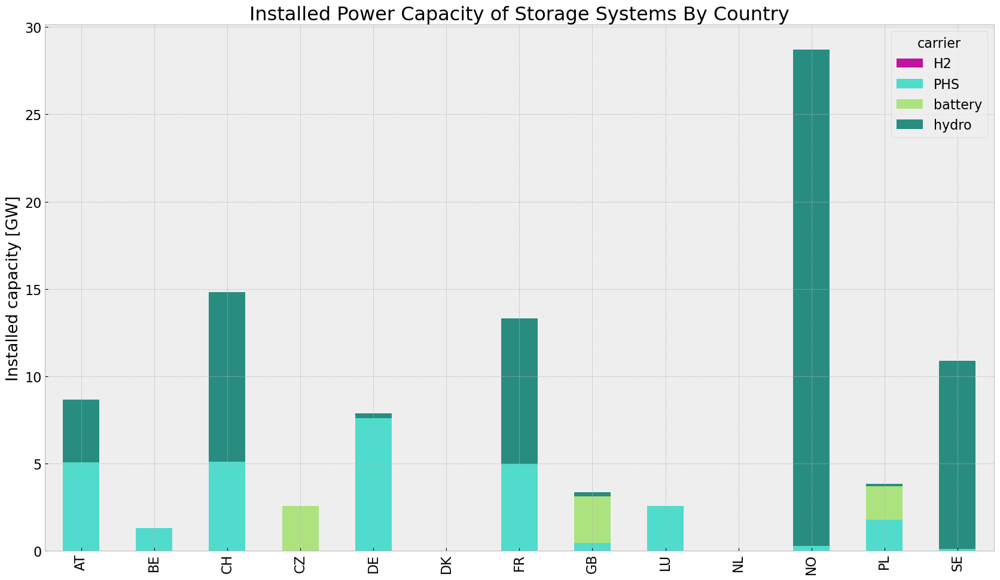

In [167]:
store_inv = inst_store_table(n1)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18236\3440348564.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18236\3440348564.py:5: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  soc.index = pd.date_range(start= '2030-01-01 00:00' , end= '2030-12-31 21:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18236\3440348564.py:11: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start= start_date , end= end_date, freq='3H')


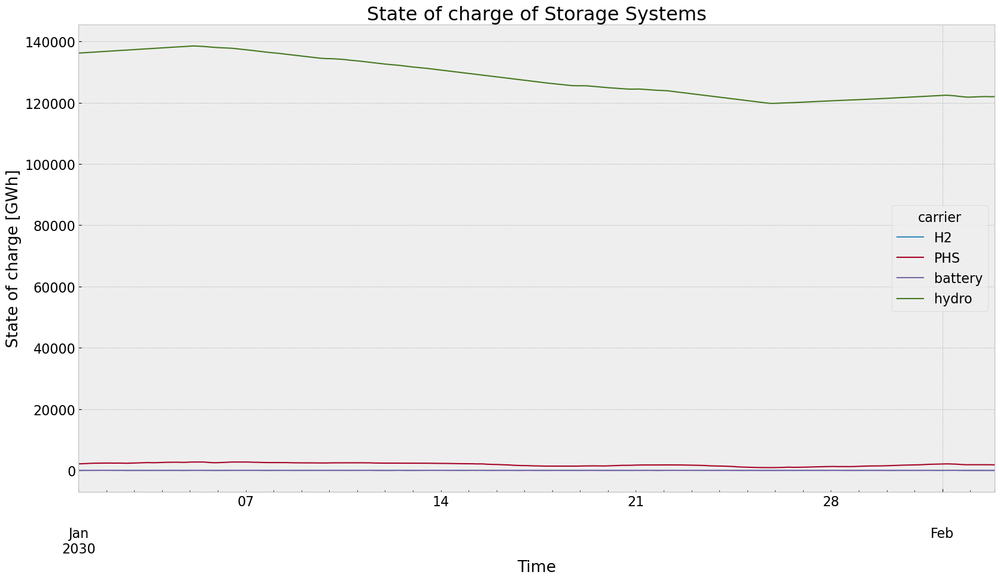

In [168]:
state_of_charge_plot(n1, '2030-01-01 00:00', '2030-02-02 21:00')

### Electricity Price


c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


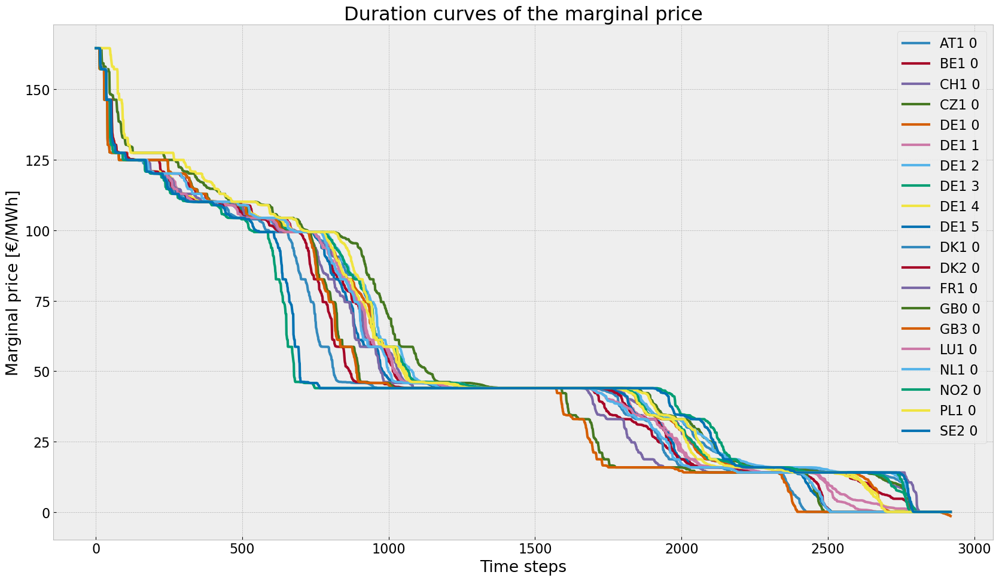

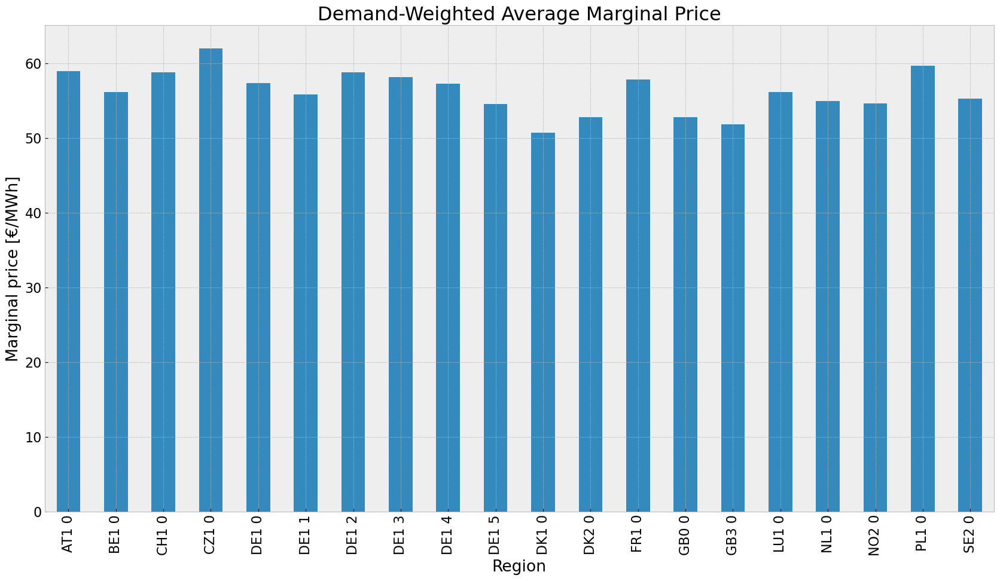

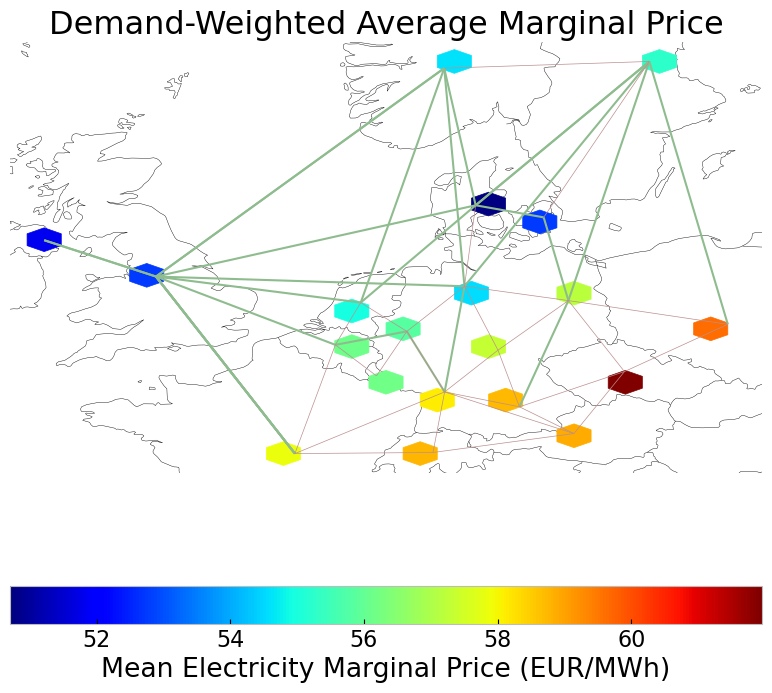

In [169]:
price_dur_curve_plot(n1)
price_regions_table(n1)
price_regions(n1)


### Emission

In [170]:
em_inv =em_table(n1)
em_inv

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000e+00
OCGT,2.721800e+07,0.451621,0.1980,1.193294e+07
biomass,3.300317e+07,0.468000,0.0000,0.000000e+00
coal,2.205063e+05,0.329908,0.3361,2.246450e+05
geothermal,0.000000e+00,1.000000,0.1200,0.000000e+00
lignite,6.798780e+05,0.337285,0.4069,8.202042e+05
load,0.000000e+00,1.000000,0.0000,0.000000e+00
nuclear,1.546283e+08,0.326600,0.0000,0.000000e+00
offwind-ac,2.151178e+07,1.000000,0.0000,0.000000e+00


## 2. Scenario: perfect foresight with no additional investment

In [ ]:
n2 = pvscenario(n, cut_start, duration, reductionto)

### No Investment

In [ ]:
def no_inv(n2,n):
    #set the optimal capacity of generators from the base scenario as the new minimum capacity 
    for index, value in n2.generators.p_nom_extendable.items():
        if value:  
            n2.generators.at[index, 'p_nom'] = n.generators.at[index, 'p_nom_opt']
            #n2.generators.at[index, 'p_nom_max'] = n.generators.at[index, 'p_nom_opt']
            n2.generators.at[index,'p_nom_extendable'] = False

    #set the optimal capacity of storage units from the base scenario as the new minimum capacity 
    for index, value in n2.storage_units.p_nom_extendable.items():
        if value:  
            n2.storage_units.at[index, 'p_nom'] = n.storage_units.at[index, 'p_nom_opt']
            #n2.storage_units.at[index, 'p_nom_max'] = n.storage_units.at[index, 'p_nom_opt']
            n2.storage_units.at[index,'p_nom_extendable'] = False

    #set the optimal capacity of stores from the base scenario as the new minimum capacity 
    for index, value in n2.stores.e_nom_extendable.items():
        if value:  
            n2.stores.at[index, 'e_nom'] = n.stores.at[index, 'e_nom_opt']
            #n2.stores.at[index, 'e_nom_max'] = n.stores.at[index, 'e_nom_opt']
            n2.stores.at[index, 'e_nom_extendable'] =False

    #set the optimal capacity of lines from the base scenario as the new minimum capacity 
    for index, value in n2.lines.s_nom_extendable.items():
        if value:  
            n2.lines.at[index, 's_nom'] = n.lines.at[index, 's_nom_opt']
            #n2.lines.at[index, 's_nom_max'] = n.lines.at[index, 's_nom_opt']
            n2.lines.at[index, 's_nom_extendable'] =False

    #set the optimal capacity of lines from the base scenario as the new minimum capacity 
    for index, value in n2.links.p_nom_extendable.items():
        if value:  
            n2.links.at[index, 'p_nom'] = n.links.at[index, 'p_nom_opt']
            #n2.lines.at[index, 's_nom_max'] = n.lines.at[index, 's_nom_opt']
            n2.links.at[index, 'p_nom_extendable'] =False

no_inv(n2,n)                 

In [ ]:
#n2.optimize(solver_name ='gurobi')
filename = f"noinv_{contingency}.nc"
n2 = import_nc_file(directory, filename)
n2.name = f'noinv_{contingency}'    

INFO:pypsa.io:Imported network noinv_pv.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


### Export model for later use

In [ ]:
#file = f"{n2.name}.nc"
#output_path = os.path.join(os.getcwd(), file)
#n2.export_to_netcdf(output_path)

In [ ]:
tot_cos_noinv=n2.objective/1e9 #billion €
system_cost_noinv = system_cost(n2) #million €/a
marg_price_region_noinv = n2.buses_t.marginal_price.mean()
stat_noinv = n2.statistics()

### Installed Capacity

Since expansion is not allowed in this scenario, the installed capacity will equal to that of the base scenario.

<Figure size 640x480 with 0 Axes>

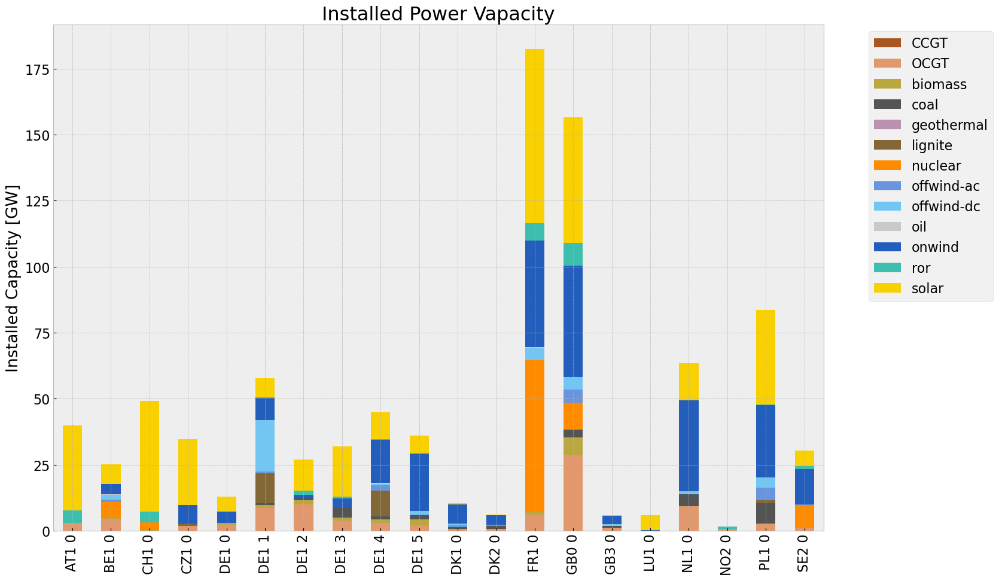

<Figure size 640x480 with 0 Axes>

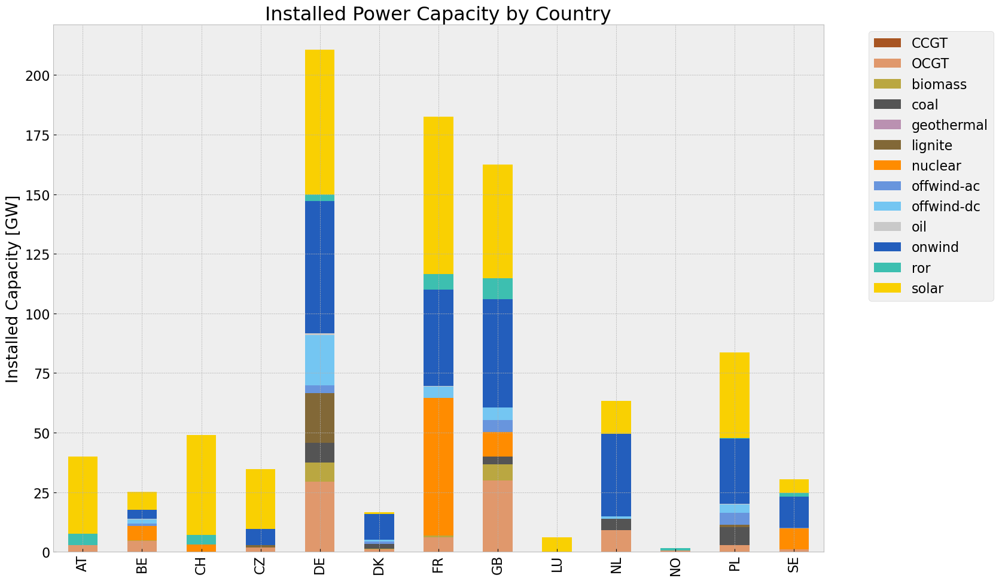

In [ ]:
# consolidated istalled cap without load_shedding

#capacities_noinv = n2.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_noinv.fillna(0, inplace=True)
#gen = (capacities_noinv.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_noinv = inst_cap_table(n2, color_cap)
cap_noinv_country= inst_cap_table_country(n2, color_cap)



### Generation

<Figure size 640x480 with 0 Axes>

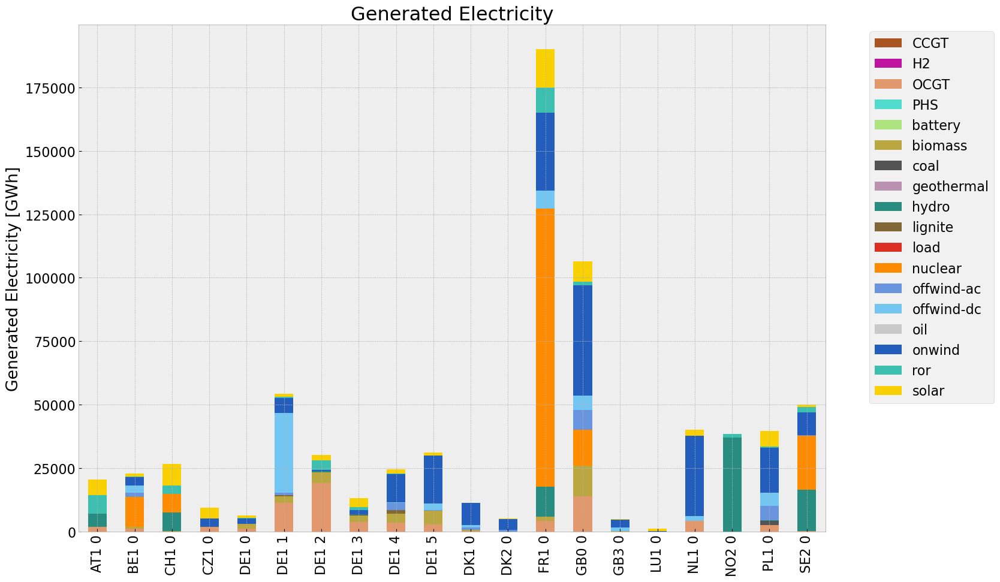

<Figure size 640x480 with 0 Axes>

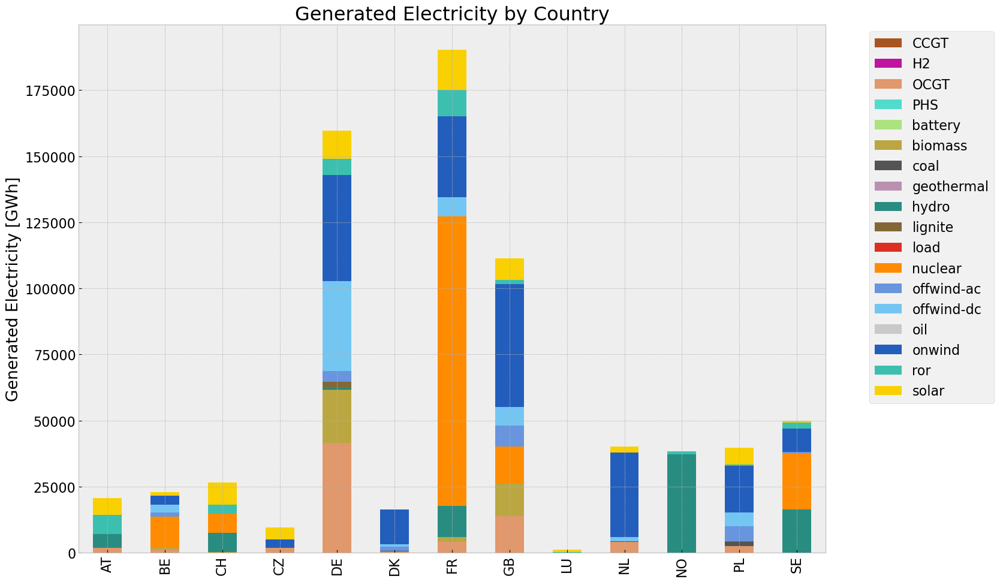

In [ ]:
# consolidated generation table
#carrier = n2.generators.carrier.unique()
#df_tot_generation = n2.generators_t.p.sum()

#generations = pd.Series(index = n2.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
        #key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
                #generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
            #except KeyError:
                #print('error')

#generations.fillna(0, inplace=True)
#gen_noinv = generations.unstack()/1000#GWh

gen_noinv= gen_power_table(n2)
gen_noinv_country = gen_power_table_country(n2)


### Snapshot

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18236\2796143640.py:1: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p = n2.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18236\2796143640.py:2: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n2.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18236\3440809909.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18236\3440809909.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).

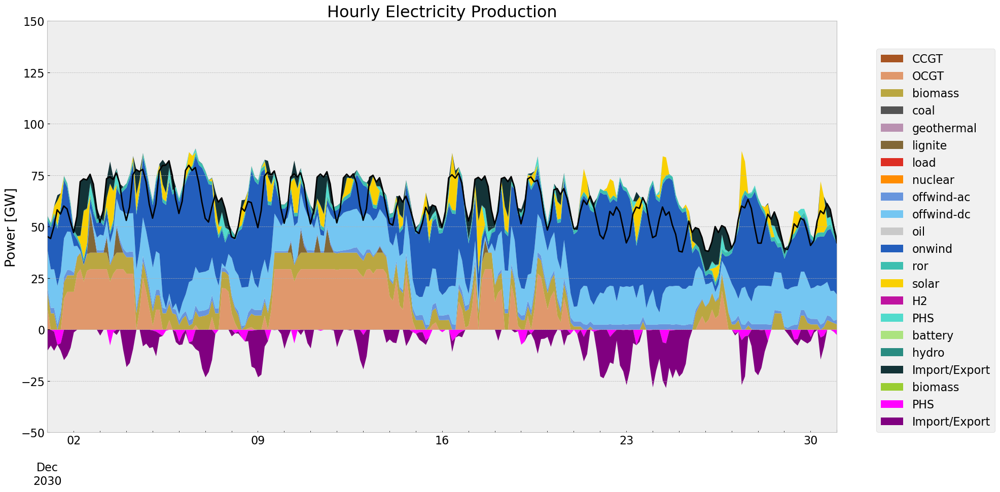

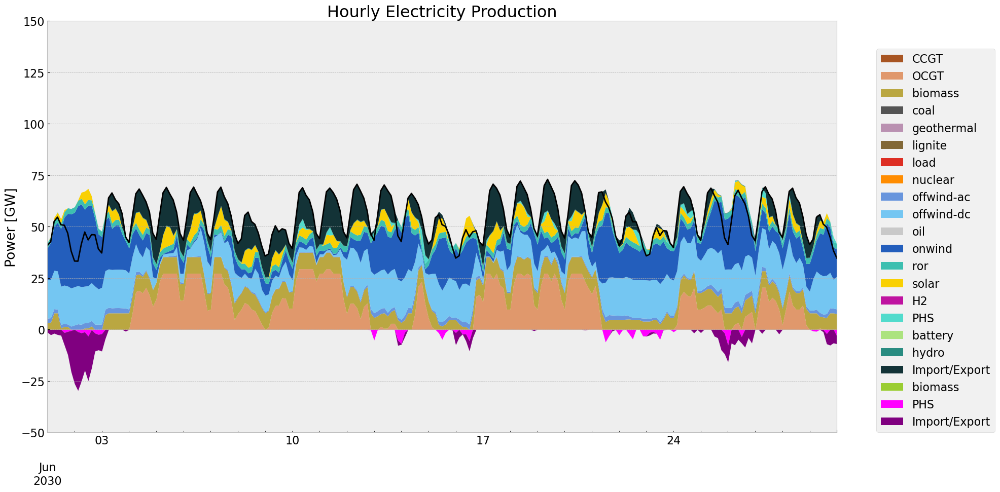

In [ ]:
p = n2.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
sto = n2.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)    

gen_curve(n2, '2030-12-01', '2030-12-31', colors_gen,'DE')
gen_curve(n2, '2030-06-01', '2030-06-30', colors_gen,'DE')


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18236\2535220694.py:5: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18236\2535220694.py:9: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18236\2535220694.py:13: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18236\2535220694.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, fr

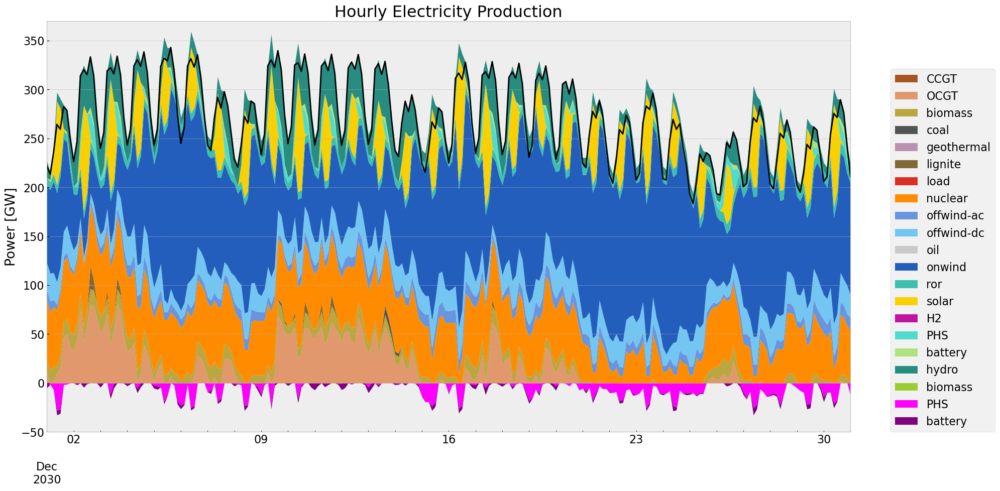

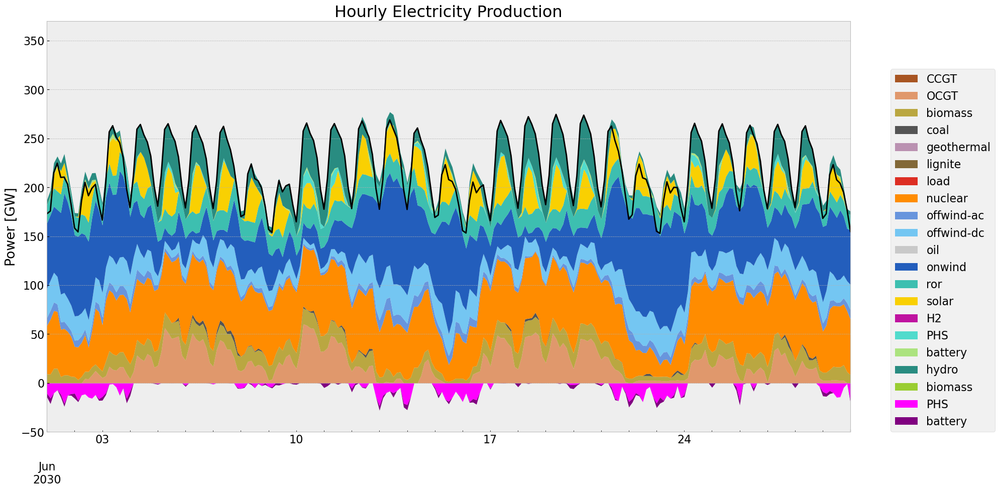

In [ ]:
#generation curve all countries
#winter
gen_curve_tot(n2, '2030-12-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n2, '2030-06-01', '2030-06-30', colors_gen)

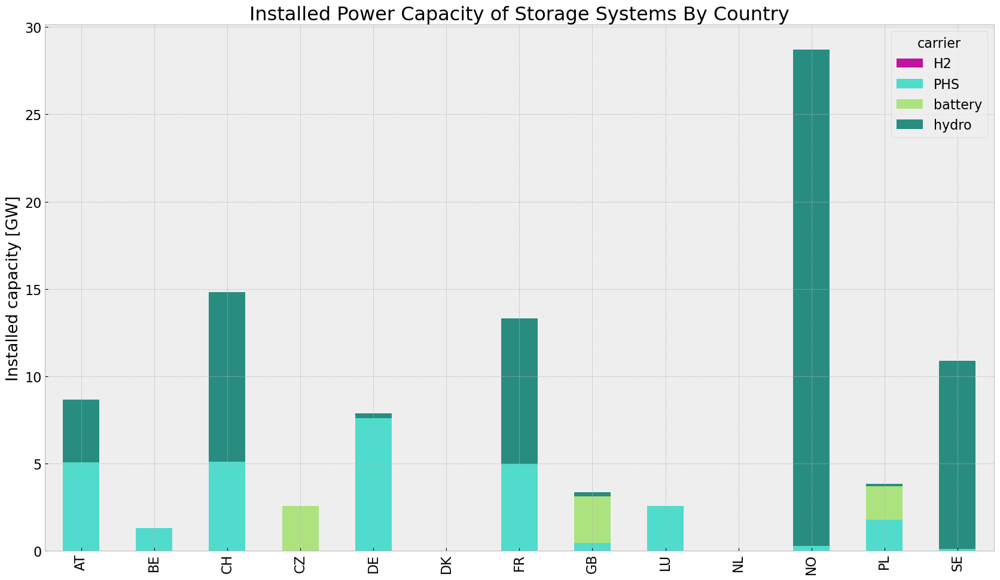

In [ ]:
#storage unit capacities
store_noinv = inst_store_table(n2)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18236\3440348564.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18236\3440348564.py:5: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  soc.index = pd.date_range(start= '2030-01-01 00:00' , end= '2030-12-31 21:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18236\3440348564.py:11: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start= start_date , end= end_date, freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18236\2695015690.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  n2.storage_units_t.p.groupby(n.storage_units.carrier, 

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000e+00
OCGT,7.165013e+07,0.451621,0.1980,3.141291e+07
biomass,3.510896e+07,0.468000,0.0000,0.000000e+00
coal,1.810082e+06,0.329908,0.3361,1.844055e+06
geothermal,0.000000e+00,1.000000,0.1200,0.000000e+00
lignite,2.103531e+06,0.337285,0.4069,2.537697e+06
load,0.000000e+00,1.000000,0.0000,0.000000e+00
nuclear,1.638975e+08,0.326600,0.0000,0.000000e+00
offwind-ac,2.111158e+07,1.000000,0.0000,0.000000e+00


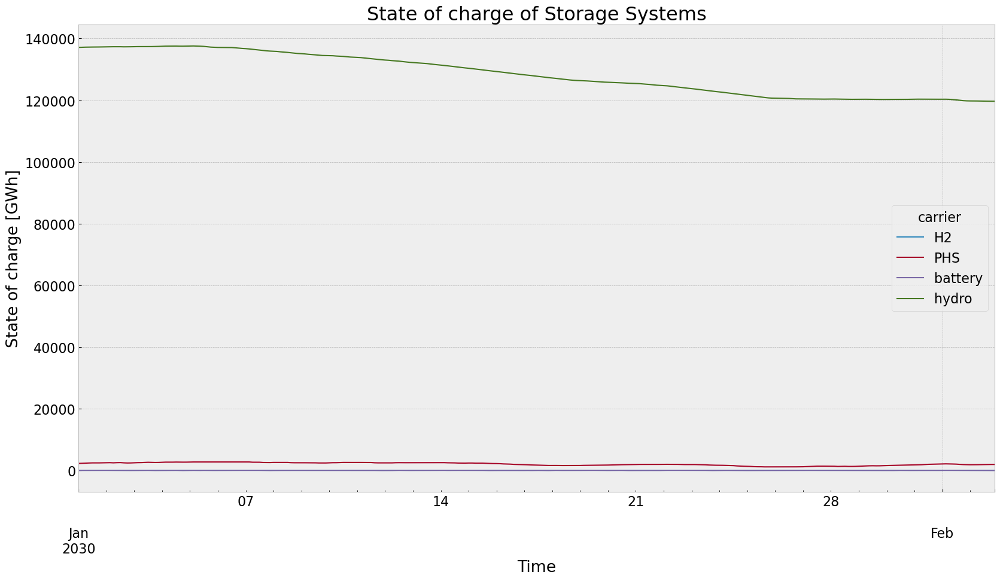

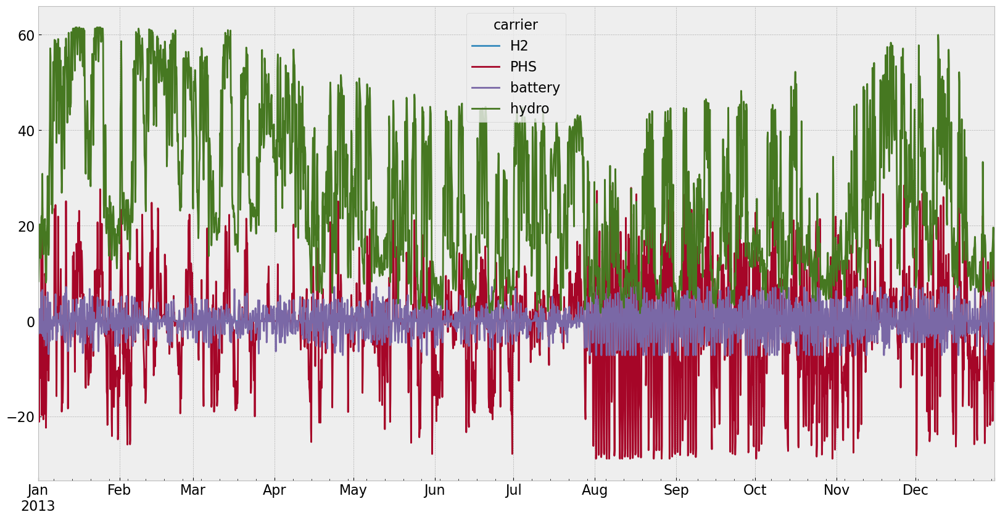

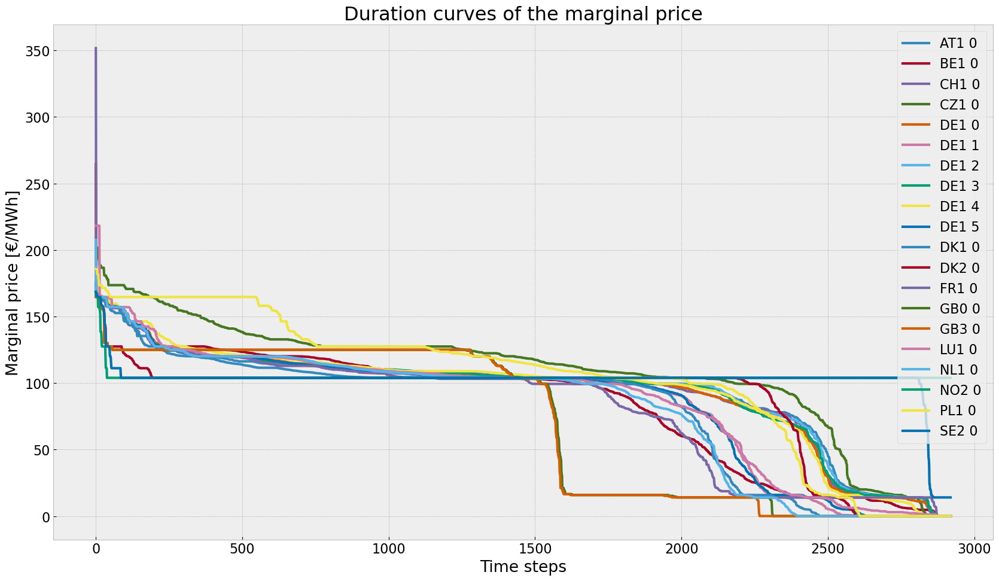

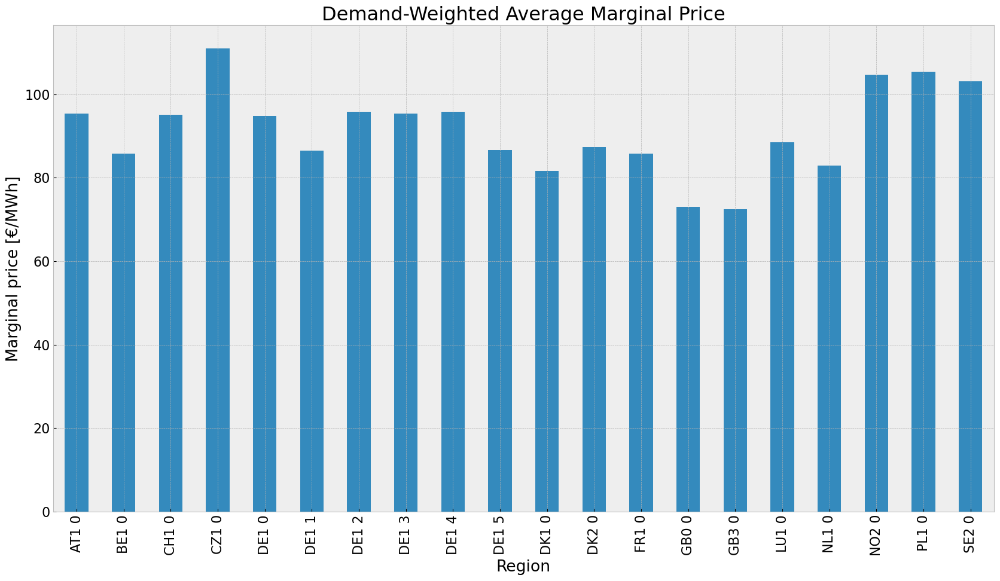

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


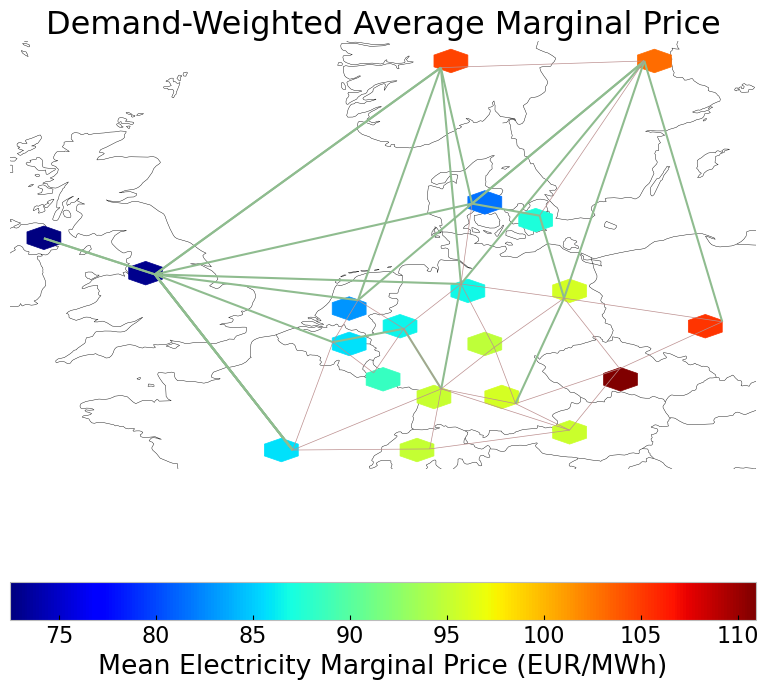

In [ ]:
#state of charge
state_of_charge_plot(n2, '2030-01-01 00:00', '2030-02-02 21:00')
n2.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3).loc[pd.date_range(start="2013-01-01", end="2013-12-31",freq='3H')].plot(figsize=(20,10))
#price
price_dur_curve_plot(n2)
price_regions_table(n2)
price_regions(n2)
#emission
em_noinv =em_table(n2)
em_noinv

## 3. Scenario: rolling horizon foresight with no additional investment

In [ ]:
n3= n2.copy()

horizon = 24
n3.storage_units['cyclic_state_of_charge'] = False
n3.storage_units['cyclic_state_of_charge_per_period'] = False


#optimize.optimize_with_rolling_horizon(n3, horizon=horizon, overlap=0, solver_name='gurobi')
filename = f"noinv_roll_{contingency}.nc"
n3 = import_nc_file(directory, filename)
n3.name = f'noinv_roll_{contingency}'

INFO:pypsa.io:Imported network noinv_roll_pv.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


### Export Model for later use

In [ ]:
#filename = f"{n3.name}.nc"
#output_path = os.path.join(os.getcwd(), filename)
#n3.export_to_netcdf(output_path)

In [ ]:
tot_cos_noinv_roll=n3.objective/1e9 #billion €
system_cost_noinv_roll = system_cost(n3) #million €/a
marg_price_region_noinv_roll = n3.buses_t.marginal_price.mean()
stat_noinv_roll = n3.statistics()

<Figure size 640x480 with 0 Axes>

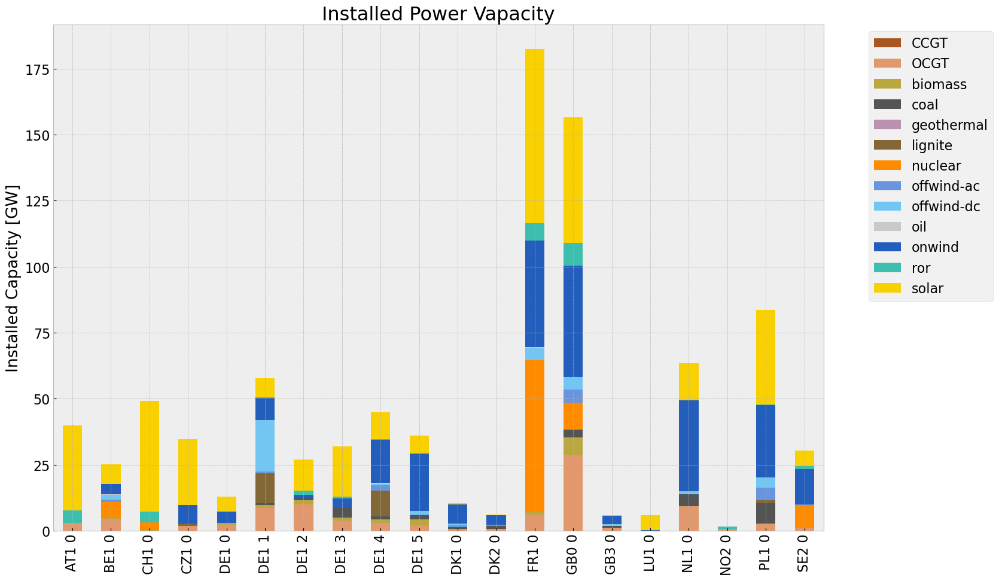

<Figure size 640x480 with 0 Axes>

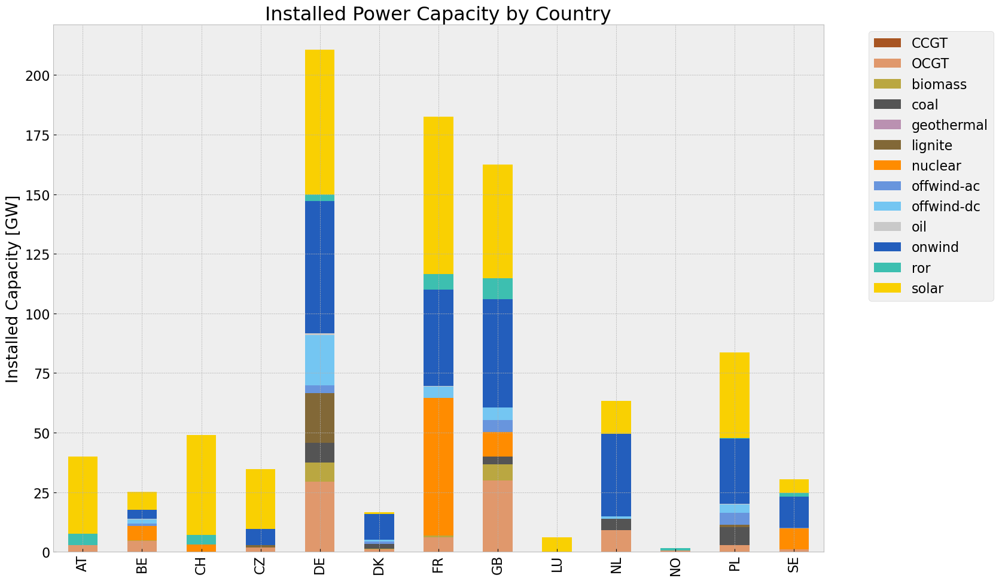

<Figure size 640x480 with 0 Axes>

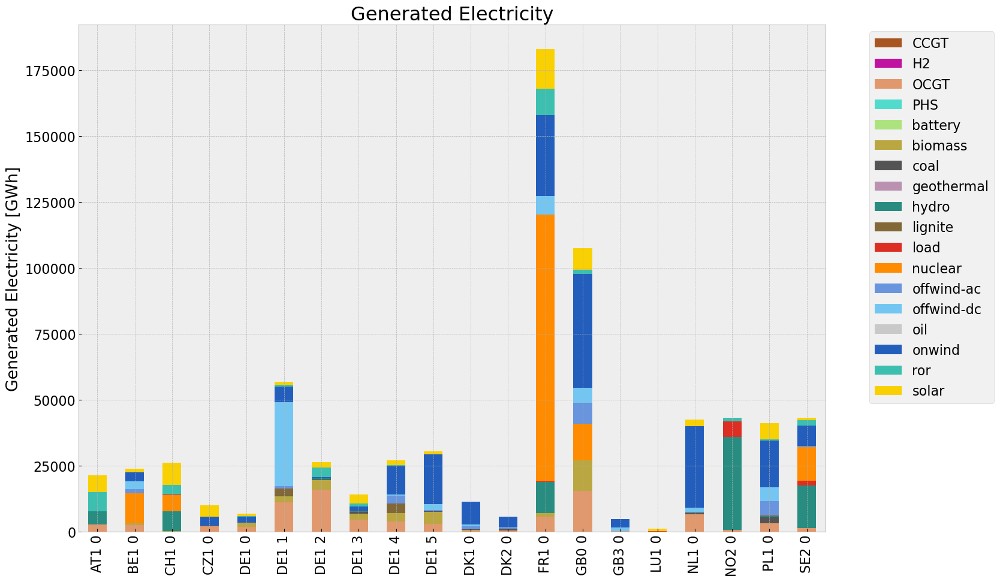

<Figure size 640x480 with 0 Axes>

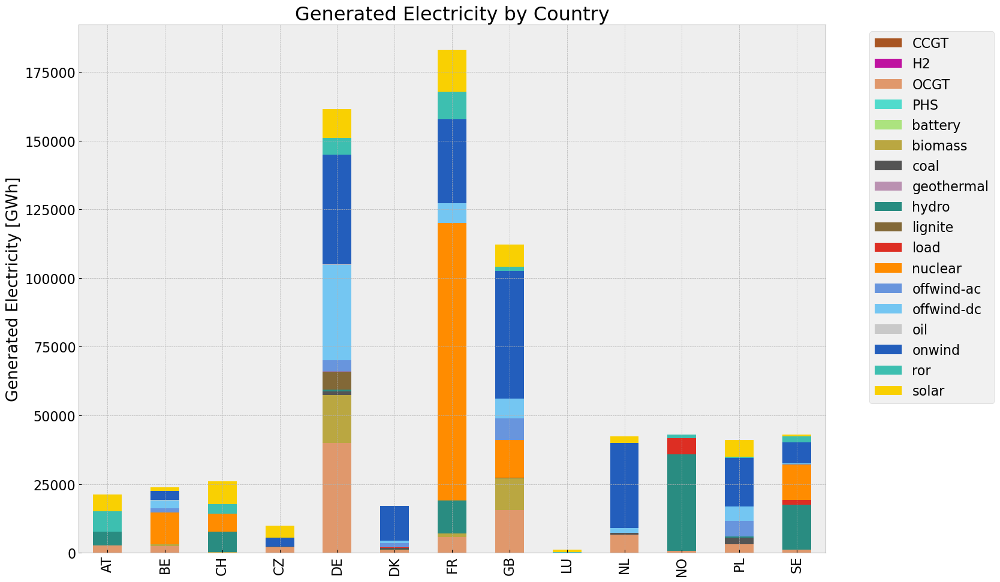

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18236\3440809909.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18236\3440809909.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18236\3440809909.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18236\3440809909.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='3H')
c:\Users\

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000e+00
OCGT,8.065430e+07,0.451621,0.1980,3.536053e+07
biomass,3.147075e+07,0.468000,0.0000,0.000000e+00
coal,5.221039e+06,0.329908,0.3361,5.319032e+06
geothermal,0.000000e+00,1.000000,0.1200,0.000000e+00
lignite,6.722302e+06,0.337285,0.4069,8.109779e+06
load,8.461545e+06,1.000000,0.0000,0.000000e+00
nuclear,1.456030e+08,0.326600,0.0000,0.000000e+00
offwind-ac,2.102796e+07,1.000000,0.0000,0.000000e+00


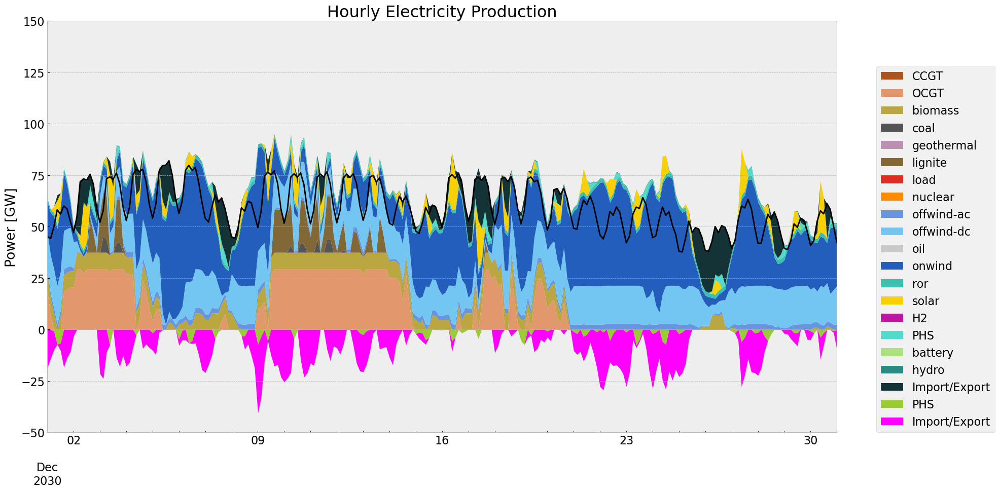

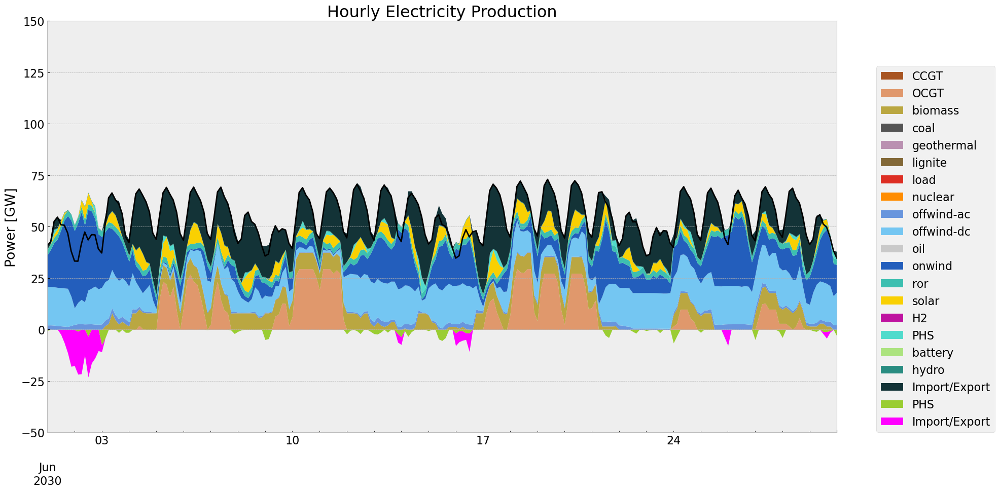

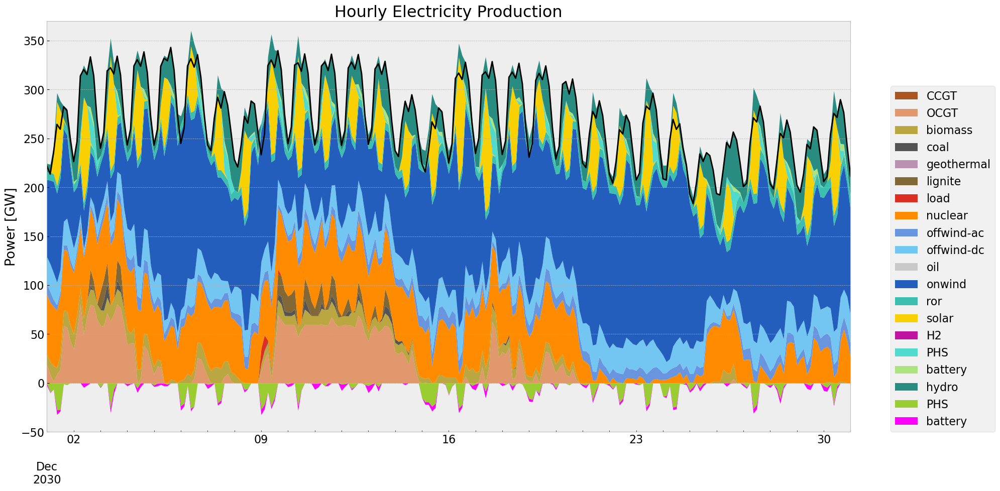

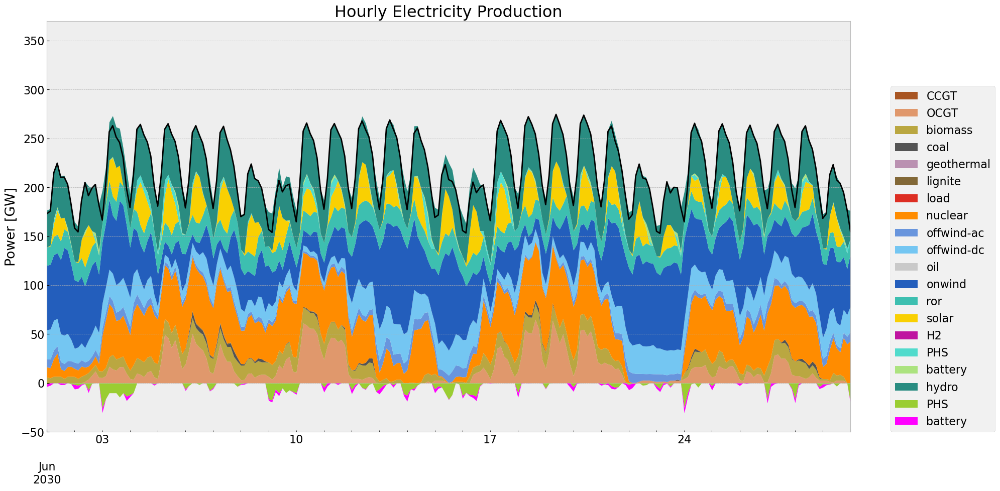

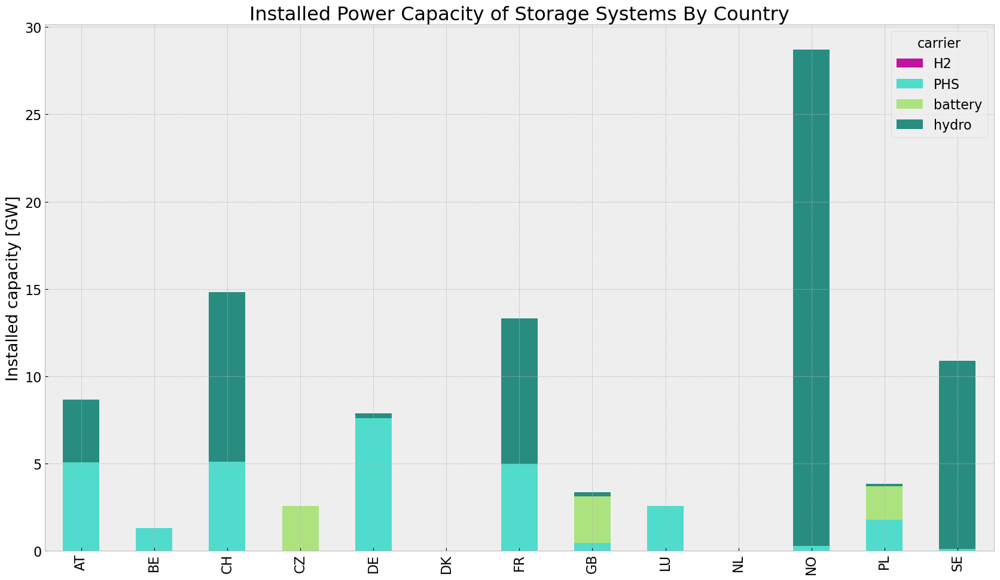

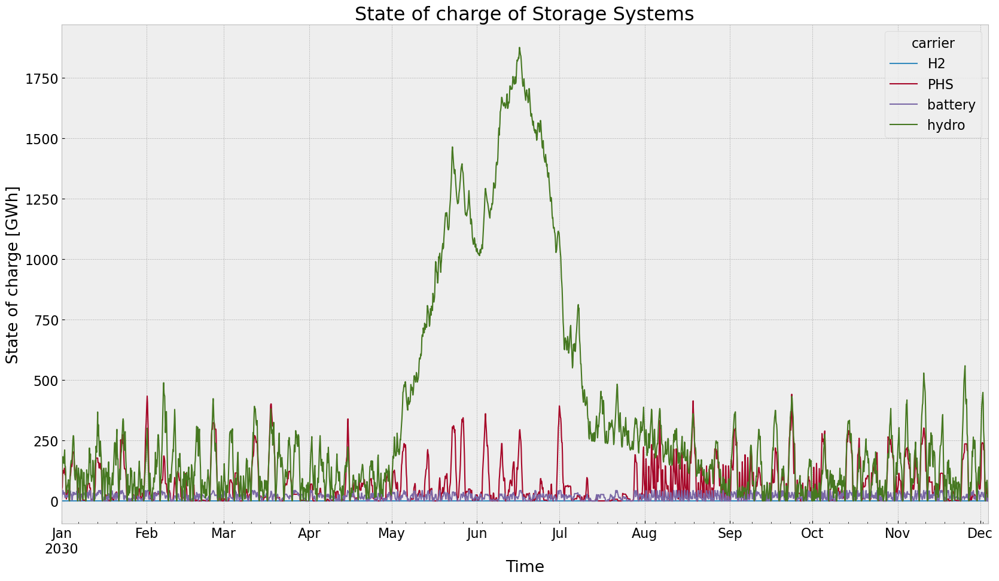

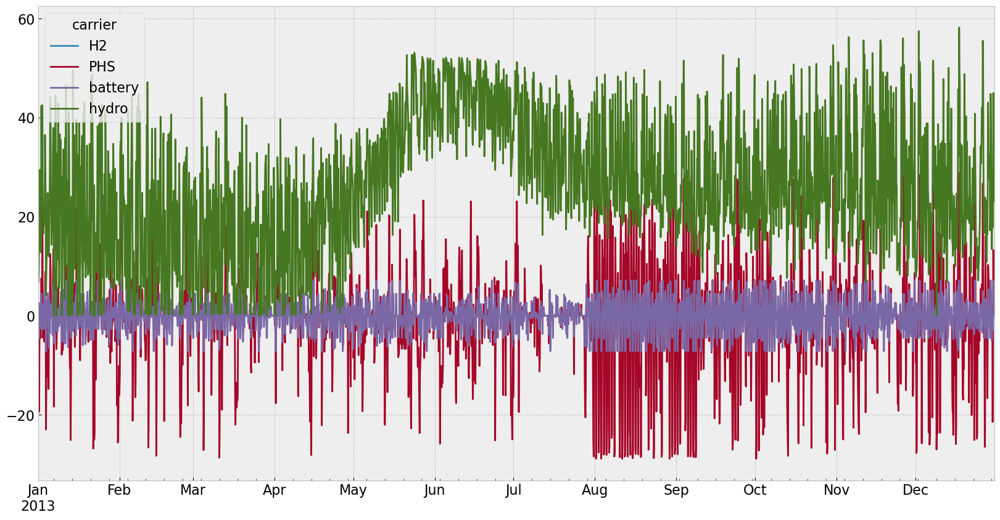

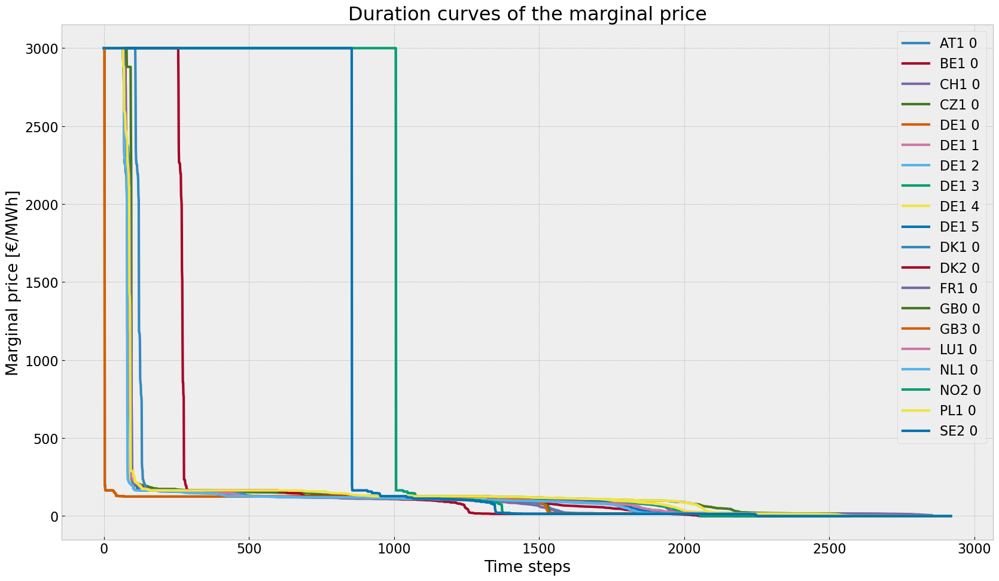

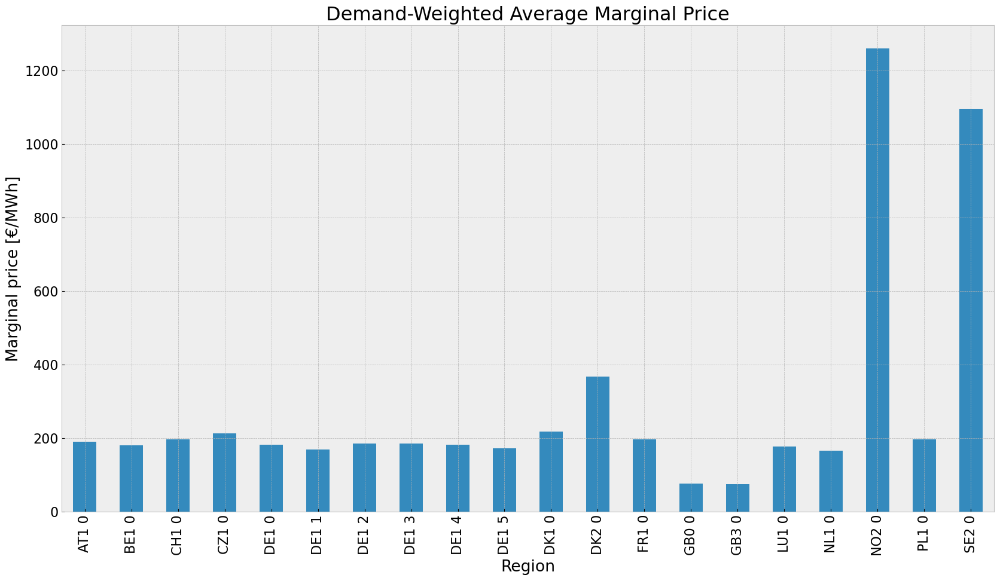

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


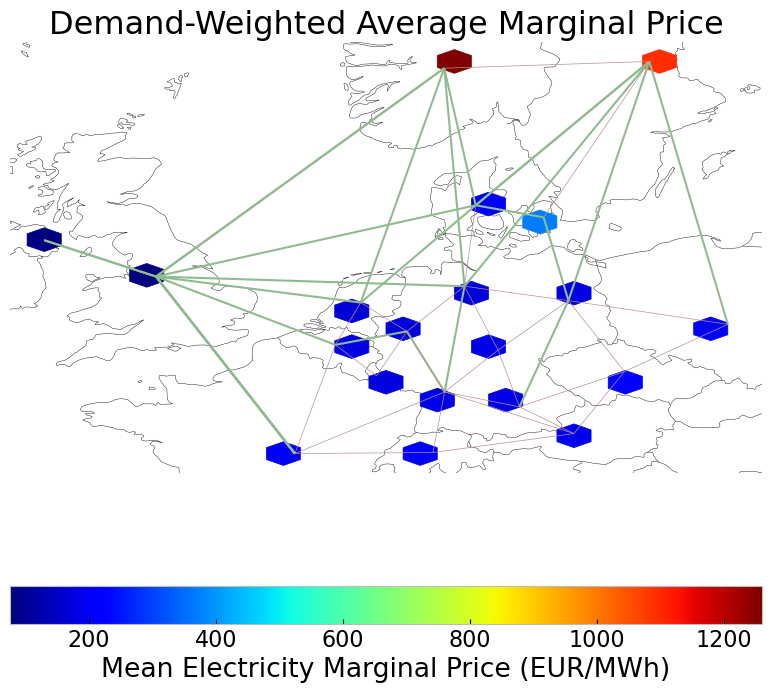

In [ ]:
# Plotting
#installed cap
#capacities_noinv_roll = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_noinv_roll.fillna(0, inplace=True)
#gen = (capacities_noinv_roll.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_noinv_roll = inst_cap_table(n3, color_cap)
cap_noinv_roll_country = inst_cap_table_country(n3, color_cap)

#Generation table
# consolidated generation table
#carrier = n3.generators.carrier.unique()
#df_tot_generation = n3.generators_t.p.sum()

#generations = pd.Series(index = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
       # key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
               # generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
            #except KeyError:
                #print('error')
#generations.fillna(0, inplace=True)

#gen_noinv_roll =(generations.unstack()/1000)#GWh

gen_noinv_roll  = gen_power_table(n3)
gen_noinv_roll_country = gen_power_table_country(n3)

#Snapshot Summer and Winter
#p = n3.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
#sto = n3.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)    

gen_curve(n3, '2030-12-01', '2030-12-31', colors_gen,'DE')
gen_curve(n3, '2030-06-01', '2030-06-30', colors_gen,'DE')
#generation curve all countries
#winter
gen_curve_tot(n3, '2030-12-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n3, '2030-06-01', '2030-06-30', colors_gen)

#installed storage unit & stores
store_noinv_roll = inst_store_table(n3)

#State of Charge Storage unit
state_of_charge_plot(n3, '2030-01-01 00:00', '2030-12-03 21:00')
n3.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3).loc[pd.date_range(start="2013-01-01", end="2013-12-31",freq='3H')].plot(figsize=(20,10))


#Electricitty Price duration curve
price_dur_curve_plot(n3)

#avg electricity price
price_regions_table(n3)
price_regions(n3)

#Emission
em_noinv_roll =em_table(n3)
em_noinv_roll

## 4. Allowed Investment scenario solved with Rolling Horizon

In [181]:
n4 = n1.copy()

horizon = 24

no_inv(n4,n1)

n4.storage_units['cyclic_state_of_charge'] = False
n4.storage_units['cyclic_state_of_charge_per_period'] = False


optimize.optimize_with_rolling_horizon(n4, horizon=horizon, overlap=0, solver_name='gurobi')
#filename = f"inv_roll_{contingency}.nc"
#n4 = import_nc_file(directory, filename)
n4.name = f'inv_roll_{contingency}'

INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-03 21:00:00] (1/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.65it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qygqtpko.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qygqtpko.lp


Reading time = 0.11 seconds


INFO:gurobipy:Reading time = 0.11 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x5ed3f132


INFO:gurobipy:Model fingerprint: 0x5ed3f132


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25416 rows and 6421 columns


INFO:gurobipy:Presolve removed 25416 rows and 6421 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 6083 columns, 10087 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6083 columns, 10087 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.100e+03


INFO:gurobipy: AA' NZ     : 4.100e+03


 Factor NZ  : 4.059e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.059e+04 (roughly 3 MB of memory)


 Factor Ops : 2.158e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.158e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.04929594e+11 -5.85342630e+11  9.77e+04 1.14e+04  4.87e+08     0s


INFO:gurobipy:   0   2.04929594e+11 -5.85342630e+11  9.77e+04 1.14e+04  4.87e+08     0s


   1   2.89856281e+10 -2.98879127e+11  7.64e+03 7.28e-11  5.55e+07     0s


INFO:gurobipy:   1   2.89856281e+10 -2.98879127e+11  7.64e+03 7.28e-11  5.55e+07     0s


   2   3.44933014e+09 -6.20908510e+10  4.84e+02 7.28e-11  6.53e+06     0s


INFO:gurobipy:   2   3.44933014e+09 -6.20908510e+10  4.84e+02 7.28e-11  6.53e+06     0s


   3   8.41001424e+08 -6.17987242e+09  2.44e+01 8.00e-11  5.96e+05     0s


INFO:gurobipy:   3   8.41001424e+08 -6.17987242e+09  2.44e+01 8.00e-11  5.96e+05     0s


   4   3.36245407e+08 -2.13752896e+09  4.41e+00 4.37e-11  2.05e+05     0s


INFO:gurobipy:   4   3.36245407e+08 -2.13752896e+09  4.41e+00 4.37e-11  2.05e+05     0s


   5   2.17086484e+08 -8.11103480e+08  2.44e+00 2.91e-11  8.48e+04     0s


INFO:gurobipy:   5   2.17086484e+08 -8.11103480e+08  2.44e+00 2.91e-11  8.48e+04     0s


   6   1.23958010e+08 -2.90558675e+08  1.05e+00 1.46e-11  3.41e+04     0s


INFO:gurobipy:   6   1.23958010e+08 -2.90558675e+08  1.05e+00 1.46e-11  3.41e+04     0s


   7   5.02576681e+07 -1.09061775e+08  1.61e-01 1.46e-11  1.31e+04     0s


INFO:gurobipy:   7   5.02576681e+07 -1.09061775e+08  1.61e-01 1.46e-11  1.31e+04     0s


   8   2.82134548e+07 -6.86658103e+06  3.74e-02 1.46e-11  2.88e+03     0s


INFO:gurobipy:   8   2.82134548e+07 -6.86658103e+06  3.74e-02 1.46e-11  2.88e+03     0s


   9   1.98366213e+07  5.71694484e+06  1.27e-02 2.91e-11  1.16e+03     0s


INFO:gurobipy:   9   1.98366213e+07  5.71694484e+06  1.27e-02 2.91e-11  1.16e+03     0s


  10   1.77385353e+07  9.80526966e+06  7.12e-03 1.46e-11  6.51e+02     0s


INFO:gurobipy:  10   1.77385353e+07  9.80526966e+06  7.12e-03 1.46e-11  6.51e+02     0s


  11   1.68192763e+07  1.26137478e+07  4.72e-03 2.91e-11  3.45e+02     0s


INFO:gurobipy:  11   1.68192763e+07  1.26137478e+07  4.72e-03 2.91e-11  3.45e+02     0s


  12   1.61584428e+07  1.35860770e+07  2.96e-03 1.46e-11  2.11e+02     0s


INFO:gurobipy:  12   1.61584428e+07  1.35860770e+07  2.96e-03 1.46e-11  2.11e+02     0s


  13   1.58491276e+07  1.45405406e+07  2.12e-03 2.91e-11  1.07e+02     0s


INFO:gurobipy:  13   1.58491276e+07  1.45405406e+07  2.12e-03 2.91e-11  1.07e+02     0s


  14   1.52815398e+07  1.48677592e+07  5.51e-04 3.07e-11  3.40e+01     0s


INFO:gurobipy:  14   1.52815398e+07  1.48677592e+07  5.51e-04 3.07e-11  3.40e+01     0s


  15   1.51616526e+07  1.49581166e+07  2.54e-04 1.46e-11  1.67e+01     0s


INFO:gurobipy:  15   1.51616526e+07  1.49581166e+07  2.54e-04 1.46e-11  1.67e+01     0s


  16   1.51096874e+07  1.50105935e+07  1.30e-04 2.91e-11  8.14e+00     0s


INFO:gurobipy:  16   1.51096874e+07  1.50105935e+07  1.30e-04 2.91e-11  8.14e+00     0s


  17   1.50828131e+07  1.50249777e+07  6.80e-05 2.91e-11  4.75e+00     0s


INFO:gurobipy:  17   1.50828131e+07  1.50249777e+07  6.80e-05 2.91e-11  4.75e+00     0s


  18   1.50676501e+07  1.50383015e+07  3.45e-05 1.63e-11  2.41e+00     0s


INFO:gurobipy:  18   1.50676501e+07  1.50383015e+07  3.45e-05 1.63e-11  2.41e+00     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.14 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.14 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2788    1.5050887e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2788    1.5050887e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2788 iterations and 0.16 seconds (0.08 work units)


INFO:gurobipy:Solved in 2788 iterations and 0.16 seconds (0.08 work units)


Optimal objective  1.505088675e+07


INFO:gurobipy:Optimal objective  1.505088675e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.51e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-04 00:00:00:2013-01-06 21:00:00] (2/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object',

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.97it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0v_c6cfo.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0v_c6cfo.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x1e867f2d


INFO:gurobipy:Model fingerprint: 0x1e867f2d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25425 rows and 6355 columns


INFO:gurobipy:Presolve removed 25425 rows and 6355 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1407 rows, 6149 columns, 10144 nonzeros


INFO:gurobipy:Presolved: 1407 rows, 6149 columns, 10144 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.091e+03


INFO:gurobipy: AA' NZ     : 4.091e+03


 Factor NZ  : 4.100e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.100e+04 (roughly 3 MB of memory)


 Factor Ops : 2.252e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.252e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.22532337e+11 -5.59626442e+11  1.03e+05 1.21e+04  4.76e+08     0s


INFO:gurobipy:   0   2.22532337e+11 -5.59626442e+11  1.03e+05 1.21e+04  4.76e+08     0s


   1   3.05440296e+10 -2.93298135e+11  7.57e+03 7.28e-11  5.28e+07     0s


INFO:gurobipy:   1   3.05440296e+10 -2.93298135e+11  7.57e+03 7.28e-11  5.28e+07     0s


   2   4.56166673e+09 -6.18456247e+10  4.71e+02 1.02e-10  6.46e+06     0s


INFO:gurobipy:   2   4.56166673e+09 -6.18456247e+10  4.71e+02 1.02e-10  6.46e+06     0s


   3   1.14212471e+09 -7.69283341e+09  3.86e+01 1.24e-10  7.53e+05     0s


INFO:gurobipy:   3   1.14212471e+09 -7.69283341e+09  3.86e+01 1.24e-10  7.53e+05     0s


   4   5.48175272e+08 -1.74042645e+09  3.98e+00 3.64e-11  1.87e+05     0s


INFO:gurobipy:   4   5.48175272e+08 -1.74042645e+09  3.98e+00 3.64e-11  1.87e+05     0s


   5   4.19113146e+08 -5.91075214e+08  2.18e+00 2.18e-11  8.24e+04     0s


INFO:gurobipy:   5   4.19113146e+08 -5.91075214e+08  2.18e+00 2.18e-11  8.24e+04     0s


   6   3.38433749e+08 -2.33498641e+08  1.47e+00 1.46e-11  4.66e+04     0s


INFO:gurobipy:   6   3.38433749e+08 -2.33498641e+08  1.47e+00 1.46e-11  4.66e+04     0s


   7   2.04539756e+08 -6.32997107e+07  4.99e-01 1.46e-11  2.18e+04     0s


INFO:gurobipy:   7   2.04539756e+08 -6.32997107e+07  4.99e-01 1.46e-11  2.18e+04     0s


   8   1.64263693e+08  1.78151710e+07  2.88e-01 1.46e-11  1.19e+04     0s


INFO:gurobipy:   8   1.64263693e+08  1.78151710e+07  2.88e-01 1.46e-11  1.19e+04     0s


   9   1.35877733e+08  7.07024931e+07  1.48e-01 1.06e-11  5.30e+03     0s


INFO:gurobipy:   9   1.35877733e+08  7.07024931e+07  1.48e-01 1.06e-11  5.30e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.10 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.10 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1888    1.0265200e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1888    1.0265200e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1888 iterations and 0.11 seconds (0.06 work units)


INFO:gurobipy:Solved in 1888 iterations and 0.11 seconds (0.06 work units)


Optimal objective  1.026519963e+08


INFO:gurobipy:Optimal objective  1.026519963e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.03e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-07 00:00:00:2013-01-09 21:00:00] (3/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object',

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 123.89it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dsyjkydv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dsyjkydv.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x81bd346c


INFO:gurobipy:Model fingerprint: 0x81bd346c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25431 rows and 6357 columns


INFO:gurobipy:Presolve removed 25431 rows and 6357 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1401 rows, 6147 columns, 10136 nonzeros


INFO:gurobipy:Presolved: 1401 rows, 6147 columns, 10136 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.085e+03


INFO:gurobipy: AA' NZ     : 4.085e+03


 Factor NZ  : 4.097e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.097e+04 (roughly 3 MB of memory)


 Factor Ops : 2.253e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.253e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.63353624e+11 -5.51800561e+11  1.11e+05 7.44e+03  5.16e+08     0s


INFO:gurobipy:   0   2.63353624e+11 -5.51800561e+11  1.11e+05 7.44e+03  5.16e+08     0s


   1   3.94861040e+10 -2.85900064e+11  7.90e+03 7.28e-11  5.44e+07     0s


INFO:gurobipy:   1   3.94861040e+10 -2.85900064e+11  7.90e+03 7.28e-11  5.44e+07     0s


   2   9.44511071e+09 -6.15471880e+10  4.46e+02 1.60e-10  6.83e+06     0s


INFO:gurobipy:   2   9.44511071e+09 -6.15471880e+10  4.46e+02 1.60e-10  6.83e+06     0s


   3   3.33078464e+09 -1.32377581e+10  9.83e+01 2.91e-10  1.46e+06     0s


INFO:gurobipy:   3   3.33078464e+09 -1.32377581e+10  9.83e+01 2.91e-10  1.46e+06     0s


   4   1.74120860e+09 -3.39467682e+09  3.12e+01 3.35e-10  4.36e+05     0s


INFO:gurobipy:   4   1.74120860e+09 -3.39467682e+09  3.12e+01 3.35e-10  4.36e+05     0s


   5   1.20524854e+09 -5.64797407e+08  8.40e+00 1.31e-10  1.46e+05     0s


INFO:gurobipy:   5   1.20524854e+09 -5.64797407e+08  8.40e+00 1.31e-10  1.46e+05     0s


   6   1.08850132e+09  2.88831990e+08  4.33e+00 5.82e-11  6.55e+04     0s


INFO:gurobipy:   6   1.08850132e+09  2.88831990e+08  4.33e+00 5.82e-11  6.55e+04     0s


   7   9.61999768e+08  5.64491800e+08  1.18e+00 2.23e-11  3.24e+04     0s


INFO:gurobipy:   7   9.61999768e+08  5.64491800e+08  1.18e+00 2.23e-11  3.24e+04     0s


   8   8.92766147e+08  7.19427091e+08  2.70e-01 2.91e-11  1.41e+04     0s


INFO:gurobipy:   8   8.92766147e+08  7.19427091e+08  2.70e-01 2.91e-11  1.41e+04     0s


   9   8.71963374e+08  7.81500318e+08  1.47e-01 1.65e-11  7.35e+03     0s


INFO:gurobipy:   9   8.71963374e+08  7.81500318e+08  1.47e-01 1.65e-11  7.35e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.10 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.10 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2052    8.3649971e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2052    8.3649971e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2052 iterations and 0.12 seconds (0.06 work units)


INFO:gurobipy:Solved in 2052 iterations and 0.12 seconds (0.06 work units)


Optimal objective  8.364997118e+08


INFO:gurobipy:Optimal objective  8.364997118e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 8.36e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-10 00:00:00:2013-01-12 21:00:00] (4/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object',

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.77it/s]
INFO:linopy.io: Writing time: 0.37s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1y19sqfs.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1y19sqfs.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x4c6319e5


INFO:gurobipy:Model fingerprint: 0x4c6319e5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25421 rows and 6332 columns


INFO:gurobipy:Presolve removed 25421 rows and 6332 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 1411 rows, 6172 columns, 10171 nonzeros


INFO:gurobipy:Presolved: 1411 rows, 6172 columns, 10171 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.095e+03


INFO:gurobipy: AA' NZ     : 4.095e+03


 Factor NZ  : 4.050e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.050e+04 (roughly 3 MB of memory)


 Factor Ops : 2.156e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.156e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.59849526e+11 -5.54044725e+11  6.54e+04 9.38e+03  3.20e+08     0s


INFO:gurobipy:   0   1.59849526e+11 -5.54044725e+11  6.54e+04 9.38e+03  3.20e+08     0s


   1   2.66372836e+10 -2.42921495e+11  4.92e+03 7.28e-11  3.84e+07     0s


INFO:gurobipy:   1   2.66372836e+10 -2.42921495e+11  4.92e+03 7.28e-11  3.84e+07     0s


   2   6.40520830e+09 -5.08161301e+10  3.48e+02 2.18e-10  5.37e+06     0s


INFO:gurobipy:   2   6.40520830e+09 -5.08161301e+10  3.48e+02 2.18e-10  5.37e+06     0s


   3   2.50473232e+09 -1.30859348e+10  9.20e+01 1.96e-10  1.36e+06     0s


INFO:gurobipy:   3   2.50473232e+09 -1.30859348e+10  9.20e+01 1.96e-10  1.36e+06     0s


   4   1.06756702e+09 -1.55591595e+09  2.82e+00 6.55e-11  2.13e+05     0s


INFO:gurobipy:   4   1.06756702e+09 -1.55591595e+09  2.82e+00 6.55e-11  2.13e+05     0s


   5   9.29605067e+08 -7.38437810e+07  1.07e+00 2.55e-11  8.14e+04     0s


INFO:gurobipy:   5   9.29605067e+08 -7.38437810e+07  1.07e+00 2.55e-11  8.14e+04     0s


   6   8.48594198e+08  3.17593313e+08  5.97e-01 1.46e-11  4.30e+04     0s


INFO:gurobipy:   6   8.48594198e+08  3.17593313e+08  5.97e-01 1.46e-11  4.30e+04     0s


   7   7.80865342e+08  4.89721613e+08  3.07e-01 2.80e-11  2.36e+04     0s


INFO:gurobipy:   7   7.80865342e+08  4.89721613e+08  3.07e-01 2.80e-11  2.36e+04     0s


   8   7.64042506e+08  5.17147713e+08  2.50e-01 3.17e-11  2.00e+04     0s


INFO:gurobipy:   8   7.64042506e+08  5.17147713e+08  2.50e-01 3.17e-11  2.00e+04     0s


   9   7.33171154e+08  5.40796804e+08  1.50e-01 2.18e-11  1.56e+04     0s


INFO:gurobipy:   9   7.33171154e+08  5.40796804e+08  1.50e-01 2.18e-11  1.56e+04     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.09 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.09 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2000    6.7429173e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2000    6.7429173e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2000 iterations and 0.11 seconds (0.06 work units)


INFO:gurobipy:Solved in 2000 iterations and 0.11 seconds (0.06 work units)


Optimal objective  6.742917285e+08


INFO:gurobipy:Optimal objective  6.742917285e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.74e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-13 00:00:00:2013-01-15 21:00:00] (5/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object',

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.59it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sdmjtuo8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sdmjtuo8.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x5b07dba4


INFO:gurobipy:Model fingerprint: 0x5b07dba4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25427 rows and 6342 columns


INFO:gurobipy:Presolve removed 25427 rows and 6342 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 1405 rows, 6162 columns, 10155 nonzeros


INFO:gurobipy:Presolved: 1405 rows, 6162 columns, 10155 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.089e+03


INFO:gurobipy: AA' NZ     : 4.089e+03


 Factor NZ  : 4.042e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.042e+04 (roughly 3 MB of memory)


 Factor Ops : 2.154e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.154e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.54832128e+11 -5.48502522e+11  1.07e+05 9.38e+03  5.01e+08     0s


INFO:gurobipy:   0   2.54832128e+11 -5.48502522e+11  1.07e+05 9.38e+03  5.01e+08     0s


   1   3.98449651e+10 -2.88904428e+11  7.76e+03 7.28e-11  5.44e+07     0s


INFO:gurobipy:   1   3.98449651e+10 -2.88904428e+11  7.76e+03 7.28e-11  5.44e+07     0s


   2   1.00438780e+10 -6.54696773e+10  4.43e+02 7.28e-11  7.20e+06     0s


INFO:gurobipy:   2   1.00438780e+10 -6.54696773e+10  4.43e+02 7.28e-11  7.20e+06     0s


   3   3.19563613e+09 -1.70158544e+10  9.63e+01 5.24e-10  1.77e+06     0s


INFO:gurobipy:   3   3.19563613e+09 -1.70158544e+10  9.63e+01 5.24e-10  1.77e+06     0s


   4   1.79083255e+09 -2.11204471e+09  2.47e+01 1.89e-10  3.30e+05     0s


INFO:gurobipy:   4   1.79083255e+09 -2.11204471e+09  2.47e+01 1.89e-10  3.30e+05     0s


   5   1.27906908e+09 -4.01224697e+06  2.50e+00 1.16e-10  1.05e+05     0s


INFO:gurobipy:   5   1.27906908e+09 -4.01224697e+06  2.50e+00 1.16e-10  1.05e+05     0s


   6   1.20540722e+09  6.86357150e+08  1.17e+00 5.09e-11  4.22e+04     0s


INFO:gurobipy:   6   1.20540722e+09  6.86357150e+08  1.17e+00 5.09e-11  4.22e+04     0s


   7   1.13580321e+09  8.51511065e+08  4.56e-01 2.91e-11  2.31e+04     0s


INFO:gurobipy:   7   1.13580321e+09  8.51511065e+08  4.56e-01 2.91e-11  2.31e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.09 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.09 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1769    1.0417748e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1769    1.0417748e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1769 iterations and 0.10 seconds (0.05 work units)


INFO:gurobipy:Solved in 1769 iterations and 0.10 seconds (0.05 work units)


Optimal objective  1.041774779e+09


INFO:gurobipy:Optimal objective  1.041774779e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.04e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-16 00:00:00:2013-01-18 21:00:00] (6/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object',

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.61it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zsj40rg7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zsj40rg7.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x66bae853


INFO:gurobipy:Model fingerprint: 0x66bae853


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25426 rows and 6360 columns


INFO:gurobipy:Presolve removed 25426 rows and 6360 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1406 rows, 6144 columns, 10138 nonzeros


INFO:gurobipy:Presolved: 1406 rows, 6144 columns, 10138 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.090e+03


INFO:gurobipy: AA' NZ     : 4.090e+03


 Factor NZ  : 4.495e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.495e+04 (roughly 3 MB of memory)


 Factor Ops : 2.908e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.908e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.56846031e+11 -5.47484229e+11  1.10e+05 9.44e+03  5.10e+08     0s


INFO:gurobipy:   0   2.56846031e+11 -5.47484229e+11  1.10e+05 9.44e+03  5.10e+08     0s


   1   4.08696860e+10 -2.90539302e+11  7.81e+03 8.73e-11  5.48e+07     0s


INFO:gurobipy:   1   4.08696860e+10 -2.90539302e+11  7.81e+03 8.73e-11  5.48e+07     0s


   2   1.30375457e+10 -5.35222236e+10  5.35e+02 4.95e-10  6.70e+06     0s


INFO:gurobipy:   2   1.30375457e+10 -5.35222236e+10  5.35e+02 4.95e-10  6.70e+06     0s


   3   6.34632099e+09 -1.05457493e+10  1.08e+02 1.14e-09  1.53e+06     0s


INFO:gurobipy:   3   6.34632099e+09 -1.05457493e+10  1.08e+02 1.14e-09  1.53e+06     0s


   4   4.00812591e+09 -1.82050084e+09  2.81e+01 2.91e-10  5.00e+05     0s


INFO:gurobipy:   4   4.00812591e+09 -1.82050084e+09  2.81e+01 2.91e-10  5.00e+05     0s


   5   3.37452843e+09  8.61253609e+08  1.29e+01 1.46e-10  2.14e+05     0s


INFO:gurobipy:   5   3.37452843e+09  8.61253609e+08  1.29e+01 1.46e-10  2.14e+05     0s


   6   3.07971061e+09  2.02152251e+09  6.30e+00 1.02e-10  8.97e+04     0s


INFO:gurobipy:   6   3.07971061e+09  2.02152251e+09  6.30e+00 1.02e-10  8.97e+04     0s


   7   2.88972169e+09  2.46343775e+09  2.50e+00 5.82e-11  3.60e+04     0s


INFO:gurobipy:   7   2.88972169e+09  2.46343775e+09  2.50e+00 5.82e-11  3.60e+04     0s


   8   2.77552152e+09  2.65094376e+09  5.10e-01 8.73e-11  1.04e+04     0s


INFO:gurobipy:   8   2.77552152e+09  2.65094376e+09  5.10e-01 8.73e-11  1.04e+04     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.10 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.10 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2020    2.7303392e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2020    2.7303392e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2020 iterations and 0.13 seconds (0.05 work units)


INFO:gurobipy:Solved in 2020 iterations and 0.13 seconds (0.05 work units)


Optimal objective  2.730339192e+09


INFO:gurobipy:Optimal objective  2.730339192e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.73e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-19 00:00:00:2013-01-21 21:00:00] (7/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object',

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.63it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oiino36o.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oiino36o.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf0b1555f


INFO:gurobipy:Model fingerprint: 0xf0b1555f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25418 rows and 6336 columns


INFO:gurobipy:Presolve removed 25418 rows and 6336 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1414 rows, 6168 columns, 10170 nonzeros


INFO:gurobipy:Presolved: 1414 rows, 6168 columns, 10170 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.098e+03


INFO:gurobipy: AA' NZ     : 4.098e+03


 Factor NZ  : 4.106e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.106e+04 (roughly 3 MB of memory)


 Factor Ops : 2.251e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.251e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.10536251e+11 -5.69155116e+11  9.72e+04 9.38e+03  4.63e+08     0s


INFO:gurobipy:   0   2.10536251e+11 -5.69155116e+11  9.72e+04 9.38e+03  4.63e+08     0s


   1   2.90951464e+10 -2.93148809e+11  7.06e+03 7.28e-11  5.14e+07     0s


INFO:gurobipy:   1   2.90951464e+10 -2.93148809e+11  7.06e+03 7.28e-11  5.14e+07     0s


   2   6.03229040e+09 -5.75112960e+10  4.66e+02 8.73e-11  6.22e+06     0s


INFO:gurobipy:   2   6.03229040e+09 -5.75112960e+10  4.66e+02 8.73e-11  6.22e+06     0s


   3   1.91224136e+09 -9.31258006e+09  8.19e+01 1.53e-10  9.82e+05     0s


INFO:gurobipy:   3   1.91224136e+09 -9.31258006e+09  8.19e+01 1.53e-10  9.82e+05     0s


   4   6.51298394e+08 -1.60869766e+09  3.18e+00 4.37e-11  1.84e+05     0s


INFO:gurobipy:   4   6.51298394e+08 -1.60869766e+09  3.18e+00 4.37e-11  1.84e+05     0s


   5   4.90799837e+08 -6.29581621e+08  1.37e+00 2.91e-11  9.09e+04     0s


INFO:gurobipy:   5   4.90799837e+08 -6.29581621e+08  1.37e+00 2.91e-11  9.09e+04     0s


   6   3.65258057e+08 -2.15148029e+08  5.53e-01 2.91e-11  4.70e+04     0s


INFO:gurobipy:   6   3.65258057e+08 -2.15148029e+08  5.53e-01 2.91e-11  4.70e+04     0s


   7   2.70783116e+08  4.47178836e+07  1.59e-01 1.46e-11  1.83e+04     0s


INFO:gurobipy:   7   2.70783116e+08  4.47178836e+07  1.59e-01 1.46e-11  1.83e+04     0s


   8   2.34556955e+08  1.45591311e+08  5.55e-02 7.28e-12  7.20e+03     0s


INFO:gurobipy:   8   2.34556955e+08  1.45591311e+08  5.55e-02 7.28e-12  7.20e+03     0s


   9   2.17087174e+08  1.80512536e+08  1.79e-02 3.64e-12  2.96e+03     0s


INFO:gurobipy:   9   2.17087174e+08  1.80512536e+08  1.79e-02 3.64e-12  2.96e+03     0s


  10   2.12059925e+08  1.93253496e+08  9.10e-03 5.29e-12  1.52e+03     0s


INFO:gurobipy:  10   2.12059925e+08  1.93253496e+08  9.10e-03 5.29e-12  1.52e+03     0s


  11   2.08964525e+08  2.00022134e+08  4.13e-03 1.62e-11  7.24e+02     0s


INFO:gurobipy:  11   2.08964525e+08  2.00022134e+08  4.13e-03 1.62e-11  7.24e+02     0s


  12   2.07414062e+08  2.02928941e+08  1.85e-03 3.69e-12  3.63e+02     0s


INFO:gurobipy:  12   2.07414062e+08  2.02928941e+08  1.85e-03 3.69e-12  3.63e+02     0s


  13   2.06882546e+08  2.05198765e+08  1.09e-03 1.93e-12  1.36e+02     0s


INFO:gurobipy:  13   2.06882546e+08  2.05198765e+08  1.09e-03 1.93e-12  1.36e+02     0s


  14   2.06259367e+08  2.05687696e+08  2.87e-04 6.47e-12  4.63e+01     0s


INFO:gurobipy:  14   2.06259367e+08  2.05687696e+08  2.87e-04 6.47e-12  4.63e+01     0s


  15   2.06085061e+08  2.05925581e+08  6.28e-05 1.27e-12  1.29e+01     0s


INFO:gurobipy:  15   2.06085061e+08  2.05925581e+08  6.28e-05 1.27e-12  1.29e+01     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.13 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.13 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2404    2.0602610e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2404    2.0602610e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2404 iterations and 0.14 seconds (0.08 work units)


INFO:gurobipy:Solved in 2404 iterations and 0.14 seconds (0.08 work units)


Optimal objective  2.060260988e+08


INFO:gurobipy:Optimal objective  2.060260988e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.06e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-01-24 21:00:00] (8/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object',

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 103.87it/s]
INFO:linopy.io: Writing time: 0.45s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p1a3rwvy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p1a3rwvy.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x6a120721


INFO:gurobipy:Model fingerprint: 0x6a120721


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25428 rows and 6407 columns


INFO:gurobipy:Presolve removed 25428 rows and 6407 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1404 rows, 6097 columns, 10089 nonzeros


INFO:gurobipy:Presolved: 1404 rows, 6097 columns, 10089 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.088e+03


INFO:gurobipy: AA' NZ     : 4.088e+03


 Factor NZ  : 4.099e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.099e+04 (roughly 3 MB of memory)


 Factor Ops : 2.352e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.352e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.05045253e+11 -5.45819657e+11  8.22e+04 6.36e+03  3.94e+08     0s


INFO:gurobipy:   0   2.05045253e+11 -5.45819657e+11  8.22e+04 6.36e+03  3.94e+08     0s


   1   3.40764805e+10 -2.57825451e+11  5.88e+03 7.28e-11  4.44e+07     0s


INFO:gurobipy:   1   3.40764805e+10 -2.57825451e+11  5.88e+03 7.28e-11  4.44e+07     0s


   2   1.17183057e+10 -5.15641887e+10  3.80e+02 3.06e-09  6.07e+06     0s


INFO:gurobipy:   2   1.17183057e+10 -5.15641887e+10  3.80e+02 3.06e-09  6.07e+06     0s


   3   5.65825960e+09 -9.81732114e+09  8.46e+01 6.69e-10  1.38e+06     0s


INFO:gurobipy:   3   5.65825960e+09 -9.81732114e+09  8.46e+01 6.69e-10  1.38e+06     0s


   4   3.28757587e+09 -1.28781118e+09  2.18e+01 4.66e-10  3.95e+05     0s


INFO:gurobipy:   4   3.28757587e+09 -1.28781118e+09  2.18e+01 4.66e-10  3.95e+05     0s


   5   2.71612123e+09  7.78404927e+08  1.03e+01 1.89e-10  1.67e+05     0s


INFO:gurobipy:   5   2.71612123e+09  7.78404927e+08  1.03e+01 1.89e-10  1.67e+05     0s


   6   2.45263159e+09  1.63188739e+09  4.80e+00 7.28e-11  7.05e+04     0s


INFO:gurobipy:   6   2.45263159e+09  1.63188739e+09  4.80e+00 7.28e-11  7.05e+04     0s


   7   2.26176115e+09  1.97184153e+09  8.52e-01 5.82e-11  2.43e+04     0s


INFO:gurobipy:   7   2.26176115e+09  1.97184153e+09  8.52e-01 5.82e-11  2.43e+04     0s


   8   2.23026191e+09  2.15996159e+09  2.79e-01 4.37e-11  5.92e+03     0s


INFO:gurobipy:   8   2.23026191e+09  2.15996159e+09  2.79e-01 4.37e-11  5.92e+03     0s


   9   2.22109228e+09  2.18824811e+09  1.31e-01 2.91e-11  2.76e+03     0s


INFO:gurobipy:   9   2.22109228e+09  2.18824811e+09  1.31e-01 2.91e-11  2.76e+03     0s


  10   2.21710824e+09  2.20188162e+09  7.40e-02 2.91e-11  1.29e+03     0s


INFO:gurobipy:  10   2.21710824e+09  2.20188162e+09  7.40e-02 2.91e-11  1.29e+03     0s


  11   2.21332803e+09  2.20570073e+09  2.02e-02 2.91e-11  6.36e+02     0s


INFO:gurobipy:  11   2.21332803e+09  2.20570073e+09  2.02e-02 2.91e-11  6.36e+02     0s


  12   2.21235554e+09  2.20954073e+09  7.89e-03 2.91e-11  2.35e+02     0s


INFO:gurobipy:  12   2.21235554e+09  2.20954073e+09  7.89e-03 2.91e-11  2.35e+02     0s


  13   2.21197002e+09  2.21080879e+09  3.84e-03 2.91e-11  9.72e+01     0s


INFO:gurobipy:  13   2.21197002e+09  2.21080879e+09  3.84e-03 2.91e-11  9.72e+01     0s


  14   2.21171172e+09  2.21130958e+09  1.21e-03 2.91e-11  3.36e+01     0s


INFO:gurobipy:  14   2.21171172e+09  2.21130958e+09  1.21e-03 2.91e-11  3.36e+01     0s


  15   2.21159199e+09  2.21151006e+09  1.39e-04 2.91e-11  6.79e+00     0s


INFO:gurobipy:  15   2.21159199e+09  2.21151006e+09  1.39e-04 2.91e-11  6.79e+00     0s


  16   2.21158582e+09  2.21154840e+09  9.45e-05 2.91e-11  3.12e+00     0s


INFO:gurobipy:  16   2.21158582e+09  2.21154840e+09  9.45e-05 2.91e-11  3.12e+00     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.19 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.19 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1980    2.2115721e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1980    2.2115721e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1980 iterations and 0.22 seconds (0.06 work units)


INFO:gurobipy:Solved in 1980 iterations and 0.22 seconds (0.06 work units)


Optimal objective  2.211572073e+09


INFO:gurobipy:Optimal objective  2.211572073e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.21e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-25 00:00:00:2013-01-27 21:00:00] (9/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object',

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.65it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1_sk7ndd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1_sk7ndd.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xc902c962


INFO:gurobipy:Model fingerprint: 0xc902c962


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25422 rows and 6417 columns


INFO:gurobipy:Presolve removed 25422 rows and 6417 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 1410 rows, 6087 columns, 10085 nonzeros


INFO:gurobipy:Presolved: 1410 rows, 6087 columns, 10085 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.094e+03


INFO:gurobipy: AA' NZ     : 4.094e+03


 Factor NZ  : 4.220e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.220e+04 (roughly 3 MB of memory)


 Factor Ops : 2.397e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.397e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.06430233e+11 -1.92593429e+11  9.38e+04 3.64e-12  1.69e+08     0s


INFO:gurobipy:   0   2.06430233e+11 -1.92593429e+11  9.38e+04 3.64e-12  1.69e+08     0s


   1   2.90287472e+10 -9.35873376e+10  1.18e+04 2.91e-11  2.50e+07     0s


INFO:gurobipy:   1   2.90287472e+10 -9.35873376e+10  1.18e+04 2.91e-11  2.50e+07     0s


   2   6.20357307e+09 -2.91410445e+10  1.71e+03 1.24e-09  4.55e+06     0s


INFO:gurobipy:   2   6.20357307e+09 -2.91410445e+10  1.71e+03 1.24e-09  4.55e+06     0s


   3   2.87475392e+09 -1.18263296e+10  5.93e+02 4.22e-10  1.62e+06     0s


INFO:gurobipy:   3   2.87475392e+09 -1.18263296e+10  5.93e+02 4.22e-10  1.62e+06     0s


   4   1.71191217e+09 -4.44618019e+09  2.35e+02 1.60e-10  6.25e+05     0s


INFO:gurobipy:   4   1.71191217e+09 -4.44618019e+09  2.35e+02 1.60e-10  6.25e+05     0s


   5   1.20050559e+09 -1.39617989e+09  7.95e+01 1.89e-10  2.44e+05     0s


INFO:gurobipy:   5   1.20050559e+09 -1.39617989e+09  7.95e+01 1.89e-10  2.44e+05     0s


   6   9.95378286e+08 -2.16580888e+08  3.58e+01 2.18e-10  1.09e+05     0s


INFO:gurobipy:   6   9.95378286e+08 -2.16580888e+08  3.58e+01 2.18e-10  1.09e+05     0s


   7   8.51327971e+08  2.95860774e+08  8.95e+00 1.31e-10  4.74e+04     0s


INFO:gurobipy:   7   8.51327971e+08  2.95860774e+08  8.95e+00 1.31e-10  4.74e+04     0s


   8   7.95318390e+08  6.48028900e+08  1.76e+00 2.33e-10  1.23e+04     0s


INFO:gurobipy:   8   7.95318390e+08  6.48028900e+08  1.76e+00 2.33e-10  1.23e+04     0s


   9   7.73490634e+08  7.16692362e+08  2.39e-01 8.73e-11  4.69e+03     0s


INFO:gurobipy:   9   7.73490634e+08  7.16692362e+08  2.39e-01 8.73e-11  4.69e+03     0s


  10   7.68549090e+08  7.35964252e+08  1.27e-01 5.82e-11  2.69e+03     0s


INFO:gurobipy:  10   7.68549090e+08  7.35964252e+08  1.27e-01 5.82e-11  2.69e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.11 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.11 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2268    7.6060806e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2268    7.6060806e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2268 iterations and 0.13 seconds (0.06 work units)


INFO:gurobipy:Solved in 2268 iterations and 0.13 seconds (0.06 work units)


Optimal objective  7.606080607e+08


INFO:gurobipy:Optimal objective  7.606080607e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.61e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-28 00:00:00:2013-01-30 21:00:00] (10/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.77it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-32l937he.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-32l937he.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x21af94b7


INFO:gurobipy:Model fingerprint: 0x21af94b7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25416 rows and 6436 columns


INFO:gurobipy:Presolve removed 25416 rows and 6436 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 6068 columns, 10072 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6068 columns, 10072 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.100e+03


INFO:gurobipy: AA' NZ     : 4.100e+03


 Factor NZ  : 4.059e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.059e+04 (roughly 3 MB of memory)


 Factor Ops : 2.158e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.158e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.34609455e+11 -1.96268548e+11  6.57e+04 3.64e-12  1.22e+08     0s


INFO:gurobipy:   0   1.34609455e+11 -1.96268548e+11  6.57e+04 3.64e-12  1.22e+08     0s


   1   1.44136522e+10 -8.90494243e+10  5.98e+03 2.91e-11  1.58e+07     0s


INFO:gurobipy:   1   1.44136522e+10 -8.90494243e+10  5.98e+03 2.91e-11  1.58e+07     0s


   2   2.20579917e+09 -2.04962953e+10  5.27e+02 3.64e-11  2.29e+06     0s


INFO:gurobipy:   2   2.20579917e+09 -2.04962953e+10  5.27e+02 3.64e-11  2.29e+06     0s


   3   5.06186589e+08 -2.79104059e+09  2.58e+01 5.60e-10  2.79e+05     0s


INFO:gurobipy:   3   5.06186589e+08 -2.79104059e+09  2.58e+01 5.60e-10  2.79e+05     0s


   4   1.94519396e+08 -1.23474436e+09  2.35e+00 2.29e-10  1.18e+05     0s


INFO:gurobipy:   4   1.94519396e+08 -1.23474436e+09  2.35e+00 2.29e-10  1.18e+05     0s


   5   1.32683036e+08 -6.85406090e+08  1.37e+00 1.24e-10  6.75e+04     0s


INFO:gurobipy:   5   1.32683036e+08 -6.85406090e+08  1.37e+00 1.24e-10  6.75e+04     0s


   6   1.00037328e+08 -4.16529248e+08  9.30e-01 7.28e-11  4.26e+04     0s


INFO:gurobipy:   6   1.00037328e+08 -4.16529248e+08  9.30e-01 7.28e-11  4.26e+04     0s


   7   4.93817015e+07 -1.91656837e+08  2.51e-01 3.27e-11  1.99e+04     0s


INFO:gurobipy:   7   4.93817015e+07 -1.91656837e+08  2.51e-01 3.27e-11  1.99e+04     0s


   8   3.05226624e+07 -3.66957704e+07  8.89e-02 2.91e-11  5.53e+03     0s


INFO:gurobipy:   8   3.05226624e+07 -3.66957704e+07  8.89e-02 2.91e-11  5.53e+03     0s


   9   1.82987512e+07 -8.72763857e+06  3.00e-02 1.46e-11  2.22e+03     0s


INFO:gurobipy:   9   1.82987512e+07 -8.72763857e+06  3.00e-02 1.46e-11  2.22e+03     0s


  10   1.40854633e+07  1.07599782e+06  1.45e-02 2.91e-11  1.07e+03     0s


INFO:gurobipy:  10   1.40854633e+07  1.07599782e+06  1.45e-02 2.91e-11  1.07e+03     0s


  11   1.19800307e+07  5.26912970e+06  6.79e-03 2.91e-11  5.52e+02     0s


INFO:gurobipy:  11   1.19800307e+07  5.26912970e+06  6.79e-03 2.91e-11  5.52e+02     0s


  12   1.11417472e+07  8.00344264e+06  3.77e-03 1.46e-11  2.58e+02     0s


INFO:gurobipy:  12   1.11417472e+07  8.00344264e+06  3.77e-03 1.46e-11  2.58e+02     0s


  13   1.06778405e+07  9.21694083e+06  2.15e-03 2.91e-11  1.20e+02     0s


INFO:gurobipy:  13   1.06778405e+07  9.21694083e+06  2.15e-03 2.91e-11  1.20e+02     0s


  14   1.02743406e+07  9.67144391e+06  7.52e-04 2.91e-11  4.96e+01     0s


INFO:gurobipy:  14   1.02743406e+07  9.67144391e+06  7.52e-04 2.91e-11  4.96e+01     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.11 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.11 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2392    1.0010893e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2392    1.0010893e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2392 iterations and 0.13 seconds (0.07 work units)


INFO:gurobipy:Solved in 2392 iterations and 0.13 seconds (0.07 work units)


Optimal objective  1.001089297e+07


INFO:gurobipy:Optimal objective  1.001089297e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.00e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-31 00:00:00:2013-02-02 21:00:00] (11/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.23it/s]
INFO:linopy.io: Writing time: 0.6s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gwwx_u7u.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gwwx_u7u.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf7a0ed75


INFO:gurobipy:Model fingerprint: 0xf7a0ed75


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25442 rows and 6379 columns


INFO:gurobipy:Presolve removed 25442 rows and 6379 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1390 rows, 6125 columns, 10085 nonzeros


INFO:gurobipy:Presolved: 1390 rows, 6125 columns, 10085 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.056e+03


INFO:gurobipy: AA' NZ     : 4.056e+03


 Factor NZ  : 3.999e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.999e+04 (roughly 3 MB of memory)


 Factor Ops : 2.077e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.077e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.81608528e+11 -5.67130047e+11  8.82e+04 8.96e+03  4.24e+08     0s


INFO:gurobipy:   0   1.81608528e+11 -5.67130047e+11  8.82e+04 8.96e+03  4.24e+08     0s


   1   2.64980915e+10 -2.85503255e+11  6.34e+03 7.28e-11  4.79e+07     0s


INFO:gurobipy:   1   2.64980915e+10 -2.85503255e+11  6.34e+03 7.28e-11  4.79e+07     0s


   2   4.30307348e+09 -5.68827904e+10  3.61e+02 5.82e-11  5.78e+06     0s


INFO:gurobipy:   2   4.30307348e+09 -5.68827904e+10  3.61e+02 5.82e-11  5.78e+06     0s


   3   1.51074984e+09 -7.76465719e+09  7.87e+01 1.16e-10  8.27e+05     0s


INFO:gurobipy:   3   1.51074984e+09 -7.76465719e+09  7.87e+01 1.16e-10  8.27e+05     0s


   4   5.25980582e+08 -1.89098074e+09  7.96e+00 5.82e-11  2.00e+05     0s


INFO:gurobipy:   4   5.25980582e+08 -1.89098074e+09  7.96e+00 5.82e-11  2.00e+05     0s


   5   4.11453853e+08 -8.51268666e+08  4.87e+00 2.91e-11  1.04e+05     0s


INFO:gurobipy:   5   4.11453853e+08 -8.51268666e+08  4.87e+00 2.91e-11  1.04e+05     0s


   6   3.18690060e+08 -4.23365431e+08  3.20e+00 2.14e-11  6.09e+04     0s


INFO:gurobipy:   6   3.18690060e+08 -4.23365431e+08  3.20e+00 2.14e-11  6.09e+04     0s


   7   2.18647470e+08 -2.06815646e+08  1.72e+00 2.20e-11  3.48e+04     0s


INFO:gurobipy:   7   2.18647470e+08 -2.06815646e+08  1.72e+00 2.20e-11  3.48e+04     0s


   8   1.86161214e+08 -1.10691479e+08  1.32e+00 3.25e-11  2.43e+04     0s


INFO:gurobipy:   8   1.86161214e+08 -1.10691479e+08  1.32e+00 3.25e-11  2.43e+04     0s


   9   1.25732049e+08 -4.29724074e+07  5.68e-01 2.27e-11  1.38e+04     0s


INFO:gurobipy:   9   1.25732049e+08 -4.29724074e+07  5.68e-01 2.27e-11  1.38e+04     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.09 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.09 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2165    7.5132639e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2165    7.5132639e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2165 iterations and 0.11 seconds (0.06 work units)


INFO:gurobipy:Solved in 2165 iterations and 0.11 seconds (0.06 work units)


Optimal objective  7.513263917e+07


INFO:gurobipy:Optimal objective  7.513263917e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.51e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-03 00:00:00:2013-02-05 21:00:00] (12/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.22it/s]
INFO:linopy.io: Writing time: 0.37s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ipd67w_0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ipd67w_0.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf8c4e973


INFO:gurobipy:Model fingerprint: 0xf8c4e973


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25464 rows and 6487 columns


INFO:gurobipy:Presolve removed 25464 rows and 6487 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1368 rows, 6017 columns, 9927 nonzeros


INFO:gurobipy:Presolved: 1368 rows, 6017 columns, 9927 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.006e+03


INFO:gurobipy: AA' NZ     : 4.006e+03


 Factor NZ  : 3.947e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.947e+04 (roughly 3 MB of memory)


 Factor Ops : 2.068e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.068e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.83836013e+11 -1.95109071e+11  8.74e+04 3.64e-12  1.58e+08     0s


INFO:gurobipy:   0   1.83836013e+11 -1.95109071e+11  8.74e+04 3.64e-12  1.58e+08     0s


   1   1.38197942e+10 -9.23517088e+10  5.47e+03 2.91e-11  1.56e+07     0s


INFO:gurobipy:   1   1.38197942e+10 -9.23517088e+10  5.47e+03 2.91e-11  1.56e+07     0s


   2   2.17382138e+09 -1.84935578e+10  5.04e+02 1.31e-10  2.10e+06     0s


INFO:gurobipy:   2   2.17382138e+09 -1.84935578e+10  5.04e+02 1.31e-10  2.10e+06     0s


   3   5.07145768e+08 -2.75941503e+09  2.34e+01 4.73e-11  2.79e+05     0s


INFO:gurobipy:   3   5.07145768e+08 -2.75941503e+09  2.34e+01 4.73e-11  2.79e+05     0s


   4   2.34900233e+08 -1.16146935e+09  5.67e+00 2.91e-11  1.17e+05     0s


INFO:gurobipy:   4   2.34900233e+08 -1.16146935e+09  5.67e+00 2.91e-11  1.17e+05     0s


   5   1.43969915e+08 -5.27689779e+08  2.89e+00 1.46e-11  5.60e+04     0s


INFO:gurobipy:   5   1.43969915e+08 -5.27689779e+08  2.89e+00 1.46e-11  5.60e+04     0s


   6   8.79029769e+07 -1.59857015e+08  1.25e+00 2.91e-11  2.06e+04     0s


INFO:gurobipy:   6   8.79029769e+07 -1.59857015e+08  1.25e+00 2.91e-11  2.06e+04     0s


   7   3.92913506e+07 -3.33850557e+07  1.51e-01 2.91e-11  6.03e+03     0s


INFO:gurobipy:   7   3.92913506e+07 -3.33850557e+07  1.51e-01 2.91e-11  6.03e+03     0s


   8   2.87285622e+07 -3.31842013e+06  6.25e-02 2.91e-11  2.66e+03     0s


INFO:gurobipy:   8   2.87285622e+07 -3.31842013e+06  6.25e-02 2.91e-11  2.66e+03     0s


   9   2.30240161e+07  1.17594815e+07  2.30e-02 2.91e-11  9.35e+02     0s


INFO:gurobipy:   9   2.30240161e+07  1.17594815e+07  2.30e-02 2.91e-11  9.35e+02     0s


  10   1.99544709e+07  1.74905776e+07  4.46e-03 2.91e-11  2.05e+02     0s


INFO:gurobipy:  10   1.99544709e+07  1.74905776e+07  4.46e-03 2.91e-11  2.05e+02     0s


  11   1.92523276e+07  1.85291303e+07  1.25e-03 2.91e-11  6.00e+01     0s


INFO:gurobipy:  11   1.92523276e+07  1.85291303e+07  1.25e-03 2.91e-11  6.00e+01     0s


  12   1.90815743e+07  1.87748987e+07  5.33e-04 2.91e-11  2.55e+01     0s


INFO:gurobipy:  12   1.90815743e+07  1.87748987e+07  5.33e-04 2.91e-11  2.55e+01     0s


  13   1.90115517e+07  1.88552497e+07  2.56e-04 2.91e-11  1.30e+01     0s


INFO:gurobipy:  13   1.90115517e+07  1.88552497e+07  2.56e-04 2.91e-11  1.30e+01     0s


  14   1.89706133e+07  1.89178254e+07  9.97e-05 2.91e-11  4.38e+00     0s


INFO:gurobipy:  14   1.89706133e+07  1.89178254e+07  9.97e-05 2.91e-11  4.38e+00     0s


  15   1.89565432e+07  1.89272478e+07  4.94e-05 2.91e-11  2.43e+00     0s


INFO:gurobipy:  15   1.89565432e+07  1.89272478e+07  4.94e-05 2.91e-11  2.43e+00     0s


  16   1.89474313e+07  1.89387291e+07  1.73e-05 2.91e-11  7.22e-01     0s


INFO:gurobipy:  16   1.89474313e+07  1.89387291e+07  1.73e-05 2.91e-11  7.22e-01     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.12 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.12 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2284    1.8941940e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2284    1.8941940e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2284 iterations and 0.14 seconds (0.09 work units)


INFO:gurobipy:Solved in 2284 iterations and 0.14 seconds (0.09 work units)


Optimal objective  1.894193995e+07


INFO:gurobipy:Optimal objective  1.894193995e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.89e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-06 00:00:00:2013-02-08 21:00:00] (13/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 121.98it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q_beta3m.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q_beta3m.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x29f50068


INFO:gurobipy:Model fingerprint: 0x29f50068


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25423 rows and 6269 columns


INFO:gurobipy:Presolve removed 25423 rows and 6269 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1409 rows, 6235 columns, 10232 nonzeros


INFO:gurobipy:Presolved: 1409 rows, 6235 columns, 10232 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.093e+03


INFO:gurobipy: AA' NZ     : 4.093e+03


 Factor NZ  : 4.102e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.102e+04 (roughly 3 MB of memory)


 Factor Ops : 2.351e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.351e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.15688360e+11 -5.36601669e+11  9.27e+04 9.40e+03  4.31e+08     0s


INFO:gurobipy:   0   2.15688360e+11 -5.36601669e+11  9.27e+04 9.40e+03  4.31e+08     0s


   1   3.43771509e+10 -2.63945932e+11  6.68e+03 8.73e-11  4.71e+07     0s


INFO:gurobipy:   1   3.43771509e+10 -2.63945932e+11  6.68e+03 8.73e-11  4.71e+07     0s


   2   8.79557120e+09 -5.36907235e+10  4.09e+02 2.04e-10  5.95e+06     0s


INFO:gurobipy:   2   8.79557120e+09 -5.36907235e+10  4.09e+02 2.04e-10  5.95e+06     0s


   3   2.53009920e+09 -1.26480436e+10  8.08e+01 7.28e-10  1.31e+06     0s


INFO:gurobipy:   3   2.53009920e+09 -1.26480436e+10  8.08e+01 7.28e-10  1.31e+06     0s


   4   1.29972548e+09 -1.27088341e+09  8.64e+00 6.62e-10  2.10e+05     0s


INFO:gurobipy:   4   1.29972548e+09 -1.27088341e+09  8.64e+00 6.62e-10  2.10e+05     0s


   5   1.07140632e+09  8.42189050e+07  3.08e+00 2.29e-10  7.97e+04     0s


INFO:gurobipy:   5   1.07140632e+09  8.42189050e+07  3.08e+00 2.29e-10  7.97e+04     0s


   6   9.75416111e+08  4.64339088e+08  1.55e+00 1.03e-10  4.11e+04     0s


INFO:gurobipy:   6   9.75416111e+08  4.64339088e+08  1.55e+00 1.03e-10  4.11e+04     0s


   7   9.15695775e+08  6.50802028e+08  8.67e-01 3.96e-11  2.13e+04     0s


INFO:gurobipy:   7   9.15695775e+08  6.50802028e+08  8.67e-01 3.96e-11  2.13e+04     0s


   8   8.63624045e+08  7.09611529e+08  4.36e-01 2.30e-11  1.24e+04     0s


INFO:gurobipy:   8   8.63624045e+08  7.09611529e+08  4.36e-01 2.30e-11  1.24e+04     0s


   9   8.24369472e+08  7.52738457e+08  1.67e-01 1.58e-11  5.74e+03     0s


INFO:gurobipy:   9   8.24369472e+08  7.52738457e+08  1.67e-01 1.58e-11  5.74e+03     0s


  10   8.06563171e+08  7.74776418e+08  7.03e-02 1.95e-11  2.55e+03     0s


INFO:gurobipy:  10   8.06563171e+08  7.74776418e+08  7.03e-02 1.95e-11  2.55e+03     0s


  11   7.96566358e+08  7.81352565e+08  2.18e-02 2.91e-11  1.22e+03     0s


INFO:gurobipy:  11   7.96566358e+08  7.81352565e+08  2.18e-02 2.91e-11  1.22e+03     0s


  12   7.94822622e+08  7.86066095e+08  1.43e-02 2.13e-11  7.02e+02     0s


INFO:gurobipy:  12   7.94822622e+08  7.86066095e+08  1.43e-02 2.13e-11  7.02e+02     0s


  13   7.93226705e+08  7.88625374e+08  7.34e-03 1.71e-11  3.69e+02     0s


INFO:gurobipy:  13   7.93226705e+08  7.88625374e+08  7.34e-03 1.71e-11  3.69e+02     0s


  14   7.92177105e+08  7.90469791e+08  3.11e-03 2.91e-11  1.37e+02     0s


INFO:gurobipy:  14   7.92177105e+08  7.90469791e+08  3.11e-03 2.91e-11  1.37e+02     0s


  15   7.91763192e+08  7.91034610e+08  1.53e-03 1.46e-11  5.84e+01     0s


INFO:gurobipy:  15   7.91763192e+08  7.91034610e+08  1.53e-03 1.46e-11  5.84e+01     0s


  16   7.91476306e+08  7.91252635e+08  4.68e-04 2.91e-11  1.79e+01     0s


INFO:gurobipy:  16   7.91476306e+08  7.91252635e+08  4.68e-04 2.91e-11  1.79e+01     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.13 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.13 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2219    7.9134072e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2219    7.9134072e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2219 iterations and 0.15 seconds (0.08 work units)


INFO:gurobipy:Solved in 2219 iterations and 0.15 seconds (0.08 work units)


Optimal objective  7.913407246e+08


INFO:gurobipy:Optimal objective  7.913407246e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.91e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-09 00:00:00:2013-02-11 21:00:00] (14/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.99it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5asw83ja.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5asw83ja.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x0f6482cf


INFO:gurobipy:Model fingerprint: 0x0f6482cf


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25432 rows and 6316 columns


INFO:gurobipy:Presolve removed 25432 rows and 6316 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1400 rows, 6188 columns, 10176 nonzeros


INFO:gurobipy:Presolved: 1400 rows, 6188 columns, 10176 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.084e+03


INFO:gurobipy: AA' NZ     : 4.084e+03


 Factor NZ  : 4.242e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.242e+04 (roughly 3 MB of memory)


 Factor Ops : 2.419e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.419e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.96143228e+11 -5.33937224e+11  8.34e+04 7.59e+03  3.94e+08     0s


INFO:gurobipy:   0   1.96143228e+11 -5.33937224e+11  8.34e+04 7.59e+03  3.94e+08     0s


   1   3.13511947e+10 -2.57746443e+11  6.24e+03 7.28e-11  4.49e+07     0s


INFO:gurobipy:   1   3.13511947e+10 -2.57746443e+11  6.24e+03 7.28e-11  4.49e+07     0s


   2   8.08061075e+09 -5.05221698e+10  4.15e+02 1.89e-10  5.67e+06     0s


INFO:gurobipy:   2   8.08061075e+09 -5.05221698e+10  4.15e+02 1.89e-10  5.67e+06     0s


   3   2.97726440e+09 -1.04659552e+10  8.63e+01 1.46e-10  1.18e+06     0s


INFO:gurobipy:   3   2.97726440e+09 -1.04659552e+10  8.63e+01 1.46e-10  1.18e+06     0s


   4   1.41379539e+09 -2.48899670e+09  1.61e+01 8.73e-11  3.25e+05     0s


INFO:gurobipy:   4   1.41379539e+09 -2.48899670e+09  1.61e+01 8.73e-11  3.25e+05     0s


   5   9.87180833e+08 -5.61284991e+08  5.73e+00 7.28e-11  1.27e+05     0s


INFO:gurobipy:   5   9.87180833e+08 -5.61284991e+08  5.73e+00 7.28e-11  1.27e+05     0s


   6   8.49080266e+08  7.10442336e+07  2.49e+00 4.37e-11  6.33e+04     0s


INFO:gurobipy:   6   8.49080266e+08  7.10442336e+07  2.49e+00 4.37e-11  6.33e+04     0s


   7   7.58345624e+08  4.23876117e+08  6.16e-01 2.91e-11  2.71e+04     0s


INFO:gurobipy:   7   7.58345624e+08  4.23876117e+08  6.16e-01 2.91e-11  2.71e+04     0s


   8   7.16530438e+08  5.68237085e+08  1.41e-01 1.46e-11  1.20e+04     0s


INFO:gurobipy:   8   7.16530438e+08  5.68237085e+08  1.41e-01 1.46e-11  1.20e+04     0s


   9   7.11021539e+08  6.24207978e+08  1.10e-01 1.98e-11  7.01e+03     0s


INFO:gurobipy:   9   7.11021539e+08  6.24207978e+08  1.10e-01 1.98e-11  7.01e+03     0s


  10   7.05282925e+08  6.46869945e+08  8.19e-02 1.32e-11  4.72e+03     0s


INFO:gurobipy:  10   7.05282925e+08  6.46869945e+08  8.19e-02 1.32e-11  4.72e+03     0s


  11   7.00434585e+08  6.56576588e+08  6.04e-02 1.18e-11  3.54e+03     0s


INFO:gurobipy:  11   7.00434585e+08  6.56576588e+08  6.04e-02 1.18e-11  3.54e+03     0s


  12   6.98409944e+08  6.61766843e+08  5.33e-02 5.98e-12  2.96e+03     0s


INFO:gurobipy:  12   6.98409944e+08  6.61766843e+08  5.33e-02 5.98e-12  2.96e+03     0s


  13   6.89582263e+08  6.73087398e+08  1.99e-02 9.70e-12  1.33e+03     0s


INFO:gurobipy:  13   6.89582263e+08  6.73087398e+08  1.99e-02 9.70e-12  1.33e+03     0s


  14   6.87352411e+08  6.76882286e+08  1.39e-02 1.36e-11  8.45e+02     0s


INFO:gurobipy:  14   6.87352411e+08  6.76882286e+08  1.39e-02 1.36e-11  8.45e+02     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.12 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.12 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2383    6.8201989e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2383    6.8201989e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2383 iterations and 0.14 seconds (0.07 work units)


INFO:gurobipy:Solved in 2383 iterations and 0.14 seconds (0.07 work units)


Optimal objective  6.820198862e+08


INFO:gurobipy:Optimal objective  6.820198862e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.82e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-14 21:00:00] (15/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.96it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7oa56aip.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7oa56aip.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x16ab8bd3


INFO:gurobipy:Model fingerprint: 0x16ab8bd3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25432 rows and 6369 columns


INFO:gurobipy:Presolve removed 25432 rows and 6369 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1400 rows, 6135 columns, 10123 nonzeros


INFO:gurobipy:Presolved: 1400 rows, 6135 columns, 10123 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.084e+03


INFO:gurobipy: AA' NZ     : 4.084e+03


 Factor NZ  : 4.210e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.210e+04 (roughly 3 MB of memory)


 Factor Ops : 2.393e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.393e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.91696338e+11 -5.31688683e+11  8.43e+04 9.38e+03  4.01e+08     0s


INFO:gurobipy:   0   1.91696338e+11 -5.31688683e+11  8.43e+04 9.38e+03  4.01e+08     0s


   1   3.02522999e+10 -2.56682730e+11  6.15e+03 8.73e-11  4.49e+07     0s


INFO:gurobipy:   1   3.02522999e+10 -2.56682730e+11  6.15e+03 8.73e-11  4.49e+07     0s


   2   1.06588487e+10 -4.64806410e+10  5.05e+02 3.20e-10  5.83e+06     0s


INFO:gurobipy:   2   1.06588487e+10 -4.64806410e+10  5.05e+02 3.20e-10  5.83e+06     0s


   3   4.49154935e+09 -9.62636897e+09  7.02e+01 1.75e-10  1.24e+06     0s


INFO:gurobipy:   3   4.49154935e+09 -9.62636897e+09  7.02e+01 1.75e-10  1.24e+06     0s


   4   3.25348581e+09 -7.04372437e+08  3.29e+01 1.60e-10  3.50e+05     0s


INFO:gurobipy:   4   3.25348581e+09 -7.04372437e+08  3.29e+01 1.60e-10  3.50e+05     0s


   5   2.56927554e+09  7.42243131e+08  1.35e+01 8.73e-11  1.58e+05     0s


INFO:gurobipy:   5   2.56927554e+09  7.42243131e+08  1.35e+01 8.73e-11  1.58e+05     0s


   6   2.33400214e+09  1.43364410e+09  6.78e+00 5.82e-11  7.73e+04     0s


INFO:gurobipy:   6   2.33400214e+09  1.43364410e+09  6.78e+00 5.82e-11  7.73e+04     0s


   7   2.15820206e+09  1.70119840e+09  2.09e+00 8.73e-11  3.83e+04     0s


INFO:gurobipy:   7   2.15820206e+09  1.70119840e+09  2.09e+00 8.73e-11  3.83e+04     0s


   8   2.08799990e+09  1.93936470e+09  4.13e-01 7.28e-11  1.23e+04     0s


INFO:gurobipy:   8   2.08799990e+09  1.93936470e+09  4.13e-01 7.28e-11  1.23e+04     0s


   9   2.07552773e+09  2.00435156e+09  2.48e-01 4.37e-11  5.91e+03     0s


INFO:gurobipy:   9   2.07552773e+09  2.00435156e+09  2.48e-01 4.37e-11  5.91e+03     0s


  10   2.06398334e+09  2.03095884e+09  1.11e-01 2.91e-11  2.74e+03     0s


INFO:gurobipy:  10   2.06398334e+09  2.03095884e+09  1.11e-01 2.91e-11  2.74e+03     0s


  11   2.06003367e+09  2.04044717e+09  6.88e-02 2.91e-11  1.63e+03     0s


INFO:gurobipy:  11   2.06003367e+09  2.04044717e+09  6.88e-02 2.91e-11  1.63e+03     0s


  12   2.05735505e+09  2.04648024e+09  4.05e-02 2.91e-11  9.04e+02     0s


INFO:gurobipy:  12   2.05735505e+09  2.04648024e+09  4.05e-02 2.91e-11  9.04e+02     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.11 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.11 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2151    2.0532725e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2151    2.0532725e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2151 iterations and 0.13 seconds (0.06 work units)


INFO:gurobipy:Solved in 2151 iterations and 0.13 seconds (0.06 work units)


Optimal objective  2.053272541e+09


INFO:gurobipy:Optimal objective  2.053272541e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.05e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-15 00:00:00:2013-02-17 21:00:00] (16/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.65it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6l22gnno.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6l22gnno.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x22b1ec90


INFO:gurobipy:Model fingerprint: 0x22b1ec90


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25434 rows and 6419 columns


INFO:gurobipy:Presolve removed 25434 rows and 6419 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1398 rows, 6085 columns, 10071 nonzeros


INFO:gurobipy:Presolved: 1398 rows, 6085 columns, 10071 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.082e+03


INFO:gurobipy: AA' NZ     : 4.082e+03


 Factor NZ  : 3.927e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.927e+04 (roughly 3 MB of memory)


 Factor Ops : 2.048e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.048e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.76659390e+11 -5.26797233e+11  7.00e+04 7.17e+03  3.55e+08     0s


INFO:gurobipy:   0   1.76659390e+11 -5.26797233e+11  7.00e+04 7.17e+03  3.55e+08     0s


   1   2.88174283e+10 -2.38067039e+11  4.99e+03 7.28e-11  4.00e+07     0s


INFO:gurobipy:   1   2.88174283e+10 -2.38067039e+11  4.99e+03 7.28e-11  4.00e+07     0s


   2   9.42850128e+09 -4.51588608e+10  3.53e+02 3.64e-10  5.33e+06     0s


INFO:gurobipy:   2   9.42850128e+09 -4.51588608e+10  3.53e+02 3.64e-10  5.33e+06     0s


   3   3.65563353e+09 -7.57312941e+09  4.29e+01 4.95e-10  9.78e+05     0s


INFO:gurobipy:   3   3.65563353e+09 -7.57312941e+09  4.29e+01 4.95e-10  9.78e+05     0s


   4   2.12767546e+09 -2.25428517e+09  1.22e+01 2.47e-10  3.70e+05     0s


INFO:gurobipy:   4   2.12767546e+09 -2.25428517e+09  1.22e+01 2.47e-10  3.70e+05     0s


   5   1.76430904e+09  5.92638839e+07  6.01e+00 1.60e-10  1.43e+05     0s


INFO:gurobipy:   5   1.76430904e+09  5.92638839e+07  6.01e+00 1.60e-10  1.43e+05     0s


   6   1.54407384e+09  7.89050207e+08  2.29e+00 5.82e-11  6.29e+04     0s


INFO:gurobipy:   6   1.54407384e+09  7.89050207e+08  2.29e+00 5.82e-11  6.29e+04     0s


   7   1.44413906e+09  1.14581791e+09  7.27e-01 8.73e-11  2.47e+04     0s


INFO:gurobipy:   7   1.44413906e+09  1.14581791e+09  7.27e-01 8.73e-11  2.47e+04     0s


   8   1.41093879e+09  1.22687241e+09  3.34e-01 5.82e-11  1.52e+04     0s


INFO:gurobipy:   8   1.41093879e+09  1.22687241e+09  3.34e-01 5.82e-11  1.52e+04     0s


   9   1.40288162e+09  1.29933744e+09  2.59e-01 2.91e-11  8.57e+03     0s


INFO:gurobipy:   9   1.40288162e+09  1.29933744e+09  2.59e-01 2.91e-11  8.57e+03     0s


  10   1.38248666e+09  1.33650084e+09  7.24e-02 2.98e-11  3.79e+03     0s


INFO:gurobipy:  10   1.38248666e+09  1.33650084e+09  7.24e-02 2.98e-11  3.79e+03     0s


  11   1.38028489e+09  1.34644942e+09  5.89e-02 2.91e-11  2.79e+03     0s


INFO:gurobipy:  11   1.38028489e+09  1.34644942e+09  5.89e-02 2.91e-11  2.79e+03     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.10 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.10 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2163    1.3692213e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2163    1.3692213e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2163 iterations and 0.12 seconds (0.06 work units)


INFO:gurobipy:Solved in 2163 iterations and 0.12 seconds (0.06 work units)


Optimal objective  1.369221329e+09


INFO:gurobipy:Optimal objective  1.369221329e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.37e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-18 00:00:00:2013-02-20 21:00:00] (17/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.96it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0fseo1a9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0fseo1a9.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf82b9fcd


INFO:gurobipy:Model fingerprint: 0xf82b9fcd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25418 rows and 6339 columns


INFO:gurobipy:Presolve removed 25418 rows and 6339 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1414 rows, 6165 columns, 10167 nonzeros


INFO:gurobipy:Presolved: 1414 rows, 6165 columns, 10167 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.098e+03


INFO:gurobipy: AA' NZ     : 4.098e+03


 Factor NZ  : 4.249e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.249e+04 (roughly 3 MB of memory)


 Factor Ops : 2.442e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.442e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.89629234e+11 -5.41153929e+11  7.58e+04 9.39e+03  3.84e+08     0s


INFO:gurobipy:   0   1.89629234e+11 -5.41153929e+11  7.58e+04 9.39e+03  3.84e+08     0s


   1   2.99490012e+10 -2.57444061e+11  5.48e+03 8.73e-11  4.34e+07     0s


INFO:gurobipy:   1   2.99490012e+10 -2.57444061e+11  5.48e+03 8.73e-11  4.34e+07     0s


   2   8.02364016e+09 -4.92174959e+10  3.81e+02 1.98e-09  5.53e+06     0s


INFO:gurobipy:   2   8.02364016e+09 -4.92174959e+10  3.81e+02 1.98e-09  5.53e+06     0s


   3   3.72299495e+09 -1.51330368e+10  1.31e+02 7.71e-10  1.69e+06     0s


INFO:gurobipy:   3   3.72299495e+09 -1.51330368e+10  1.31e+02 7.71e-10  1.69e+06     0s


   4   1.70404341e+09 -3.77168903e+09  4.02e+01 1.89e-10  4.68e+05     0s


INFO:gurobipy:   4   1.70404341e+09 -3.77168903e+09  4.02e+01 1.89e-10  4.68e+05     0s


   5   1.02065545e+09 -7.61414254e+08  4.15e+00 8.73e-11  1.46e+05     0s


INFO:gurobipy:   5   1.02065545e+09 -7.61414254e+08  4.15e+00 8.73e-11  1.46e+05     0s


   6   9.23122005e+08  2.44331781e+08  1.64e+00 2.91e-11  5.52e+04     0s


INFO:gurobipy:   6   9.23122005e+08  2.44331781e+08  1.64e+00 2.91e-11  5.52e+04     0s


   7   8.38706400e+08  4.89111020e+08  3.97e-01 1.82e-11  2.83e+04     0s


INFO:gurobipy:   7   8.38706400e+08  4.89111020e+08  3.97e-01 1.82e-11  2.83e+04     0s


   8   7.88971608e+08  6.96682801e+08  7.91e-02 1.46e-11  7.48e+03     0s


INFO:gurobipy:   8   7.88971608e+08  6.96682801e+08  7.91e-02 1.46e-11  7.48e+03     0s


   9   7.68813225e+08  7.32426946e+08  1.66e-02 1.90e-11  2.95e+03     0s


INFO:gurobipy:   9   7.68813225e+08  7.32426946e+08  1.66e-02 1.90e-11  2.95e+03     0s


  10   7.63605473e+08  7.42568994e+08  7.12e-03 1.55e-11  1.70e+03     0s


INFO:gurobipy:  10   7.63605473e+08  7.42568994e+08  7.12e-03 1.55e-11  1.70e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.10 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.10 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2124    7.5882504e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2124    7.5882504e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2124 iterations and 0.12 seconds (0.06 work units)


INFO:gurobipy:Solved in 2124 iterations and 0.12 seconds (0.06 work units)


Optimal objective  7.588250446e+08


INFO:gurobipy:Optimal objective  7.588250446e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.59e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-21 00:00:00:2013-02-23 21:00:00] (18/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 111.08it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-du2eyurv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-du2eyurv.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x226c2c70


INFO:gurobipy:Model fingerprint: 0x226c2c70


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25429 rows and 6249 columns


INFO:gurobipy:Presolve removed 25429 rows and 6249 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1403 rows, 6255 columns, 10246 nonzeros


INFO:gurobipy:Presolved: 1403 rows, 6255 columns, 10246 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.087e+03


INFO:gurobipy: AA' NZ     : 4.087e+03


 Factor NZ  : 4.179e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.179e+04 (roughly 3 MB of memory)


 Factor Ops : 2.385e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.385e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.84849220e+11 -5.39562754e+11  7.64e+04 9.39e+03  3.69e+08     0s


INFO:gurobipy:   0   1.84849220e+11 -5.39562754e+11  7.64e+04 9.39e+03  3.69e+08     0s


   1   3.05505281e+10 -2.52496627e+11  5.22e+03 7.28e-11  4.08e+07     0s


INFO:gurobipy:   1   3.05505281e+10 -2.52496627e+11  5.22e+03 7.28e-11  4.08e+07     0s


   2   7.79073068e+09 -4.29158586e+10  4.20e+02 1.02e-10  4.96e+06     0s


INFO:gurobipy:   2   7.79073068e+09 -4.29158586e+10  4.20e+02 1.02e-10  4.96e+06     0s


   3   2.30860292e+09 -1.24323594e+10  8.85e+01 1.89e-10  1.28e+06     0s


INFO:gurobipy:   3   2.30860292e+09 -1.24323594e+10  8.85e+01 1.89e-10  1.28e+06     0s


   4   1.19006421e+09 -1.40128490e+09  4.25e+00 2.55e-10  2.09e+05     0s


INFO:gurobipy:   4   1.19006421e+09 -1.40128490e+09  4.25e+00 2.55e-10  2.09e+05     0s


   5   9.74450731e+08  2.55692279e+07  1.51e+00 8.19e-11  7.60e+04     0s


INFO:gurobipy:   5   9.74450731e+08  2.55692279e+07  1.51e+00 8.19e-11  7.60e+04     0s


   6   8.59533269e+08  4.17740699e+08  7.53e-01 3.09e-11  3.53e+04     0s


INFO:gurobipy:   6   8.59533269e+08  4.17740699e+08  7.53e-01 3.09e-11  3.53e+04     0s


   7   7.69336814e+08  5.79087468e+08  2.58e-01 1.62e-11  1.52e+04     0s


INFO:gurobipy:   7   7.69336814e+08  5.79087468e+08  2.58e-01 1.62e-11  1.52e+04     0s


   8   7.31276731e+08  6.29693736e+08  1.21e-01 1.45e-11  8.11e+03     0s


INFO:gurobipy:   8   7.31276731e+08  6.29693736e+08  1.21e-01 1.45e-11  8.11e+03     0s


   9   7.12939872e+08  6.67278739e+08  6.80e-02 1.62e-11  3.65e+03     0s


INFO:gurobipy:   9   7.12939872e+08  6.67278739e+08  6.80e-02 1.62e-11  3.65e+03     0s


  10   6.98623275e+08  6.75244154e+08  2.87e-02 1.73e-11  1.87e+03     0s


INFO:gurobipy:  10   6.98623275e+08  6.75244154e+08  2.87e-02 1.73e-11  1.87e+03     0s


  11   6.94637154e+08  6.77945638e+08  1.80e-02 1.82e-11  1.33e+03     0s


INFO:gurobipy:  11   6.94637154e+08  6.77945638e+08  1.80e-02 1.82e-11  1.33e+03     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.13 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.13 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2060    6.8734415e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2060    6.8734415e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2060 iterations and 0.15 seconds (0.06 work units)


INFO:gurobipy:Solved in 2060 iterations and 0.15 seconds (0.06 work units)


Optimal objective  6.873441468e+08


INFO:gurobipy:Optimal objective  6.873441468e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.87e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-24 00:00:00:2013-02-26 21:00:00] (19/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 115.81it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n4n21qbl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n4n21qbl.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x78fabe29


INFO:gurobipy:Model fingerprint: 0x78fabe29


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25423 rows and 6259 columns


INFO:gurobipy:Presolve removed 25423 rows and 6259 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1409 rows, 6245 columns, 10242 nonzeros


INFO:gurobipy:Presolved: 1409 rows, 6245 columns, 10242 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.093e+03


INFO:gurobipy: AA' NZ     : 4.093e+03


 Factor NZ  : 4.101e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.101e+04 (roughly 3 MB of memory)


 Factor Ops : 2.351e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.351e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.86836115e+11 -5.33072023e+11  7.64e+04 9.39e+03  3.65e+08     0s


INFO:gurobipy:   0   1.86836115e+11 -5.33072023e+11  7.64e+04 9.39e+03  3.65e+08     0s


   1   3.07565185e+10 -2.49432437e+11  5.38e+03 7.28e-11  4.09e+07     0s


INFO:gurobipy:   1   3.07565185e+10 -2.49432437e+11  5.38e+03 7.28e-11  4.09e+07     0s


   2   7.17663786e+09 -5.00588969e+10  3.94e+02 3.35e-10  5.44e+06     0s


INFO:gurobipy:   2   7.17663786e+09 -5.00588969e+10  3.94e+02 3.35e-10  5.44e+06     0s


   3   2.32469013e+09 -9.97487408e+09  7.68e+01 1.67e-10  1.06e+06     0s


INFO:gurobipy:   3   2.32469013e+09 -9.97487408e+09  7.68e+01 1.67e-10  1.06e+06     0s


   4   1.10949154e+09 -1.00946641e+09  6.32e+00 1.27e-10  1.72e+05     0s


INFO:gurobipy:   4   1.10949154e+09 -1.00946641e+09  6.32e+00 1.27e-10  1.72e+05     0s


   5   8.92262121e+08  1.22405293e+08  1.96e+00 4.00e-11  6.18e+04     0s


INFO:gurobipy:   5   8.92262121e+08  1.22405293e+08  1.96e+00 4.00e-11  6.18e+04     0s


   6   8.07394777e+08  3.70301573e+08  1.01e+00 2.18e-11  3.50e+04     0s


INFO:gurobipy:   6   8.07394777e+08  3.70301573e+08  1.01e+00 2.18e-11  3.50e+04     0s


   7   7.23346034e+08  5.71326040e+08  3.15e-01 2.50e-11  1.22e+04     0s


INFO:gurobipy:   7   7.23346034e+08  5.71326040e+08  3.15e-01 2.50e-11  1.22e+04     0s


   8   6.98776924e+08  6.16344593e+08  1.97e-01 1.57e-11  6.60e+03     0s


INFO:gurobipy:   8   6.98776924e+08  6.16344593e+08  1.97e-01 1.57e-11  6.60e+03     0s


   9   6.78157722e+08  6.39090073e+08  1.01e-01 2.04e-11  3.13e+03     0s


INFO:gurobipy:   9   6.78157722e+08  6.39090073e+08  1.01e-01 2.04e-11  3.13e+03     0s


  10   6.63710713e+08  6.50866167e+08  3.66e-02 1.90e-11  1.03e+03     0s


INFO:gurobipy:  10   6.63710713e+08  6.50866167e+08  3.66e-02 1.90e-11  1.03e+03     0s


  11   6.56861638e+08  6.53138485e+08  6.92e-03 2.18e-11  2.98e+02     0s


INFO:gurobipy:  11   6.56861638e+08  6.53138485e+08  6.92e-03 2.18e-11  2.98e+02     0s


  12   6.55734647e+08  6.54167387e+08  2.67e-03 1.39e-11  1.25e+02     0s


INFO:gurobipy:  12   6.55734647e+08  6.54167387e+08  2.67e-03 1.39e-11  1.25e+02     0s


  13   6.55361449e+08  6.54538127e+08  1.32e-03 1.21e-11  6.58e+01     0s


INFO:gurobipy:  13   6.55361449e+08  6.54538127e+08  1.32e-03 1.21e-11  6.58e+01     0s


  14   6.55177794e+08  6.54776494e+08  6.60e-04 1.12e-11  3.21e+01     0s


INFO:gurobipy:  14   6.55177794e+08  6.54776494e+08  6.60e-04 1.12e-11  3.21e+01     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.12 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.12 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2054    6.5498279e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2054    6.5498279e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2054 iterations and 0.14 seconds (0.06 work units)


INFO:gurobipy:Solved in 2054 iterations and 0.14 seconds (0.06 work units)


Optimal objective  6.549827916e+08


INFO:gurobipy:Optimal objective  6.549827916e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.55e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-27 00:00:00:2013-03-01 21:00:00] (20/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.86it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pjxfhmft.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pjxfhmft.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xbbbb7db7


INFO:gurobipy:Model fingerprint: 0xbbbb7db7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25427 rows and 6304 columns


INFO:gurobipy:Presolve removed 25427 rows and 6304 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1405 rows, 6200 columns, 10193 nonzeros


INFO:gurobipy:Presolved: 1405 rows, 6200 columns, 10193 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.089e+03


INFO:gurobipy: AA' NZ     : 4.089e+03


 Factor NZ  : 4.047e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.047e+04 (roughly 3 MB of memory)


 Factor Ops : 2.158e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.158e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.86724826e+11 -5.15657240e+11  7.44e+04 9.38e+03  3.50e+08     0s


INFO:gurobipy:   0   1.86724826e+11 -5.15657240e+11  7.44e+04 9.38e+03  3.50e+08     0s


   1   3.00799417e+10 -2.37556284e+11  5.40e+03 7.28e-11  3.98e+07     0s


INFO:gurobipy:   1   3.00799417e+10 -2.37556284e+11  5.40e+03 7.28e-11  3.98e+07     0s


   2   8.93401372e+09 -4.42297101e+10  4.00e+02 4.95e-10  5.16e+06     0s


INFO:gurobipy:   2   8.93401372e+09 -4.42297101e+10  4.00e+02 4.95e-10  5.16e+06     0s


   3   4.20215891e+09 -9.14766311e+09  1.00e+02 1.37e-09  1.19e+06     0s


INFO:gurobipy:   3   4.20215891e+09 -9.14766311e+09  1.00e+02 1.37e-09  1.19e+06     0s


   4   2.69601000e+09 -2.43245101e+09  3.50e+01 6.55e-10  4.40e+05     0s


INFO:gurobipy:   4   2.69601000e+09 -2.43245101e+09  3.50e+01 6.55e-10  4.40e+05     0s


   5   2.28813617e+09  1.18290916e+08  1.55e+01 3.49e-10  1.83e+05     0s


INFO:gurobipy:   5   2.28813617e+09  1.18290916e+08  1.55e+01 3.49e-10  1.83e+05     0s


   6   2.06214117e+09  1.18100300e+09  5.98e+00 2.47e-10  7.33e+04     0s


INFO:gurobipy:   6   2.06214117e+09  1.18100300e+09  5.98e+00 2.47e-10  7.33e+04     0s


   7   1.94522900e+09  1.59307590e+09  2.10e+00 1.46e-10  2.90e+04     0s


INFO:gurobipy:   7   1.94522900e+09  1.59307590e+09  2.10e+00 1.46e-10  2.90e+04     0s


   8   1.90606747e+09  1.75443066e+09  1.11e+00 8.73e-11  1.25e+04     0s


INFO:gurobipy:   8   1.90606747e+09  1.75443066e+09  1.11e+00 8.73e-11  1.25e+04     0s


   9   1.86479271e+09  1.80828459e+09  2.89e-01 4.37e-11  4.63e+03     0s


INFO:gurobipy:   9   1.86479271e+09  1.80828459e+09  2.89e-01 4.37e-11  4.63e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.10 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.10 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2081    1.8441045e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2081    1.8441045e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2081 iterations and 0.13 seconds (0.05 work units)


INFO:gurobipy:Solved in 2081 iterations and 0.13 seconds (0.05 work units)


Optimal objective  1.844104486e+09


INFO:gurobipy:Optimal objective  1.844104486e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.84e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-02 00:00:00:2013-03-04 21:00:00] (21/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.65it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d_lq3ve4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d_lq3ve4.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x4ab21907


INFO:gurobipy:Model fingerprint: 0x4ab21907


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25429 rows and 6331 columns


INFO:gurobipy:Presolve removed 25429 rows and 6331 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 1403 rows, 6173 columns, 10164 nonzeros


INFO:gurobipy:Presolved: 1403 rows, 6173 columns, 10164 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.087e+03


INFO:gurobipy: AA' NZ     : 4.087e+03


 Factor NZ  : 4.213e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.213e+04 (roughly 3 MB of memory)


 Factor Ops : 2.424e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.424e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.75179837e+11 -5.24465374e+11  7.23e+04 1.30e+04  3.44e+08     0s


INFO:gurobipy:   0   1.75179837e+11 -5.24465374e+11  7.23e+04 1.30e+04  3.44e+08     0s


   1   2.87319972e+10 -2.40792411e+11  5.28e+03 7.28e-11  3.97e+07     0s


INFO:gurobipy:   1   2.87319972e+10 -2.40792411e+11  5.28e+03 7.28e-11  3.97e+07     0s


   2   5.86110656e+09 -4.99745122e+10  2.82e+02 1.02e-10  5.12e+06     0s


INFO:gurobipy:   2   5.86110656e+09 -4.99745122e+10  2.82e+02 1.02e-10  5.12e+06     0s


   3   1.67038847e+09 -6.34581320e+09  3.80e+01 5.24e-10  6.80e+05     0s


INFO:gurobipy:   3   1.67038847e+09 -6.34581320e+09  3.80e+01 5.24e-10  6.80e+05     0s


   4   9.86711421e+08 -7.81880741e+08  4.49e+00 1.89e-10  1.44e+05     0s


INFO:gurobipy:   4   9.86711421e+08 -7.81880741e+08  4.49e+00 1.89e-10  1.44e+05     0s


   5   8.58209264e+08  8.51258491e+07  2.27e+00 5.82e-11  6.28e+04     0s


INFO:gurobipy:   5   8.58209264e+08  8.51258491e+07  2.27e+00 5.82e-11  6.28e+04     0s


   6   7.66177483e+08  3.12244010e+08  1.29e+00 3.64e-11  3.68e+04     0s


INFO:gurobipy:   6   7.66177483e+08  3.12244010e+08  1.29e+00 3.64e-11  3.68e+04     0s


   7   6.87567182e+08  4.27559734e+08  6.50e-01 2.91e-11  2.11e+04     0s


INFO:gurobipy:   7   6.87567182e+08  4.27559734e+08  6.50e-01 2.91e-11  2.11e+04     0s


   8   6.32809156e+08  5.07301193e+08  2.70e-01 1.46e-11  1.02e+04     0s


INFO:gurobipy:   8   6.32809156e+08  5.07301193e+08  2.70e-01 1.46e-11  1.02e+04     0s


   9   6.10064618e+08  5.55289674e+08  1.18e-01 2.38e-11  4.43e+03     0s


INFO:gurobipy:   9   6.10064618e+08  5.55289674e+08  1.18e-01 2.38e-11  4.43e+03     0s


  10   5.99660290e+08  5.70940448e+08  6.30e-02 2.35e-11  2.32e+03     0s


INFO:gurobipy:  10   5.99660290e+08  5.70940448e+08  6.30e-02 2.35e-11  2.32e+03     0s


  11   5.95968157e+08  5.76619363e+08  4.47e-02 1.77e-11  1.57e+03     0s


INFO:gurobipy:  11   5.95968157e+08  5.76619363e+08  4.47e-02 1.77e-11  1.57e+03     0s


  12   5.91535090e+08  5.82090098e+08  2.35e-02 1.32e-11  7.64e+02     0s


INFO:gurobipy:  12   5.91535090e+08  5.82090098e+08  2.35e-02 1.32e-11  7.64e+02     0s


  13   5.89812550e+08  5.84582359e+08  1.57e-02 2.08e-11  4.23e+02     0s


INFO:gurobipy:  13   5.89812550e+08  5.84582359e+08  1.57e-02 2.08e-11  4.23e+02     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.11 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.11 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2167    5.8641993e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2167    5.8641993e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2167 iterations and 0.13 seconds (0.07 work units)


INFO:gurobipy:Solved in 2167 iterations and 0.13 seconds (0.07 work units)


Optimal objective  5.864199302e+08


INFO:gurobipy:Optimal objective  5.864199302e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.86e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-07 21:00:00] (22/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.96it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q7rpja6w.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q7rpja6w.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xbbad4d7a


INFO:gurobipy:Model fingerprint: 0xbbad4d7a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25424 rows and 6297 columns


INFO:gurobipy:Presolve removed 25424 rows and 6297 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1408 rows, 6207 columns, 10203 nonzeros


INFO:gurobipy:Presolved: 1408 rows, 6207 columns, 10203 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.092e+03


INFO:gurobipy: AA' NZ     : 4.092e+03


 Factor NZ  : 4.101e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.101e+04 (roughly 3 MB of memory)


 Factor Ops : 2.251e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.251e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.77903314e+11 -5.40649907e+11  7.68e+04 1.10e+04  3.71e+08     0s


INFO:gurobipy:   0   1.77903314e+11 -5.40649907e+11  7.68e+04 1.10e+04  3.71e+08     0s


   1   2.85262044e+10 -2.55519204e+11  5.21e+03 7.28e-11  4.10e+07     0s


INFO:gurobipy:   1   2.85262044e+10 -2.55519204e+11  5.21e+03 7.28e-11  4.10e+07     0s


   2   6.52516302e+09 -4.75917889e+10  3.96e+02 1.16e-10  5.21e+06     0s


INFO:gurobipy:   2   6.52516302e+09 -4.75917889e+10  3.96e+02 1.16e-10  5.21e+06     0s


   3   2.16526793e+09 -6.80688249e+09  7.47e+01 2.04e-10  7.88e+05     0s


INFO:gurobipy:   3   2.16526793e+09 -6.80688249e+09  7.47e+01 2.04e-10  7.88e+05     0s


   4   9.79769280e+08 -9.92883225e+08  9.50e+00 5.82e-11  1.62e+05     0s


INFO:gurobipy:   4   9.79769280e+08 -9.92883225e+08  9.50e+00 5.82e-11  1.62e+05     0s


   5   8.10255425e+08 -9.68792358e+07  4.42e+00 3.27e-11  7.38e+04     0s


INFO:gurobipy:   5   8.10255425e+08 -9.68792358e+07  4.42e+00 3.27e-11  7.38e+04     0s


   6   7.07737736e+08  2.42999983e+08  2.64e+00 1.46e-11  3.77e+04     0s


INFO:gurobipy:   6   7.07737736e+08  2.42999983e+08  2.64e+00 1.46e-11  3.77e+04     0s


   7   5.99541337e+08  4.22753613e+08  9.47e-01 2.18e-11  1.43e+04     0s


INFO:gurobipy:   7   5.99541337e+08  4.22753613e+08  9.47e-01 2.18e-11  1.43e+04     0s


   8   5.49928733e+08  4.77316330e+08  3.63e-01 1.46e-11  5.85e+03     0s


INFO:gurobipy:   8   5.49928733e+08  4.77316330e+08  3.63e-01 1.46e-11  5.85e+03     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.10 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.10 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2043    5.1625773e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2043    5.1625773e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2043 iterations and 0.12 seconds (0.05 work units)


INFO:gurobipy:Solved in 2043 iterations and 0.12 seconds (0.05 work units)


Optimal objective  5.162577299e+08


INFO:gurobipy:Optimal objective  5.162577299e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.16e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-08 00:00:00:2013-03-10 21:00:00] (23/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.72it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d57wgg4y.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d57wgg4y.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xc5ea180c


INFO:gurobipy:Model fingerprint: 0xc5ea180c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25422 rows and 6383 columns


INFO:gurobipy:Presolve removed 25422 rows and 6383 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1410 rows, 6121 columns, 10113 nonzeros


INFO:gurobipy:Presolved: 1410 rows, 6121 columns, 10113 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.088e+03


INFO:gurobipy: AA' NZ     : 4.088e+03


 Factor NZ  : 4.171e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.171e+04 (roughly 3 MB of memory)


 Factor Ops : 2.350e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.350e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.68542934e+11 -1.89546384e+11  7.85e+04 3.64e-12  1.44e+08     0s


INFO:gurobipy:   0   1.68542934e+11 -1.89546384e+11  7.85e+04 3.64e-12  1.44e+08     0s


   1   1.30860366e+10 -9.01999794e+10  5.01e+03 2.91e-11  1.47e+07     0s


INFO:gurobipy:   1   1.30860366e+10 -9.01999794e+10  5.01e+03 2.91e-11  1.47e+07     0s


   2   2.35172293e+09 -1.85855923e+10  5.11e+02 1.20e-10  2.11e+06     0s


INFO:gurobipy:   2   2.35172293e+09 -1.85855923e+10  5.11e+02 1.20e-10  2.11e+06     0s


   3   5.10432453e+08 -2.48301856e+09  1.48e+01 5.82e-11  2.49e+05     0s


INFO:gurobipy:   3   5.10432453e+08 -2.48301856e+09  1.48e+01 5.82e-11  2.49e+05     0s


   4   2.12075461e+08 -1.09340550e+09  1.54e+00 2.18e-11  1.07e+05     0s


INFO:gurobipy:   4   2.12075461e+08 -1.09340550e+09  1.54e+00 2.18e-11  1.07e+05     0s


   5   1.56189227e+08 -6.25843349e+08  9.62e-01 1.46e-11  6.39e+04     0s


INFO:gurobipy:   5   1.56189227e+08 -6.25843349e+08  9.62e-01 1.46e-11  6.39e+04     0s


   6   1.15585700e+08 -2.01671304e+08  5.73e-01 1.46e-11  2.59e+04     0s


INFO:gurobipy:   6   1.15585700e+08 -2.01671304e+08  5.73e-01 1.46e-11  2.59e+04     0s


   7   5.92126872e+07 -4.32345439e+07  6.08e-02 2.91e-11  8.36e+03     0s


INFO:gurobipy:   7   5.92126872e+07 -4.32345439e+07  6.08e-02 2.91e-11  8.36e+03     0s


   8   4.23996210e+07  1.92139834e+07  6.00e-03 2.91e-11  1.89e+03     0s


INFO:gurobipy:   8   4.23996210e+07  1.92139834e+07  6.00e-03 2.91e-11  1.89e+03     0s


   9   3.80897096e+07  2.81795770e+07  1.70e-03 1.46e-11  8.09e+02     0s


INFO:gurobipy:   9   3.80897096e+07  2.81795770e+07  1.70e-03 1.46e-11  8.09e+02     0s


  10   3.67658548e+07  3.33798690e+07  7.27e-04 1.46e-11  2.76e+02     0s


INFO:gurobipy:  10   3.67658548e+07  3.33798690e+07  7.27e-04 1.46e-11  2.76e+02     0s


  11   3.61253004e+07  3.49439898e+07  3.13e-04 2.91e-11  9.64e+01     0s


INFO:gurobipy:  11   3.61253004e+07  3.49439898e+07  3.13e-04 2.91e-11  9.64e+01     0s


  12   3.58128654e+07  3.52832304e+07  1.21e-04 1.46e-11  4.32e+01     0s


INFO:gurobipy:  12   3.58128654e+07  3.52832304e+07  1.21e-04 1.46e-11  4.32e+01     0s


  13   3.56563742e+07  3.54885325e+07  1.97e-05 1.46e-11  1.37e+01     0s


INFO:gurobipy:  13   3.56563742e+07  3.54885325e+07  1.97e-05 1.46e-11  1.37e+01     0s


  14   3.56259200e+07  3.55788698e+07  5.07e-06 2.91e-11  3.84e+00     0s


INFO:gurobipy:  14   3.56259200e+07  3.55788698e+07  5.07e-06 2.91e-11  3.84e+00     0s


  15   3.56217627e+07  3.55937947e+07  3.21e-06 1.46e-11  2.28e+00     0s


INFO:gurobipy:  15   3.56217627e+07  3.55937947e+07  3.21e-06 1.46e-11  2.28e+00     0s


  16   3.56182464e+07  3.56025927e+07  1.87e-06 1.46e-11  1.28e+00     0s


INFO:gurobipy:  16   3.56182464e+07  3.56025927e+07  1.87e-06 1.46e-11  1.28e+00     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.15 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.15 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2476    3.5612648e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2476    3.5612648e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2476 iterations and 0.18 seconds (0.07 work units)


INFO:gurobipy:Solved in 2476 iterations and 0.18 seconds (0.07 work units)


Optimal objective  3.561264785e+07


INFO:gurobipy:Optimal objective  3.561264785e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.56e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-11 00:00:00:2013-03-13 21:00:00] (24/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.68it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ck5c73na.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ck5c73na.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xb1f62630


INFO:gurobipy:Model fingerprint: 0xb1f62630


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25477 rows and 6384 columns


INFO:gurobipy:Presolve removed 25477 rows and 6384 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1355 rows, 6120 columns, 10017 nonzeros


INFO:gurobipy:Presolved: 1355 rows, 6120 columns, 10017 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.993e+03


INFO:gurobipy: AA' NZ     : 3.993e+03


 Factor NZ  : 4.046e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.046e+04 (roughly 3 MB of memory)


 Factor Ops : 2.204e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.204e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.23040859e+11 -5.28056276e+11  9.26e+04 7.15e+03  4.52e+08     0s


INFO:gurobipy:   0   2.23040859e+11 -5.28056276e+11  9.26e+04 7.15e+03  4.52e+08     0s


   1   3.36563699e+10 -2.65749702e+11  6.68e+03 7.28e-11  4.89e+07     0s


INFO:gurobipy:   1   3.36563699e+10 -2.65749702e+11  6.68e+03 7.28e-11  4.89e+07     0s


   2   8.47406655e+09 -5.26311742e+10  4.35e+02 7.28e-11  6.05e+06     0s


INFO:gurobipy:   2   8.47406655e+09 -5.26311742e+10  4.35e+02 7.28e-11  6.05e+06     0s


   3   2.11696075e+09 -1.01349715e+10  7.08e+01 2.33e-10  1.08e+06     0s


INFO:gurobipy:   3   2.11696075e+09 -1.01349715e+10  7.08e+01 2.33e-10  1.08e+06     0s


   4   1.20153659e+09 -8.46955989e+08  4.01e+00 1.31e-10  1.69e+05     0s


INFO:gurobipy:   4   1.20153659e+09 -8.46955989e+08  4.01e+00 1.31e-10  1.69e+05     0s


   5   9.97340822e+08  1.52183421e+08  1.51e+00 4.37e-11  6.93e+04     0s


INFO:gurobipy:   5   9.97340822e+08  1.52183421e+08  1.51e+00 4.37e-11  6.93e+04     0s


   6   8.91914451e+08  3.31855787e+08  6.56e-01 2.91e-11  4.58e+04     0s


INFO:gurobipy:   6   8.91914451e+08  3.31855787e+08  6.56e-01 2.91e-11  4.58e+04     0s


   7   7.91415943e+08  6.56296879e+08  8.50e-02 2.91e-11  1.10e+04     0s


INFO:gurobipy:   7   7.91415943e+08  6.56296879e+08  8.50e-02 2.91e-11  1.10e+04     0s


   8   7.71202834e+08  7.06924255e+08  3.60e-02 2.91e-11  5.25e+03     0s


INFO:gurobipy:   8   7.71202834e+08  7.06924255e+08  3.60e-02 2.91e-11  5.25e+03     0s


   9   7.56192159e+08  7.36204750e+08  6.87e-03 1.75e-11  1.63e+03     0s


INFO:gurobipy:   9   7.56192159e+08  7.36204750e+08  6.87e-03 1.75e-11  1.63e+03     0s


  10   7.52057626e+08  7.46988547e+08  1.20e-03 2.91e-11  4.14e+02     0s


INFO:gurobipy:  10   7.52057626e+08  7.46988547e+08  1.20e-03 2.91e-11  4.14e+02     0s


  11   7.51262080e+08  7.49166708e+08  4.07e-04 2.91e-11  1.71e+02     0s


INFO:gurobipy:  11   7.51262080e+08  7.49166708e+08  4.07e-04 2.91e-11  1.71e+02     0s


  12   7.51058199e+08  7.49989960e+08  2.29e-04 1.86e-11  8.72e+01     0s


INFO:gurobipy:  12   7.51058199e+08  7.49989960e+08  2.29e-04 1.86e-11  8.72e+01     0s


  13   7.50929330e+08  7.50565304e+08  1.09e-04 1.46e-11  2.97e+01     0s


INFO:gurobipy:  13   7.50929330e+08  7.50565304e+08  1.09e-04 1.46e-11  2.97e+01     0s


  14   7.50844625e+08  7.50682910e+08  4.04e-05 1.46e-11  1.32e+01     0s


INFO:gurobipy:  14   7.50844625e+08  7.50682910e+08  4.04e-05 1.46e-11  1.32e+01     0s


  15   7.50798506e+08  7.50741603e+08  5.17e-06 2.91e-11  4.64e+00     0s


INFO:gurobipy:  15   7.50798506e+08  7.50741603e+08  5.17e-06 2.91e-11  4.64e+00     0s


  16   7.50791537e+08  7.50777530e+08  4.27e-07 2.91e-11  1.14e+00     0s


INFO:gurobipy:  16   7.50791537e+08  7.50777530e+08  4.27e-07 2.91e-11  1.14e+00     0s


  17   7.50790706e+08  7.50785875e+08  1.14e-07 2.91e-11  3.94e-01     0s


INFO:gurobipy:  17   7.50790706e+08  7.50785875e+08  1.14e-07 2.91e-11  3.94e-01     0s


  18   7.50790400e+08  7.50788919e+08  5.22e-08 2.91e-11  1.21e-01     0s


INFO:gurobipy:  18   7.50790400e+08  7.50788919e+08  5.22e-08 2.91e-11  1.21e-01     0s


  19   7.50790245e+08  7.50789577e+08  2.35e-08 2.91e-11  5.45e-02     0s


INFO:gurobipy:  19   7.50790245e+08  7.50789577e+08  2.35e-08 2.91e-11  5.45e-02     0s


  20   7.50790161e+08  7.50789739e+08  9.21e-09 2.91e-11  3.45e-02     0s


INFO:gurobipy:  20   7.50790161e+08  7.50789739e+08  9.21e-09 2.91e-11  3.45e-02     0s


INFO:gurobipy:


Barrier performed 20 iterations in 0.15 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 20 iterations in 0.15 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2419    7.5079010e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2419    7.5079010e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2419 iterations and 0.17 seconds (0.10 work units)


INFO:gurobipy:Solved in 2419 iterations and 0.17 seconds (0.10 work units)


Optimal objective  7.507900977e+08


INFO:gurobipy:Optimal objective  7.507900977e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.51e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-14 00:00:00:2013-03-16 21:00:00] (25/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.72it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dgv1hvrv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dgv1hvrv.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x58865437


INFO:gurobipy:Model fingerprint: 0x58865437


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25431 rows and 6281 columns


INFO:gurobipy:Presolve removed 25431 rows and 6281 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 1401 rows, 6223 columns, 10212 nonzeros


INFO:gurobipy:Presolved: 1401 rows, 6223 columns, 10212 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.085e+03


INFO:gurobipy: AA' NZ     : 4.085e+03


 Factor NZ  : 4.095e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.095e+04 (roughly 3 MB of memory)


 Factor Ops : 2.251e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.251e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.84495645e+11 -5.33140693e+11  7.74e+04 9.39e+03  3.69e+08     0s


INFO:gurobipy:   0   1.84495645e+11 -5.33140693e+11  7.74e+04 9.39e+03  3.69e+08     0s


   1   3.04543935e+10 -2.45696662e+11  5.52e+03 7.28e-11  4.11e+07     0s


INFO:gurobipy:   1   3.04543935e+10 -2.45696662e+11  5.52e+03 7.28e-11  4.11e+07     0s


   2   7.35218570e+09 -4.76289364e+10  3.44e+02 1.75e-10  5.18e+06     0s


INFO:gurobipy:   2   7.35218570e+09 -4.76289364e+10  3.44e+02 1.75e-10  5.18e+06     0s


   3   2.81636763e+09 -1.12750163e+10  6.22e+01 6.26e-10  1.20e+06     0s


INFO:gurobipy:   3   2.81636763e+09 -1.12750163e+10  6.22e+01 6.26e-10  1.20e+06     0s


   4   1.41099755e+09 -2.83896411e+09  1.59e+01 3.20e-10  3.50e+05     0s


INFO:gurobipy:   4   1.41099755e+09 -2.83896411e+09  1.59e+01 3.20e-10  3.50e+05     0s


   5   9.63847483e+08 -4.80267541e+08  6.32e+00 1.46e-10  1.18e+05     0s


INFO:gurobipy:   5   9.63847483e+08 -4.80267541e+08  6.32e+00 1.46e-10  1.18e+05     0s


   6   8.02946473e+08  2.67254283e+08  2.90e+00 8.00e-11  4.34e+04     0s


INFO:gurobipy:   6   8.02946473e+08  2.67254283e+08  2.90e+00 8.00e-11  4.34e+04     0s


   7   6.92831690e+08  4.49929254e+08  7.38e-01 2.91e-11  1.95e+04     0s


INFO:gurobipy:   7   6.92831690e+08  4.49929254e+08  7.38e-01 2.91e-11  1.95e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.09 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.09 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2170    6.2557441e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2170    6.2557441e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2170 iterations and 0.11 seconds (0.05 work units)


INFO:gurobipy:Solved in 2170 iterations and 0.11 seconds (0.05 work units)


Optimal objective  6.255744061e+08


INFO:gurobipy:Optimal objective  6.255744061e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.26e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-17 00:00:00:2013-03-19 21:00:00] (26/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 111.08it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fgxixt1b.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fgxixt1b.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xdb1576a2


INFO:gurobipy:Model fingerprint: 0xdb1576a2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25416 rows and 6321 columns


INFO:gurobipy:Presolve removed 25416 rows and 6321 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 6183 columns, 10187 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6183 columns, 10187 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.100e+03


INFO:gurobipy: AA' NZ     : 4.100e+03


 Factor NZ  : 4.059e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.059e+04 (roughly 3 MB of memory)


 Factor Ops : 2.158e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.158e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.64003733e+11 -5.42060977e+11  7.15e+04 1.16e+04  3.65e+08     0s


INFO:gurobipy:   0   1.64003733e+11 -5.42060977e+11  7.15e+04 1.16e+04  3.65e+08     0s


   1   2.55657761e+10 -2.58684592e+11  5.36e+03 8.73e-11  4.25e+07     0s


INFO:gurobipy:   1   2.55657761e+10 -2.58684592e+11  5.36e+03 8.73e-11  4.25e+07     0s


   2   4.37638249e+09 -4.99851808e+10  3.22e+02 7.28e-11  5.12e+06     0s


INFO:gurobipy:   2   4.37638249e+09 -4.99851808e+10  3.22e+02 7.28e-11  5.12e+06     0s


   3   1.24568232e+09 -4.87740102e+09  2.09e+01 1.31e-10  5.10e+05     0s


INFO:gurobipy:   3   1.24568232e+09 -4.87740102e+09  2.09e+01 1.31e-10  5.10e+05     0s


   4   4.76039637e+08 -1.09377842e+09  1.98e+00 3.64e-11  1.27e+05     0s


INFO:gurobipy:   4   4.76039637e+08 -1.09377842e+09  1.98e+00 3.64e-11  1.27e+05     0s


   5   2.94467247e+08 -3.26761917e+08  8.27e-01 2.18e-11  5.03e+04     0s


INFO:gurobipy:   5   2.94467247e+08 -3.26761917e+08  8.27e-01 2.18e-11  5.03e+04     0s


   6   2.22490879e+08 -1.00015248e+08  5.08e-01 1.46e-11  2.61e+04     0s


INFO:gurobipy:   6   2.22490879e+08 -1.00015248e+08  5.08e-01 1.46e-11  2.61e+04     0s


   7   1.58514402e+08  6.50578060e+06  2.22e-01 7.51e-12  1.23e+04     0s


INFO:gurobipy:   7   1.58514402e+08  6.50578060e+06  2.22e-01 7.51e-12  1.23e+04     0s


   8   1.38154075e+08  6.11163592e+07  1.32e-01 2.20e-11  6.23e+03     0s


INFO:gurobipy:   8   1.38154075e+08  6.11163592e+07  1.32e-01 2.20e-11  6.23e+03     0s


   9   1.19973865e+08  8.25000716e+07  5.88e-02 1.24e-11  3.03e+03     0s


INFO:gurobipy:   9   1.19973865e+08  8.25000716e+07  5.88e-02 1.24e-11  3.03e+03     0s


  10   1.09059214e+08  9.70832358e+07  1.72e-02 1.60e-11  9.68e+02     0s


INFO:gurobipy:  10   1.09059214e+08  9.70832358e+07  1.72e-02 1.60e-11  9.68e+02     0s


  11   1.06611128e+08  1.00929401e+08  9.18e-03 1.01e-11  4.59e+02     0s


INFO:gurobipy:  11   1.06611128e+08  1.00929401e+08  9.18e-03 1.01e-11  4.59e+02     0s


  12   1.05582992e+08  1.02400049e+08  5.88e-03 2.05e-11  2.57e+02     0s


INFO:gurobipy:  12   1.05582992e+08  1.02400049e+08  5.88e-03 2.05e-11  2.57e+02     0s


  13   1.04769480e+08  1.03158533e+08  3.32e-03 2.07e-11  1.30e+02     0s


INFO:gurobipy:  13   1.04769480e+08  1.03158533e+08  3.32e-03 2.07e-11  1.30e+02     0s


  14   1.04138104e+08  1.03436041e+08  1.37e-03 2.12e-11  5.67e+01     0s


INFO:gurobipy:  14   1.04138104e+08  1.03436041e+08  1.37e-03 2.12e-11  5.67e+01     0s


  15   1.03820835e+08  1.03582439e+08  4.03e-04 1.27e-11  1.93e+01     0s


INFO:gurobipy:  15   1.03820835e+08  1.03582439e+08  4.03e-04 1.27e-11  1.93e+01     0s


  16   1.03715026e+08  1.03652072e+08  9.57e-05 1.42e-11  5.09e+00     0s


INFO:gurobipy:  16   1.03715026e+08  1.03652072e+08  9.57e-05 1.42e-11  5.09e+00     0s


  17   1.03691307e+08  1.03667721e+08  3.19e-05 1.45e-11  1.91e+00     0s


INFO:gurobipy:  17   1.03691307e+08  1.03667721e+08  3.19e-05 1.45e-11  1.91e+00     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.14 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.14 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2481    1.0367850e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2481    1.0367850e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2481 iterations and 0.16 seconds (0.08 work units)


INFO:gurobipy:Solved in 2481 iterations and 0.16 seconds (0.08 work units)


Optimal objective  1.036784966e+08


INFO:gurobipy:Optimal objective  1.036784966e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.04e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-20 00:00:00:2013-03-22 21:00:00] (27/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.77it/s]
INFO:linopy.io: Writing time: 0.57s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pmry78_e.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pmry78_e.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x07772794


INFO:gurobipy:Model fingerprint: 0x07772794


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25417 rows and 6300 columns


INFO:gurobipy:Presolve removed 25417 rows and 6300 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1415 rows, 6204 columns, 10207 nonzeros


INFO:gurobipy:Presolved: 1415 rows, 6204 columns, 10207 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.099e+03


INFO:gurobipy: AA' NZ     : 4.099e+03


 Factor NZ  : 4.284e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.284e+04 (roughly 3 MB of memory)


 Factor Ops : 2.513e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.513e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.71159105e+11 -5.29637437e+11  7.52e+04 7.34e+03  3.63e+08     0s


INFO:gurobipy:   0   1.71159105e+11 -5.29637437e+11  7.52e+04 7.34e+03  3.63e+08     0s


   1   2.50639861e+10 -2.31076916e+11  5.04e+03 7.28e-11  3.79e+07     0s


INFO:gurobipy:   1   2.50639861e+10 -2.31076916e+11  5.04e+03 7.28e-11  3.79e+07     0s


   2   5.64436523e+09 -4.48535420e+10  2.96e+02 1.31e-10  4.70e+06     0s


INFO:gurobipy:   2   5.64436523e+09 -4.48535420e+10  2.96e+02 1.31e-10  4.70e+06     0s


   3   1.97767347e+09 -1.05468688e+10  7.82e+01 3.20e-10  1.08e+06     0s


INFO:gurobipy:   3   1.97767347e+09 -1.05468688e+10  7.82e+01 3.20e-10  1.08e+06     0s


   4   8.94741877e+08 -1.36174820e+09  2.29e+00 1.60e-10  1.82e+05     0s


INFO:gurobipy:   4   8.94741877e+08 -1.36174820e+09  2.29e+00 1.60e-10  1.82e+05     0s


   5   7.67590158e+08 -2.79848501e+08  1.06e+00 8.73e-11  8.45e+04     0s


INFO:gurobipy:   5   7.67590158e+08 -2.79848501e+08  1.06e+00 8.73e-11  8.45e+04     0s


   6   6.55362514e+08  1.82919237e+08  4.40e-01 3.27e-11  3.81e+04     0s


INFO:gurobipy:   6   6.55362514e+08  1.82919237e+08  4.40e-01 3.27e-11  3.81e+04     0s


   7   5.60774044e+08  4.04254988e+08  1.05e-01 1.27e-11  1.26e+04     0s


INFO:gurobipy:   7   5.60774044e+08  4.04254988e+08  1.05e-01 1.27e-11  1.26e+04     0s


   8   5.28520319e+08  4.77837231e+08  3.80e-02 2.01e-11  4.08e+03     0s


INFO:gurobipy:   8   5.28520319e+08  4.77837231e+08  3.80e-02 2.01e-11  4.08e+03     0s


   9   5.16431706e+08  4.91159227e+08  1.84e-02 8.41e-12  2.03e+03     0s


INFO:gurobipy:   9   5.16431706e+08  4.91159227e+08  1.84e-02 8.41e-12  2.03e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.09 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.09 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2074    5.0375139e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2074    5.0375139e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2074 iterations and 0.11 seconds (0.06 work units)


INFO:gurobipy:Solved in 2074 iterations and 0.11 seconds (0.06 work units)


Optimal objective  5.037513863e+08


INFO:gurobipy:Optimal objective  5.037513863e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.04e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-23 00:00:00:2013-03-25 21:00:00] (28/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.61it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rmy6b0on.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rmy6b0on.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xb1d0fe9e


INFO:gurobipy:Model fingerprint: 0xb1d0fe9e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25417 rows and 6329 columns


INFO:gurobipy:Presolve removed 25417 rows and 6329 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1415 rows, 6175 columns, 10178 nonzeros


INFO:gurobipy:Presolved: 1415 rows, 6175 columns, 10178 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.099e+03


INFO:gurobipy: AA' NZ     : 4.099e+03


 Factor NZ  : 4.111e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.111e+04 (roughly 3 MB of memory)


 Factor Ops : 2.215e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.215e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.44555963e+11 -1.85840499e+11  6.71e+04 3.64e-12  1.24e+08     0s


INFO:gurobipy:   0   1.44555963e+11 -1.85840499e+11  6.71e+04 3.64e-12  1.24e+08     0s


   1   1.44262050e+10 -8.59561593e+10  5.62e+03 2.91e-11  1.51e+07     0s


INFO:gurobipy:   1   1.44262050e+10 -8.59561593e+10  5.62e+03 2.91e-11  1.51e+07     0s


   2   2.17178595e+09 -1.62193662e+10  4.88e+02 1.24e-10  1.86e+06     0s


INFO:gurobipy:   2   2.17178595e+09 -1.62193662e+10  4.88e+02 1.24e-10  1.86e+06     0s


   3   5.16752361e+08 -2.40670922e+09  1.96e+01 2.22e-10  2.42e+05     0s


INFO:gurobipy:   3   5.16752361e+08 -2.40670922e+09  1.96e+01 2.22e-10  2.42e+05     0s


   4   2.81168491e+08 -8.97156197e+08  7.93e+00 7.46e-11  9.64e+04     0s


INFO:gurobipy:   4   2.81168491e+08 -8.97156197e+08  7.93e+00 7.46e-11  9.64e+04     0s


   5   1.76845674e+08 -4.64113464e+08  4.53e+00 3.82e-11  5.22e+04     0s


INFO:gurobipy:   5   1.76845674e+08 -4.64113464e+08  4.53e+00 3.82e-11  5.22e+04     0s


   6   1.23959570e+08 -1.34352396e+08  2.68e+00 2.91e-11  2.10e+04     0s


INFO:gurobipy:   6   1.23959570e+08 -1.34352396e+08  2.68e+00 2.91e-11  2.10e+04     0s


   7   5.27873767e+07 -2.01553976e+07  1.20e-01 2.91e-11  5.90e+03     0s


INFO:gurobipy:   7   5.27873767e+07 -2.01553976e+07  1.20e-01 2.91e-11  5.90e+03     0s


   8   4.19162744e+07  2.16600876e+07  1.65e-02 2.91e-11  1.64e+03     0s


INFO:gurobipy:   8   4.19162744e+07  2.16600876e+07  1.65e-02 2.91e-11  1.64e+03     0s


   9   3.86146478e+07  3.20183928e+07  5.02e-03 2.91e-11  5.34e+02     0s


INFO:gurobipy:   9   3.86146478e+07  3.20183928e+07  5.02e-03 2.91e-11  5.34e+02     0s


  10   3.73441482e+07  3.49355250e+07  1.85e-03 2.91e-11  1.95e+02     0s


INFO:gurobipy:  10   3.73441482e+07  3.49355250e+07  1.85e-03 2.91e-11  1.95e+02     0s


  11   3.68315412e+07  3.58409416e+07  7.42e-04 1.46e-11  8.01e+01     0s


INFO:gurobipy:  11   3.68315412e+07  3.58409416e+07  7.42e-04 1.46e-11  8.01e+01     0s


  12   3.66373112e+07  3.62474775e+07  3.46e-04 2.91e-11  3.15e+01     0s


INFO:gurobipy:  12   3.66373112e+07  3.62474775e+07  3.46e-04 2.91e-11  3.15e+01     0s


  13   3.65200657e+07  3.63806152e+07  1.09e-04 1.46e-11  1.13e+01     0s


INFO:gurobipy:  13   3.65200657e+07  3.63806152e+07  1.09e-04 1.46e-11  1.13e+01     0s


  14   3.64777839e+07  3.64331252e+07  3.45e-05 2.91e-11  3.61e+00     0s


INFO:gurobipy:  14   3.64777839e+07  3.64331252e+07  3.45e-05 2.91e-11  3.61e+00     0s


  15   3.64632346e+07  3.64451634e+07  1.10e-05 1.46e-11  1.46e+00     0s


INFO:gurobipy:  15   3.64632346e+07  3.64451634e+07  1.10e-05 1.46e-11  1.46e+00     0s


  16   3.64588013e+07  3.64492690e+07  4.32e-06 1.46e-11  7.71e-01     0s


INFO:gurobipy:  16   3.64588013e+07  3.64492690e+07  4.32e-06 1.46e-11  7.71e-01     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.13 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.13 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2401    3.6455572e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2401    3.6455572e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2401 iterations and 0.15 seconds (0.08 work units)


INFO:gurobipy:Solved in 2401 iterations and 0.15 seconds (0.08 work units)


Optimal objective  3.645557187e+07


INFO:gurobipy:Optimal objective  3.645557187e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.65e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-03-28 21:00:00] (29/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 123.42it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bicbqkmt.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bicbqkmt.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x21442d40


INFO:gurobipy:Model fingerprint: 0x21442d40


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25418 rows and 6225 columns


INFO:gurobipy:Presolve removed 25418 rows and 6225 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1414 rows, 6279 columns, 10281 nonzeros


INFO:gurobipy:Presolved: 1414 rows, 6279 columns, 10281 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.098e+03


INFO:gurobipy: AA' NZ     : 4.098e+03


 Factor NZ  : 4.055e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.055e+04 (roughly 3 MB of memory)


 Factor Ops : 2.157e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.157e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.90558003e+11 -5.26695200e+11  8.04e+04 9.38e+03  3.83e+08     0s


INFO:gurobipy:   0   1.90558003e+11 -5.26695200e+11  8.04e+04 9.38e+03  3.83e+08     0s


   1   3.02674651e+10 -2.48522891e+11  5.67e+03 8.73e-11  4.18e+07     0s


INFO:gurobipy:   1   3.02674651e+10 -2.48522891e+11  5.67e+03 8.73e-11  4.18e+07     0s


   2   6.73588294e+09 -4.72492604e+10  4.09e+02 1.31e-10  5.18e+06     0s


INFO:gurobipy:   2   6.73588294e+09 -4.72492604e+10  4.09e+02 1.31e-10  5.18e+06     0s


   3   2.25748617e+09 -6.55540420e+09  6.75e+01 2.47e-10  7.55e+05     0s


INFO:gurobipy:   3   2.25748617e+09 -6.55540420e+09  6.75e+01 2.47e-10  7.55e+05     0s


   4   8.64931052e+08 -7.28597007e+08  2.20e+00 4.37e-11  1.27e+05     0s


INFO:gurobipy:   4   8.64931052e+08 -7.28597007e+08  2.20e+00 4.37e-11  1.27e+05     0s


   5   7.18469866e+08  8.74056491e+07  9.56e-01 2.91e-11  5.03e+04     0s


INFO:gurobipy:   5   7.18469866e+08  8.74056491e+07  9.56e-01 2.91e-11  5.03e+04     0s


   6   6.54001724e+08  3.29000032e+08  5.45e-01 2.70e-11  2.59e+04     0s


INFO:gurobipy:   6   6.54001724e+08  3.29000032e+08  5.45e-01 2.70e-11  2.59e+04     0s


   7   5.65795602e+08  4.60708129e+08  8.57e-02 2.11e-11  8.36e+03     0s


INFO:gurobipy:   7   5.65795602e+08  4.60708129e+08  8.57e-02 2.11e-11  8.36e+03     0s


   8   5.47938946e+08  5.00988788e+08  3.81e-02 1.31e-11  3.74e+03     0s


INFO:gurobipy:   8   5.47938946e+08  5.00988788e+08  3.81e-02 1.31e-11  3.74e+03     0s


   9   5.35810128e+08  5.15090193e+08  1.24e-02 1.49e-11  1.65e+03     0s


INFO:gurobipy:   9   5.35810128e+08  5.15090193e+08  1.24e-02 1.49e-11  1.65e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.10 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.10 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1894    5.2908463e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1894    5.2908463e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1894 iterations and 0.12 seconds (0.06 work units)


INFO:gurobipy:Solved in 1894 iterations and 0.12 seconds (0.06 work units)


Optimal objective  5.290846305e+08


INFO:gurobipy:Optimal objective  5.290846305e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.29e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-29 00:00:00:2013-03-31 21:00:00] (30/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.05it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rgozsbhe.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rgozsbhe.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xc9536b42


INFO:gurobipy:Model fingerprint: 0xc9536b42


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25428 rows and 6234 columns


INFO:gurobipy:Presolve removed 25428 rows and 6234 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1404 rows, 6270 columns, 10262 nonzeros


INFO:gurobipy:Presolved: 1404 rows, 6270 columns, 10262 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.088e+03


INFO:gurobipy: AA' NZ     : 4.088e+03


 Factor NZ  : 4.099e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.099e+04 (roughly 3 MB of memory)


 Factor Ops : 2.253e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.253e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.86512656e+11 -5.28522642e+11  7.70e+04 9.38e+03  3.72e+08     0s


INFO:gurobipy:   0   1.86512656e+11 -5.28522642e+11  7.70e+04 9.38e+03  3.72e+08     0s


   1   2.92477553e+10 -2.39292840e+11  4.95e+03 7.28e-11  3.87e+07     0s


INFO:gurobipy:   1   2.92477553e+10 -2.39292840e+11  4.95e+03 7.28e-11  3.87e+07     0s


   2   6.00830510e+09 -4.13686166e+10  2.68e+02 5.82e-11  4.35e+06     0s


INFO:gurobipy:   2   6.00830510e+09 -4.13686166e+10  2.68e+02 5.82e-11  4.35e+06     0s


   3   1.70280880e+09 -3.66594542e+09  2.92e+01 2.76e-10  4.49e+05     0s


INFO:gurobipy:   3   1.70280880e+09 -3.66594542e+09  2.92e+01 2.76e-10  4.49e+05     0s


   4   1.13919535e+09 -1.64322519e+08  8.06e+00 5.82e-11  1.06e+05     0s


INFO:gurobipy:   4   1.13919535e+09 -1.64322519e+08  8.06e+00 5.82e-11  1.06e+05     0s


   5   9.54561091e+08  3.45418775e+08  3.78e+00 2.91e-11  4.90e+04     0s


INFO:gurobipy:   5   9.54561091e+08  3.45418775e+08  3.78e+00 2.91e-11  4.90e+04     0s


   6   8.49174576e+08  5.09403604e+08  2.03e+00 2.91e-11  2.72e+04     0s


INFO:gurobipy:   6   8.49174576e+08  5.09403604e+08  2.03e+00 2.91e-11  2.72e+04     0s


   7   7.74778938e+08  5.92477723e+08  1.04e+00 1.79e-11  1.46e+04     0s


INFO:gurobipy:   7   7.74778938e+08  5.92477723e+08  1.04e+00 1.79e-11  1.46e+04     0s


   8   7.52416071e+08  6.23404060e+08  7.65e-01 1.95e-11  1.03e+04     0s


INFO:gurobipy:   8   7.52416071e+08  6.23404060e+08  7.65e-01 1.95e-11  1.03e+04     0s


   9   7.35718475e+08  6.45493565e+08  5.80e-01 2.19e-11  7.20e+03     0s


INFO:gurobipy:   9   7.35718475e+08  6.45493565e+08  5.80e-01 2.19e-11  7.20e+03     0s


  10   7.05078258e+08  6.69114205e+08  2.08e-01 1.27e-11  2.87e+03     0s


INFO:gurobipy:  10   7.05078258e+08  6.69114205e+08  2.08e-01 1.27e-11  2.87e+03     0s


  11   6.97713267e+08  6.77923378e+08  1.31e-01 2.78e-11  1.58e+03     0s


INFO:gurobipy:  11   6.97713267e+08  6.77923378e+08  1.31e-01 2.78e-11  1.58e+03     0s


  12   6.92742603e+08  6.82276342e+08  8.03e-02 2.15e-11  8.34e+02     0s


INFO:gurobipy:  12   6.92742603e+08  6.82276342e+08  8.03e-02 2.15e-11  8.34e+02     0s


  13   6.87393434e+08  6.84008290e+08  2.71e-02 2.42e-11  2.70e+02     0s


INFO:gurobipy:  13   6.87393434e+08  6.84008290e+08  2.71e-02 2.42e-11  2.70e+02     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.13 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.13 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1958    6.8463816e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1958    6.8463816e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1958 iterations and 0.15 seconds (0.06 work units)


INFO:gurobipy:Solved in 1958 iterations and 0.15 seconds (0.06 work units)


Optimal objective  6.846381585e+08


INFO:gurobipy:Optimal objective  6.846381585e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.85e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-01 00:00:00:2013-04-03 21:00:00] (31/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.59it/s]
INFO:linopy.io: Writing time: 0.37s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lyyte_m0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lyyte_m0.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf8ff7cc1


INFO:gurobipy:Model fingerprint: 0xf8ff7cc1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25433 rows and 6226 columns


INFO:gurobipy:Presolve removed 25433 rows and 6226 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 1399 rows, 6278 columns, 10265 nonzeros


INFO:gurobipy:Presolved: 1399 rows, 6278 columns, 10265 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.083e+03


INFO:gurobipy: AA' NZ     : 4.083e+03


 Factor NZ  : 4.294e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.294e+04 (roughly 3 MB of memory)


 Factor Ops : 2.519e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.519e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.71734387e+11 -5.36869116e+11  7.41e+04 7.14e+03  3.63e+08     0s


INFO:gurobipy:   0   1.71734387e+11 -5.36869116e+11  7.41e+04 7.14e+03  3.63e+08     0s


   1   2.69000769e+10 -2.42292408e+11  5.01e+03 7.28e-11  3.90e+07     0s


INFO:gurobipy:   1   2.69000769e+10 -2.42292408e+11  5.01e+03 7.28e-11  3.90e+07     0s


   2   5.49713587e+09 -4.71032500e+10  3.06e+02 8.73e-11  4.85e+06     0s


INFO:gurobipy:   2   5.49713587e+09 -4.71032500e+10  3.06e+02 8.73e-11  4.85e+06     0s


   3   2.03241592e+09 -9.40420095e+09  7.81e+01 2.76e-10  9.80e+05     0s


INFO:gurobipy:   3   2.03241592e+09 -9.40420095e+09  7.81e+01 2.76e-10  9.80e+05     0s


   4   8.36838426e+08 -1.08451596e+09  2.17e+00 1.46e-10  1.54e+05     0s


INFO:gurobipy:   4   8.36838426e+08 -1.08451596e+09  2.17e+00 1.46e-10  1.54e+05     0s


   5   6.83624974e+08 -1.20128044e+08  8.80e-01 3.64e-11  6.41e+04     0s


INFO:gurobipy:   5   6.83624974e+08 -1.20128044e+08  8.80e-01 3.64e-11  6.41e+04     0s


   6   6.02122420e+08  1.97375435e+08  4.83e-01 2.18e-11  3.22e+04     0s


INFO:gurobipy:   6   6.02122420e+08  1.97375435e+08  4.83e-01 2.18e-11  3.22e+04     0s


   7   5.39757341e+08  3.43310418e+08  2.53e-01 2.18e-11  1.56e+04     0s


INFO:gurobipy:   7   5.39757341e+08  3.43310418e+08  2.53e-01 2.18e-11  1.56e+04     0s


   8   4.94675767e+08  3.97766769e+08  1.20e-01 1.46e-11  7.71e+03     0s


INFO:gurobipy:   8   4.94675767e+08  3.97766769e+08  1.20e-01 1.46e-11  7.71e+03     0s


   9   4.85848807e+08  4.19175731e+08  9.91e-02 2.91e-11  5.31e+03     0s


INFO:gurobipy:   9   4.85848807e+08  4.19175731e+08  9.91e-02 2.91e-11  5.31e+03     0s


  10   4.76752215e+08  4.30400269e+08  7.64e-02 2.91e-11  3.69e+03     0s


INFO:gurobipy:  10   4.76752215e+08  4.30400269e+08  7.64e-02 2.91e-11  3.69e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.10 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.10 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2107    4.4484293e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2107    4.4484293e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2107 iterations and 0.12 seconds (0.06 work units)


INFO:gurobipy:Solved in 2107 iterations and 0.12 seconds (0.06 work units)


Optimal objective  4.448429296e+08


INFO:gurobipy:Optimal objective  4.448429296e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.45e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-04 00:00:00:2013-04-06 21:00:00] (32/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.96it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z6cn3wyg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z6cn3wyg.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe0cdf91e


INFO:gurobipy:Model fingerprint: 0xe0cdf91e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25440 rows and 6251 columns


INFO:gurobipy:Presolve removed 25440 rows and 6251 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1392 rows, 6253 columns, 10220 nonzeros


INFO:gurobipy:Presolved: 1392 rows, 6253 columns, 10220 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.063e+03


INFO:gurobipy: AA' NZ     : 4.063e+03


 Factor NZ  : 4.067e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.067e+04 (roughly 3 MB of memory)


 Factor Ops : 2.212e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.212e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.99450212e+11 -5.26124072e+11  8.33e+04 9.38e+03  3.98e+08     0s


INFO:gurobipy:   0   1.99450212e+11 -5.26124072e+11  8.33e+04 9.38e+03  3.98e+08     0s


   1   3.03771320e+10 -2.51041448e+11  5.79e+03 7.28e-11  4.28e+07     0s


INFO:gurobipy:   1   3.03771320e+10 -2.51041448e+11  5.79e+03 7.28e-11  4.28e+07     0s


   2   6.74198411e+09 -4.95801604e+10  3.91e+02 1.02e-10  5.38e+06     0s


INFO:gurobipy:   2   6.74198411e+09 -4.95801604e+10  3.91e+02 1.02e-10  5.38e+06     0s


   3   2.32523450e+09 -1.14071636e+10  8.71e+01 1.53e-10  1.19e+06     0s


INFO:gurobipy:   3   2.32523450e+09 -1.14071636e+10  8.71e+01 1.53e-10  1.19e+06     0s


   4   9.75592157e+08 -1.21018772e+09  1.18e+00 5.09e-11  1.75e+05     0s


INFO:gurobipy:   4   9.75592157e+08 -1.21018772e+09  1.18e+00 5.09e-11  1.75e+05     0s


   5   8.58863224e+08  4.90300540e+07  5.04e-01 2.91e-11  6.48e+04     0s


INFO:gurobipy:   5   8.58863224e+08  4.90300540e+07  5.04e-01 2.91e-11  6.48e+04     0s


   6   7.92472306e+08  3.01515254e+08  3.09e-01 2.91e-11  3.92e+04     0s


INFO:gurobipy:   6   7.92472306e+08  3.01515254e+08  3.09e-01 2.91e-11  3.92e+04     0s


   7   7.07152997e+08  4.78942904e+08  1.16e-01 2.91e-11  1.82e+04     0s


INFO:gurobipy:   7   7.07152997e+08  4.78942904e+08  1.16e-01 2.91e-11  1.82e+04     0s


   8   6.73846685e+08  5.63527917e+08  6.41e-02 1.46e-11  8.81e+03     0s


INFO:gurobipy:   8   6.73846685e+08  5.63527917e+08  6.41e-02 1.46e-11  8.81e+03     0s


   9   6.52898312e+08  5.94470493e+08  3.36e-02 1.74e-11  4.67e+03     0s


INFO:gurobipy:   9   6.52898312e+08  5.94470493e+08  3.36e-02 1.74e-11  4.67e+03     0s


  10   6.35248849e+08  6.12269309e+08  1.00e-02 1.08e-11  1.84e+03     0s


INFO:gurobipy:  10   6.35248849e+08  6.12269309e+08  1.00e-02 1.08e-11  1.84e+03     0s


  11   6.29110569e+08  6.19498619e+08  2.90e-03 1.15e-11  7.68e+02     0s


INFO:gurobipy:  11   6.29110569e+08  6.19498619e+08  2.90e-03 1.15e-11  7.68e+02     0s


  12   6.27762462e+08  6.22489392e+08  1.61e-03 1.37e-11  4.21e+02     0s


INFO:gurobipy:  12   6.27762462e+08  6.22489392e+08  1.61e-03 1.37e-11  4.21e+02     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.11 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.11 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2069    6.2583163e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2069    6.2583163e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2069 iterations and 0.13 seconds (0.07 work units)


INFO:gurobipy:Solved in 2069 iterations and 0.13 seconds (0.07 work units)


Optimal objective  6.258316295e+08


INFO:gurobipy:Optimal objective  6.258316295e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.26e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-07 00:00:00:2013-04-09 21:00:00] (33/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.65it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-97res4cw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-97res4cw.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xb73624fe


INFO:gurobipy:Model fingerprint: 0xb73624fe


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25437 rows and 6281 columns


INFO:gurobipy:Presolve removed 25437 rows and 6281 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1395 rows, 6223 columns, 10193 nonzeros


INFO:gurobipy:Presolved: 1395 rows, 6223 columns, 10193 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.066e+03


INFO:gurobipy: AA' NZ     : 4.066e+03


 Factor NZ  : 4.086e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.086e+04 (roughly 3 MB of memory)


 Factor Ops : 2.271e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.271e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.82572357e+11 -5.26330601e+11  7.51e+04 9.39e+03  3.80e+08     0s


INFO:gurobipy:   0   1.82572357e+11 -5.26330601e+11  7.51e+04 9.39e+03  3.80e+08     0s


   1   2.81031480e+10 -2.45985565e+11  5.05e+03 8.73e-11  4.05e+07     0s


INFO:gurobipy:   1   2.81031480e+10 -2.45985565e+11  5.05e+03 8.73e-11  4.05e+07     0s


   2   5.91008968e+09 -4.67038768e+10  3.38e+02 1.46e-10  5.00e+06     0s


INFO:gurobipy:   2   5.91008968e+09 -4.67038768e+10  3.38e+02 1.46e-10  5.00e+06     0s


   3   1.81099700e+09 -1.14591590e+10  7.67e+01 1.46e-10  1.15e+06     0s


INFO:gurobipy:   3   1.81099700e+09 -1.14591590e+10  7.67e+01 1.46e-10  1.15e+06     0s


   4   8.74787752e+08 -1.51141660e+09  1.42e+00 9.82e-11  1.92e+05     0s


INFO:gurobipy:   4   8.74787752e+08 -1.51141660e+09  1.42e+00 9.82e-11  1.92e+05     0s


   5   7.37636643e+08 -3.21533597e+08  6.18e-01 3.64e-11  8.51e+04     0s


INFO:gurobipy:   5   7.37636643e+08 -3.21533597e+08  6.18e-01 3.64e-11  8.51e+04     0s


   6   6.40788998e+08  1.29235328e+08  2.81e-01 2.55e-11  4.11e+04     0s


INFO:gurobipy:   6   6.40788998e+08  1.29235328e+08  2.81e-01 2.55e-11  4.11e+04     0s


   7   5.85955394e+08  3.43268113e+08  1.50e-01 1.78e-11  1.95e+04     0s


INFO:gurobipy:   7   5.85955394e+08  3.43268113e+08  1.50e-01 1.78e-11  1.95e+04     0s


   8   5.66580029e+08  4.33504390e+08  1.11e-01 1.46e-11  1.07e+04     0s


INFO:gurobipy:   8   5.66580029e+08  4.33504390e+08  1.11e-01 1.46e-11  1.07e+04     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.09 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.09 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1959    5.0277616e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1959    5.0277616e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1959 iterations and 0.11 seconds (0.06 work units)


INFO:gurobipy:Solved in 1959 iterations and 0.11 seconds (0.06 work units)


Optimal objective  5.027761562e+08


INFO:gurobipy:Optimal objective  5.027761562e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.03e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-10 00:00:00:2013-04-12 21:00:00] (34/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.96it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0n2i8rtr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0n2i8rtr.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x24908ed5


INFO:gurobipy:Model fingerprint: 0x24908ed5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25436 rows and 6215 columns


INFO:gurobipy:Presolve removed 25436 rows and 6215 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1396 rows, 6289 columns, 10260 nonzeros


INFO:gurobipy:Presolved: 1396 rows, 6289 columns, 10260 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.067e+03


INFO:gurobipy: AA' NZ     : 4.067e+03


 Factor NZ  : 3.929e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.929e+04 (roughly 3 MB of memory)


 Factor Ops : 1.981e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.981e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.84215227e+11 -5.24434690e+11  7.68e+04 7.46e+03  3.65e+08     0s


INFO:gurobipy:   0   1.84215227e+11 -5.24434690e+11  7.68e+04 7.46e+03  3.65e+08     0s


   1   2.79363385e+10 -2.41494029e+11  5.19e+03 7.28e-11  3.91e+07     0s


INFO:gurobipy:   1   2.79363385e+10 -2.41494029e+11  5.19e+03 7.28e-11  3.91e+07     0s


   2   5.15313462e+09 -4.42684612e+10  2.42e+02 5.82e-11  4.44e+06     0s


INFO:gurobipy:   2   5.15313462e+09 -4.42684612e+10  2.42e+02 5.82e-11  4.44e+06     0s


   3   1.75972789e+09 -3.88080921e+09  2.29e+01 6.62e-10  4.63e+05     0s


INFO:gurobipy:   3   1.75972789e+09 -3.88080921e+09  2.29e+01 6.62e-10  4.63e+05     0s


   4   7.66484003e+08 -6.55839815e+08  4.23e-02 1.60e-10  1.13e+05     0s


INFO:gurobipy:   4   7.66484003e+08 -6.55839815e+08  4.23e-02 1.60e-10  1.13e+05     0s


   5   6.67062828e+08  3.26371496e+07  2.06e-02 6.28e-11  5.04e+04     0s


INFO:gurobipy:   5   6.67062828e+08  3.26371496e+07  2.06e-02 6.28e-11  5.04e+04     0s


   6   5.95997542e+08  2.33635135e+08  1.06e-02 3.46e-11  2.88e+04     0s


INFO:gurobipy:   6   5.95997542e+08  2.33635135e+08  1.06e-02 3.46e-11  2.88e+04     0s


   7   5.48367165e+08  3.55698421e+08  5.41e-03 2.91e-11  1.53e+04     0s


INFO:gurobipy:   7   5.48367165e+08  3.55698421e+08  5.41e-03 2.91e-11  1.53e+04     0s


   8   5.23339738e+08  4.21371250e+08  3.18e-03 2.91e-11  8.10e+03     0s


INFO:gurobipy:   8   5.23339738e+08  4.21371250e+08  3.18e-03 2.91e-11  8.10e+03     0s


   9   4.93160606e+08  4.58773589e+08  7.40e-04 2.91e-11  2.73e+03     0s


INFO:gurobipy:   9   4.93160606e+08  4.58773589e+08  7.40e-04 2.91e-11  2.73e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.10 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.10 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1965    4.8042990e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1965    4.8042990e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1965 iterations and 0.12 seconds (0.07 work units)


INFO:gurobipy:Solved in 1965 iterations and 0.12 seconds (0.07 work units)


Optimal objective  4.804298973e+08


INFO:gurobipy:Optimal objective  4.804298973e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.80e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-13 00:00:00:2013-04-15 21:00:00] (35/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 119.52it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-znxms7jc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-znxms7jc.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xc5aeaafa


INFO:gurobipy:Model fingerprint: 0xc5aeaafa


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [8e+00, 7e+03]


INFO:gurobipy:  Bounds range     [8e+00, 7e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25468 rows and 6370 columns


INFO:gurobipy:Presolve removed 25468 rows and 6370 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1364 rows, 6134 columns, 10048 nonzeros


INFO:gurobipy:Presolved: 1364 rows, 6134 columns, 10048 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.010e+03


INFO:gurobipy: AA' NZ     : 4.010e+03


 Factor NZ  : 3.868e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.868e+04 (roughly 3 MB of memory)


 Factor Ops : 2.027e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.027e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.45597720e+11 -5.54319973e+11  6.82e+04 6.92e+03  3.41e+08     0s


INFO:gurobipy:   0   1.45597720e+11 -5.54319973e+11  6.82e+04 6.92e+03  3.41e+08     0s


   1   2.18824203e+10 -2.50356374e+11  4.70e+03 7.28e-11  3.86e+07     0s


INFO:gurobipy:   1   2.18824203e+10 -2.50356374e+11  4.70e+03 7.28e-11  3.86e+07     0s


   2   3.34103536e+09 -4.46059098e+10  3.10e+02 7.28e-11  4.54e+06     0s


INFO:gurobipy:   2   3.34103536e+09 -4.46059098e+10  3.10e+02 7.28e-11  4.54e+06     0s


   3   9.09400542e+08 -4.29959808e+09  1.58e+01 1.09e-10  4.35e+05     0s


INFO:gurobipy:   3   9.09400542e+08 -4.29959808e+09  1.58e+01 1.09e-10  4.35e+05     0s


   4   3.94226309e+08 -1.47557608e+09  1.87e+00 3.64e-11  1.53e+05     0s


INFO:gurobipy:   4   3.94226309e+08 -1.47557608e+09  1.87e+00 3.64e-11  1.53e+05     0s


   5   3.13838636e+08 -7.06000030e+08  1.26e+00 2.18e-11  8.33e+04     0s


INFO:gurobipy:   5   3.13838636e+08 -7.06000030e+08  1.26e+00 2.18e-11  8.33e+04     0s


   6   2.48051962e+08 -2.99770546e+08  8.78e-01 2.56e-11  4.47e+04     0s


INFO:gurobipy:   6   2.48051962e+08 -2.99770546e+08  8.78e-01 2.56e-11  4.47e+04     0s


   7   1.49737665e+08 -4.54924239e+07  3.82e-01 1.45e-11  1.59e+04     0s


INFO:gurobipy:   7   1.49737665e+08 -4.54924239e+07  3.82e-01 1.45e-11  1.59e+04     0s


   8   1.19358457e+08  2.52354876e+06  2.41e-01 1.44e-11  9.52e+03     0s


INFO:gurobipy:   8   1.19358457e+08  2.52354876e+06  2.41e-01 1.44e-11  9.52e+03     0s


   9   9.48480404e+07  3.32390520e+07  1.31e-01 1.30e-11  5.02e+03     0s


INFO:gurobipy:   9   9.48480404e+07  3.32390520e+07  1.31e-01 1.30e-11  5.02e+03     0s


  10   7.12044825e+07  5.06679727e+07  2.69e-02 3.26e-12  1.67e+03     0s


INFO:gurobipy:  10   7.12044825e+07  5.06679727e+07  2.69e-02 3.26e-12  1.67e+03     0s


  11   6.59965921e+07  5.59815388e+07  1.09e-02 1.13e-11  8.16e+02     0s


INFO:gurobipy:  11   6.59965921e+07  5.59815388e+07  1.09e-02 1.13e-11  8.16e+02     0s


  12   6.46235135e+07  5.93303238e+07  7.11e-03 1.37e-12  4.31e+02     0s


INFO:gurobipy:  12   6.46235135e+07  5.93303238e+07  7.11e-03 1.37e-12  4.31e+02     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.11 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.11 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2136    6.1883405e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2136    6.1883405e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2136 iterations and 0.13 seconds (0.07 work units)


INFO:gurobipy:Solved in 2136 iterations and 0.13 seconds (0.07 work units)


Optimal objective  6.188340535e+07


INFO:gurobipy:Optimal objective  6.188340535e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.19e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-18 21:00:00] (36/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 121.10it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dx_w9lzi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dx_w9lzi.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x0523f1cd


INFO:gurobipy:Model fingerprint: 0x0523f1cd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25494 rows and 6488 columns


INFO:gurobipy:Presolve removed 25494 rows and 6488 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1338 rows, 6016 columns, 9873 nonzeros


INFO:gurobipy:Presolved: 1338 rows, 6016 columns, 9873 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.953e+03


INFO:gurobipy: AA' NZ     : 3.953e+03


 Factor NZ  : 3.890e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.890e+04 (roughly 3 MB of memory)


 Factor Ops : 2.017e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.017e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.33087701e+11 -5.68561418e+11  1.15e+05 9.22e+03  5.43e+08     0s


INFO:gurobipy:   0   2.33087701e+11 -5.68561418e+11  1.15e+05 9.22e+03  5.43e+08     0s


   1   3.15686543e+10 -3.00114952e+11  8.66e+03 7.28e-11  5.88e+07     0s


INFO:gurobipy:   1   3.15686543e+10 -3.00114952e+11  8.66e+03 7.28e-11  5.88e+07     0s


   2   3.98286731e+09 -6.38447409e+10  3.93e+02 7.28e-11  6.55e+06     0s


INFO:gurobipy:   2   3.98286731e+09 -6.38447409e+10  3.93e+02 7.28e-11  6.55e+06     0s


   3   1.18614447e+09 -5.37752327e+09  5.20e+01 5.60e-10  5.83e+05     0s


INFO:gurobipy:   3   1.18614447e+09 -5.37752327e+09  5.20e+01 5.60e-10  5.83e+05     0s


   4   3.42981804e+08 -1.32984561e+09  1.24e+00 1.44e-10  1.39e+05     0s


INFO:gurobipy:   4   3.42981804e+08 -1.32984561e+09  1.24e+00 1.44e-10  1.39e+05     0s


   5   2.30155445e+08 -5.53102649e+08  6.23e-01 5.73e-11  6.51e+04     0s


INFO:gurobipy:   5   2.30155445e+08 -5.53102649e+08  6.23e-01 5.73e-11  6.51e+04     0s


   6   1.46545508e+08 -2.13771614e+08  3.18e-01 2.09e-11  2.99e+04     0s


INFO:gurobipy:   6   1.46545508e+08 -2.13771614e+08  3.18e-01 2.09e-11  2.99e+04     0s


   7   8.56295500e+07 -7.89727565e+07  1.37e-01 1.32e-11  1.37e+04     0s


INFO:gurobipy:   7   8.56295500e+07 -7.89727565e+07  1.37e-01 1.32e-11  1.37e+04     0s


   8   6.35760911e+07 -2.91970300e+07  7.76e-02 7.28e-12  7.71e+03     0s


INFO:gurobipy:   8   6.35760911e+07 -2.91970300e+07  7.76e-02 7.28e-12  7.71e+03     0s


   9   5.45237393e+07  6.87146909e+06  5.12e-02 1.06e-11  3.96e+03     0s


INFO:gurobipy:   9   5.45237393e+07  6.87146909e+06  5.12e-02 1.06e-11  3.96e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.10 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.10 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1942    3.5504173e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1942    3.5504173e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1942 iterations and 0.13 seconds (0.06 work units)


INFO:gurobipy:Solved in 1942 iterations and 0.13 seconds (0.06 work units)


Optimal objective  3.550417269e+07


INFO:gurobipy:Optimal objective  3.550417269e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.55e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-19 00:00:00:2013-04-21 21:00:00] (37/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.96it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-04b8hhd_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-04b8hhd_.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x224ade30


INFO:gurobipy:Model fingerprint: 0x224ade30


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25497 rows and 6358 columns


INFO:gurobipy:Presolve removed 25497 rows and 6358 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1335 rows, 6146 columns, 10000 nonzeros


INFO:gurobipy:Presolved: 1335 rows, 6146 columns, 10000 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.950e+03


INFO:gurobipy: AA' NZ     : 3.950e+03


 Factor NZ  : 3.838e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.838e+04 (roughly 3 MB of memory)


 Factor Ops : 1.980e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.980e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.37309475e+11 -5.80035053e+11  6.12e+04 1.03e+04  3.11e+08     0s


INFO:gurobipy:   0   1.37309475e+11 -5.80035053e+11  6.12e+04 1.03e+04  3.11e+08     0s


   1   2.01698521e+10 -2.46472622e+11  4.68e+03 8.00e-11  3.78e+07     0s


INFO:gurobipy:   1   2.01698521e+10 -2.46472622e+11  4.68e+03 8.00e-11  3.78e+07     0s


   2   2.84424880e+09 -4.13844421e+10  2.40e+02 7.28e-11  4.07e+06     0s


INFO:gurobipy:   2   2.84424880e+09 -4.13844421e+10  2.40e+02 7.28e-11  4.07e+06     0s


   3   8.95984028e+08 -3.63201497e+09  1.07e+01 2.47e-10  3.75e+05     0s


INFO:gurobipy:   3   8.95984028e+08 -3.63201497e+09  1.07e+01 2.47e-10  3.75e+05     0s


   4   4.25358847e+08 -1.20415764e+09  1.57e+00 8.73e-11  1.33e+05     0s


INFO:gurobipy:   4   4.25358847e+08 -1.20415764e+09  1.57e+00 8.73e-11  1.33e+05     0s


   5   3.12863968e+08 -4.56295402e+08  1.01e+00 4.00e-11  6.27e+04     0s


INFO:gurobipy:   5   3.12863968e+08 -4.56295402e+08  1.01e+00 4.00e-11  6.27e+04     0s


   6   2.09393961e+08 -2.04980304e+08  5.69e-01 1.82e-11  3.37e+04     0s


INFO:gurobipy:   6   2.09393961e+08 -2.04980304e+08  5.69e-01 1.82e-11  3.37e+04     0s


   7   1.54627399e+08 -3.53475522e+07  3.57e-01 1.46e-11  1.55e+04     0s


INFO:gurobipy:   7   1.54627399e+08 -3.53475522e+07  3.57e-01 1.46e-11  1.55e+04     0s


   8   1.32069474e+08  1.13848410e+07  2.76e-01 2.30e-11  9.82e+03     0s


INFO:gurobipy:   8   1.32069474e+08  1.13848410e+07  2.76e-01 2.30e-11  9.82e+03     0s


   9   9.46772606e+07  4.59520368e+07  1.18e-01 1.25e-11  3.96e+03     0s


INFO:gurobipy:   9   9.46772606e+07  4.59520368e+07  1.18e-01 1.25e-11  3.96e+03     0s


  10   8.52884426e+07  5.81243721e+07  7.19e-02 1.49e-11  2.21e+03     0s


INFO:gurobipy:  10   8.52884426e+07  5.81243721e+07  7.19e-02 1.49e-11  2.21e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.10 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.10 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1858    6.9595235e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1858    6.9595235e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1858 iterations and 0.12 seconds (0.07 work units)


INFO:gurobipy:Solved in 1858 iterations and 0.12 seconds (0.07 work units)


Optimal objective  6.959523507e+07


INFO:gurobipy:Optimal objective  6.959523507e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.96e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-22 00:00:00:2013-04-24 21:00:00] (38/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.23it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2xcnyx3r.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2xcnyx3r.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x51cfe8cc


INFO:gurobipy:Model fingerprint: 0x51cfe8cc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [7e+00, 7e+03]


INFO:gurobipy:  Bounds range     [7e+00, 7e+03]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25493 rows and 6414 columns


INFO:gurobipy:Presolve removed 25493 rows and 6414 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1339 rows, 6090 columns, 9948 nonzeros


INFO:gurobipy:Presolved: 1339 rows, 6090 columns, 9948 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.954e+03


INFO:gurobipy: AA' NZ     : 3.954e+03


 Factor NZ  : 3.893e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.893e+04 (roughly 3 MB of memory)


 Factor Ops : 2.126e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.126e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.22295089e+11 -5.77580291e+11  1.02e+05 9.37e+03  4.89e+08     0s


INFO:gurobipy:   0   2.22295089e+11 -5.77580291e+11  1.02e+05 9.37e+03  4.89e+08     0s


   1   3.04982093e+10 -2.94777433e+11  7.02e+03 7.28e-11  5.19e+07     0s


INFO:gurobipy:   1   3.04982093e+10 -2.94777433e+11  7.02e+03 7.28e-11  5.19e+07     0s


   2   4.41937465e+09 -6.10418012e+10  4.42e+02 7.28e-11  6.37e+06     0s


INFO:gurobipy:   2   4.41937465e+09 -6.10418012e+10  4.42e+02 7.28e-11  6.37e+06     0s


   3   1.15227444e+09 -7.45146410e+09  4.46e+01 1.46e-10  7.43e+05     0s


INFO:gurobipy:   3   1.15227444e+09 -7.45146410e+09  4.46e+01 1.46e-10  7.43e+05     0s


   4   5.31576410e+08 -1.53201973e+09  5.94e+00 5.82e-11  1.71e+05     0s


INFO:gurobipy:   4   5.31576410e+08 -1.53201973e+09  5.94e+00 5.82e-11  1.71e+05     0s


   5   3.42135794e+08 -5.42814215e+08  2.82e+00 2.91e-11  7.30e+04     0s


INFO:gurobipy:   5   3.42135794e+08 -5.42814215e+08  2.82e+00 2.91e-11  7.30e+04     0s


   6   2.46976129e+08 -1.52123626e+08  1.56e+00 2.91e-11  3.28e+04     0s


INFO:gurobipy:   6   2.46976129e+08 -1.52123626e+08  1.56e+00 2.91e-11  3.28e+04     0s


   7   1.59219401e+08  1.15104171e+07  3.94e-01 2.91e-11  1.21e+04     0s


INFO:gurobipy:   7   1.59219401e+08  1.15104171e+07  3.94e-01 2.91e-11  1.21e+04     0s


   8   1.40431619e+08  6.32357952e+07  2.33e-01 1.46e-11  6.34e+03     0s


INFO:gurobipy:   8   1.40431619e+08  6.32357952e+07  2.33e-01 1.46e-11  6.34e+03     0s


   9   1.23090277e+08  9.03296595e+07  1.02e-01 1.68e-11  2.69e+03     0s


INFO:gurobipy:   9   1.23090277e+08  9.03296595e+07  1.02e-01 1.68e-11  2.69e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.10 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.10 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1998    1.0736031e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1998    1.0736031e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1998 iterations and 0.12 seconds (0.07 work units)


INFO:gurobipy:Solved in 1998 iterations and 0.12 seconds (0.07 work units)


Optimal objective  1.073603097e+08


INFO:gurobipy:Optimal objective  1.073603097e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.07e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-25 00:00:00:2013-04-27 21:00:00] (39/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 51.45it/s]
INFO:linopy.io: Writing time: 0.71s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hqwn0p90.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hqwn0p90.lp


Reading time = 0.21 seconds


INFO:gurobipy:Reading time = 0.21 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x5ec43260


INFO:gurobipy:Model fingerprint: 0x5ec43260


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [7e+00, 8e+03]


INFO:gurobipy:  Bounds range     [7e+00, 8e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25503 rows and 6333 columns


INFO:gurobipy:Presolve removed 25503 rows and 6333 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1329 rows, 6171 columns, 10019 nonzeros


INFO:gurobipy:Presolved: 1329 rows, 6171 columns, 10019 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.944e+03


INFO:gurobipy: AA' NZ     : 3.944e+03


 Factor NZ  : 3.746e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.746e+04 (roughly 3 MB of memory)


 Factor Ops : 1.893e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.893e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.30927733e+11 -5.61197569e+11  1.01e+05 9.36e+03  4.84e+08     0s


INFO:gurobipy:   0   2.30927733e+11 -5.61197569e+11  1.01e+05 9.36e+03  4.84e+08     0s


   1   3.24261148e+10 -2.75980199e+11  7.01e+03 7.28e-11  5.01e+07     0s


INFO:gurobipy:   1   3.24261148e+10 -2.75980199e+11  7.01e+03 7.28e-11  5.01e+07     0s


   2   5.31602135e+09 -5.95855499e+10  3.57e+02 7.28e-11  6.09e+06     0s


INFO:gurobipy:   2   5.31602135e+09 -5.95855499e+10  3.57e+02 7.28e-11  6.09e+06     0s


   3   1.63881328e+09 -8.08013049e+09  6.23e+01 5.53e-10  8.45e+05     0s


INFO:gurobipy:   3   1.63881328e+09 -8.08013049e+09  6.23e+01 5.53e-10  8.45e+05     0s


   4   7.99438259e+08 -1.21751825e+09  3.66e+00 1.60e-10  1.65e+05     0s


INFO:gurobipy:   4   7.99438259e+08 -1.21751825e+09  3.66e+00 1.60e-10  1.65e+05     0s


   5   6.61734076e+08 -2.79641128e+08  1.78e+00 5.82e-11  7.65e+04     0s


INFO:gurobipy:   5   6.61734076e+08 -2.79641128e+08  1.78e+00 5.82e-11  7.65e+04     0s


   6   5.42314703e+08  4.75325671e+07  8.39e-01 4.37e-11  4.01e+04     0s


INFO:gurobipy:   6   5.42314703e+08  4.75325671e+07  8.39e-01 4.37e-11  4.01e+04     0s


   7   4.58583389e+08  2.27677651e+08  3.62e-01 2.91e-11  1.87e+04     0s


INFO:gurobipy:   7   4.58583389e+08  2.27677651e+08  3.62e-01 2.91e-11  1.87e+04     0s


   8   4.29766199e+08  2.77814184e+08  2.38e-01 1.46e-11  1.23e+04     0s


INFO:gurobipy:   8   4.29766199e+08  2.77814184e+08  2.38e-01 1.46e-11  1.23e+04     0s


   9   4.12002279e+08  3.36505125e+08  1.71e-01 1.49e-11  6.12e+03     0s


INFO:gurobipy:   9   4.12002279e+08  3.36505125e+08  1.71e-01 1.49e-11  6.12e+03     0s


  10   3.83978562e+08  3.56375646e+08  6.05e-02 2.91e-11  2.24e+03     0s


INFO:gurobipy:  10   3.83978562e+08  3.56375646e+08  6.05e-02 2.91e-11  2.24e+03     0s


  11   3.77497386e+08  3.61812336e+08  3.76e-02 2.91e-11  1.27e+03     0s


INFO:gurobipy:  11   3.77497386e+08  3.61812336e+08  3.76e-02 2.91e-11  1.27e+03     0s


  12   3.72754237e+08  3.63743243e+08  2.14e-02 1.80e-11  7.30e+02     0s


INFO:gurobipy:  12   3.72754237e+08  3.63743243e+08  2.14e-02 1.80e-11  7.30e+02     0s


  13   3.70351847e+08  3.65016225e+08  1.32e-02 2.22e-11  4.32e+02     0s


INFO:gurobipy:  13   3.70351847e+08  3.65016225e+08  1.32e-02 2.22e-11  4.32e+02     0s


  14   3.69469739e+08  3.65491088e+08  1.02e-02 1.84e-11  3.22e+02     0s


INFO:gurobipy:  14   3.69469739e+08  3.65491088e+08  1.02e-02 1.84e-11  3.22e+02     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.20 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.20 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1960    3.6636902e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1960    3.6636902e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1960 iterations and 0.26 seconds (0.07 work units)


INFO:gurobipy:Solved in 1960 iterations and 0.26 seconds (0.07 work units)


Optimal objective  3.663690197e+08


INFO:gurobipy:Optimal objective  3.663690197e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.66e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-28 00:00:00:2013-04-30 21:00:00] (40/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.66it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5vo8ensd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5vo8ensd.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x7e34ac5a


INFO:gurobipy:Model fingerprint: 0x7e34ac5a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25501 rows and 6426 columns


INFO:gurobipy:Presolve removed 25501 rows and 6426 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1331 rows, 6078 columns, 9919 nonzeros


INFO:gurobipy:Presolved: 1331 rows, 6078 columns, 9919 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.937e+03


INFO:gurobipy: AA' NZ     : 3.937e+03


 Factor NZ  : 3.925e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.925e+04 (roughly 3 MB of memory)


 Factor Ops : 2.071e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.071e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.48437440e+11 -5.66857000e+11  6.81e+04 1.15e+04  3.46e+08     0s


INFO:gurobipy:   0   1.48437440e+11 -5.66857000e+11  6.81e+04 1.15e+04  3.46e+08     0s


   1   2.29199148e+10 -2.52416276e+11  4.70e+03 7.28e-11  3.92e+07     0s


INFO:gurobipy:   1   2.29199148e+10 -2.52416276e+11  4.70e+03 7.28e-11  3.92e+07     0s


   2   3.27067781e+09 -4.37161086e+10  2.85e+02 5.82e-11  4.45e+06     0s


INFO:gurobipy:   2   3.27067781e+09 -4.37161086e+10  2.85e+02 5.82e-11  4.45e+06     0s


   3   9.22977099e+08 -4.54418055e+09  1.28e+01 6.55e-11  4.58e+05     0s


INFO:gurobipy:   3   9.22977099e+08 -4.54418055e+09  1.28e+01 6.55e-11  4.58e+05     0s


   4   3.62292375e+08 -1.50242399e+09  6.35e-01 2.91e-11  1.53e+05     0s


INFO:gurobipy:   4   3.62292375e+08 -1.50242399e+09  6.35e-01 2.91e-11  1.53e+05     0s


   5   2.47921633e+08 -6.05398879e+08  3.47e-01 2.18e-11  7.02e+04     0s


INFO:gurobipy:   5   2.47921633e+08 -6.05398879e+08  3.47e-01 2.18e-11  7.02e+04     0s


   6   1.61380099e+08 -2.92438252e+08  1.92e-01 2.43e-11  3.73e+04     0s


INFO:gurobipy:   6   1.61380099e+08 -2.92438252e+08  1.92e-01 2.43e-11  3.73e+04     0s


   7   1.01171398e+08 -4.98704940e+07  6.35e-02 2.48e-11  1.24e+04     0s


INFO:gurobipy:   7   1.01171398e+08 -4.98704940e+07  6.35e-02 2.48e-11  1.24e+04     0s


   8   8.30635116e+07  1.74056122e+07  3.19e-02 1.05e-11  5.40e+03     0s


INFO:gurobipy:   8   8.30635116e+07  1.74056122e+07  3.19e-02 1.05e-11  5.40e+03     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.09 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.09 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1939    5.8486650e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1939    5.8486650e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1939 iterations and 0.11 seconds (0.06 work units)


INFO:gurobipy:Solved in 1939 iterations and 0.11 seconds (0.06 work units)


Optimal objective  5.848665045e+07


INFO:gurobipy:Optimal objective  5.848665045e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.85e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-01 00:00:00:2013-05-03 21:00:00] (41/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.60it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ms6wuchs.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ms6wuchs.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x50df2166


INFO:gurobipy:Model fingerprint: 0x50df2166


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25534 rows and 6447 columns


INFO:gurobipy:Presolve removed 25534 rows and 6447 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1298 rows, 6057 columns, 9851 nonzeros


INFO:gurobipy:Presolved: 1298 rows, 6057 columns, 9851 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.890e+03


INFO:gurobipy: AA' NZ     : 3.890e+03


 Factor NZ  : 3.875e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.875e+04 (roughly 3 MB of memory)


 Factor Ops : 2.091e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.091e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.49464199e+11 -5.41441044e+11  6.62e+04 9.54e+03  3.31e+08     0s


INFO:gurobipy:   0   1.49464199e+11 -5.41441044e+11  6.62e+04 9.54e+03  3.31e+08     0s


   1   2.34406009e+10 -2.35704572e+11  4.63e+03 8.73e-11  3.75e+07     0s


INFO:gurobipy:   1   2.34406009e+10 -2.35704572e+11  4.63e+03 8.73e-11  3.75e+07     0s


   2   3.65121471e+09 -4.06290844e+10  2.08e+02 7.28e-11  4.08e+06     0s


INFO:gurobipy:   2   3.65121471e+09 -4.06290844e+10  2.08e+02 7.28e-11  4.08e+06     0s


   3   1.14060055e+09 -3.39605931e+09  1.08e+01 3.20e-10  3.81e+05     0s


INFO:gurobipy:   3   1.14060055e+09 -3.39605931e+09  1.08e+01 3.20e-10  3.81e+05     0s


   4   5.83114563e+08 -9.03280067e+08  4.95e-01 1.02e-10  1.23e+05     0s


INFO:gurobipy:   4   5.83114563e+08 -9.03280067e+08  4.95e-01 1.02e-10  1.23e+05     0s


   5   4.77880357e+08 -1.74396937e+08  2.60e-01 4.00e-11  5.38e+04     0s


INFO:gurobipy:   5   4.77880357e+08 -1.74396937e+08  2.60e-01 4.00e-11  5.38e+04     0s


   6   3.95862544e+08  6.55385289e+07  1.34e-01 2.00e-11  2.73e+04     0s


INFO:gurobipy:   6   3.95862544e+08  6.55385289e+07  1.34e-01 2.00e-11  2.73e+04     0s


   7   3.19210439e+08  2.01570520e+08  4.19e-02 1.84e-11  9.70e+03     0s


INFO:gurobipy:   7   3.19210439e+08  2.01570520e+08  4.19e-02 1.84e-11  9.70e+03     0s


   8   2.97783834e+08  2.25043182e+08  2.39e-02 7.28e-12  6.00e+03     0s


INFO:gurobipy:   8   2.97783834e+08  2.25043182e+08  2.39e-02 7.28e-12  6.00e+03     0s


   9   2.85188865e+08  2.46796073e+08  1.38e-02 1.71e-11  3.17e+03     0s


INFO:gurobipy:   9   2.85188865e+08  2.46796073e+08  1.38e-02 1.71e-11  3.17e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.10 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.10 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1831    2.6616535e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1831    2.6616535e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1831 iterations and 0.12 seconds (0.07 work units)


INFO:gurobipy:Solved in 1831 iterations and 0.12 seconds (0.07 work units)


Optimal objective  2.661653485e+08


INFO:gurobipy:Optimal objective  2.661653485e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.66e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-04 00:00:00:2013-05-06 21:00:00] (42/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.84it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zu0n7unv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zu0n7unv.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xfa5bc2b4


INFO:gurobipy:Model fingerprint: 0xfa5bc2b4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25531 rows and 6417 columns


INFO:gurobipy:Presolve removed 25531 rows and 6417 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1301 rows, 6087 columns, 9878 nonzeros


INFO:gurobipy:Presolved: 1301 rows, 6087 columns, 9878 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.887e+03


INFO:gurobipy: AA' NZ     : 3.887e+03


 Factor NZ  : 3.761e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.761e+04 (roughly 3 MB of memory)


 Factor Ops : 1.965e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.965e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.32560813e+11 -5.45057641e+11  5.90e+04 8.51e+03  3.03e+08     0s


INFO:gurobipy:   0   1.32560813e+11 -5.45057641e+11  5.90e+04 8.51e+03  3.03e+08     0s


   1   2.07200545e+10 -2.29880744e+11  4.01e+03 8.73e-11  3.46e+07     0s


INFO:gurobipy:   1   2.07200545e+10 -2.29880744e+11  4.01e+03 8.73e-11  3.46e+07     0s


   2   2.77811514e+09 -4.08635391e+10  1.86e+02 5.82e-11  3.96e+06     0s


INFO:gurobipy:   2   2.77811514e+09 -4.08635391e+10  1.86e+02 5.82e-11  3.96e+06     0s


   3   9.48668339e+08 -4.13669548e+09  9.05e+00 1.67e-10  4.23e+05     0s


INFO:gurobipy:   3   9.48668339e+08 -4.13669548e+09  9.05e+00 1.67e-10  4.23e+05     0s


   4   4.26375844e+08 -9.75323107e+08  1.31e-01 4.73e-11  1.15e+05     0s


INFO:gurobipy:   4   4.26375844e+08 -9.75323107e+08  1.31e-01 4.73e-11  1.15e+05     0s


   5   3.30752059e+08 -3.43387331e+08  7.51e-02 2.18e-11  5.53e+04     0s


INFO:gurobipy:   5   3.30752059e+08 -3.43387331e+08  7.51e-02 2.18e-11  5.53e+04     0s


   6   2.29382605e+08 -8.57235234e+07  3.23e-02 2.18e-11  2.59e+04     0s


INFO:gurobipy:   6   2.29382605e+08 -8.57235234e+07  3.23e-02 2.18e-11  2.59e+04     0s


   7   1.64069138e+08  4.60168544e+07  1.17e-02 2.18e-11  9.69e+03     0s


INFO:gurobipy:   7   1.64069138e+08  4.60168544e+07  1.17e-02 2.18e-11  9.69e+03     0s


   8   1.43854569e+08  8.40882777e+07  6.43e-03 1.82e-11  4.91e+03     0s


INFO:gurobipy:   8   1.43854569e+08  8.40882777e+07  6.43e-03 1.82e-11  4.91e+03     0s


   9   1.27379440e+08  1.01171266e+08  2.30e-03 1.18e-11  2.15e+03     0s


INFO:gurobipy:   9   1.27379440e+08  1.01171266e+08  2.30e-03 1.18e-11  2.15e+03     0s


  10   1.21606673e+08  1.07617187e+08  9.07e-04 1.72e-11  1.15e+03     0s


INFO:gurobipy:  10   1.21606673e+08  1.07617187e+08  9.07e-04 1.72e-11  1.15e+03     0s


  11   1.18398592e+08  1.13332141e+08  2.43e-04 2.88e-12  4.16e+02     0s


INFO:gurobipy:  11   1.18398592e+08  1.13332141e+08  2.43e-04 2.88e-12  4.16e+02     0s


  12   1.17926072e+08  1.14813578e+08  1.63e-04 1.23e-11  2.56e+02     0s


INFO:gurobipy:  12   1.17926072e+08  1.14813578e+08  1.63e-04 1.23e-11  2.56e+02     0s


  13   1.17475069e+08  1.16044458e+08  9.13e-05 8.60e-12  1.17e+02     0s


INFO:gurobipy:  13   1.17475069e+08  1.16044458e+08  9.13e-05 8.60e-12  1.17e+02     0s


  14   1.17279301e+08  1.16391344e+08  6.15e-05 1.79e-11  7.29e+01     0s


INFO:gurobipy:  14   1.17279301e+08  1.16391344e+08  6.15e-05 1.79e-11  7.29e+01     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.12 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.12 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2021    1.1685638e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2021    1.1685638e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2021 iterations and 0.14 seconds (0.08 work units)


INFO:gurobipy:Solved in 2021 iterations and 0.14 seconds (0.08 work units)


Optimal objective  1.168563779e+08


INFO:gurobipy:Optimal objective  1.168563779e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.17e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-09 21:00:00] (43/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.23it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5evrs497.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5evrs497.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd20f1ec8


INFO:gurobipy:Model fingerprint: 0xd20f1ec8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25547 rows and 6461 columns


INFO:gurobipy:Presolve removed 25547 rows and 6461 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1285 rows, 6043 columns, 9801 nonzeros


INFO:gurobipy:Presolved: 1285 rows, 6043 columns, 9801 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.854e+03


INFO:gurobipy: AA' NZ     : 3.854e+03


 Factor NZ  : 3.691e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.691e+04 (roughly 3 MB of memory)


 Factor Ops : 1.804e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.804e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.17443228e+11 -5.50012126e+11  5.29e+04 7.36e+03  2.78e+08     0s


INFO:gurobipy:   0   1.17443228e+11 -5.50012126e+11  5.29e+04 7.36e+03  2.78e+08     0s


   1   1.85015437e+10 -2.16562674e+11  3.95e+03 7.28e-11  3.31e+07     0s


INFO:gurobipy:   1   1.85015437e+10 -2.16562674e+11  3.95e+03 7.28e-11  3.31e+07     0s


   2   2.74405233e+09 -4.11688442e+10  2.14e+02 7.28e-11  4.06e+06     0s


INFO:gurobipy:   2   2.74405233e+09 -4.11688442e+10  2.14e+02 7.28e-11  4.06e+06     0s


   3   1.03845971e+09 -3.82341504e+09  1.67e+01 5.97e-10  4.13e+05     0s


INFO:gurobipy:   3   1.03845971e+09 -3.82341504e+09  1.67e+01 5.97e-10  4.13e+05     0s


   4   5.12412726e+08 -1.18512180e+09  2.12e+00 1.67e-10  1.41e+05     0s


INFO:gurobipy:   4   5.12412726e+08 -1.18512180e+09  2.12e+00 1.67e-10  1.41e+05     0s


   5   3.74326241e+08 -4.76143989e+08  1.12e+00 6.91e-11  7.05e+04     0s


INFO:gurobipy:   5   3.74326241e+08 -4.76143989e+08  1.12e+00 6.91e-11  7.05e+04     0s


   6   2.87385639e+08 -7.52587991e+07  6.00e-01 2.55e-11  3.00e+04     0s


INFO:gurobipy:   6   2.87385639e+08 -7.52587991e+07  6.00e-01 2.55e-11  3.00e+04     0s


   7   2.44269786e+08  3.37858834e+07  3.91e-01 1.61e-11  1.74e+04     0s


INFO:gurobipy:   7   2.44269786e+08  3.37858834e+07  3.91e-01 1.61e-11  1.74e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.09 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.09 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1798    1.6236496e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1798    1.6236496e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1798 iterations and 0.11 seconds (0.06 work units)


INFO:gurobipy:Solved in 1798 iterations and 0.11 seconds (0.06 work units)


Optimal objective  1.623649551e+08


INFO:gurobipy:Optimal objective  1.623649551e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.62e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-10 00:00:00:2013-05-12 21:00:00] (44/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.96it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lphpsot3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lphpsot3.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe8a616a6


INFO:gurobipy:Model fingerprint: 0xe8a616a6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25486 rows and 6364 columns


INFO:gurobipy:Presolve removed 25486 rows and 6364 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1346 rows, 6140 columns, 10015 nonzeros


INFO:gurobipy:Presolved: 1346 rows, 6140 columns, 10015 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.971e+03


INFO:gurobipy: AA' NZ     : 3.971e+03


 Factor NZ  : 3.939e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.939e+04 (roughly 3 MB of memory)


 Factor Ops : 2.110e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.110e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.16572384e+11 -5.91984372e+11  1.06e+05 9.32e+03  5.16e+08     0s


INFO:gurobipy:   0   2.16572384e+11 -5.91984372e+11  1.06e+05 9.32e+03  5.16e+08     0s


   1   3.11313063e+10 -3.10683665e+11  8.37e+03 7.28e-11  5.91e+07     0s


INFO:gurobipy:   1   3.11313063e+10 -3.10683665e+11  8.37e+03 7.28e-11  5.91e+07     0s


   2   3.12248659e+09 -5.85010820e+10  3.65e+02 7.28e-11  5.89e+06     0s


INFO:gurobipy:   2   3.12248659e+09 -5.85010820e+10  3.65e+02 7.28e-11  5.89e+06     0s


   3   7.92630241e+08 -5.57434977e+09  2.23e+01 3.20e-10  5.37e+05     0s


INFO:gurobipy:   3   7.92630241e+08 -5.57434977e+09  2.23e+01 3.20e-10  5.37e+05     0s


   4   2.58840271e+08 -2.10738771e+09  4.58e-01 1.09e-10  1.93e+05     0s


INFO:gurobipy:   4   2.58840271e+08 -2.10738771e+09  4.58e-01 1.09e-10  1.93e+05     0s


   5   1.61646748e+08 -8.93031033e+08  2.20e-01 4.37e-11  8.59e+04     0s


INFO:gurobipy:   5   1.61646748e+08 -8.93031033e+08  2.20e-01 4.37e-11  8.59e+04     0s


   6   8.80394058e+07 -2.33202187e+08  8.76e-02 2.55e-11  2.61e+04     0s


INFO:gurobipy:   6   8.80394058e+07 -2.33202187e+08  8.76e-02 2.55e-11  2.61e+04     0s


   7   4.23361720e+07 -6.61384735e+07  2.78e-02 1.97e-11  8.83e+03     0s


INFO:gurobipy:   7   4.23361720e+07 -6.61384735e+07  2.78e-02 1.97e-11  8.83e+03     0s


   8   2.49766132e+07 -2.08974508e+07  1.04e-02 2.04e-11  3.73e+03     0s


INFO:gurobipy:   8   2.49766132e+07 -2.08974508e+07  1.04e-02 2.04e-11  3.73e+03     0s


   9   1.60872905e+07  2.94129712e+06  3.40e-03 2.39e-11  1.07e+03     0s


INFO:gurobipy:   9   1.60872905e+07  2.94129712e+06  3.40e-03 2.39e-11  1.07e+03     0s


  10   1.36538888e+07  6.97381169e+06  1.90e-03 1.41e-11  5.44e+02     0s


INFO:gurobipy:  10   1.36538888e+07  6.97381169e+06  1.90e-03 1.41e-11  5.44e+02     0s


  11   1.12326403e+07  8.94527715e+06  4.44e-04 1.92e-11  1.86e+02     0s


INFO:gurobipy:  11   1.12326403e+07  8.94527715e+06  4.44e-04 1.92e-11  1.86e+02     0s


  12   1.08904623e+07  9.85741264e+06  2.63e-04 1.51e-11  8.41e+01     0s


INFO:gurobipy:  12   1.08904623e+07  9.85741264e+06  2.63e-04 1.51e-11  8.41e+01     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.11 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.11 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1790    1.0348809e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1790    1.0348809e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1790 iterations and 0.13 seconds (0.07 work units)


INFO:gurobipy:Solved in 1790 iterations and 0.13 seconds (0.07 work units)


Optimal objective  1.034880937e+07


INFO:gurobipy:Optimal objective  1.034880937e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.03e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-13 00:00:00:2013-05-15 21:00:00] (45/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.61it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_biaup8g.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_biaup8g.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x6c0dff1f


INFO:gurobipy:Model fingerprint: 0x6c0dff1f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25468 rows and 6325 columns


INFO:gurobipy:Presolve removed 25468 rows and 6325 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1364 rows, 6179 columns, 10085 nonzeros


INFO:gurobipy:Presolved: 1364 rows, 6179 columns, 10085 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.002e+03


INFO:gurobipy: AA' NZ     : 4.002e+03


 Factor NZ  : 3.904e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.904e+04 (roughly 3 MB of memory)


 Factor Ops : 1.976e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.976e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.19611185e+11 -6.09567652e+11  1.05e+05 6.78e+03  5.09e+08     0s


INFO:gurobipy:   0   2.19611185e+11 -6.09567652e+11  1.05e+05 6.78e+03  5.09e+08     0s


   1   3.00455383e+10 -3.13599160e+11  7.27e+03 7.28e-11  5.46e+07     0s


INFO:gurobipy:   1   3.00455383e+10 -3.13599160e+11  7.27e+03 7.28e-11  5.46e+07     0s


   2   3.87604055e+09 -6.92583810e+10  3.63e+02 5.82e-11  6.78e+06     0s


INFO:gurobipy:   2   3.87604055e+09 -6.92583810e+10  3.63e+02 5.82e-11  6.78e+06     0s


   3   9.55612090e+08 -5.29054739e+09  1.28e+01 1.56e-09  5.15e+05     0s


INFO:gurobipy:   3   9.55612090e+08 -5.29054739e+09  1.28e+01 1.56e-09  5.15e+05     0s


   4   3.49709650e+08 -1.35206530e+09  7.73e-01 3.75e-10  1.38e+05     0s


INFO:gurobipy:   4   3.49709650e+08 -1.35206530e+09  7.73e-01 3.75e-10  1.38e+05     0s


   5   2.13160398e+08 -6.88540484e+08  3.71e-01 1.81e-10  7.30e+04     0s


INFO:gurobipy:   5   2.13160398e+08 -6.88540484e+08  3.71e-01 1.81e-10  7.30e+04     0s


   6   1.28416024e+08 -3.45011319e+08  1.89e-01 8.91e-11  3.83e+04     0s


INFO:gurobipy:   6   1.28416024e+08 -3.45011319e+08  1.89e-01 8.91e-11  3.83e+04     0s


   7   8.29010535e+07 -1.18014047e+08  8.63e-02 3.50e-11  1.62e+04     0s


INFO:gurobipy:   7   8.29010535e+07 -1.18014047e+08  8.63e-02 3.50e-11  1.62e+04     0s


   8   5.62890864e+07 -2.95974148e+07  3.71e-02 1.47e-11  6.94e+03     0s


INFO:gurobipy:   8   5.62890864e+07 -2.95974148e+07  3.71e-02 1.47e-11  6.94e+03     0s


   9   4.02099682e+07  1.25381114e+07  1.08e-02 1.52e-11  2.24e+03     0s


INFO:gurobipy:   9   4.02099682e+07  1.25381114e+07  1.08e-02 1.52e-11  2.24e+03     0s


  10   3.26043509e+07  2.47687432e+07  1.81e-03 1.58e-11  6.33e+02     0s


INFO:gurobipy:  10   3.26043509e+07  2.47687432e+07  1.81e-03 1.58e-11  6.33e+02     0s


  11   3.16514448e+07  2.78601804e+07  1.13e-03 1.63e-11  3.06e+02     0s


INFO:gurobipy:  11   3.16514448e+07  2.78601804e+07  1.13e-03 1.63e-11  3.06e+02     0s


  12   3.07456719e+07  2.90478449e+07  5.33e-04 9.29e-12  1.37e+02     0s


INFO:gurobipy:  12   3.07456719e+07  2.90478449e+07  5.33e-04 9.29e-12  1.37e+02     0s


  13   3.02735436e+07  2.95576640e+07  2.32e-04 1.47e-11  5.79e+01     0s


INFO:gurobipy:  13   3.02735436e+07  2.95576640e+07  2.32e-04 1.47e-11  5.79e+01     0s


  14   3.00949341e+07  2.97626831e+07  1.19e-04 1.39e-11  2.69e+01     0s


INFO:gurobipy:  14   3.00949341e+07  2.97626831e+07  1.19e-04 1.39e-11  2.69e+01     0s


  15   3.00050691e+07  2.98469331e+07  6.27e-05 2.13e-11  1.28e+01     0s


INFO:gurobipy:  15   3.00050691e+07  2.98469331e+07  6.27e-05 2.13e-11  1.28e+01     0s


  16   2.99397211e+07  2.98792411e+07  2.38e-05 1.13e-11  4.89e+00     0s


INFO:gurobipy:  16   2.99397211e+07  2.98792411e+07  2.38e-05 1.13e-11  4.89e+00     0s


  17   2.99210959e+07  2.98908436e+07  1.28e-05 8.07e-12  2.45e+00     0s


INFO:gurobipy:  17   2.99210959e+07  2.98908436e+07  1.28e-05 8.07e-12  2.45e+00     0s


  18   2.99103795e+07  2.98931049e+07  6.85e-06 1.06e-11  1.40e+00     0s


INFO:gurobipy:  18   2.99103795e+07  2.98931049e+07  6.85e-06 1.06e-11  1.40e+00     0s


  19   2.99035556e+07  2.98954832e+07  3.03e-06 8.38e-12  6.53e-01     0s


INFO:gurobipy:  19   2.99035556e+07  2.98954832e+07  3.03e-06 8.38e-12  6.53e-01     0s


  20   2.99004826e+07  2.98968221e+07  1.35e-06 6.09e-12  2.96e-01     0s


INFO:gurobipy:  20   2.99004826e+07  2.98968221e+07  1.35e-06 6.09e-12  2.96e-01     0s


INFO:gurobipy:


Barrier performed 20 iterations in 0.29 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 20 iterations in 0.29 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1939    2.9897907e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1939    2.9897907e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1939 iterations and 0.31 seconds (0.06 work units)


INFO:gurobipy:Solved in 1939 iterations and 0.31 seconds (0.06 work units)


Optimal objective  2.989790654e+07


INFO:gurobipy:Optimal objective  2.989790654e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.99e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-16 00:00:00:2013-05-18 21:00:00] (46/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.77it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yolk1osj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yolk1osj.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x7e3c10ad


INFO:gurobipy:Model fingerprint: 0x7e3c10ad


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25466 rows and 6282 columns


INFO:gurobipy:Presolve removed 25466 rows and 6282 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1366 rows, 6222 columns, 10130 nonzeros


INFO:gurobipy:Presolved: 1366 rows, 6222 columns, 10130 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.004e+03


INFO:gurobipy: AA' NZ     : 4.004e+03


 Factor NZ  : 3.932e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.932e+04 (roughly 3 MB of memory)


 Factor Ops : 2.061e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.061e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.48918656e+11 -5.98897744e+11  1.07e+05 1.25e+04  5.11e+08     0s


INFO:gurobipy:   0   2.48918656e+11 -5.98897744e+11  1.07e+05 1.25e+04  5.11e+08     0s


   1   3.34271412e+10 -3.06971081e+11  7.30e+03 8.73e-11  5.39e+07     0s


INFO:gurobipy:   1   3.34271412e+10 -3.06971081e+11  7.30e+03 8.73e-11  5.39e+07     0s


   2   3.99242388e+09 -6.82174688e+10  3.64e+02 5.82e-11  6.66e+06     0s


INFO:gurobipy:   2   3.99242388e+09 -6.82174688e+10  3.64e+02 5.82e-11  6.66e+06     0s


   3   1.13741202e+09 -5.09892952e+09  3.46e+01 1.82e-10  5.28e+05     0s


INFO:gurobipy:   3   1.13741202e+09 -5.09892952e+09  3.46e+01 1.82e-10  5.28e+05     0s


   4   4.99793581e+08 -9.48861057e+08  2.11e+00 4.37e-11  1.17e+05     0s


INFO:gurobipy:   4   4.99793581e+08 -9.48861057e+08  2.11e+00 4.37e-11  1.17e+05     0s


   5   3.11233603e+08 -3.40451234e+08  8.75e-01 2.18e-11  5.24e+04     0s


INFO:gurobipy:   5   3.11233603e+08 -3.40451234e+08  8.75e-01 2.18e-11  5.24e+04     0s


   6   2.19336824e+08 -5.16038756e+07  3.84e-01 2.91e-11  2.18e+04     0s


INFO:gurobipy:   6   2.19336824e+08 -5.16038756e+07  3.84e-01 2.91e-11  2.18e+04     0s


   7   1.67908073e+08  8.76611481e+07  1.29e-01 2.91e-11  6.44e+03     0s


INFO:gurobipy:   7   1.67908073e+08  8.76611481e+07  1.29e-01 2.91e-11  6.44e+03     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.08 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.08 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1812    1.3466273e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1812    1.3466273e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1812 iterations and 0.10 seconds (0.05 work units)


INFO:gurobipy:Solved in 1812 iterations and 0.10 seconds (0.05 work units)


Optimal objective  1.346627279e+08


INFO:gurobipy:Optimal objective  1.346627279e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.35e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-19 00:00:00:2013-05-21 21:00:00] (47/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.61it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0_5pcgq2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0_5pcgq2.lp


Reading time = 0.12 seconds


INFO:gurobipy:Reading time = 0.12 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xedd92a2b


INFO:gurobipy:Model fingerprint: 0xedd92a2b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25487 rows and 6289 columns


INFO:gurobipy:Presolve removed 25487 rows and 6289 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1345 rows, 6215 columns, 10102 nonzeros


INFO:gurobipy:Presolved: 1345 rows, 6215 columns, 10102 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.983e+03


INFO:gurobipy: AA' NZ     : 3.983e+03


 Factor NZ  : 3.937e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.937e+04 (roughly 3 MB of memory)


 Factor Ops : 2.092e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.092e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.08853791e+11 -6.04185275e+11  9.18e+04 8.70e+03  4.48e+08     0s


INFO:gurobipy:   0   2.08853791e+11 -6.04185275e+11  9.18e+04 8.70e+03  4.48e+08     0s


   1   3.01247055e+10 -2.88076122e+11  6.75e+03 7.28e-11  5.01e+07     0s


INFO:gurobipy:   1   3.01247055e+10 -2.88076122e+11  6.75e+03 7.28e-11  5.01e+07     0s


   2   3.66672281e+09 -6.43135953e+10  2.92e+02 5.82e-11  6.15e+06     0s


INFO:gurobipy:   2   3.66672281e+09 -6.43135953e+10  2.92e+02 5.82e-11  6.15e+06     0s


   3   1.01319696e+09 -4.37785394e+09  2.19e+01 4.15e-10  4.49e+05     0s


INFO:gurobipy:   3   1.01319696e+09 -4.37785394e+09  2.19e+01 4.15e-10  4.49e+05     0s


   4   4.94020187e+08 -1.11159958e+09  1.62e+00 1.06e-10  1.30e+05     0s


INFO:gurobipy:   4   4.94020187e+08 -1.11159958e+09  1.62e+00 1.06e-10  1.30e+05     0s


   5   3.07225081e+08 -3.94664159e+08  6.48e-01 4.37e-11  5.65e+04     0s


INFO:gurobipy:   5   3.07225081e+08 -3.94664159e+08  6.48e-01 4.37e-11  5.65e+04     0s


   6   2.34660625e+08 -6.46924794e+07  2.98e-01 2.24e-11  2.41e+04     0s


INFO:gurobipy:   6   2.34660625e+08 -6.46924794e+07  2.98e-01 2.24e-11  2.41e+04     0s


   7   1.68537233e+08  9.16806390e+07  6.37e-02 1.91e-11  6.18e+03     0s


INFO:gurobipy:   7   1.68537233e+08  9.16806390e+07  6.37e-02 1.91e-11  6.18e+03     0s


   8   1.55534318e+08  1.19808681e+08  3.26e-02 2.34e-11  2.87e+03     0s


INFO:gurobipy:   8   1.55534318e+08  1.19808681e+08  3.26e-02 2.34e-11  2.87e+03     0s


   9   1.45532120e+08  1.33230562e+08  1.04e-02 2.68e-11  9.89e+02     0s


INFO:gurobipy:   9   1.45532120e+08  1.33230562e+08  1.04e-02 2.68e-11  9.89e+02     0s


  10   1.40807572e+08  1.37543866e+08  8.78e-04 1.98e-11  2.62e+02     0s


INFO:gurobipy:  10   1.40807572e+08  1.37543866e+08  8.78e-04 1.98e-11  2.62e+02     0s


  11   1.40285477e+08  1.39143780e+08  1.92e-04 7.86e-12  9.18e+01     0s


INFO:gurobipy:  11   1.40285477e+08  1.39143780e+08  1.92e-04 7.86e-12  9.18e+01     0s


  12   1.40147847e+08  1.39744672e+08  6.71e-05 1.83e-11  3.24e+01     0s


INFO:gurobipy:  12   1.40147847e+08  1.39744672e+08  6.71e-05 1.83e-11  3.24e+01     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.11 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.11 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1934    1.4005040e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1934    1.4005040e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1934 iterations and 0.13 seconds (0.07 work units)


INFO:gurobipy:Solved in 1934 iterations and 0.13 seconds (0.07 work units)


Optimal objective  1.400504044e+08


INFO:gurobipy:Optimal objective  1.400504044e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.40e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-22 00:00:00:2013-05-24 21:00:00] (48/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 51.83it/s]
INFO:linopy.io: Writing time: 0.61s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w2fi9qct.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w2fi9qct.lp


Reading time = 0.12 seconds


INFO:gurobipy:Reading time = 0.12 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x71c29aa7


INFO:gurobipy:Model fingerprint: 0x71c29aa7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25474 rows and 6366 columns


INFO:gurobipy:Presolve removed 25474 rows and 6366 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1358 rows, 6138 columns, 10038 nonzeros


INFO:gurobipy:Presolved: 1358 rows, 6138 columns, 10038 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.996e+03


INFO:gurobipy: AA' NZ     : 3.996e+03


 Factor NZ  : 3.961e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.961e+04 (roughly 3 MB of memory)


 Factor Ops : 2.140e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.140e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.70911908e+10 -6.52827428e+11  4.38e+04 1.05e+04  2.46e+08     0s


INFO:gurobipy:   0   9.70911908e+10 -6.52827428e+11  4.38e+04 1.05e+04  2.46e+08     0s


   1   1.68988875e+10 -2.12534249e+11  3.24e+03 7.28e-11  2.96e+07     0s


INFO:gurobipy:   1   1.68988875e+10 -2.12534249e+11  3.24e+03 7.28e-11  2.96e+07     0s


   2   2.78092175e+09 -4.07236349e+10  1.78e+02 5.09e-11  3.88e+06     0s


INFO:gurobipy:   2   2.78092175e+09 -4.07236349e+10  1.78e+02 5.09e-11  3.88e+06     0s


   3   8.03625337e+08 -3.85041891e+09  8.60e+00 7.49e-10  3.84e+05     0s


INFO:gurobipy:   3   8.03625337e+08 -3.85041891e+09  8.60e+00 7.49e-10  3.84e+05     0s


   4   4.62918651e+08 -1.51394341e+09  2.38e+00 2.98e-10  1.62e+05     0s


INFO:gurobipy:   4   4.62918651e+08 -1.51394341e+09  2.38e+00 2.98e-10  1.62e+05     0s


   5   3.70215252e+08 -7.71340064e+08  1.68e+00 1.42e-10  9.32e+04     0s


INFO:gurobipy:   5   3.70215252e+08 -7.71340064e+08  1.68e+00 1.42e-10  9.32e+04     0s


   6   2.60464250e+08 -4.03832803e+08  9.93e-01 6.91e-11  5.42e+04     0s


INFO:gurobipy:   6   2.60464250e+08 -4.03832803e+08  9.93e-01 6.91e-11  5.42e+04     0s


   7   1.49809545e+08 -1.75774910e+08  3.80e-01 3.46e-11  2.65e+04     0s


INFO:gurobipy:   7   1.49809545e+08 -1.75774910e+08  3.80e-01 3.46e-11  2.65e+04     0s


   8   1.12957647e+08 -6.52887728e+07  2.34e-01 1.82e-11  1.45e+04     0s


INFO:gurobipy:   8   1.12957647e+08 -6.52887728e+07  2.34e-01 1.82e-11  1.45e+04     0s


   9   8.95928774e+07 -6.61530411e+06  1.49e-01 1.58e-11  7.83e+03     0s


INFO:gurobipy:   9   8.95928774e+07 -6.61530411e+06  1.49e-01 1.58e-11  7.83e+03     0s


  10   6.88851238e+07  3.04314849e+07  7.11e-02 1.98e-11  3.13e+03     0s


INFO:gurobipy:  10   6.88851238e+07  3.04314849e+07  7.11e-02 1.98e-11  3.13e+03     0s


  11   5.94667695e+07  3.97005439e+07  3.72e-02 1.07e-11  1.61e+03     0s


INFO:gurobipy:  11   5.94667695e+07  3.97005439e+07  3.72e-02 1.07e-11  1.61e+03     0s


  12   5.54461192e+07  4.38425423e+07  2.18e-02 1.95e-11  9.45e+02     0s


INFO:gurobipy:  12   5.54461192e+07  4.38425423e+07  2.18e-02 1.95e-11  9.45e+02     0s


  13   5.21561084e+07  4.62445021e+07  1.02e-02 1.65e-11  4.81e+02     0s


INFO:gurobipy:  13   5.21561084e+07  4.62445021e+07  1.02e-02 1.65e-11  4.81e+02     0s


  14   5.08618476e+07  4.72459292e+07  5.86e-03 1.25e-11  2.94e+02     0s


INFO:gurobipy:  14   5.08618476e+07  4.72459292e+07  5.86e-03 1.25e-11  2.94e+02     0s


  15   5.01782085e+07  4.80110872e+07  3.75e-03 1.63e-11  1.76e+02     0s


INFO:gurobipy:  15   5.01782085e+07  4.80110872e+07  3.75e-03 1.63e-11  1.76e+02     0s


  16   4.95348703e+07  4.84736359e+07  1.81e-03 2.08e-11  8.64e+01     0s


INFO:gurobipy:  16   4.95348703e+07  4.84736359e+07  1.81e-03 2.08e-11  8.64e+01     0s


  17   4.92468195e+07  4.86456793e+07  9.70e-04 1.56e-11  4.89e+01     0s


INFO:gurobipy:  17   4.92468195e+07  4.86456793e+07  9.70e-04 1.56e-11  4.89e+01     0s


  18   4.91495643e+07  4.87432465e+07  6.99e-04 1.69e-11  3.31e+01     0s


INFO:gurobipy:  18   4.91495643e+07  4.87432465e+07  6.99e-04 1.69e-11  3.31e+01     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.16 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.16 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2041    4.8893688e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2041    4.8893688e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2041 iterations and 0.19 seconds (0.07 work units)


INFO:gurobipy:Solved in 2041 iterations and 0.19 seconds (0.07 work units)


Optimal objective  4.889368790e+07


INFO:gurobipy:Optimal objective  4.889368790e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.89e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-25 00:00:00:2013-05-27 21:00:00] (49/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.63it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-acvh_tz4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-acvh_tz4.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe2c07392


INFO:gurobipy:Model fingerprint: 0xe2c07392


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25472 rows and 6261 columns


INFO:gurobipy:Presolve removed 25472 rows and 6261 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 1360 rows, 6243 columns, 10145 nonzeros


INFO:gurobipy:Presolved: 1360 rows, 6243 columns, 10145 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.998e+03


INFO:gurobipy: AA' NZ     : 3.998e+03


 Factor NZ  : 4.136e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.136e+04 (roughly 3 MB of memory)


 Factor Ops : 2.351e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.351e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   6.38181651e+11 -6.56387778e+11  2.93e+05 9.59e+03  1.33e+09     0s


INFO:gurobipy:   0   6.38181651e+11 -6.56387778e+11  2.93e+05 9.59e+03  1.33e+09     0s


   1   7.88390834e+10 -4.24708624e+11  2.37e+04 7.28e-11  1.33e+08     0s


INFO:gurobipy:   1   7.88390834e+10 -4.24708624e+11  2.37e+04 7.28e-11  1.33e+08     0s


   2   6.40410041e+09 -1.20588928e+11  1.10e+03 1.02e-10  1.34e+07     0s


INFO:gurobipy:   2   6.40410041e+09 -1.20588928e+11  1.10e+03 1.02e-10  1.34e+07     0s


   3   1.18566592e+09 -1.49540902e+10  1.20e+02 8.73e-11  1.44e+06     0s


INFO:gurobipy:   3   1.18566592e+09 -1.49540902e+10  1.20e+02 8.73e-11  1.44e+06     0s


   4   4.99443933e+08 -2.53989235e+09  9.31e+00 4.37e-11  2.48e+05     0s


INFO:gurobipy:   4   4.99443933e+08 -2.53989235e+09  9.31e+00 4.37e-11  2.48e+05     0s


   5   3.36273573e+08 -1.12210961e+09  4.84e+00 2.91e-11  1.18e+05     0s


INFO:gurobipy:   5   3.36273573e+08 -1.12210961e+09  4.84e+00 2.91e-11  1.18e+05     0s


   6   2.31353643e+08 -5.24259085e+08  2.87e+00 2.91e-11  6.08e+04     0s


INFO:gurobipy:   6   2.31353643e+08 -5.24259085e+08  2.87e+00 2.91e-11  6.08e+04     0s


   7   1.19779875e+08 -1.72440081e+08  1.05e+00 2.91e-11  2.34e+04     0s


INFO:gurobipy:   7   1.19779875e+08 -1.72440081e+08  1.05e+00 2.91e-11  2.34e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.09 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.09 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1847    3.0118271e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1847    3.0118271e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1847 iterations and 0.11 seconds (0.05 work units)


INFO:gurobipy:Solved in 1847 iterations and 0.11 seconds (0.05 work units)


Optimal objective  3.011827053e+07


INFO:gurobipy:Optimal objective  3.011827053e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.01e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-05-30 21:00:00] (50/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.61it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3wtfct5i.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3wtfct5i.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf7319d51


INFO:gurobipy:Model fingerprint: 0xf7319d51


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25472 rows and 6283 columns


INFO:gurobipy:Presolve removed 25472 rows and 6283 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1360 rows, 6221 columns, 10123 nonzeros


INFO:gurobipy:Presolved: 1360 rows, 6221 columns, 10123 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.998e+03


INFO:gurobipy: AA' NZ     : 3.998e+03


 Factor NZ  : 3.913e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.913e+04 (roughly 3 MB of memory)


 Factor Ops : 1.992e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.992e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.03921731e+11 -6.57027388e+11  4.36e+04 9.59e+03  2.44e+08     0s


INFO:gurobipy:   0   1.03921731e+11 -6.57027388e+11  4.36e+04 9.59e+03  2.44e+08     0s


   1   1.73691803e+10 -2.09335258e+11  2.93e+03 7.28e-11  2.80e+07     0s


INFO:gurobipy:   1   1.73691803e+10 -2.09335258e+11  2.93e+03 7.28e-11  2.80e+07     0s


   2   2.63361955e+09 -3.52407099e+10  1.81e+02 5.82e-11  3.36e+06     0s


INFO:gurobipy:   2   2.63361955e+09 -3.52407099e+10  1.81e+02 5.82e-11  3.36e+06     0s


   3   9.13881672e+08 -3.70162106e+09  7.07e+00 2.33e-10  3.75e+05     0s


INFO:gurobipy:   3   9.13881672e+08 -3.70162106e+09  7.07e+00 2.33e-10  3.75e+05     0s


   4   4.92608035e+08 -1.18770071e+09  1.71e+00 7.64e-11  1.35e+05     0s


INFO:gurobipy:   4   4.92608035e+08 -1.18770071e+09  1.71e+00 7.64e-11  1.35e+05     0s


   5   3.31941036e+08 -4.83963902e+08  9.05e-01 3.27e-11  6.56e+04     0s


INFO:gurobipy:   5   3.31941036e+08 -4.83963902e+08  9.05e-01 3.27e-11  6.56e+04     0s


   6   2.48364775e+08 -1.90045293e+08  5.75e-01 1.64e-11  3.52e+04     0s


INFO:gurobipy:   6   2.48364775e+08 -1.90045293e+08  5.75e-01 1.64e-11  3.52e+04     0s


   7   1.49345317e+08 -6.00003713e+07  2.35e-01 2.22e-11  1.68e+04     0s


INFO:gurobipy:   7   1.49345317e+08 -6.00003713e+07  2.35e-01 2.22e-11  1.68e+04     0s


   8   1.27652957e+08  3.57216435e+06  1.74e-01 9.23e-12  9.97e+03     0s


INFO:gurobipy:   8   1.27652957e+08  3.57216435e+06  1.74e-01 9.23e-12  9.97e+03     0s


   9   1.05401712e+08  2.70868837e+07  1.10e-01 1.19e-11  6.29e+03     0s


INFO:gurobipy:   9   1.05401712e+08  2.70868837e+07  1.10e-01 1.19e-11  6.29e+03     0s


  10   9.09091879e+07  4.16282288e+07  5.77e-02 6.26e-12  3.96e+03     0s


INFO:gurobipy:  10   9.09091879e+07  4.16282288e+07  5.77e-02 6.26e-12  3.96e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.10 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.10 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1903    7.4020113e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1903    7.4020113e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1903 iterations and 0.11 seconds (0.06 work units)


INFO:gurobipy:Solved in 1903 iterations and 0.11 seconds (0.06 work units)


Optimal objective  7.402011303e+07


INFO:gurobipy:Optimal objective  7.402011303e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.40e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-31 00:00:00:2013-06-02 21:00:00] (51/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.63it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hkrw_0ef.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hkrw_0ef.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x64441db6


INFO:gurobipy:Model fingerprint: 0x64441db6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 3e+04]


INFO:gurobipy:  Bounds range     [5e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25531 rows and 6366 columns


INFO:gurobipy:Presolve removed 25531 rows and 6366 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1301 rows, 6138 columns, 9926 nonzeros


INFO:gurobipy:Presolved: 1301 rows, 6138 columns, 9926 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.884e+03


INFO:gurobipy: AA' NZ     : 3.884e+03


 Factor NZ  : 3.756e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.756e+04 (roughly 3 MB of memory)


 Factor Ops : 1.963e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.963e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.49015379e+11 -6.64722816e+11  1.64e+05 9.77e+03  7.69e+08     0s


INFO:gurobipy:   0   3.49015379e+11 -6.64722816e+11  1.64e+05 9.77e+03  7.69e+08     0s


   1   4.31802142e+10 -3.70945001e+11  1.26e+04 8.73e-11  8.13e+07     0s


INFO:gurobipy:   1   4.31802142e+10 -3.70945001e+11  1.26e+04 8.73e-11  8.13e+07     0s


   2   3.45059048e+09 -7.93763539e+10  5.96e+02 5.82e-11  8.28e+06     0s


INFO:gurobipy:   2   3.45059048e+09 -7.93763539e+10  5.96e+02 5.82e-11  8.28e+06     0s


   3   8.44905038e+08 -5.48501279e+09  3.51e+01 1.09e-10  5.46e+05     0s


INFO:gurobipy:   3   8.44905038e+08 -5.48501279e+09  3.51e+01 1.09e-10  5.46e+05     0s


   4   2.56601154e+08 -1.35858235e+09  3.21e+00 4.73e-11  1.33e+05     0s


INFO:gurobipy:   4   2.56601154e+08 -1.35858235e+09  3.21e+00 4.73e-11  1.33e+05     0s


   5   1.43484925e+08 -6.06049629e+08  1.49e+00 2.55e-11  6.13e+04     0s


INFO:gurobipy:   5   1.43484925e+08 -6.06049629e+08  1.49e+00 2.55e-11  6.13e+04     0s


   6   7.71488213e+07 -1.99220149e+08  5.83e-01 1.58e-11  2.25e+04     0s


INFO:gurobipy:   6   7.71488213e+07 -1.99220149e+08  5.83e-01 1.58e-11  2.25e+04     0s


   7   3.59019606e+07 -6.84788669e+07  1.74e-01 2.91e-11  8.50e+03     0s


INFO:gurobipy:   7   3.59019606e+07 -6.84788669e+07  1.74e-01 2.91e-11  8.50e+03     0s


   8   2.10727116e+07 -2.19278712e+07  7.31e-02 2.91e-11  3.50e+03     0s


INFO:gurobipy:   8   2.10727116e+07 -2.19278712e+07  7.31e-02 2.91e-11  3.50e+03     0s


   9   1.48202909e+07 -2.19141311e+06  3.55e-02 2.91e-11  1.38e+03     0s


INFO:gurobipy:   9   1.48202909e+07 -2.19141311e+06  3.55e-02 2.91e-11  1.38e+03     0s


  10   1.19487628e+07  3.98760241e+06  2.01e-02 2.91e-11  6.48e+02     0s


INFO:gurobipy:  10   1.19487628e+07  3.98760241e+06  2.01e-02 2.91e-11  6.48e+02     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.11 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.11 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1998    8.0947341e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1998    8.0947341e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1998 iterations and 0.13 seconds (0.07 work units)


INFO:gurobipy:Solved in 1998 iterations and 0.13 seconds (0.07 work units)


Optimal objective  8.094734060e+06


INFO:gurobipy:Optimal objective  8.094734060e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 8.09e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-03 00:00:00:2013-06-05 21:00:00] (52/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.23it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-54t9nl_0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-54t9nl_0.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf070aac9


INFO:gurobipy:Model fingerprint: 0xf070aac9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 3e+04]


INFO:gurobipy:  Bounds range     [5e+00, 3e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25544 rows and 6366 columns


INFO:gurobipy:Presolve removed 25544 rows and 6366 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1288 rows, 6138 columns, 9899 nonzeros


INFO:gurobipy:Presolved: 1288 rows, 6138 columns, 9899 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.857e+03


INFO:gurobipy: AA' NZ     : 3.857e+03


 Factor NZ  : 3.858e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.858e+04 (roughly 3 MB of memory)


 Factor Ops : 2.109e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.109e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.10135661e+11 -6.76621436e+11  4.46e+04 8.54e+03  2.50e+08     0s


INFO:gurobipy:   0   1.10135661e+11 -6.76621436e+11  4.46e+04 8.54e+03  2.50e+08     0s


   1   1.77827172e+10 -2.08240312e+11  2.81e+03 7.28e-11  2.77e+07     0s


INFO:gurobipy:   1   1.77827172e+10 -2.08240312e+11  2.81e+03 7.28e-11  2.77e+07     0s


   2   2.31714539e+09 -3.63778309e+10  1.88e+02 5.82e-11  3.48e+06     0s


INFO:gurobipy:   2   2.31714539e+09 -3.63778309e+10  1.88e+02 5.82e-11  3.48e+06     0s


   3   8.15706168e+08 -3.60651338e+09  7.70e+00 1.31e-10  3.65e+05     0s


INFO:gurobipy:   3   8.15706168e+08 -3.60651338e+09  7.70e+00 1.31e-10  3.65e+05     0s


   4   4.51149869e+08 -1.33701333e+09  2.04e+00 4.37e-11  1.46e+05     0s


INFO:gurobipy:   4   4.51149869e+08 -1.33701333e+09  2.04e+00 4.37e-11  1.46e+05     0s


   5   3.39451694e+08 -6.76929903e+08  1.33e+00 5.09e-11  8.30e+04     0s


INFO:gurobipy:   5   3.39451694e+08 -6.76929903e+08  1.33e+00 5.09e-11  8.30e+04     0s


   6   2.50807073e+08 -3.33356674e+08  8.58e-01 2.08e-11  4.77e+04     0s


INFO:gurobipy:   6   2.50807073e+08 -3.33356674e+08  8.58e-01 2.08e-11  4.77e+04     0s


   7   1.45126419e+08 -1.41448106e+08  3.08e-01 1.56e-11  2.34e+04     0s


INFO:gurobipy:   7   1.45126419e+08 -1.41448106e+08  3.08e-01 1.56e-11  2.34e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.09 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.09 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1783    6.6338873e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1783    6.6338873e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1783 iterations and 0.11 seconds (0.06 work units)


INFO:gurobipy:Solved in 1783 iterations and 0.11 seconds (0.06 work units)


Optimal objective  6.633887307e+07


INFO:gurobipy:Optimal objective  6.633887307e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.63e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-06 00:00:00:2013-06-08 21:00:00] (53/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.65it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xcfn3ufk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xcfn3ufk.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd03fb45f


INFO:gurobipy:Model fingerprint: 0xd03fb45f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25556 rows and 6425 columns


INFO:gurobipy:Presolve removed 25556 rows and 6425 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1276 rows, 6079 columns, 9828 nonzeros


INFO:gurobipy:Presolved: 1276 rows, 6079 columns, 9828 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.845e+03


INFO:gurobipy: AA' NZ     : 3.845e+03


 Factor NZ  : 3.677e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.677e+04 (roughly 3 MB of memory)


 Factor Ops : 1.819e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.819e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.50222414e+11 -6.53595877e+11  4.19e+05 1.07e+04  1.85e+09     0s


INFO:gurobipy:   0   9.50222414e+11 -6.53595877e+11  4.19e+05 1.07e+04  1.85e+09     0s


   1   1.18799877e+11 -4.46540909e+11  3.64e+04 7.28e-11  1.88e+08     0s


INFO:gurobipy:   1   1.18799877e+11 -4.46540909e+11  3.64e+04 7.28e-11  1.88e+08     0s


   2   8.76552931e+09 -1.50393284e+11  1.43e+03 6.55e-11  1.76e+07     0s


INFO:gurobipy:   2   8.76552931e+09 -1.50393284e+11  1.43e+03 6.55e-11  1.76e+07     0s


   3   1.48106480e+09 -1.94989900e+10  8.37e+01 1.46e-10  1.85e+06     0s


INFO:gurobipy:   3   1.48106480e+09 -1.94989900e+10  8.37e+01 1.46e-10  1.85e+06     0s


   4   8.31103712e+08 -2.50189067e+09  3.40e+00 8.00e-11  2.76e+05     0s


INFO:gurobipy:   4   8.31103712e+08 -2.50189067e+09  3.40e+00 8.00e-11  2.76e+05     0s


   5   5.77207812e+08 -1.05595592e+09  1.63e+00 4.37e-11  1.35e+05     0s


INFO:gurobipy:   5   5.77207812e+08 -1.05595592e+09  1.63e+00 4.37e-11  1.35e+05     0s


   6   3.96587721e+08 -3.86186489e+08  8.14e-01 2.91e-11  6.44e+04     0s


INFO:gurobipy:   6   3.96587721e+08 -3.86186489e+08  8.14e-01 2.91e-11  6.44e+04     0s


   7   2.24430000e+08 -7.34187815e+07  2.02e-01 2.91e-11  2.45e+04     0s


INFO:gurobipy:   7   2.24430000e+08 -7.34187815e+07  2.02e-01 2.91e-11  2.45e+04     0s


   8   1.86706829e+08  3.96726845e+07  1.22e-01 1.46e-11  1.21e+04     0s


INFO:gurobipy:   8   1.86706829e+08  3.96726845e+07  1.22e-01 1.46e-11  1.21e+04     0s


   9   1.54140268e+08  8.50998682e+07  5.56e-02 2.91e-11  5.68e+03     0s


INFO:gurobipy:   9   1.54140268e+08  8.50998682e+07  5.56e-02 2.91e-11  5.68e+03     0s


  10   1.32844023e+08  1.11092950e+08  1.67e-02 2.20e-11  1.79e+03     0s


INFO:gurobipy:  10   1.32844023e+08  1.11092950e+08  1.67e-02 2.20e-11  1.79e+03     0s


  11   1.26325329e+08  1.17152476e+08  6.49e-03 2.04e-11  7.54e+02     0s


INFO:gurobipy:  11   1.26325329e+08  1.17152476e+08  6.49e-03 2.04e-11  7.54e+02     0s


  12   1.24267061e+08  1.19467891e+08  3.59e-03 1.47e-11  3.94e+02     0s


INFO:gurobipy:  12   1.24267061e+08  1.19467891e+08  3.59e-03 1.47e-11  3.94e+02     0s


  13   1.23423398e+08  1.20489565e+08  2.45e-03 1.46e-11  2.41e+02     0s


INFO:gurobipy:  13   1.23423398e+08  1.20489565e+08  2.45e-03 1.46e-11  2.41e+02     0s


  14   1.22268412e+08  1.21026175e+08  8.86e-04 1.46e-11  1.02e+02     0s


INFO:gurobipy:  14   1.22268412e+08  1.21026175e+08  8.86e-04 1.46e-11  1.02e+02     0s


  15   1.21770212e+08  1.21276602e+08  2.21e-04 1.78e-11  4.06e+01     0s


INFO:gurobipy:  15   1.21770212e+08  1.21276602e+08  2.21e-04 1.78e-11  4.06e+01     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.13 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.13 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2130    1.2157026e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2130    1.2157026e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2130 iterations and 0.14 seconds (0.08 work units)


INFO:gurobipy:Solved in 2130 iterations and 0.14 seconds (0.08 work units)


Optimal objective  1.215702594e+08


INFO:gurobipy:Optimal objective  1.215702594e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.22e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-09 00:00:00:2013-06-11 21:00:00] (54/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 121.06it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vfv4vhlr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vfv4vhlr.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x91fbcbd5


INFO:gurobipy:Model fingerprint: 0x91fbcbd5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25559 rows and 6404 columns


INFO:gurobipy:Presolve removed 25559 rows and 6404 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1273 rows, 6100 columns, 9846 nonzeros


INFO:gurobipy:Presolved: 1273 rows, 6100 columns, 9846 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.842e+03


INFO:gurobipy: AA' NZ     : 3.842e+03


 Factor NZ  : 3.678e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.678e+04 (roughly 3 MB of memory)


 Factor Ops : 1.814e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.814e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.95025831e+11 -6.58045322e+11  1.30e+05 8.79e+03  6.21e+08     0s


INFO:gurobipy:   0   2.95025831e+11 -6.58045322e+11  1.30e+05 8.79e+03  6.21e+08     0s


   1   3.99610811e+10 -3.25014532e+11  9.39e+03 8.73e-11  6.49e+07     0s


INFO:gurobipy:   1   3.99610811e+10 -3.25014532e+11  9.39e+03 8.73e-11  6.49e+07     0s


   2   5.04675759e+09 -8.02921207e+10  4.34e+02 1.02e-10  8.13e+06     0s


INFO:gurobipy:   2   5.04675759e+09 -8.02921207e+10  4.34e+02 1.02e-10  8.13e+06     0s


   3   1.23535684e+09 -5.53381270e+09  3.58e+01 5.60e-10  5.88e+05     0s


INFO:gurobipy:   3   1.23535684e+09 -5.53381270e+09  3.58e+01 5.60e-10  5.88e+05     0s


   4   5.96595660e+08 -1.31313039e+09  1.81e+00 1.53e-10  1.57e+05     0s


INFO:gurobipy:   4   5.96595660e+08 -1.31313039e+09  1.81e+00 1.53e-10  1.57e+05     0s


   5   4.20065752e+08 -3.88981525e+08  6.89e-01 5.28e-11  6.64e+04     0s


INFO:gurobipy:   5   4.20065752e+08 -3.88981525e+08  6.89e-01 5.28e-11  6.64e+04     0s


   6   3.08318376e+08 -7.85995084e+07  3.13e-01 2.18e-11  3.17e+04     0s


INFO:gurobipy:   6   3.08318376e+08 -7.85995084e+07  3.13e-01 2.18e-11  3.17e+04     0s


   7   2.32619277e+08  4.91590726e+07  1.27e-01 1.46e-11  1.50e+04     0s


INFO:gurobipy:   7   2.32619277e+08  4.91590726e+07  1.27e-01 1.46e-11  1.50e+04     0s


   8   1.98202854e+08  1.18282819e+08  5.43e-02 1.38e-11  6.55e+03     0s


INFO:gurobipy:   8   1.98202854e+08  1.18282819e+08  5.43e-02 1.38e-11  6.55e+03     0s


   9   1.79357821e+08  1.46636316e+08  1.78e-02 2.23e-11  2.68e+03     0s


INFO:gurobipy:   9   1.79357821e+08  1.46636316e+08  1.78e-02 2.23e-11  2.68e+03     0s


  10   1.73133678e+08  1.61951606e+08  7.02e-03 1.60e-11  9.16e+02     0s


INFO:gurobipy:  10   1.73133678e+08  1.61951606e+08  7.02e-03 1.60e-11  9.16e+02     0s


  11   1.70437089e+08  1.66389927e+08  2.85e-03 1.85e-11  3.32e+02     0s


INFO:gurobipy:  11   1.70437089e+08  1.66389927e+08  2.85e-03 1.85e-11  3.32e+02     0s


  12   1.69689584e+08  1.67605366e+08  1.79e-03 1.76e-11  1.71e+02     0s


INFO:gurobipy:  12   1.69689584e+08  1.67605366e+08  1.79e-03 1.76e-11  1.71e+02     0s


  13   1.69282608e+08  1.67905789e+08  1.21e-03 4.52e-12  1.13e+02     0s


INFO:gurobipy:  13   1.69282608e+08  1.67905789e+08  1.21e-03 4.52e-12  1.13e+02     0s


  14   1.68971231e+08  1.68017816e+08  7.74e-04 1.51e-11  7.81e+01     0s


INFO:gurobipy:  14   1.68971231e+08  1.68017816e+08  7.74e-04 1.51e-11  7.81e+01     0s


  15   1.68681146e+08  1.68182829e+08  3.67e-04 1.29e-11  4.08e+01     0s


INFO:gurobipy:  15   1.68681146e+08  1.68182829e+08  3.67e-04 1.29e-11  4.08e+01     0s


  16   1.68607582e+08  1.68286263e+08  2.69e-04 1.45e-11  2.63e+01     0s


INFO:gurobipy:  16   1.68607582e+08  1.68286263e+08  2.69e-04 1.45e-11  2.63e+01     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.13 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.13 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1944    1.6840536e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1944    1.6840536e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1944 iterations and 0.15 seconds (0.08 work units)


INFO:gurobipy:Solved in 1944 iterations and 0.15 seconds (0.08 work units)


Optimal objective  1.684053598e+08


INFO:gurobipy:Optimal objective  1.684053598e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.68e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-12 00:00:00:2013-06-14 21:00:00] (55/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.96it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lbvfhp4m.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lbvfhp4m.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x059eefd1


INFO:gurobipy:Model fingerprint: 0x059eefd1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25541 rows and 6445 columns


INFO:gurobipy:Presolve removed 25541 rows and 6445 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1291 rows, 6059 columns, 9823 nonzeros


INFO:gurobipy:Presolved: 1291 rows, 6059 columns, 9823 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.860e+03


INFO:gurobipy: AA' NZ     : 3.860e+03


 Factor NZ  : 3.554e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.554e+04 (roughly 3 MB of memory)


 Factor Ops : 1.679e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.679e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   7.22369025e+11 -6.60993132e+11  3.50e+05 9.30e+03  1.57e+09     0s


INFO:gurobipy:   0   7.22369025e+11 -6.60993132e+11  3.50e+05 9.30e+03  1.57e+09     0s


   1   8.77672825e+10 -4.41549621e+11  2.91e+04 7.28e-11  1.57e+08     0s


INFO:gurobipy:   1   8.77672825e+10 -4.41549621e+11  2.91e+04 7.28e-11  1.57e+08     0s


   2   6.70440700e+09 -1.37411044e+11  1.30e+03 8.73e-11  1.58e+07     0s


INFO:gurobipy:   2   6.70440700e+09 -1.37411044e+11  1.30e+03 8.73e-11  1.58e+07     0s


   3   1.15631370e+09 -1.63765019e+10  1.11e+02 1.02e-10  1.59e+06     0s


INFO:gurobipy:   3   1.15631370e+09 -1.63765019e+10  1.11e+02 1.02e-10  1.59e+06     0s


   4   5.06341286e+08 -2.65583007e+09  8.25e+00 5.09e-11  2.65e+05     0s


INFO:gurobipy:   4   5.06341286e+08 -2.65583007e+09  8.25e+00 5.09e-11  2.65e+05     0s


   5   3.43655756e+08 -1.28698426e+09  4.51e+00 2.91e-11  1.36e+05     0s


INFO:gurobipy:   5   3.43655756e+08 -1.28698426e+09  4.51e+00 2.91e-11  1.36e+05     0s


   6   2.16140302e+08 -5.93160999e+08  2.43e+00 2.91e-11  6.71e+04     0s


INFO:gurobipy:   6   2.16140302e+08 -5.93160999e+08  2.43e+00 2.91e-11  6.71e+04     0s


   7   1.11878697e+08 -2.94366734e+08  9.99e-01 2.91e-11  3.36e+04     0s


INFO:gurobipy:   7   1.11878697e+08 -2.94366734e+08  9.99e-01 2.91e-11  3.36e+04     0s


   8   8.27180321e+07 -1.69848180e+08  6.61e-01 1.46e-11  2.09e+04     0s


INFO:gurobipy:   8   8.27180321e+07 -1.69848180e+08  6.61e-01 1.46e-11  2.09e+04     0s


   9   4.68798079e+07 -5.04485766e+07  2.60e-01 2.91e-11  8.03e+03     0s


INFO:gurobipy:   9   4.68798079e+07 -5.04485766e+07  2.60e-01 2.91e-11  8.03e+03     0s


  10   2.87599822e+07 -6.65905886e+06  1.02e-01 1.46e-11  2.92e+03     0s


INFO:gurobipy:  10   2.87599822e+07 -6.65905886e+06  1.02e-01 1.46e-11  2.92e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.10 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.10 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2104    1.4607224e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2104    1.4607224e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2104 iterations and 0.12 seconds (0.06 work units)


INFO:gurobipy:Solved in 2104 iterations and 0.12 seconds (0.06 work units)


Optimal objective  1.460722350e+07


INFO:gurobipy:Optimal objective  1.460722350e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.46e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-15 00:00:00:2013-06-17 21:00:00] (56/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.96it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3n2jr_3z.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3n2jr_3z.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x4265231c


INFO:gurobipy:Model fingerprint: 0x4265231c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25544 rows and 6434 columns


INFO:gurobipy:Presolve removed 25544 rows and 6434 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1288 rows, 6070 columns, 9831 nonzeros


INFO:gurobipy:Presolved: 1288 rows, 6070 columns, 9831 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.857e+03


INFO:gurobipy: AA' NZ     : 3.857e+03


 Factor NZ  : 3.603e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.603e+04 (roughly 3 MB of memory)


 Factor Ops : 1.787e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.787e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   7.04311314e+11 -6.62180782e+11  3.33e+05 9.33e+03  1.51e+09     0s


INFO:gurobipy:   0   7.04311314e+11 -6.62180782e+11  3.33e+05 9.33e+03  1.51e+09     0s


   1   8.70101458e+10 -4.36559343e+11  2.75e+04 8.73e-11  1.51e+08     0s


INFO:gurobipy:   1   8.70101458e+10 -4.36559343e+11  2.75e+04 8.73e-11  1.51e+08     0s


   2   6.25443324e+09 -1.32263042e+11  1.20e+03 8.73e-11  1.51e+07     0s


INFO:gurobipy:   2   6.25443324e+09 -1.32263042e+11  1.20e+03 8.73e-11  1.51e+07     0s


   3   1.12673609e+09 -1.42200304e+10  1.02e+02 8.73e-11  1.40e+06     0s


INFO:gurobipy:   3   1.12673609e+09 -1.42200304e+10  1.02e+02 8.73e-11  1.40e+06     0s


   4   5.48755778e+08 -2.29080147e+09  1.54e+01 4.37e-11  2.41e+05     0s


INFO:gurobipy:   4   5.48755778e+08 -2.29080147e+09  1.54e+01 4.37e-11  2.41e+05     0s


   5   3.68675574e+08 -1.00523116e+09  8.46e+00 2.91e-11  1.15e+05     0s


INFO:gurobipy:   5   3.68675574e+08 -1.00523116e+09  8.46e+00 2.91e-11  1.15e+05     0s


   6   2.47953452e+08 -4.56197560e+08  5.04e+00 2.91e-11  5.87e+04     0s


INFO:gurobipy:   6   2.47953452e+08 -4.56197560e+08  5.04e+00 2.91e-11  5.87e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.08 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.08 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1756    2.6236902e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1756    2.6236902e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1756 iterations and 0.10 seconds (0.05 work units)


INFO:gurobipy:Solved in 1756 iterations and 0.10 seconds (0.05 work units)


Optimal objective  2.623690161e+07


INFO:gurobipy:Optimal objective  2.623690161e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.62e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-06-20 21:00:00] (57/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 83.31it/s]
INFO:linopy.io: Writing time: 0.82s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jhmimwu9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jhmimwu9.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe5731e4c


INFO:gurobipy:Model fingerprint: 0xe5731e4c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25553 rows and 6413 columns


INFO:gurobipy:Presolve removed 25553 rows and 6413 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1279 rows, 6091 columns, 9843 nonzeros


INFO:gurobipy:Presolved: 1279 rows, 6091 columns, 9843 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.848e+03


INFO:gurobipy: AA' NZ     : 3.848e+03


 Factor NZ  : 3.541e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.541e+04 (roughly 3 MB of memory)


 Factor Ops : 1.629e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.629e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.68470790e+11 -6.35482826e+11  1.11e+05 8.46e+03  5.33e+08     0s


INFO:gurobipy:   0   2.68470790e+11 -6.35482826e+11  1.11e+05 8.46e+03  5.33e+08     0s


   1   3.76552796e+10 -3.03973811e+11  7.93e+03 7.28e-11  5.68e+07     0s


INFO:gurobipy:   1   3.76552796e+10 -3.03973811e+11  7.93e+03 7.28e-11  5.68e+07     0s


   2   5.14244692e+09 -6.62914185e+10  3.99e+02 5.82e-11  6.82e+06     0s


INFO:gurobipy:   2   5.14244692e+09 -6.62914185e+10  3.99e+02 5.82e-11  6.82e+06     0s


   3   1.24961995e+09 -5.11919469e+09  2.62e+01 4.51e-10  5.45e+05     0s


INFO:gurobipy:   3   1.24961995e+09 -5.11919469e+09  2.62e+01 4.51e-10  5.45e+05     0s


   4   6.36282390e+08 -1.18519527e+09  4.30e-01 1.31e-10  1.50e+05     0s


INFO:gurobipy:   4   6.36282390e+08 -1.18519527e+09  4.30e-01 1.31e-10  1.50e+05     0s


   5   4.68284560e+08 -2.82592761e+08  1.74e-01 4.91e-11  6.16e+04     0s


INFO:gurobipy:   5   4.68284560e+08 -2.82592761e+08  1.74e-01 4.91e-11  6.16e+04     0s


   6   3.92506148e+08 -1.81835937e+07  9.03e-02 2.91e-11  3.37e+04     0s


INFO:gurobipy:   6   3.92506148e+08 -1.81835937e+07  9.03e-02 2.91e-11  3.37e+04     0s


   7   3.20397537e+08  1.49831868e+08  2.33e-02 2.83e-11  1.40e+04     0s


INFO:gurobipy:   7   3.20397537e+08  1.49831868e+08  2.33e-02 2.83e-11  1.40e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.11 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.11 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1799    2.7584486e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1799    2.7584486e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1799 iterations and 0.13 seconds (0.06 work units)


INFO:gurobipy:Solved in 1799 iterations and 0.13 seconds (0.06 work units)


Optimal objective  2.758448612e+08


INFO:gurobipy:Optimal objective  2.758448612e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.76e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-21 00:00:00:2013-06-23 21:00:00] (58/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.65it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8vospuiw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8vospuiw.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x0da5e5a8


INFO:gurobipy:Model fingerprint: 0x0da5e5a8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25540 rows and 6445 columns


INFO:gurobipy:Presolve removed 25540 rows and 6445 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1292 rows, 6059 columns, 9824 nonzeros


INFO:gurobipy:Presolved: 1292 rows, 6059 columns, 9824 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.861e+03


INFO:gurobipy: AA' NZ     : 3.861e+03


 Factor NZ  : 3.636e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.636e+04 (roughly 3 MB of memory)


 Factor Ops : 1.738e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.738e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.13889312e+11 -6.57858306e+11  1.06e+05 7.65e+03  5.22e+08     0s


INFO:gurobipy:   0   2.13889312e+11 -6.57858306e+11  1.06e+05 7.65e+03  5.22e+08     0s


   1   3.04366974e+10 -3.18783418e+11  8.63e+03 7.28e-11  6.08e+07     0s


INFO:gurobipy:   1   3.04366974e+10 -3.18783418e+11  8.63e+03 7.28e-11  6.08e+07     0s


   2   2.92664565e+09 -6.64771732e+10  4.62e+02 5.82e-11  6.85e+06     0s


INFO:gurobipy:   2   2.92664565e+09 -6.64771732e+10  4.62e+02 5.82e-11  6.85e+06     0s


   3   7.01553679e+08 -5.58168057e+09  2.80e+01 1.24e-10  5.42e+05     0s


INFO:gurobipy:   3   7.01553679e+08 -5.58168057e+09  2.80e+01 1.24e-10  5.42e+05     0s


   4   2.75303657e+08 -1.61218925e+09  2.09e+00 4.37e-11  1.56e+05     0s


INFO:gurobipy:   4   2.75303657e+08 -1.61218925e+09  2.09e+00 4.37e-11  1.56e+05     0s


   5   1.50830430e+08 -7.15396196e+08  9.43e-01 3.64e-11  7.16e+04     0s


INFO:gurobipy:   5   1.50830430e+08 -7.15396196e+08  9.43e-01 3.64e-11  7.16e+04     0s


   6   8.29798151e+07 -2.34269517e+08  4.40e-01 2.18e-11  2.62e+04     0s


INFO:gurobipy:   6   8.29798151e+07 -2.34269517e+08  4.40e-01 2.18e-11  2.62e+04     0s


   7   4.11274474e+07 -7.70454346e+07  1.55e-01 1.95e-11  9.75e+03     0s


INFO:gurobipy:   7   4.11274474e+07 -7.70454346e+07  1.55e-01 1.95e-11  9.75e+03     0s


   8   2.82436067e+07 -2.20175246e+07  8.32e-02 1.83e-11  4.15e+03     0s


INFO:gurobipy:   8   2.82436067e+07 -2.20175246e+07  8.32e-02 1.83e-11  4.15e+03     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.09 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.09 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1766    1.3696992e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1766    1.3696992e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1766 iterations and 0.11 seconds (0.06 work units)


INFO:gurobipy:Solved in 1766 iterations and 0.11 seconds (0.06 work units)


Optimal objective  1.369699174e+07


INFO:gurobipy:Optimal objective  1.369699174e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.37e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-24 00:00:00:2013-06-26 21:00:00] (59/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.96it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-swya1li_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-swya1li_.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xac7edb9c


INFO:gurobipy:Model fingerprint: 0xac7edb9c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25541 rows and 6340 columns


INFO:gurobipy:Presolve removed 25541 rows and 6340 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 1291 rows, 6164 columns, 9928 nonzeros


INFO:gurobipy:Presolved: 1291 rows, 6164 columns, 9928 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.860e+03


INFO:gurobipy: AA' NZ     : 3.860e+03


 Factor NZ  : 3.745e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.745e+04 (roughly 3 MB of memory)


 Factor Ops : 1.895e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.895e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.05491685e+11 -6.46782329e+11  4.32e+04 7.90e+03  2.41e+08     0s


INFO:gurobipy:   0   1.05491685e+11 -6.46782329e+11  4.32e+04 7.90e+03  2.41e+08     0s


   1   1.67026716e+10 -2.04711146e+11  2.77e+03 7.28e-11  2.71e+07     0s


INFO:gurobipy:   1   1.67026716e+10 -2.04711146e+11  2.77e+03 7.28e-11  2.71e+07     0s


   2   2.15529696e+09 -3.66819443e+10  1.97e+02 5.82e-11  3.51e+06     0s


INFO:gurobipy:   2   2.15529696e+09 -3.66819443e+10  1.97e+02 5.82e-11  3.51e+06     0s


   3   7.90062402e+08 -3.62889715e+09  6.72e+00 1.24e-10  3.62e+05     0s


INFO:gurobipy:   3   7.90062402e+08 -3.62889715e+09  6.72e+00 1.24e-10  3.62e+05     0s


   4   3.24859831e+08 -1.64928234e+09  7.36e-01 5.82e-11  1.60e+05     0s


INFO:gurobipy:   4   3.24859831e+08 -1.64928234e+09  7.36e-01 5.82e-11  1.60e+05     0s


   5   2.17115033e+08 -6.46663536e+08  3.98e-01 2.91e-11  7.01e+04     0s


INFO:gurobipy:   5   2.17115033e+08 -6.46663536e+08  3.98e-01 2.91e-11  7.01e+04     0s


   6   1.44591794e+08 -3.05829435e+08  2.26e-01 1.63e-11  3.65e+04     0s


INFO:gurobipy:   6   1.44591794e+08 -3.05829435e+08  2.26e-01 1.63e-11  3.65e+04     0s


   7   9.28376505e+07 -8.03190231e+07  9.41e-02 2.18e-11  1.40e+04     0s


INFO:gurobipy:   7   9.28376505e+07 -8.03190231e+07  9.41e-02 2.18e-11  1.40e+04     0s


   8   7.33018346e+07 -1.42688937e+07  4.74e-02 1.61e-11  7.10e+03     0s


INFO:gurobipy:   8   7.33018346e+07 -1.42688937e+07  4.74e-02 1.61e-11  7.10e+03     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.09 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.09 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1917    4.7893698e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1917    4.7893698e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1917 iterations and 0.11 seconds (0.05 work units)


INFO:gurobipy:Solved in 1917 iterations and 0.11 seconds (0.05 work units)


Optimal objective  4.789369776e+07


INFO:gurobipy:Optimal objective  4.789369776e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.79e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-27 00:00:00:2013-06-29 21:00:00] (60/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 126.38it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-40joj6pd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-40joj6pd.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x9e3f4007


INFO:gurobipy:Model fingerprint: 0x9e3f4007


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25537 rows and 6388 columns


INFO:gurobipy:Presolve removed 25537 rows and 6388 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1295 rows, 6116 columns, 9884 nonzeros


INFO:gurobipy:Presolved: 1295 rows, 6116 columns, 9884 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.864e+03


INFO:gurobipy: AA' NZ     : 3.864e+03


 Factor NZ  : 3.582e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.582e+04 (roughly 3 MB of memory)


 Factor Ops : 1.661e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.661e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.22147501e+10 -6.50432728e+11  4.06e+04 1.02e+04  2.33e+08     0s


INFO:gurobipy:   0   9.22147501e+10 -6.50432728e+11  4.06e+04 1.02e+04  2.33e+08     0s


   1   1.57905343e+10 -2.03209032e+11  3.02e+03 7.28e-11  2.81e+07     0s


INFO:gurobipy:   1   1.57905343e+10 -2.03209032e+11  3.02e+03 7.28e-11  2.81e+07     0s


   2   2.30522362e+09 -3.63383642e+10  1.71e+02 5.82e-11  3.48e+06     0s


INFO:gurobipy:   2   2.30522362e+09 -3.63383642e+10  1.71e+02 5.82e-11  3.48e+06     0s


   3   7.87331635e+08 -4.02521412e+09  5.68e+00 8.88e-10  3.97e+05     0s


INFO:gurobipy:   3   7.87331635e+08 -4.02521412e+09  5.68e+00 8.88e-10  3.97e+05     0s


   4   3.56417133e+08 -1.71484196e+09  8.58e-01 3.71e-10  1.70e+05     0s


INFO:gurobipy:   4   3.56417133e+08 -1.71484196e+09  8.58e-01 3.71e-10  1.70e+05     0s


   5   2.29313534e+08 -6.96572094e+08  4.29e-01 1.53e-10  7.57e+04     0s


INFO:gurobipy:   5   2.29313534e+08 -6.96572094e+08  4.29e-01 1.53e-10  7.57e+04     0s


   6   1.47583319e+08 -3.61444247e+08  2.31e-01 8.00e-11  4.16e+04     0s


INFO:gurobipy:   6   1.47583319e+08 -3.61444247e+08  2.31e-01 8.00e-11  4.16e+04     0s


   7   8.84942719e+07 -1.42111336e+08  7.72e-02 3.27e-11  1.88e+04     0s


INFO:gurobipy:   7   8.84942719e+07 -1.42111336e+08  7.72e-02 3.27e-11  1.88e+04     0s


   8   6.66111798e+07 -3.93472076e+07  3.95e-02 1.72e-11  8.66e+03     0s


INFO:gurobipy:   8   6.66111798e+07 -3.93472076e+07  3.95e-02 1.72e-11  8.66e+03     0s


   9   5.28863195e+07  6.37368513e+06  1.82e-02 7.80e-12  3.80e+03     0s


INFO:gurobipy:   9   5.28863195e+07  6.37368513e+06  1.82e-02 7.80e-12  3.80e+03     0s


  10   4.52371492e+07  2.93655223e+07  7.00e-03 1.65e-11  1.30e+03     0s


INFO:gurobipy:  10   4.52371492e+07  2.93655223e+07  7.00e-03 1.65e-11  1.30e+03     0s


  11   4.12474337e+07  3.29631341e+07  2.52e-03 1.23e-11  6.77e+02     0s


INFO:gurobipy:  11   4.12474337e+07  3.29631341e+07  2.52e-03 1.23e-11  6.77e+02     0s


  12   4.03699822e+07  3.55227355e+07  1.72e-03 1.27e-11  3.96e+02     0s


INFO:gurobipy:  12   4.03699822e+07  3.55227355e+07  1.72e-03 1.27e-11  3.96e+02     0s


  13   4.00991062e+07  3.69093029e+07  1.49e-03 1.13e-11  2.61e+02     0s


INFO:gurobipy:  13   4.00991062e+07  3.69093029e+07  1.49e-03 1.13e-11  2.61e+02     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.11 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.11 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2110    3.8289416e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2110    3.8289416e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2110 iterations and 0.13 seconds (0.07 work units)


INFO:gurobipy:Solved in 2110 iterations and 0.13 seconds (0.07 work units)


Optimal objective  3.828941552e+07


INFO:gurobipy:Optimal objective  3.828941552e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.83e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-30 00:00:00:2013-07-02 21:00:00] (61/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.96it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6ev21iqh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6ev21iqh.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x39fe8636


INFO:gurobipy:Model fingerprint: 0x39fe8636


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25535 rows and 6371 columns


INFO:gurobipy:Presolve removed 25535 rows and 6371 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 1297 rows, 6133 columns, 9949 nonzeros


INFO:gurobipy:Presolved: 1297 rows, 6133 columns, 9949 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.912e+03


INFO:gurobipy: AA' NZ     : 3.912e+03


 Factor NZ  : 3.863e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.863e+04 (roughly 3 MB of memory)


 Factor Ops : 2.064e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.064e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   5.00746511e+11 -6.78930048e+11  2.94e+05 1.02e+04  1.07e+09     0s


INFO:gurobipy:   0   5.00746511e+11 -6.78930048e+11  2.94e+05 1.02e+04  1.07e+09     0s


   1   6.46116022e+10 -4.03760205e+11  2.32e+04 9.46e-11  1.09e+08     0s


INFO:gurobipy:   1   6.46116022e+10 -4.03760205e+11  2.32e+04 9.46e-11  1.09e+08     0s


   2   5.36686615e+09 -9.92874647e+10  8.54e+02 7.28e-11  1.04e+07     0s


INFO:gurobipy:   2   5.36686615e+09 -9.92874647e+10  8.54e+02 7.28e-11  1.04e+07     0s


   3   1.10867524e+09 -8.45900249e+09  7.61e+01 3.49e-10  8.42e+05     0s


INFO:gurobipy:   3   1.10867524e+09 -8.45900249e+09  7.61e+01 3.49e-10  8.42e+05     0s


   4   4.90928493e+08 -1.58271435e+09  7.09e+00 4.37e-11  1.71e+05     0s


INFO:gurobipy:   4   4.90928493e+08 -1.58271435e+09  7.09e+00 4.37e-11  1.71e+05     0s


   5   3.40553208e+08 -6.48940704e+08  3.73e+00 2.91e-11  8.12e+04     0s


INFO:gurobipy:   5   3.40553208e+08 -6.48940704e+08  3.73e+00 2.91e-11  8.12e+04     0s


   6   2.25869699e+08 -3.02717333e+08  2.00e+00 2.91e-11  4.32e+04     0s


INFO:gurobipy:   6   2.25869699e+08 -3.02717333e+08  2.00e+00 2.91e-11  4.32e+04     0s


   7   1.12428175e+08 -1.29232871e+08  5.54e-01 1.70e-11  1.97e+04     0s


INFO:gurobipy:   7   1.12428175e+08 -1.29232871e+08  5.54e-01 1.70e-11  1.97e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.09 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.09 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1740    5.0385725e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1740    5.0385725e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1740 iterations and 0.11 seconds (0.06 work units)


INFO:gurobipy:Solved in 1740 iterations and 0.11 seconds (0.06 work units)


Optimal objective  5.038572502e+07


INFO:gurobipy:Optimal objective  5.038572502e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.04e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-03 00:00:00:2013-07-05 21:00:00] (62/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.23it/s]
INFO:linopy.io: Writing time: 0.37s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i5n9a0af.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i5n9a0af.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xc6474516


INFO:gurobipy:Model fingerprint: 0xc6474516


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25497 rows and 6273 columns


INFO:gurobipy:Presolve removed 25497 rows and 6273 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1335 rows, 6231 columns, 10085 nonzeros


INFO:gurobipy:Presolved: 1335 rows, 6231 columns, 10085 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.950e+03


INFO:gurobipy: AA' NZ     : 3.950e+03


 Factor NZ  : 3.840e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.840e+04 (roughly 3 MB of memory)


 Factor Ops : 1.982e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.982e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   6.46614841e+11 -6.40926069e+11  2.90e+05 8.20e+03  1.29e+09     0s


INFO:gurobipy:   0   6.46614841e+11 -6.40926069e+11  2.90e+05 8.20e+03  1.29e+09     0s


   1   8.07729923e+10 -4.17234171e+11  2.35e+04 8.73e-11  1.29e+08     0s


INFO:gurobipy:   1   8.07729923e+10 -4.17234171e+11  2.35e+04 8.73e-11  1.29e+08     0s


   2   7.24315678e+09 -1.13902847e+11  8.55e+02 5.82e-11  1.22e+07     0s


INFO:gurobipy:   2   7.24315678e+09 -1.13902847e+11  8.55e+02 5.82e-11  1.22e+07     0s


   3   1.30538937e+09 -1.28653134e+10  6.59e+01 1.75e-10  1.21e+06     0s


INFO:gurobipy:   3   1.30538937e+09 -1.28653134e+10  6.59e+01 1.75e-10  1.21e+06     0s


   4   7.47045524e+08 -1.70531068e+09  5.35e+00 5.82e-11  1.99e+05     0s


INFO:gurobipy:   4   7.47045524e+08 -1.70531068e+09  5.35e+00 5.82e-11  1.99e+05     0s


   5   5.70671054e+08 -6.34149791e+08  2.91e+00 2.91e-11  9.72e+04     0s


INFO:gurobipy:   5   5.70671054e+08 -6.34149791e+08  2.91e+00 2.91e-11  9.72e+04     0s


   6   4.12363377e+08 -2.76967614e+08  1.50e+00 2.18e-11  5.55e+04     0s


INFO:gurobipy:   6   4.12363377e+08 -2.76967614e+08  1.50e+00 2.18e-11  5.55e+04     0s


   7   2.96316683e+08 -8.71525300e+07  7.40e-01 2.29e-11  3.08e+04     0s


INFO:gurobipy:   7   2.96316683e+08 -8.71525300e+07  7.40e-01 2.29e-11  3.08e+04     0s


   8   2.42656251e+08  5.59351153e+07  4.23e-01 2.11e-11  1.50e+04     0s


INFO:gurobipy:   8   2.42656251e+08  5.59351153e+07  4.23e-01 2.11e-11  1.50e+04     0s


   9   2.03414829e+08  1.16021436e+08  2.10e-01 2.91e-11  7.01e+03     0s


INFO:gurobipy:   9   2.03414829e+08  1.16021436e+08  2.10e-01 2.91e-11  7.01e+03     0s


  10   1.83670657e+08  1.45224532e+08  1.09e-01 2.91e-11  3.08e+03     0s


INFO:gurobipy:  10   1.83670657e+08  1.45224532e+08  1.09e-01 2.91e-11  3.08e+03     0s


  11   1.74258269e+08  1.53589101e+08  6.18e-02 2.91e-11  1.66e+03     0s


INFO:gurobipy:  11   1.74258269e+08  1.53589101e+08  6.18e-02 2.91e-11  1.66e+03     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.10 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.10 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1925    1.6129196e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1925    1.6129196e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1925 iterations and 0.12 seconds (0.07 work units)


INFO:gurobipy:Solved in 1925 iterations and 0.12 seconds (0.07 work units)


Optimal objective  1.612919630e+08


INFO:gurobipy:Optimal objective  1.612919630e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.61e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-06 00:00:00:2013-07-08 21:00:00] (63/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.63it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hwzji1l9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hwzji1l9.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x018ae621


INFO:gurobipy:Model fingerprint: 0x018ae621


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25508 rows and 6229 columns


INFO:gurobipy:Presolve removed 25508 rows and 6229 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1324 rows, 6275 columns, 10118 nonzeros


INFO:gurobipy:Presolved: 1324 rows, 6275 columns, 10118 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.939e+03


INFO:gurobipy: AA' NZ     : 3.939e+03


 Factor NZ  : 3.861e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.861e+04 (roughly 3 MB of memory)


 Factor Ops : 1.975e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.975e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   6.35791222e+11 -6.39750452e+11  2.75e+05 1.03e+04  1.24e+09     0s


INFO:gurobipy:   0   6.35791222e+11 -6.39750452e+11  2.75e+05 1.03e+04  1.24e+09     0s


   1   8.09301156e+10 -4.15032902e+11  2.32e+04 8.73e-11  1.29e+08     0s


INFO:gurobipy:   1   8.09301156e+10 -4.15032902e+11  2.32e+04 8.73e-11  1.29e+08     0s


   2   5.86462412e+09 -1.14596628e+11  7.22e+02 5.82e-11  1.17e+07     0s


INFO:gurobipy:   2   5.86462412e+09 -1.14596628e+11  7.22e+02 5.82e-11  1.17e+07     0s


   3   1.25054195e+09 -1.07646606e+10  6.60e+01 3.35e-10  1.03e+06     0s


INFO:gurobipy:   3   1.25054195e+09 -1.07646606e+10  6.60e+01 3.35e-10  1.03e+06     0s


   4   6.54732366e+08 -1.44896267e+09  5.61e+00 5.09e-11  1.70e+05     0s


INFO:gurobipy:   4   6.54732366e+08 -1.44896267e+09  5.61e+00 5.09e-11  1.70e+05     0s


   5   4.46426827e+08 -6.43728046e+08  2.69e+00 2.91e-11  8.74e+04     0s


INFO:gurobipy:   5   4.46426827e+08 -6.43728046e+08  2.69e+00 2.91e-11  8.74e+04     0s


   6   3.13504101e+08 -3.61918630e+08  1.45e+00 2.91e-11  5.40e+04     0s


INFO:gurobipy:   6   3.13504101e+08 -3.61918630e+08  1.45e+00 2.91e-11  5.40e+04     0s


   7   1.94624095e+08 -9.44358175e+07  4.81e-01 2.20e-11  2.31e+04     0s


INFO:gurobipy:   7   1.94624095e+08 -9.44358175e+07  4.81e-01 2.20e-11  2.31e+04     0s


   8   1.47530814e+08  3.10374197e+07  1.87e-01 2.81e-11  9.28e+03     0s


INFO:gurobipy:   8   1.47530814e+08  3.10374197e+07  1.87e-01 2.81e-11  9.28e+03     0s


   9   1.29786628e+08  8.40234983e+07  9.34e-02 2.91e-11  3.65e+03     0s


INFO:gurobipy:   9   1.29786628e+08  8.40234983e+07  9.34e-02 2.91e-11  3.65e+03     0s


  10   1.15021998e+08  1.00281907e+08  2.24e-02 2.91e-11  1.17e+03     0s


INFO:gurobipy:  10   1.15021998e+08  1.00281907e+08  2.24e-02 2.91e-11  1.17e+03     0s


  11   1.11036193e+08  1.04670241e+08  6.76e-03 1.68e-11  5.07e+02     0s


INFO:gurobipy:  11   1.11036193e+08  1.04670241e+08  6.76e-03 1.68e-11  5.07e+02     0s


  12   1.09907271e+08  1.06612389e+08  2.91e-03 1.94e-11  2.62e+02     0s


INFO:gurobipy:  12   1.09907271e+08  1.06612389e+08  2.91e-03 1.94e-11  2.62e+02     0s


  13   1.09467898e+08  1.07504297e+08  1.48e-03 2.08e-11  1.56e+02     0s


INFO:gurobipy:  13   1.09467898e+08  1.07504297e+08  1.48e-03 2.08e-11  1.56e+02     0s


  14   1.09280584e+08  1.08165256e+08  9.39e-04 2.91e-11  8.88e+01     0s


INFO:gurobipy:  14   1.09280584e+08  1.08165256e+08  9.39e-04 2.91e-11  8.88e+01     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.11 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.11 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2118    1.0895251e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2118    1.0895251e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2118 iterations and 0.13 seconds (0.08 work units)


INFO:gurobipy:Solved in 2118 iterations and 0.13 seconds (0.08 work units)


Optimal objective  1.089525077e+08


INFO:gurobipy:Optimal objective  1.089525077e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.09e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-11 21:00:00] (64/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.65it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_indpkvc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_indpkvc.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xb8bf20d3


INFO:gurobipy:Model fingerprint: 0xb8bf20d3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25497 rows and 6243 columns


INFO:gurobipy:Presolve removed 25497 rows and 6243 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1335 rows, 6261 columns, 10115 nonzeros


INFO:gurobipy:Presolved: 1335 rows, 6261 columns, 10115 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.950e+03


INFO:gurobipy: AA' NZ     : 3.950e+03


 Factor NZ  : 3.929e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.929e+04 (roughly 3 MB of memory)


 Factor Ops : 2.106e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.106e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.50090854e+11 -6.32793113e+11  6.13e+04 1.02e+04  3.12e+08     0s


INFO:gurobipy:   0   1.50090854e+11 -6.32793113e+11  6.13e+04 1.02e+04  3.12e+08     0s


   1   2.45507085e+10 -2.46943888e+11  4.55e+03 8.73e-11  3.71e+07     0s


INFO:gurobipy:   1   2.45507085e+10 -2.46943888e+11  4.55e+03 8.73e-11  3.71e+07     0s


   2   3.36632032e+09 -5.15104684e+10  2.62e+02 1.16e-10  4.92e+06     0s


INFO:gurobipy:   2   3.36632032e+09 -5.15104684e+10  2.62e+02 1.16e-10  4.92e+06     0s


   3   1.15096042e+09 -4.50881075e+09  2.48e+01 9.46e-11  4.69e+05     0s


INFO:gurobipy:   3   1.15096042e+09 -4.50881075e+09  2.48e+01 9.46e-11  4.69e+05     0s


   4   5.42026558e+08 -1.21262036e+09  1.13e+00 4.37e-11  1.40e+05     0s


INFO:gurobipy:   4   5.42026558e+08 -1.21262036e+09  1.13e+00 4.37e-11  1.40e+05     0s


   5   4.12284593e+08 -3.66029370e+08  6.17e-01 2.91e-11  6.22e+04     0s


INFO:gurobipy:   5   4.12284593e+08 -3.66029370e+08  6.17e-01 2.91e-11  6.22e+04     0s


   6   2.93533117e+08 -7.27071158e+07  2.94e-01 2.18e-11  2.92e+04     0s


INFO:gurobipy:   6   2.93533117e+08 -7.27071158e+07  2.94e-01 2.18e-11  2.92e+04     0s


   7   2.17692253e+08  5.07592219e+07  1.32e-01 1.81e-11  1.33e+04     0s


INFO:gurobipy:   7   2.17692253e+08  5.07592219e+07  1.32e-01 1.81e-11  1.33e+04     0s


   8   1.82832759e+08  9.48327675e+07  6.52e-02 1.39e-11  7.02e+03     0s


INFO:gurobipy:   8   1.82832759e+08  9.48327675e+07  6.52e-02 1.39e-11  7.02e+03     0s


   9   1.63698412e+08  1.23228132e+08  2.73e-02 2.04e-11  3.23e+03     0s


INFO:gurobipy:   9   1.63698412e+08  1.23228132e+08  2.73e-02 2.04e-11  3.23e+03     0s


  10   1.57204708e+08  1.43288472e+08  1.15e-02 1.50e-11  1.11e+03     0s


INFO:gurobipy:  10   1.57204708e+08  1.43288472e+08  1.15e-02 1.50e-11  1.11e+03     0s


  11   1.55542944e+08  1.43363782e+08  8.54e-03 1.21e-11  9.72e+02     0s


INFO:gurobipy:  11   1.55542944e+08  1.43363782e+08  8.54e-03 1.21e-11  9.72e+02     0s


  12   1.53895947e+08  1.45793934e+08  5.37e-03 7.81e-12  6.47e+02     0s


INFO:gurobipy:  12   1.53895947e+08  1.45793934e+08  5.37e-03 7.81e-12  6.47e+02     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.11 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.11 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2055    1.5033667e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2055    1.5033667e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2055 iterations and 0.13 seconds (0.07 work units)


INFO:gurobipy:Solved in 2055 iterations and 0.13 seconds (0.07 work units)


Optimal objective  1.503366676e+08


INFO:gurobipy:Optimal objective  1.503366676e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.50e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-12 00:00:00:2013-07-14 21:00:00] (65/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.77it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g42y10dg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g42y10dg.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xc1d71962


INFO:gurobipy:Model fingerprint: 0xc1d71962


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25500 rows and 6242 columns


INFO:gurobipy:Presolve removed 25500 rows and 6242 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1332 rows, 6262 columns, 10113 nonzeros


INFO:gurobipy:Presolved: 1332 rows, 6262 columns, 10113 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.947e+03


INFO:gurobipy: AA' NZ     : 3.947e+03


 Factor NZ  : 3.840e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.840e+04 (roughly 3 MB of memory)


 Factor Ops : 1.983e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.983e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   5.97045328e+11 -6.30996872e+11  2.58e+05 9.56e+03  1.17e+09     0s


INFO:gurobipy:   0   5.97045328e+11 -6.30996872e+11  2.58e+05 9.56e+03  1.17e+09     0s


   1   8.45413635e+10 -4.07024529e+11  2.17e+04 8.73e-11  1.23e+08     0s


INFO:gurobipy:   1   8.45413635e+10 -4.07024529e+11  2.17e+04 8.73e-11  1.23e+08     0s


   2   7.41096233e+09 -1.10444066e+11  1.02e+03 5.82e-11  1.24e+07     0s


INFO:gurobipy:   2   7.41096233e+09 -1.10444066e+11  1.02e+03 5.82e-11  1.24e+07     0s


   3   1.30548840e+09 -1.34092859e+10  7.80e+01 1.24e-10  1.27e+06     0s


INFO:gurobipy:   3   1.30548840e+09 -1.34092859e+10  7.80e+01 1.24e-10  1.27e+06     0s


   4   6.40094115e+08 -1.63756086e+09  2.00e+00 4.37e-11  1.83e+05     0s


INFO:gurobipy:   4   6.40094115e+08 -1.63756086e+09  2.00e+00 4.37e-11  1.83e+05     0s


   5   4.53554694e+08 -4.76339851e+08  8.61e-01 3.64e-11  7.44e+04     0s


INFO:gurobipy:   5   4.53554694e+08 -4.76339851e+08  8.61e-01 3.64e-11  7.44e+04     0s


   6   3.50007657e+08 -5.51311789e+07  4.73e-01 2.91e-11  3.24e+04     0s


INFO:gurobipy:   6   3.50007657e+08 -5.51311789e+07  4.73e-01 2.91e-11  3.24e+04     0s


   7   2.50228624e+08  9.12779539e+07  1.64e-01 2.91e-11  1.27e+04     0s


INFO:gurobipy:   7   2.50228624e+08  9.12779539e+07  1.64e-01 2.91e-11  1.27e+04     0s


   8   2.29598553e+08  1.36088509e+08  1.08e-01 1.83e-11  7.46e+03     0s


INFO:gurobipy:   8   2.29598553e+08  1.36088509e+08  1.08e-01 1.83e-11  7.46e+03     0s


   9   2.07737847e+08  1.63688049e+08  5.25e-02 1.72e-11  3.52e+03     0s


INFO:gurobipy:   9   2.07737847e+08  1.63688049e+08  5.25e-02 1.72e-11  3.52e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.09 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.09 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2019    1.8385560e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2019    1.8385560e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2019 iterations and 0.11 seconds (0.06 work units)


INFO:gurobipy:Solved in 2019 iterations and 0.11 seconds (0.06 work units)


Optimal objective  1.838556038e+08


INFO:gurobipy:Optimal objective  1.838556038e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.84e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-15 00:00:00:2013-07-17 21:00:00] (66/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.19it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nbf6qwdr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nbf6qwdr.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x9bc2a93c


INFO:gurobipy:Model fingerprint: 0x9bc2a93c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25489 rows and 6317 columns


INFO:gurobipy:Presolve removed 25489 rows and 6317 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1343 rows, 6187 columns, 10049 nonzeros


INFO:gurobipy:Presolved: 1343 rows, 6187 columns, 10049 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.958e+03


INFO:gurobipy: AA' NZ     : 3.958e+03


 Factor NZ  : 3.940e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.940e+04 (roughly 3 MB of memory)


 Factor Ops : 2.078e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.078e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   6.16327356e+11 -6.21544825e+11  2.64e+05 9.80e+03  1.19e+09     0s


INFO:gurobipy:   0   6.16327356e+11 -6.21544825e+11  2.64e+05 9.80e+03  1.19e+09     0s


   1   7.97446847e+10 -4.01929337e+11  2.20e+04 7.28e-11  1.23e+08     0s


INFO:gurobipy:   1   7.97446847e+10 -4.01929337e+11  2.20e+04 7.28e-11  1.23e+08     0s


   2   7.44206880e+09 -1.09179514e+11  8.13e+02 7.28e-11  1.17e+07     0s


INFO:gurobipy:   2   7.44206880e+09 -1.09179514e+11  8.13e+02 7.28e-11  1.17e+07     0s


   3   1.41338165e+09 -1.18767210e+10  8.26e+01 2.11e-10  1.17e+06     0s


INFO:gurobipy:   3   1.41338165e+09 -1.18767210e+10  8.26e+01 2.11e-10  1.17e+06     0s


   4   7.80590144e+08 -1.46684751e+09  3.49e+00 5.82e-11  1.83e+05     0s


INFO:gurobipy:   4   7.80590144e+08 -1.46684751e+09  3.49e+00 5.82e-11  1.83e+05     0s


   5   5.81976317e+08 -3.67980510e+08  1.57e+00 2.91e-11  7.70e+04     0s


INFO:gurobipy:   5   5.81976317e+08 -3.67980510e+08  1.57e+00 2.91e-11  7.70e+04     0s


   6   4.74271452e+08 -4.97557497e+07  9.16e-01 1.46e-11  4.24e+04     0s


INFO:gurobipy:   6   4.74271452e+08 -4.97557497e+07  9.16e-01 1.46e-11  4.24e+04     0s


   7   3.98967427e+08  1.29736943e+08  4.99e-01 1.55e-11  2.18e+04     0s


INFO:gurobipy:   7   3.98967427e+08  1.29736943e+08  4.99e-01 1.55e-11  2.18e+04     0s


   8   3.50022470e+08  2.07809442e+08  2.77e-01 1.74e-11  1.15e+04     0s


INFO:gurobipy:   8   3.50022470e+08  2.07809442e+08  2.77e-01 1.74e-11  1.15e+04     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.10 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.10 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1724    2.7849964e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1724    2.7849964e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1724 iterations and 0.12 seconds (0.05 work units)


INFO:gurobipy:Solved in 1724 iterations and 0.12 seconds (0.05 work units)


Optimal objective  2.784996391e+08


INFO:gurobipy:Optimal objective  2.784996391e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.78e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-18 00:00:00:2013-07-20 21:00:00] (67/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.96it/s]
INFO:linopy.io: Writing time: 0.37s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zw9avkl4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zw9avkl4.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x8ceb3e59


INFO:gurobipy:Model fingerprint: 0x8ceb3e59


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25496 rows and 6247 columns


INFO:gurobipy:Presolve removed 25496 rows and 6247 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1336 rows, 6257 columns, 10112 nonzeros


INFO:gurobipy:Presolved: 1336 rows, 6257 columns, 10112 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.951e+03


INFO:gurobipy: AA' NZ     : 3.951e+03


 Factor NZ  : 4.070e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.070e+04 (roughly 3 MB of memory)


 Factor Ops : 2.323e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.323e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.06304029e+11 -6.32463701e+11  4.30e+04 9.88e+03  2.37e+08     0s


INFO:gurobipy:   0   1.06304029e+11 -6.32463701e+11  4.30e+04 9.88e+03  2.37e+08     0s


   1   1.68632929e+10 -2.08431523e+11  2.68e+03 7.28e-11  2.69e+07     0s


INFO:gurobipy:   1   1.68632929e+10 -2.08431523e+11  2.68e+03 7.28e-11  2.69e+07     0s


   2   2.24972792e+09 -3.36554038e+10  1.71e+02 5.82e-11  3.16e+06     0s


INFO:gurobipy:   2   2.24972792e+09 -3.36554038e+10  1.71e+02 5.82e-11  3.16e+06     0s


   3   8.77222599e+08 -3.55547924e+09  4.72e+00 2.55e-10  3.57e+05     0s


INFO:gurobipy:   3   8.77222599e+08 -3.55547924e+09  4.72e+00 2.55e-10  3.57e+05     0s


   4   5.02236948e+08 -1.11313985e+09  1.10e+00 7.64e-11  1.29e+05     0s


INFO:gurobipy:   4   5.02236948e+08 -1.11313985e+09  1.10e+00 7.64e-11  1.29e+05     0s


   5   3.88708792e+08 -4.74407628e+08  6.97e-01 3.46e-11  6.90e+04     0s


INFO:gurobipy:   5   3.88708792e+08 -4.74407628e+08  6.97e-01 3.46e-11  6.90e+04     0s


   6   2.93990527e+08 -1.90537272e+08  4.71e-01 2.09e-11  3.87e+04     0s


INFO:gurobipy:   6   2.93990527e+08 -1.90537272e+08  4.71e-01 2.09e-11  3.87e+04     0s


   7   2.15698544e+08 -4.30972098e+07  2.70e-01 1.80e-11  2.07e+04     0s


INFO:gurobipy:   7   2.15698544e+08 -4.30972098e+07  2.70e-01 1.80e-11  2.07e+04     0s


   8   1.55868016e+08  6.70879701e+07  8.78e-02 1.56e-11  7.09e+03     0s


INFO:gurobipy:   8   1.55868016e+08  6.70879701e+07  8.78e-02 1.56e-11  7.09e+03     0s


   9   1.35304012e+08  9.39587378e+07  3.44e-02 2.30e-11  3.30e+03     0s


INFO:gurobipy:   9   1.35304012e+08  9.39587378e+07  3.44e-02 2.30e-11  3.30e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.09 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.09 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1902    1.1795421e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1902    1.1795421e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1902 iterations and 0.11 seconds (0.06 work units)


INFO:gurobipy:Solved in 1902 iterations and 0.11 seconds (0.06 work units)


Optimal objective  1.179542143e+08


INFO:gurobipy:Optimal objective  1.179542143e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.18e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-21 00:00:00:2013-07-23 21:00:00] (68/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.96it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xmr1pyqb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xmr1pyqb.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x8baf1e0f


INFO:gurobipy:Model fingerprint: 0x8baf1e0f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25508 rows and 6381 columns


INFO:gurobipy:Presolve removed 25508 rows and 6381 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1324 rows, 6123 columns, 9966 nonzeros


INFO:gurobipy:Presolved: 1324 rows, 6123 columns, 9966 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.939e+03


INFO:gurobipy: AA' NZ     : 3.939e+03


 Factor NZ  : 3.960e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.960e+04 (roughly 3 MB of memory)


 Factor Ops : 2.176e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.176e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   5.59004045e+11 -6.12161069e+11  2.39e+05 9.54e+03  1.08e+09     0s


INFO:gurobipy:   0   5.59004045e+11 -6.12161069e+11  2.39e+05 9.54e+03  1.08e+09     0s


   1   7.07081197e+10 -3.85236944e+11  1.87e+04 7.28e-11  1.08e+08     0s


INFO:gurobipy:   1   7.07081197e+10 -3.85236944e+11  1.87e+04 7.28e-11  1.08e+08     0s


   2   6.71225058e+09 -9.80690978e+10  6.72e+02 5.82e-11  1.04e+07     0s


INFO:gurobipy:   2   6.71225058e+09 -9.80690978e+10  6.72e+02 5.82e-11  1.04e+07     0s


   3   1.32007240e+09 -9.39221489e+09  4.72e+01 1.00e-09  9.25e+05     0s


INFO:gurobipy:   3   1.32007240e+09 -9.39221489e+09  4.72e+01 1.00e-09  9.25e+05     0s


   4   7.59583011e+08 -1.00109241e+09  7.28e-01 6.91e-11  1.44e+05     0s


INFO:gurobipy:   4   7.59583011e+08 -1.00109241e+09  7.28e-01 6.91e-11  1.44e+05     0s


   5   5.89785801e+08 -3.56025134e+08  3.78e-01 3.64e-11  7.72e+04     0s


INFO:gurobipy:   5   5.89785801e+08 -3.56025134e+08  3.78e-01 3.64e-11  7.72e+04     0s


   6   5.09759001e+08 -4.78422268e+07  2.32e-01 2.09e-11  4.55e+04     0s


INFO:gurobipy:   6   5.09759001e+08 -4.78422268e+07  2.32e-01 2.09e-11  4.55e+04     0s


   7   4.16338710e+08  1.46568040e+08  8.09e-02 1.99e-11  2.20e+04     0s


INFO:gurobipy:   7   4.16338710e+08  1.46568040e+08  8.09e-02 1.99e-11  2.20e+04     0s


   8   3.68410338e+08  2.26511836e+08  3.02e-02 2.45e-11  1.16e+04     0s


INFO:gurobipy:   8   3.68410338e+08  2.26511836e+08  3.02e-02 2.45e-11  1.16e+04     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.09 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.09 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1778    3.2799173e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1778    3.2799173e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1778 iterations and 0.11 seconds (0.05 work units)


INFO:gurobipy:Solved in 1778 iterations and 0.11 seconds (0.05 work units)


Optimal objective  3.279917252e+08


INFO:gurobipy:Optimal objective  3.279917252e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.28e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-24 00:00:00:2013-07-26 21:00:00] (69/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.65it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2rcyw3k8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2rcyw3k8.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x4842d6a3


INFO:gurobipy:Model fingerprint: 0x4842d6a3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25512 rows and 6497 columns


INFO:gurobipy:Presolve removed 25512 rows and 6497 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1320 rows, 6007 columns, 9846 nonzeros


INFO:gurobipy:Presolved: 1320 rows, 6007 columns, 9846 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.935e+03


INFO:gurobipy: AA' NZ     : 3.935e+03


 Factor NZ  : 3.843e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.843e+04 (roughly 3 MB of memory)


 Factor Ops : 2.011e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.011e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   4.89230644e+11 -5.94734038e+11  2.07e+05 9.61e+03  9.40e+08     0s


INFO:gurobipy:   0   4.89230644e+11 -5.94734038e+11  2.07e+05 9.61e+03  9.40e+08     0s


   1   6.64864522e+10 -3.59377161e+11  1.69e+04 7.28e-11  9.86e+07     0s


INFO:gurobipy:   1   6.64864522e+10 -3.59377161e+11  1.69e+04 7.28e-11  9.86e+07     0s


   2   8.54316640e+09 -8.56544792e+10  7.62e+02 5.82e-11  9.92e+06     0s


INFO:gurobipy:   2   8.54316640e+09 -8.56544792e+10  7.62e+02 5.82e-11  9.92e+06     0s


   3   1.62772381e+09 -1.06864527e+10  5.75e+01 4.07e-10  1.10e+06     0s


INFO:gurobipy:   3   1.62772381e+09 -1.06864527e+10  5.75e+01 4.07e-10  1.10e+06     0s


   4   1.07919979e+09 -7.53375840e+08  1.75e+00 1.27e-10  1.53e+05     0s


INFO:gurobipy:   4   1.07919979e+09 -7.53375840e+08  1.75e+00 1.27e-10  1.53e+05     0s


   5   9.49976280e+08  7.04050952e+06  9.94e-01 5.46e-11  7.87e+04     0s


INFO:gurobipy:   5   9.49976280e+08  7.04050952e+06  9.94e-01 5.46e-11  7.87e+04     0s


   6   8.45844168e+08  4.34619043e+08  5.04e-01 1.59e-11  3.43e+04     0s


INFO:gurobipy:   6   8.45844168e+08  4.34619043e+08  5.04e-01 1.59e-11  3.43e+04     0s


   7   7.49541125e+08  5.25529437e+08  1.94e-01 2.91e-11  1.86e+04     0s


INFO:gurobipy:   7   7.49541125e+08  5.25529437e+08  1.94e-01 2.91e-11  1.86e+04     0s


   8   7.29957304e+08  5.90093181e+08  1.47e-01 1.46e-11  1.16e+04     0s


INFO:gurobipy:   8   7.29957304e+08  5.90093181e+08  1.47e-01 1.46e-11  1.16e+04     0s


   9   7.09802939e+08  6.31351941e+08  9.86e-02 1.76e-11  6.53e+03     0s


INFO:gurobipy:   9   7.09802939e+08  6.31351941e+08  9.86e-02 1.76e-11  6.53e+03     0s


  10   6.90287397e+08  6.54347895e+08  5.14e-02 1.46e-11  2.99e+03     0s


INFO:gurobipy:  10   6.90287397e+08  6.54347895e+08  5.14e-02 1.46e-11  2.99e+03     0s


  11   6.79851763e+08  6.59876292e+08  2.86e-02 1.46e-11  1.66e+03     0s


INFO:gurobipy:  11   6.79851763e+08  6.59876292e+08  2.86e-02 1.46e-11  1.66e+03     0s


  12   6.76885166e+08  6.62273973e+08  2.21e-02 1.89e-11  1.22e+03     0s


INFO:gurobipy:  12   6.76885166e+08  6.62273973e+08  2.21e-02 1.89e-11  1.22e+03     0s


  13   6.73715894e+08  6.63865797e+08  1.52e-02 1.88e-11  8.19e+02     0s


INFO:gurobipy:  13   6.73715894e+08  6.63865797e+08  1.52e-02 1.88e-11  8.19e+02     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.11 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.11 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2087    6.6664610e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2087    6.6664610e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2087 iterations and 0.13 seconds (0.08 work units)


INFO:gurobipy:Solved in 2087 iterations and 0.13 seconds (0.08 work units)


Optimal objective  6.666461033e+08


INFO:gurobipy:Optimal objective  6.666461033e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.67e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-27 00:00:00:2013-07-29 21:00:00] (70/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.87it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yjavfcfl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yjavfcfl.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xba068d86


INFO:gurobipy:Model fingerprint: 0xba068d86


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25502 rows and 6286 columns


INFO:gurobipy:Presolve removed 25502 rows and 6286 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1330 rows, 6218 columns, 10067 nonzeros


INFO:gurobipy:Presolved: 1330 rows, 6218 columns, 10067 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.945e+03


INFO:gurobipy: AA' NZ     : 3.945e+03


 Factor NZ  : 3.833e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.833e+04 (roughly 3 MB of memory)


 Factor Ops : 1.980e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.980e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   4.40385507e+11 -6.04548554e+11  1.84e+05 9.56e+03  8.87e+08     0s


INFO:gurobipy:   0   4.40385507e+11 -6.04548554e+11  1.84e+05 9.56e+03  8.87e+08     0s


   1   6.22297570e+10 -3.63727808e+11  1.47e+04 7.28e-11  9.28e+07     0s


INFO:gurobipy:   1   6.22297570e+10 -3.63727808e+11  1.47e+04 7.28e-11  9.28e+07     0s


   2   5.48989734e+09 -8.29662128e+10  5.23e+02 5.82e-11  8.58e+06     0s


INFO:gurobipy:   2   5.48989734e+09 -8.29662128e+10  5.23e+02 5.82e-11  8.58e+06     0s


   3   1.19424801e+09 -7.29353021e+09  4.40e+01 3.35e-10  7.27e+05     0s


INFO:gurobipy:   3   1.19424801e+09 -7.29353021e+09  4.40e+01 3.35e-10  7.27e+05     0s


   4   5.71615653e+08 -1.17914092e+09  4.87e+00 6.55e-11  1.43e+05     0s


INFO:gurobipy:   4   5.71615653e+08 -1.17914092e+09  4.87e+00 6.55e-11  1.43e+05     0s


   5   3.84885772e+08 -4.43959778e+08  2.18e+00 2.91e-11  6.71e+04     0s


INFO:gurobipy:   5   3.84885772e+08 -4.43959778e+08  2.18e+00 2.91e-11  6.71e+04     0s


   6   2.99165526e+08 -1.24461033e+08  1.22e+00 2.91e-11  3.42e+04     0s


INFO:gurobipy:   6   2.99165526e+08 -1.24461033e+08  1.22e+00 2.91e-11  3.42e+04     0s


   7   2.05116232e+08  4.22088057e+07  2.72e-01 1.46e-11  1.31e+04     0s


INFO:gurobipy:   7   2.05116232e+08  4.22088057e+07  2.72e-01 1.46e-11  1.31e+04     0s


   8   1.81533585e+08  1.05371574e+08  1.35e-01 1.46e-11  6.12e+03     0s


INFO:gurobipy:   8   1.81533585e+08  1.05371574e+08  1.35e-01 1.46e-11  6.12e+03     0s


   9   1.71083670e+08  1.33416757e+08  7.38e-02 2.76e-11  3.03e+03     0s


INFO:gurobipy:   9   1.71083670e+08  1.33416757e+08  7.38e-02 2.76e-11  3.03e+03     0s


  10   1.62637385e+08  1.48246437e+08  2.10e-02 2.91e-11  1.16e+03     0s


INFO:gurobipy:  10   1.62637385e+08  1.48246437e+08  2.10e-02 2.91e-11  1.16e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.10 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.10 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1869    1.5701469e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1869    1.5701469e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1869 iterations and 0.12 seconds (0.06 work units)


INFO:gurobipy:Solved in 1869 iterations and 0.12 seconds (0.06 work units)


Optimal objective  1.570146935e+08


INFO:gurobipy:Optimal objective  1.570146935e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.57e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-01 21:00:00] (71/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.96it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_aavt7ah.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_aavt7ah.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x0f991395


INFO:gurobipy:Model fingerprint: 0x0f991395


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25497 rows and 6286 columns


INFO:gurobipy:Presolve removed 25497 rows and 6286 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1335 rows, 6218 columns, 10072 nonzeros


INFO:gurobipy:Presolved: 1335 rows, 6218 columns, 10072 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.950e+03


INFO:gurobipy: AA' NZ     : 3.950e+03


 Factor NZ  : 3.936e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.936e+04 (roughly 3 MB of memory)


 Factor Ops : 2.112e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.112e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   4.49541438e+11 -6.20451093e+11  2.05e+05 9.60e+03  9.32e+08     0s


INFO:gurobipy:   0   4.49541438e+11 -6.20451093e+11  2.05e+05 9.60e+03  9.32e+08     0s


   1   5.68099972e+10 -3.81860417e+11  1.65e+04 7.28e-11  9.75e+07     0s


INFO:gurobipy:   1   5.68099972e+10 -3.81860417e+11  1.65e+04 7.28e-11  9.75e+07     0s


   2   4.50874475e+09 -9.55260539e+10  6.28e+02 7.28e-11  9.73e+06     0s


INFO:gurobipy:   2   4.50874475e+09 -9.55260539e+10  6.28e+02 7.28e-11  9.73e+06     0s


   3   1.00221636e+09 -6.95200415e+09  4.32e+01 1.53e-10  6.78e+05     0s


INFO:gurobipy:   3   1.00221636e+09 -6.95200415e+09  4.32e+01 1.53e-10  6.78e+05     0s


   4   3.71603325e+08 -1.33597353e+09  5.45e+00 3.82e-11  1.39e+05     0s


INFO:gurobipy:   4   3.71603325e+08 -1.33597353e+09  5.45e+00 3.82e-11  1.39e+05     0s


   5   2.07466239e+08 -6.70111897e+08  2.56e+00 2.91e-11  7.10e+04     0s


INFO:gurobipy:   5   2.07466239e+08 -6.70111897e+08  2.56e+00 2.91e-11  7.10e+04     0s


   6   1.40366481e+08 -3.02813153e+08  1.51e+00 2.91e-11  3.58e+04     0s


INFO:gurobipy:   6   1.40366481e+08 -3.02813153e+08  1.51e+00 2.91e-11  3.58e+04     0s


   7   7.46418039e+07 -4.68415713e+07  2.87e-01 2.91e-11  9.77e+03     0s


INFO:gurobipy:   7   7.46418039e+07 -4.68415713e+07  2.87e-01 2.91e-11  9.77e+03     0s


   8   5.87994305e+07  1.36641496e+06  1.47e-01 2.91e-11  4.62e+03     0s


INFO:gurobipy:   8   5.87994305e+07  1.36641496e+06  1.47e-01 2.91e-11  4.62e+03     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.09 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.09 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1867    3.7316548e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1867    3.7316548e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1867 iterations and 0.11 seconds (0.06 work units)


INFO:gurobipy:Solved in 1867 iterations and 0.11 seconds (0.06 work units)


Optimal objective  3.731654842e+07


INFO:gurobipy:Optimal objective  3.731654842e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.73e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-02 00:00:00:2013-08-04 21:00:00] (72/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.92it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cmub8kkd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cmub8kkd.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xc2cf9b52


INFO:gurobipy:Model fingerprint: 0xc2cf9b52


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25499 rows and 6401 columns


INFO:gurobipy:Presolve removed 25499 rows and 6401 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1333 rows, 6103 columns, 9955 nonzeros


INFO:gurobipy:Presolved: 1333 rows, 6103 columns, 9955 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.948e+03


INFO:gurobipy: AA' NZ     : 3.948e+03


 Factor NZ  : 3.838e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.838e+04 (roughly 3 MB of memory)


 Factor Ops : 1.981e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.981e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.00172952e+11 -6.30209895e+11  4.71e+04 9.36e+03  2.57e+08     0s


INFO:gurobipy:   0   1.00172952e+11 -6.30209895e+11  4.71e+04 9.36e+03  2.57e+08     0s


   1   1.68648304e+10 -2.26263473e+11  3.67e+03 7.28e-11  3.22e+07     0s


INFO:gurobipy:   1   1.68648304e+10 -2.26263473e+11  3.67e+03 7.28e-11  3.22e+07     0s


   2   1.78619648e+09 -3.77854917e+10  1.94e+02 8.73e-11  3.60e+06     0s


INFO:gurobipy:   2   1.78619648e+09 -3.77854917e+10  1.94e+02 8.73e-11  3.60e+06     0s


   3   5.70136158e+08 -3.75683427e+09  4.55e+00 1.46e-10  3.57e+05     0s


INFO:gurobipy:   3   5.70136158e+08 -3.75683427e+09  4.55e+00 1.46e-10  3.57e+05     0s


   4   2.86444076e+08 -1.61215995e+09  1.14e+00 5.82e-11  1.56e+05     0s


INFO:gurobipy:   4   2.86444076e+08 -1.61215995e+09  1.14e+00 5.82e-11  1.56e+05     0s


   5   2.10830442e+08 -8.61544670e+08  7.90e-01 3.27e-11  8.79e+04     0s


INFO:gurobipy:   5   2.10830442e+08 -8.61544670e+08  7.90e-01 3.27e-11  8.79e+04     0s


   6   1.50033215e+08 -4.45345798e+08  5.33e-01 2.91e-11  4.88e+04     0s


INFO:gurobipy:   6   1.50033215e+08 -4.45345798e+08  5.33e-01 2.91e-11  4.88e+04     0s


   7   1.03081745e+08 -1.07574801e+08  3.36e-01 2.79e-11  1.73e+04     0s


INFO:gurobipy:   7   1.03081745e+08 -1.07574801e+08  3.36e-01 2.79e-11  1.73e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.09 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.09 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1809    1.2432789e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1809    1.2432789e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1809 iterations and 0.11 seconds (0.05 work units)


INFO:gurobipy:Solved in 1809 iterations and 0.11 seconds (0.05 work units)


Optimal objective  1.243278936e+07


INFO:gurobipy:Optimal objective  1.243278936e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.24e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-05 00:00:00:2013-08-07 21:00:00] (73/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 125.57it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a29z2ams.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a29z2ams.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf7cf069e


INFO:gurobipy:Model fingerprint: 0xf7cf069e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25500 rows and 6331 columns


INFO:gurobipy:Presolve removed 25500 rows and 6331 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1332 rows, 6173 columns, 10024 nonzeros


INFO:gurobipy:Presolved: 1332 rows, 6173 columns, 10024 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.947e+03


INFO:gurobipy: AA' NZ     : 3.947e+03


 Factor NZ  : 3.744e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.744e+04 (roughly 3 MB of memory)


 Factor Ops : 1.891e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.891e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   5.02038303e+11 -6.08997832e+11  2.22e+05 9.41e+03  1.00e+09     0s


INFO:gurobipy:   0   5.02038303e+11 -6.08997832e+11  2.22e+05 9.41e+03  1.00e+09     0s


   1   6.34257680e+10 -3.83285082e+11  1.83e+04 7.28e-11  1.05e+08     0s


INFO:gurobipy:   1   6.34257680e+10 -3.83285082e+11  1.83e+04 7.28e-11  1.05e+08     0s


   2   4.99740444e+09 -9.89109371e+10  6.51e+02 5.82e-11  1.02e+07     0s


INFO:gurobipy:   2   4.99740444e+09 -9.89109371e+10  6.51e+02 5.82e-11  1.02e+07     0s


   3   1.27989250e+09 -9.78419807e+09  8.17e+01 1.82e-10  9.82e+05     0s


INFO:gurobipy:   3   1.27989250e+09 -9.78419807e+09  8.17e+01 1.82e-10  9.82e+05     0s


   4   5.16921470e+08 -1.67830265e+09  8.98e+00 6.55e-11  1.81e+05     0s


INFO:gurobipy:   4   5.16921470e+08 -1.67830265e+09  8.98e+00 6.55e-11  1.81e+05     0s


   5   3.58558777e+08 -7.34238694e+08  4.88e+00 2.91e-11  8.95e+04     0s


INFO:gurobipy:   5   3.58558777e+08 -7.34238694e+08  4.88e+00 2.91e-11  8.95e+04     0s


   6   2.47288037e+08 -3.41609591e+08  2.78e+00 2.55e-11  4.80e+04     0s


INFO:gurobipy:   6   2.47288037e+08 -3.41609591e+08  2.78e+00 2.55e-11  4.80e+04     0s


   7   1.33210959e+08 -1.34376849e+08  9.57e-01 2.91e-11  2.17e+04     0s


INFO:gurobipy:   7   1.33210959e+08 -1.34376849e+08  9.57e-01 2.91e-11  2.17e+04     0s


   8   1.05486323e+08 -4.80890470e+07  5.62e-01 2.18e-11  1.24e+04     0s


INFO:gurobipy:   8   1.05486323e+08 -4.80890470e+07  5.62e-01 2.18e-11  1.24e+04     0s


   9   7.83832772e+07  2.47884297e+07  1.43e-01 1.46e-11  4.34e+03     0s


INFO:gurobipy:   9   7.83832772e+07  2.47884297e+07  1.43e-01 1.46e-11  4.34e+03     0s


  10   6.73578190e+07  4.90380404e+07  1.63e-02 2.91e-11  1.48e+03     0s


INFO:gurobipy:  10   6.73578190e+07  4.90380404e+07  1.63e-02 2.91e-11  1.48e+03     0s


  11   6.53156228e+07  5.78939239e+07  8.51e-03 2.91e-11  6.01e+02     0s


INFO:gurobipy:  11   6.53156228e+07  5.78939239e+07  8.51e-03 2.91e-11  6.01e+02     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.10 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.10 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2017    6.2553556e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2017    6.2553556e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2017 iterations and 0.12 seconds (0.06 work units)


INFO:gurobipy:Solved in 2017 iterations and 0.12 seconds (0.06 work units)


Optimal objective  6.255355559e+07


INFO:gurobipy:Optimal objective  6.255355559e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.26e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-08 00:00:00:2013-08-10 21:00:00] (74/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 132.03it/s]
INFO:linopy.io: Writing time: 0.37s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-btcdzud7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-btcdzud7.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf65e93db


INFO:gurobipy:Model fingerprint: 0xf65e93db


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25499 rows and 6309 columns


INFO:gurobipy:Presolve removed 25499 rows and 6309 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1333 rows, 6195 columns, 10047 nonzeros


INFO:gurobipy:Presolved: 1333 rows, 6195 columns, 10047 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.948e+03


INFO:gurobipy: AA' NZ     : 3.948e+03


 Factor NZ  : 3.837e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.837e+04 (roughly 3 MB of memory)


 Factor Ops : 1.931e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.931e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.82089041e+11 -6.15505771e+11  8.20e+04 7.99e+03  4.03e+08     0s


INFO:gurobipy:   0   1.82089041e+11 -6.15505771e+11  8.20e+04 7.99e+03  4.03e+08     0s


   1   2.49843115e+10 -2.83958036e+11  5.56e+03 5.82e-11  4.46e+07     0s


INFO:gurobipy:   1   2.49843115e+10 -2.83958036e+11  5.56e+03 5.82e-11  4.46e+07     0s


   2   2.91578964e+09 -5.68528441e+10  2.50e+02 5.82e-11  5.37e+06     0s


INFO:gurobipy:   2   2.91578964e+09 -5.68528441e+10  2.50e+02 5.82e-11  5.37e+06     0s


   3   9.49144802e+08 -4.65491822e+09  2.17e+01 1.82e-10  4.68e+05     0s


INFO:gurobipy:   3   9.49144802e+08 -4.65491822e+09  2.17e+01 1.82e-10  4.68e+05     0s


   4   3.79789985e+08 -1.21975427e+09  1.68e+00 4.00e-11  1.29e+05     0s


INFO:gurobipy:   4   3.79789985e+08 -1.21975427e+09  1.68e+00 4.00e-11  1.29e+05     0s


   5   2.44035136e+08 -6.22119789e+08  8.53e-01 2.55e-11  7.00e+04     0s


INFO:gurobipy:   5   2.44035136e+08 -6.22119789e+08  8.53e-01 2.55e-11  7.00e+04     0s


   6   1.67256989e+08 -2.58590190e+08  4.87e-01 1.58e-11  3.44e+04     0s


INFO:gurobipy:   6   1.67256989e+08 -2.58590190e+08  4.87e-01 1.58e-11  3.44e+04     0s


   7   1.18763505e+08 -5.86831268e+07  2.71e-01 1.37e-11  1.43e+04     0s


INFO:gurobipy:   7   1.18763505e+08 -5.86831268e+07  2.71e-01 1.37e-11  1.43e+04     0s


   8   9.84046774e+07  3.10939356e+06  1.80e-01 2.07e-11  7.69e+03     0s


INFO:gurobipy:   8   9.84046774e+07  3.10939356e+06  1.80e-01 2.07e-11  7.69e+03     0s


   9   7.02817964e+07  3.42421479e+07  3.72e-02 7.82e-12  2.91e+03     0s


INFO:gurobipy:   9   7.02817964e+07  3.42421479e+07  3.72e-02 7.82e-12  2.91e+03     0s


  10   6.29446139e+07  4.89725554e+07  1.07e-02 2.49e-11  1.13e+03     0s


INFO:gurobipy:  10   6.29446139e+07  4.89725554e+07  1.07e-02 2.49e-11  1.13e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.10 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.10 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2049    5.7434014e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2049    5.7434014e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2049 iterations and 0.12 seconds (0.06 work units)


INFO:gurobipy:Solved in 2049 iterations and 0.12 seconds (0.06 work units)


Optimal objective  5.743401365e+07


INFO:gurobipy:Optimal objective  5.743401365e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.74e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-11 00:00:00:2013-08-13 21:00:00] (75/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.64it/s]
INFO:linopy.io: Writing time: 0.37s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c9rzpfun.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c9rzpfun.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x1601465b


INFO:gurobipy:Model fingerprint: 0x1601465b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25488 rows and 6301 columns


INFO:gurobipy:Presolve removed 25488 rows and 6301 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 1344 rows, 6203 columns, 10066 nonzeros


INFO:gurobipy:Presolved: 1344 rows, 6203 columns, 10066 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.959e+03


INFO:gurobipy: AA' NZ     : 3.959e+03


 Factor NZ  : 3.851e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.851e+04 (roughly 3 MB of memory)


 Factor Ops : 1.984e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.984e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.41890286e+10 -6.40288504e+11  4.17e+04 9.36e+03  2.43e+08     0s


INFO:gurobipy:   0   9.41890286e+10 -6.40288504e+11  4.17e+04 9.36e+03  2.43e+08     0s


   1   1.41944102e+10 -2.23387588e+11  2.96e+03 7.28e-11  2.95e+07     0s


INFO:gurobipy:   1   1.41944102e+10 -2.23387588e+11  2.96e+03 7.28e-11  2.95e+07     0s


   2   1.53129249e+09 -3.74634155e+10  1.81e+02 5.82e-11  3.48e+06     0s


INFO:gurobipy:   2   1.53129249e+09 -3.74634155e+10  1.81e+02 5.82e-11  3.48e+06     0s


   3   5.64493206e+08 -4.17722961e+09  4.92e+00 5.82e-11  3.85e+05     0s


INFO:gurobipy:   3   5.64493206e+08 -4.17722961e+09  4.92e+00 5.82e-11  3.85e+05     0s


   4   2.30114205e+08 -1.43992006e+09  6.42e-01 3.09e-11  1.35e+05     0s


INFO:gurobipy:   4   2.30114205e+08 -1.43992006e+09  6.42e-01 3.09e-11  1.35e+05     0s


   5   1.71619868e+08 -6.44777539e+08  4.51e-01 2.91e-11  6.58e+04     0s


INFO:gurobipy:   5   1.71619868e+08 -6.44777539e+08  4.51e-01 2.91e-11  6.58e+04     0s


   6   8.96435743e+07 -2.40352655e+08  1.84e-01 1.46e-11  2.66e+04     0s


INFO:gurobipy:   6   8.96435743e+07 -2.40352655e+08  1.84e-01 1.46e-11  2.66e+04     0s


   7   3.49550507e+07 -7.15636171e+07  3.26e-02 7.56e-12  8.58e+03     0s


INFO:gurobipy:   7   3.49550507e+07 -7.15636171e+07  3.26e-02 7.56e-12  8.58e+03     0s


   8   2.04052860e+07 -3.03343225e+07  1.48e-02 7.28e-12  4.09e+03     0s


INFO:gurobipy:   8   2.04052860e+07 -3.03343225e+07  1.48e-02 7.28e-12  4.09e+03     0s


   9   1.12503024e+07 -3.57349511e+06  5.55e-03 1.90e-11  1.19e+03     0s


INFO:gurobipy:   9   1.12503024e+07 -3.57349511e+06  5.55e-03 1.90e-11  1.19e+03     0s


  10   7.98043084e+06  2.46312056e+06  2.38e-03 2.07e-11  4.44e+02     0s


INFO:gurobipy:  10   7.98043084e+06  2.46312056e+06  2.38e-03 2.07e-11  4.44e+02     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.10 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.10 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1991    5.4144242e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1991    5.4144242e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1991 iterations and 0.11 seconds (0.06 work units)


INFO:gurobipy:Solved in 1991 iterations and 0.11 seconds (0.06 work units)


Optimal objective  5.414424165e+06


INFO:gurobipy:Optimal objective  5.414424165e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.41e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-14 00:00:00:2013-08-16 21:00:00] (76/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 104.45it/s]
INFO:linopy.io: Writing time: 0.7s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zr_l2eky.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zr_l2eky.lp


Reading time = 0.16 seconds


INFO:gurobipy:Reading time = 0.16 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x869bb684


INFO:gurobipy:Model fingerprint: 0x869bb684


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25490 rows and 6342 columns


INFO:gurobipy:Presolve removed 25490 rows and 6342 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1342 rows, 6162 columns, 10023 nonzeros


INFO:gurobipy:Presolved: 1342 rows, 6162 columns, 10023 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.957e+03


INFO:gurobipy: AA' NZ     : 3.957e+03


 Factor NZ  : 3.764e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.764e+04 (roughly 3 MB of memory)


 Factor Ops : 1.839e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.839e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.51023625e+10 -6.06830810e+11  4.25e+04 7.63e+03  2.30e+08     0s


INFO:gurobipy:   0   9.51023625e+10 -6.06830810e+11  4.25e+04 7.63e+03  2.30e+08     0s


   1   1.60084380e+10 -2.09890333e+11  3.11e+03 6.55e-11  2.84e+07     0s


INFO:gurobipy:   1   1.60084380e+10 -2.09890333e+11  3.11e+03 6.55e-11  2.84e+07     0s


   2   1.88486166e+09 -3.65459463e+10  2.13e+02 5.09e-11  3.49e+06     0s


INFO:gurobipy:   2   1.88486166e+09 -3.65459463e+10  2.13e+02 5.09e-11  3.49e+06     0s


   3   6.77664632e+08 -3.71309533e+09  1.03e+01 7.28e-11  3.62e+05     0s


INFO:gurobipy:   3   6.77664632e+08 -3.71309533e+09  1.03e+01 7.28e-11  3.62e+05     0s


   4   3.08690399e+08 -1.24954712e+09  1.98e+00 3.64e-11  1.27e+05     0s


INFO:gurobipy:   4   3.08690399e+08 -1.24954712e+09  1.98e+00 3.64e-11  1.27e+05     0s


   5   2.03505502e+08 -6.47902428e+08  1.24e+00 2.19e-11  6.92e+04     0s


INFO:gurobipy:   5   2.03505502e+08 -6.47902428e+08  1.24e+00 2.19e-11  6.92e+04     0s


   6   1.44103397e+08 -3.53879924e+08  8.19e-01 1.77e-11  4.05e+04     0s


INFO:gurobipy:   6   1.44103397e+08 -3.53879924e+08  8.19e-01 1.77e-11  4.05e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.11 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.11 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1901    2.7669547e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1901    2.7669547e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1901 iterations and 0.14 seconds (0.06 work units)


INFO:gurobipy:Solved in 1901 iterations and 0.14 seconds (0.06 work units)


Optimal objective  2.766954670e+07


INFO:gurobipy:Optimal objective  2.766954670e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.77e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-17 00:00:00:2013-08-19 21:00:00] (77/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.87it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cj5kdut8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cj5kdut8.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xb5759a67


INFO:gurobipy:Model fingerprint: 0xb5759a67


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25501 rows and 6402 columns


INFO:gurobipy:Presolve removed 25501 rows and 6402 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1331 rows, 6102 columns, 9952 nonzeros


INFO:gurobipy:Presolved: 1331 rows, 6102 columns, 9952 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.946e+03


INFO:gurobipy: AA' NZ     : 3.946e+03


 Factor NZ  : 3.995e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.995e+04 (roughly 3 MB of memory)


 Factor Ops : 2.223e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.223e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.70583978e+11 -6.09893432e+11  8.28e+04 7.83e+03  4.09e+08     0s


INFO:gurobipy:   0   1.70583978e+11 -6.09893432e+11  8.28e+04 7.83e+03  4.09e+08     0s


   1   2.42410513e+10 -2.83665689e+11  6.13e+03 7.28e-11  4.72e+07     0s


INFO:gurobipy:   1   2.42410513e+10 -2.83665689e+11  6.13e+03 7.28e-11  4.72e+07     0s


   2   2.81157757e+09 -6.21812022e+10  3.11e+02 5.82e-11  6.02e+06     0s


INFO:gurobipy:   2   2.81157757e+09 -6.21812022e+10  3.11e+02 5.82e-11  6.02e+06     0s


   3   8.30010455e+08 -5.09334401e+09  3.08e+01 2.69e-10  5.07e+05     0s


INFO:gurobipy:   3   8.30010455e+08 -5.09334401e+09  3.08e+01 2.69e-10  5.07e+05     0s


   4   3.07635107e+08 -1.31484897e+09  3.66e+00 7.28e-11  1.34e+05     0s


INFO:gurobipy:   4   3.07635107e+08 -1.31484897e+09  3.66e+00 7.28e-11  1.34e+05     0s


   5   1.86930364e+08 -6.37940483e+08  1.72e+00 3.27e-11  6.78e+04     0s


INFO:gurobipy:   5   1.86930364e+08 -6.37940483e+08  1.72e+00 3.27e-11  6.78e+04     0s


   6   1.14495285e+08 -2.83260461e+08  8.55e-01 1.46e-11  3.26e+04     0s


INFO:gurobipy:   6   1.14495285e+08 -2.83260461e+08  8.55e-01 1.46e-11  3.26e+04     0s


   7   6.55331903e+07 -8.54024620e+07  3.27e-01 1.46e-11  1.24e+04     0s


INFO:gurobipy:   7   6.55331903e+07 -8.54024620e+07  3.27e-01 1.46e-11  1.24e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.10 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.10 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1767    2.6680061e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1767    2.6680061e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1767 iterations and 0.12 seconds (0.05 work units)


INFO:gurobipy:Solved in 1767 iterations and 0.12 seconds (0.05 work units)


Optimal objective  2.668006108e+07


INFO:gurobipy:Optimal objective  2.668006108e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.67e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-08-22 21:00:00] (78/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 111.07it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ad6v9a7u.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ad6v9a7u.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x6f37c36f


INFO:gurobipy:Model fingerprint: 0x6f37c36f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25507 rows and 6417 columns


INFO:gurobipy:Presolve removed 25507 rows and 6417 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1325 rows, 6087 columns, 9931 nonzeros


INFO:gurobipy:Presolved: 1325 rows, 6087 columns, 9931 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.940e+03


INFO:gurobipy: AA' NZ     : 3.940e+03


 Factor NZ  : 3.872e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.872e+04 (roughly 3 MB of memory)


 Factor Ops : 2.017e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.017e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   5.60871796e+11 -5.89799097e+11  2.51e+05 9.37e+03  1.11e+09     0s


INFO:gurobipy:   0   5.60871796e+11 -5.89799097e+11  2.51e+05 9.37e+03  1.11e+09     0s


   1   7.75951970e+10 -3.82060659e+11  2.07e+04 7.28e-11  1.15e+08     0s


INFO:gurobipy:   1   7.75951970e+10 -3.82060659e+11  2.07e+04 7.28e-11  1.15e+08     0s


   2   7.21087109e+09 -1.01421508e+11  7.69e+02 5.82e-11  1.11e+07     0s


INFO:gurobipy:   2   7.21087109e+09 -1.01421508e+11  7.69e+02 5.82e-11  1.11e+07     0s


   3   1.44398309e+09 -1.17638030e+10  6.93e+01 2.33e-10  1.16e+06     0s


INFO:gurobipy:   3   1.44398309e+09 -1.17638030e+10  6.93e+01 2.33e-10  1.16e+06     0s


   4   7.53072810e+08 -1.49114216e+09  5.23e+00 1.06e-10  1.86e+05     0s


INFO:gurobipy:   4   7.53072810e+08 -1.49114216e+09  5.23e+00 1.06e-10  1.86e+05     0s


   5   5.46666187e+08 -5.98665022e+08  2.35e+00 4.55e-11  9.46e+04     0s


INFO:gurobipy:   5   5.46666187e+08 -5.98665022e+08  2.35e+00 4.55e-11  9.46e+04     0s


   6   4.25349527e+08 -1.90846367e+08  1.40e+00 2.91e-11  5.08e+04     0s


INFO:gurobipy:   6   4.25349527e+08 -1.90846367e+08  1.40e+00 2.91e-11  5.08e+04     0s


   7   3.06707616e+08  2.75236052e+07  5.46e-01 2.91e-11  2.30e+04     0s


INFO:gurobipy:   7   3.06707616e+08  2.75236052e+07  5.46e-01 2.91e-11  2.30e+04     0s


   8   2.60387310e+08  1.22915033e+08  2.61e-01 1.46e-11  1.13e+04     0s


INFO:gurobipy:   8   2.60387310e+08  1.22915033e+08  2.61e-01 1.46e-11  1.13e+04     0s


   9   2.29085538e+08  1.61512733e+08  8.96e-02 1.46e-11  5.55e+03     0s


INFO:gurobipy:   9   2.29085538e+08  1.61512733e+08  8.96e-02 1.46e-11  5.55e+03     0s


  10   2.14879824e+08  1.94939211e+08  2.44e-02 2.91e-11  1.64e+03     0s


INFO:gurobipy:  10   2.14879824e+08  1.94939211e+08  2.44e-02 2.91e-11  1.64e+03     0s


  11   2.11542971e+08  2.01477949e+08  1.31e-02 2.91e-11  8.26e+02     0s


INFO:gurobipy:  11   2.11542971e+08  2.01477949e+08  1.31e-02 2.91e-11  8.26e+02     0s


  12   2.09189699e+08  2.04226276e+08  5.69e-03 2.91e-11  4.07e+02     0s


INFO:gurobipy:  12   2.09189699e+08  2.04226276e+08  5.69e-03 2.91e-11  4.07e+02     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.13 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.13 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1980    2.0727163e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1980    2.0727163e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1980 iterations and 0.15 seconds (0.06 work units)


INFO:gurobipy:Solved in 1980 iterations and 0.15 seconds (0.06 work units)


Optimal objective  2.072716318e+08


INFO:gurobipy:Optimal objective  2.072716318e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.07e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-23 00:00:00:2013-08-25 21:00:00] (79/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.19it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-53mci2gj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-53mci2gj.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x64c82e4a


INFO:gurobipy:Model fingerprint: 0x64c82e4a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25492 rows and 6268 columns


INFO:gurobipy:Presolve removed 25492 rows and 6268 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1340 rows, 6236 columns, 10095 nonzeros


INFO:gurobipy:Presolved: 1340 rows, 6236 columns, 10095 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.955e+03


INFO:gurobipy: AA' NZ     : 3.955e+03


 Factor NZ  : 4.065e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.065e+04 (roughly 3 MB of memory)


 Factor Ops : 2.349e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.349e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.05530465e+11 -6.17200904e+11  4.62e+04 1.04e+04  2.50e+08     0s


INFO:gurobipy:   0   1.05530465e+11 -6.17200904e+11  4.62e+04 1.04e+04  2.50e+08     0s


   1   1.73796229e+10 -2.21182919e+11  3.24e+03 7.28e-11  3.00e+07     0s


INFO:gurobipy:   1   1.73796229e+10 -2.21182919e+11  3.24e+03 7.28e-11  3.00e+07     0s


   2   2.05088130e+09 -4.12131980e+10  2.12e+02 5.82e-11  3.86e+06     0s


INFO:gurobipy:   2   2.05088130e+09 -4.12131980e+10  2.12e+02 5.82e-11  3.86e+06     0s


   3   7.39248262e+08 -3.69093825e+09  9.08e+00 1.02e-10  3.61e+05     0s


INFO:gurobipy:   3   7.39248262e+08 -3.69093825e+09  9.08e+00 1.02e-10  3.61e+05     0s


   4   3.10080072e+08 -1.10526808e+09  1.29e+00 5.82e-11  1.14e+05     0s


INFO:gurobipy:   4   3.10080072e+08 -1.10526808e+09  1.29e+00 5.82e-11  1.14e+05     0s


   5   1.98655921e+08 -5.18832360e+08  6.98e-01 2.91e-11  5.76e+04     0s


INFO:gurobipy:   5   1.98655921e+08 -5.18832360e+08  6.98e-01 2.91e-11  5.76e+04     0s


   6   1.44695987e+08 -1.83787436e+08  4.20e-01 1.35e-11  2.63e+04     0s


INFO:gurobipy:   6   1.44695987e+08 -1.83787436e+08  4.20e-01 1.35e-11  2.63e+04     0s


   7   7.74161487e+07 -1.98387768e+07  7.58e-02 1.09e-11  7.79e+03     0s


INFO:gurobipy:   7   7.74161487e+07 -1.98387768e+07  7.58e-02 1.09e-11  7.79e+03     0s


   8   6.48775215e+07  1.51549648e+07  4.04e-02 1.13e-11  3.98e+03     0s


INFO:gurobipy:   8   6.48775215e+07  1.51549648e+07  4.04e-02 1.13e-11  3.98e+03     0s


   9   5.20354698e+07  3.75298831e+07  7.93e-03 1.86e-11  1.16e+03     0s


INFO:gurobipy:   9   5.20354698e+07  3.75298831e+07  7.93e-03 1.86e-11  1.16e+03     0s


  10   4.82600595e+07  4.35925290e+07  2.24e-03 1.17e-11  3.74e+02     0s


INFO:gurobipy:  10   4.82600595e+07  4.35925290e+07  2.24e-03 1.17e-11  3.74e+02     0s


  11   4.72592501e+07  4.51944097e+07  1.05e-03 7.78e-12  1.65e+02     0s


INFO:gurobipy:  11   4.72592501e+07  4.51944097e+07  1.05e-03 7.78e-12  1.65e+02     0s


  12   4.68174569e+07  4.57948420e+07  5.46e-04 1.45e-11  8.19e+01     0s


INFO:gurobipy:  12   4.68174569e+07  4.57948420e+07  5.46e-04 1.45e-11  8.19e+01     0s


  13   4.65254596e+07  4.60567898e+07  2.23e-04 2.07e-11  3.76e+01     0s


INFO:gurobipy:  13   4.65254596e+07  4.60567898e+07  2.23e-04 2.07e-11  3.76e+01     0s


  14   4.64095261e+07  4.62053524e+07  9.99e-05 1.37e-11  1.64e+01     0s


INFO:gurobipy:  14   4.64095261e+07  4.62053524e+07  9.99e-05 1.37e-11  1.64e+01     0s


  15   4.63636403e+07  4.62702646e+07  5.29e-05 1.62e-11  7.48e+00     0s


INFO:gurobipy:  15   4.63636403e+07  4.62702646e+07  5.29e-05 1.62e-11  7.48e+00     0s


  16   4.63249327e+07  4.62971062e+07  1.56e-05 1.57e-11  2.23e+00     0s


INFO:gurobipy:  16   4.63249327e+07  4.62971062e+07  1.56e-05 1.57e-11  2.23e+00     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.13 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.13 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2249    4.6307809e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2249    4.6307809e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2249 iterations and 0.15 seconds (0.08 work units)


INFO:gurobipy:Solved in 2249 iterations and 0.15 seconds (0.08 work units)


Optimal objective  4.630780883e+07


INFO:gurobipy:Optimal objective  4.630780883e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.63e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-26 00:00:00:2013-08-28 21:00:00] (80/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.77it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-aediwics.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-aediwics.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xda92b85a


INFO:gurobipy:Model fingerprint: 0xda92b85a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25503 rows and 6302 columns


INFO:gurobipy:Presolve removed 25503 rows and 6302 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1329 rows, 6202 columns, 10073 nonzeros


INFO:gurobipy:Presolved: 1329 rows, 6202 columns, 10073 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.967e+03


INFO:gurobipy: AA' NZ     : 3.967e+03


 Factor NZ  : 3.907e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.907e+04 (roughly 3 MB of memory)


 Factor Ops : 2.112e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.112e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.10277132e+11 -5.97005375e+11  5.84e+04 9.67e+03  2.46e+08     0s


INFO:gurobipy:   0   1.10277132e+11 -5.97005375e+11  5.84e+04 9.67e+03  2.46e+08     0s


   1   1.75380253e+10 -2.13297659e+11  3.81e+03 7.28e-11  2.86e+07     0s


INFO:gurobipy:   1   1.75380253e+10 -2.13297659e+11  3.81e+03 7.28e-11  2.86e+07     0s


   2   3.07138333e+09 -4.27383196e+10  2.21e+02 5.82e-11  4.02e+06     0s


INFO:gurobipy:   2   3.07138333e+09 -4.27383196e+10  2.21e+02 5.82e-11  4.02e+06     0s


   3   1.05521365e+09 -3.15125300e+09  1.17e+01 2.84e-10  3.45e+05     0s


INFO:gurobipy:   3   1.05521365e+09 -3.15125300e+09  1.17e+01 2.84e-10  3.45e+05     0s


   4   5.40658827e+08 -9.10909695e+08  1.03e+00 9.46e-11  1.17e+05     0s


INFO:gurobipy:   4   5.40658827e+08 -9.10909695e+08  1.03e+00 9.46e-11  1.17e+05     0s


   5   4.45976976e+08 -2.85095099e+08  6.14e-01 4.18e-11  5.90e+04     0s


INFO:gurobipy:   5   4.45976976e+08 -2.85095099e+08  6.14e-01 4.18e-11  5.90e+04     0s


   6   3.53321602e+08  5.80154950e+07  2.94e-01 1.36e-11  2.38e+04     0s


INFO:gurobipy:   6   3.53321602e+08  5.80154950e+07  2.94e-01 1.36e-11  2.38e+04     0s


   7   2.64775412e+08  1.47616908e+08  5.43e-02 1.74e-11  9.44e+03     0s


INFO:gurobipy:   7   2.64775412e+08  1.47616908e+08  5.43e-02 1.74e-11  9.44e+03     0s


   8   2.54309586e+08  1.82861162e+08  3.71e-02 1.42e-11  5.76e+03     0s


INFO:gurobipy:   8   2.54309586e+08  1.82861162e+08  3.71e-02 1.42e-11  5.76e+03     0s


   9   2.43944769e+08  1.93858521e+08  2.12e-02 1.72e-11  4.04e+03     0s


INFO:gurobipy:   9   2.43944769e+08  1.93858521e+08  2.12e-02 1.72e-11  4.04e+03     0s


  10   2.35470375e+08  2.13442967e+08  8.68e-03 9.40e-12  1.77e+03     0s


INFO:gurobipy:  10   2.35470375e+08  2.13442967e+08  8.68e-03 9.40e-12  1.77e+03     0s


  11   2.32013224e+08  2.21969923e+08  3.98e-03 1.89e-11  8.09e+02     0s


INFO:gurobipy:  11   2.32013224e+08  2.21969923e+08  3.98e-03 1.89e-11  8.09e+02     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.10 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.10 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1915    2.2860864e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1915    2.2860864e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1915 iterations and 0.12 seconds (0.07 work units)


INFO:gurobipy:Solved in 1915 iterations and 0.12 seconds (0.07 work units)


Optimal objective  2.286086442e+08


INFO:gurobipy:Optimal objective  2.286086442e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.29e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-29 00:00:00:2013-08-31 21:00:00] (81/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.61it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-47cq94e6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-47cq94e6.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x57bab178


INFO:gurobipy:Model fingerprint: 0x57bab178


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25452 rows and 6324 columns


INFO:gurobipy:Presolve removed 25452 rows and 6324 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1380 rows, 6180 columns, 10148 nonzeros


INFO:gurobipy:Presolved: 1380 rows, 6180 columns, 10148 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.064e+03


INFO:gurobipy: AA' NZ     : 4.064e+03


 Factor NZ  : 4.152e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.152e+04 (roughly 3 MB of memory)


 Factor Ops : 2.361e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.361e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   4.16741096e+11 -6.01403301e+11  2.07e+05 9.39e+03  8.89e+08     0s


INFO:gurobipy:   0   4.16741096e+11 -6.01403301e+11  2.07e+05 9.39e+03  8.89e+08     0s


   1   5.21732811e+10 -3.68617926e+11  1.56e+04 7.28e-11  8.93e+07     0s


INFO:gurobipy:   1   5.21732811e+10 -3.68617926e+11  1.56e+04 7.28e-11  8.93e+07     0s


   2   6.36770036e+09 -1.10932177e+11  1.08e+03 7.28e-11  1.23e+07     0s


INFO:gurobipy:   2   6.36770036e+09 -1.10932177e+11  1.08e+03 7.28e-11  1.23e+07     0s


   3   1.21253657e+09 -1.47344640e+10  1.04e+02 8.73e-11  1.41e+06     0s


INFO:gurobipy:   3   1.21253657e+09 -1.47344640e+10  1.04e+02 8.73e-11  1.41e+06     0s


   4   6.01055600e+08 -2.14492340e+09  8.41e+00 6.55e-11  2.25e+05     0s


INFO:gurobipy:   4   6.01055600e+08 -2.14492340e+09  8.41e+00 6.55e-11  2.25e+05     0s


   5   4.13872348e+08 -9.18569700e+08  3.75e+00 2.91e-11  1.09e+05     0s


INFO:gurobipy:   5   4.13872348e+08 -9.18569700e+08  3.75e+00 2.91e-11  1.09e+05     0s


   6   3.04576307e+08 -4.35286119e+08  2.08e+00 2.91e-11  6.01e+04     0s


INFO:gurobipy:   6   3.04576307e+08 -4.35286119e+08  2.08e+00 2.91e-11  6.01e+04     0s


   7   1.90258030e+08 -8.92699624e+07  6.61e-01 2.91e-11  2.26e+04     0s


INFO:gurobipy:   7   1.90258030e+08 -8.92699624e+07  6.61e-01 2.91e-11  2.26e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.09 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.09 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1914    1.0561176e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1914    1.0561176e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1914 iterations and 0.11 seconds (0.05 work units)


INFO:gurobipy:Solved in 1914 iterations and 0.11 seconds (0.05 work units)


Optimal objective  1.056117615e+08


INFO:gurobipy:Optimal objective  1.056117615e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.06e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-01 00:00:00:2013-09-03 21:00:00] (82/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.77it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e_ejj0je.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e_ejj0je.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd3f47c34


INFO:gurobipy:Model fingerprint: 0xd3f47c34


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25423 rows and 6325 columns


INFO:gurobipy:Presolve removed 25423 rows and 6325 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1409 rows, 6179 columns, 10176 nonzeros


INFO:gurobipy:Presolved: 1409 rows, 6179 columns, 10176 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.093e+03


INFO:gurobipy: AA' NZ     : 4.093e+03


 Factor NZ  : 4.101e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.101e+04 (roughly 3 MB of memory)


 Factor Ops : 2.351e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.351e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.01107212e+11 -6.21531640e+11  4.97e+04 9.38e+03  2.69e+08     0s


INFO:gurobipy:   0   1.01107212e+11 -6.21531640e+11  4.97e+04 9.38e+03  2.69e+08     0s


   1   1.49478064e+10 -2.34665088e+11  3.48e+03 7.28e-11  3.22e+07     0s


INFO:gurobipy:   1   1.49478064e+10 -2.34665088e+11  3.48e+03 7.28e-11  3.22e+07     0s


   2   1.86119045e+09 -3.90229468e+10  2.52e+02 7.28e-11  3.77e+06     0s


INFO:gurobipy:   2   1.86119045e+09 -3.90229468e+10  2.52e+02 7.28e-11  3.77e+06     0s


   3   5.63783043e+08 -4.50924701e+09  7.41e+00 5.82e-11  4.15e+05     0s


INFO:gurobipy:   3   5.63783043e+08 -4.50924701e+09  7.41e+00 5.82e-11  4.15e+05     0s


   4   2.79776559e+08 -1.48835044e+09  1.64e+00 2.91e-11  1.43e+05     0s


INFO:gurobipy:   4   2.79776559e+08 -1.48835044e+09  1.64e+00 2.91e-11  1.43e+05     0s


   5   2.09027503e+08 -7.25554521e+08  1.10e+00 1.82e-11  7.57e+04     0s


INFO:gurobipy:   5   2.09027503e+08 -7.25554521e+08  1.10e+00 1.82e-11  7.57e+04     0s


   6   1.17260798e+08 -2.99367987e+08  4.63e-01 1.46e-11  3.37e+04     0s


INFO:gurobipy:   6   1.17260798e+08 -2.99367987e+08  4.63e-01 1.46e-11  3.37e+04     0s


   7   6.46484701e+07 -1.09318460e+08  1.74e-01 1.60e-11  1.41e+04     0s


INFO:gurobipy:   7   6.46484701e+07 -1.09318460e+08  1.74e-01 1.60e-11  1.41e+04     0s


   8   4.04613594e+07 -3.24273048e+06  6.41e-02 1.64e-11  3.53e+03     0s


INFO:gurobipy:   8   4.04613594e+07 -3.24273048e+06  6.41e-02 1.64e-11  3.53e+03     0s


   9   2.99912525e+07  9.35323419e+06  2.58e-02 1.28e-11  1.67e+03     0s


INFO:gurobipy:   9   2.99912525e+07  9.35323419e+06  2.58e-02 1.28e-11  1.67e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.10 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.10 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2023    2.2236611e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2023    2.2236611e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2023 iterations and 0.12 seconds (0.06 work units)


INFO:gurobipy:Solved in 2023 iterations and 0.12 seconds (0.06 work units)


Optimal objective  2.223661075e+07


INFO:gurobipy:Optimal objective  2.223661075e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.22e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-04 00:00:00:2013-09-06 21:00:00] (83/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.72it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-67ufhwjn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-67ufhwjn.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x9d11e34d


INFO:gurobipy:Model fingerprint: 0x9d11e34d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25428 rows and 6264 columns


INFO:gurobipy:Presolve removed 25428 rows and 6264 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1404 rows, 6240 columns, 10232 nonzeros


INFO:gurobipy:Presolved: 1404 rows, 6240 columns, 10232 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.088e+03


INFO:gurobipy: AA' NZ     : 4.088e+03


 Factor NZ  : 3.943e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.943e+04 (roughly 3 MB of memory)


 Factor Ops : 2.058e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.058e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.14674485e+11 -5.96216432e+11  4.99e+04 7.79e+03  2.64e+08     0s


INFO:gurobipy:   0   1.14674485e+11 -5.96216432e+11  4.99e+04 7.79e+03  2.64e+08     0s


   1   1.78022341e+10 -2.24946103e+11  3.54e+03 7.28e-11  3.15e+07     0s


INFO:gurobipy:   1   1.78022341e+10 -2.24946103e+11  3.54e+03 7.28e-11  3.15e+07     0s


   2   2.97628022e+09 -4.77847620e+10  2.42e+02 7.28e-11  4.56e+06     0s


INFO:gurobipy:   2   2.97628022e+09 -4.77847620e+10  2.42e+02 7.28e-11  4.56e+06     0s


   3   1.22755168e+09 -4.93495027e+09  2.48e+01 2.33e-10  5.12e+05     0s


INFO:gurobipy:   3   1.22755168e+09 -4.93495027e+09  2.48e+01 2.33e-10  5.12e+05     0s


   4   4.86374629e+08 -1.21560952e+09  8.95e-01 4.37e-11  1.37e+05     0s


INFO:gurobipy:   4   4.86374629e+08 -1.21560952e+09  8.95e-01 4.37e-11  1.37e+05     0s


   5   3.57064111e+08 -5.59278548e+08  4.84e-01 2.91e-11  7.34e+04     0s


INFO:gurobipy:   5   3.57064111e+08 -5.59278548e+08  4.84e-01 2.91e-11  7.34e+04     0s


   6   2.78846469e+08 -1.77900184e+08  2.65e-01 2.91e-11  3.66e+04     0s


INFO:gurobipy:   6   2.78846469e+08 -1.77900184e+08  2.65e-01 2.91e-11  3.66e+04     0s


   7   2.02760319e+08  1.06207603e+07  8.38e-02 2.91e-11  1.54e+04     0s


INFO:gurobipy:   7   2.02760319e+08  1.06207603e+07  8.38e-02 2.91e-11  1.54e+04     0s


   8   1.88523440e+08  6.57455458e+07  5.73e-02 9.63e-12  9.83e+03     0s


INFO:gurobipy:   8   1.88523440e+08  6.57455458e+07  5.73e-02 9.63e-12  9.83e+03     0s


   9   1.71088927e+08  1.17107539e+08  2.84e-02 1.47e-11  4.32e+03     0s


INFO:gurobipy:   9   1.71088927e+08  1.17107539e+08  2.84e-02 1.47e-11  4.32e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.12 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.12 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2247    1.5067191e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2247    1.5067191e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2247 iterations and 0.14 seconds (0.06 work units)


INFO:gurobipy:Solved in 2247 iterations and 0.14 seconds (0.06 work units)


Optimal objective  1.506719120e+08


INFO:gurobipy:Optimal objective  1.506719120e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.51e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-07 00:00:00:2013-09-09 21:00:00] (84/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.96it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t8zepfqk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t8zepfqk.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x60799671


INFO:gurobipy:Model fingerprint: 0x60799671


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25417 rows and 6180 columns


INFO:gurobipy:Presolve removed 25417 rows and 6180 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1415 rows, 6324 columns, 10327 nonzeros


INFO:gurobipy:Presolved: 1415 rows, 6324 columns, 10327 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.099e+03


INFO:gurobipy: AA' NZ     : 4.099e+03


 Factor NZ  : 4.107e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.107e+04 (roughly 3 MB of memory)


 Factor Ops : 2.252e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.252e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.86221881e+11 -5.86932426e+11  1.74e+05 9.39e+03  7.96e+08     0s


INFO:gurobipy:   0   3.86221881e+11 -5.86932426e+11  1.74e+05 9.39e+03  7.96e+08     0s


   1   5.48257378e+10 -3.48244094e+11  1.38e+04 7.28e-11  8.38e+07     0s


INFO:gurobipy:   1   5.48257378e+10 -3.48244094e+11  1.38e+04 7.28e-11  8.38e+07     0s


   2   4.53601150e+09 -8.66207352e+10  5.02e+02 1.24e-10  8.53e+06     0s


INFO:gurobipy:   2   4.53601150e+09 -8.66207352e+10  5.02e+02 1.24e-10  8.53e+06     0s


   3   1.03693274e+09 -6.91659642e+09  3.62e+01 2.26e-10  6.63e+05     0s


INFO:gurobipy:   3   1.03693274e+09 -6.91659642e+09  3.62e+01 2.26e-10  6.63e+05     0s


   4   4.21513150e+08 -1.52615591e+09  1.82e+00 4.37e-11  1.54e+05     0s


INFO:gurobipy:   4   4.21513150e+08 -1.52615591e+09  1.82e+00 4.37e-11  1.54e+05     0s


   5   2.77515217e+08 -6.23856785e+08  9.64e-01 2.91e-11  7.13e+04     0s


INFO:gurobipy:   5   2.77515217e+08 -6.23856785e+08  9.64e-01 2.91e-11  7.13e+04     0s


   6   1.77371033e+08 -2.88736137e+08  5.00e-01 2.91e-11  3.69e+04     0s


INFO:gurobipy:   6   1.77371033e+08 -2.88736137e+08  5.00e-01 2.91e-11  3.69e+04     0s


   7   1.15805427e+08 -8.49571845e+07  2.64e-01 2.30e-11  1.59e+04     0s


INFO:gurobipy:   7   1.15805427e+08 -8.49571845e+07  2.64e-01 2.30e-11  1.59e+04     0s


   8   8.29207259e+07 -1.10953922e+07  1.18e-01 1.55e-11  7.43e+03     0s


INFO:gurobipy:   8   8.29207259e+07 -1.10953922e+07  1.18e-01 1.55e-11  7.43e+03     0s


   9   6.87018114e+07  3.32892031e+07  4.55e-02 2.91e-11  2.80e+03     0s


INFO:gurobipy:   9   6.87018114e+07  3.32892031e+07  4.55e-02 2.91e-11  2.80e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.10 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.10 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2011    5.3866927e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2011    5.3866927e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2011 iterations and 0.12 seconds (0.06 work units)


INFO:gurobipy:Solved in 2011 iterations and 0.12 seconds (0.06 work units)


Optimal objective  5.386692657e+07


INFO:gurobipy:Optimal objective  5.386692657e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.39e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-12 21:00:00] (85/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.52it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cb5w5dhc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cb5w5dhc.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xee48153a


INFO:gurobipy:Model fingerprint: 0xee48153a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25434 rows and 6210 columns


INFO:gurobipy:Presolve removed 25434 rows and 6210 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1398 rows, 6294 columns, 10280 nonzeros


INFO:gurobipy:Presolved: 1398 rows, 6294 columns, 10280 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.082e+03


INFO:gurobipy: AA' NZ     : 4.082e+03


 Factor NZ  : 4.271e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.271e+04 (roughly 3 MB of memory)


 Factor Ops : 2.570e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.570e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.71107509e+11 -5.89018853e+11  7.38e+04 9.39e+03  3.66e+08     0s


INFO:gurobipy:   0   1.71107509e+11 -5.89018853e+11  7.38e+04 9.39e+03  3.66e+08     0s


   1   2.68058594e+10 -2.66471195e+11  5.30e+03 7.28e-11  4.21e+07     0s


INFO:gurobipy:   1   2.68058594e+10 -2.66471195e+11  5.30e+03 7.28e-11  4.21e+07     0s


   2   4.45099786e+09 -5.88113542e+10  2.64e+02 7.28e-11  5.61e+06     0s


INFO:gurobipy:   2   4.45099786e+09 -5.88113542e+10  2.64e+02 7.28e-11  5.61e+06     0s


   3   1.42496894e+09 -4.41112977e+09  2.78e+01 2.98e-10  4.83e+05     0s


INFO:gurobipy:   3   1.42496894e+09 -4.41112977e+09  2.78e+01 2.98e-10  4.83e+05     0s


   4   5.97836978e+08 -9.93025696e+08  3.03e-01 7.28e-11  1.26e+05     0s


INFO:gurobipy:   4   5.97836978e+08 -9.93025696e+08  3.03e-01 7.28e-11  1.26e+05     0s


   5   4.79190107e+08 -2.56266694e+08  1.49e-01 2.91e-11  5.84e+04     0s


INFO:gurobipy:   5   4.79190107e+08 -2.56266694e+08  1.49e-01 2.91e-11  5.84e+04     0s


   6   3.96323845e+08  3.42220832e+07  7.63e-02 1.46e-11  2.87e+04     0s


INFO:gurobipy:   6   3.96323845e+08  3.42220832e+07  7.63e-02 1.46e-11  2.87e+04     0s


   7   3.11386739e+08  1.66852758e+08  1.94e-02 1.71e-11  1.15e+04     0s


INFO:gurobipy:   7   3.11386739e+08  1.66852758e+08  1.94e-02 1.71e-11  1.15e+04     0s


   8   2.82944049e+08  2.31938985e+08  6.06e-03 1.92e-11  4.05e+03     0s


INFO:gurobipy:   8   2.82944049e+08  2.31938985e+08  6.06e-03 1.92e-11  4.05e+03     0s


   9   2.69798704e+08  2.49362928e+08  1.45e-03 7.14e-12  1.62e+03     0s


INFO:gurobipy:   9   2.69798704e+08  2.49362928e+08  1.45e-03 7.14e-12  1.62e+03     0s


  10   2.66215073e+08  2.57838734e+08  5.75e-04 1.28e-11  6.65e+02     0s


INFO:gurobipy:  10   2.66215073e+08  2.57838734e+08  5.75e-04 1.28e-11  6.65e+02     0s


  11   2.65249101e+08  2.60830781e+08  3.64e-04 8.01e-12  3.51e+02     0s


INFO:gurobipy:  11   2.65249101e+08  2.60830781e+08  3.64e-04 8.01e-12  3.51e+02     0s


  12   2.64381331e+08  2.61941496e+08  1.81e-04 1.59e-11  1.94e+02     0s


INFO:gurobipy:  12   2.64381331e+08  2.61941496e+08  1.81e-04 1.59e-11  1.94e+02     0s


  13   2.63756994e+08  2.63158703e+08  4.97e-05 2.26e-11  4.75e+01     0s


INFO:gurobipy:  13   2.63756994e+08  2.63158703e+08  4.97e-05 2.26e-11  4.75e+01     0s


  14   2.63556516e+08  2.63372342e+08  1.27e-05 1.35e-11  1.46e+01     0s


INFO:gurobipy:  14   2.63556516e+08  2.63372342e+08  1.27e-05 1.35e-11  1.46e+01     0s


  15   2.63490499e+08  2.63437863e+08  2.48e-06 1.71e-11  4.18e+00     0s


INFO:gurobipy:  15   2.63490499e+08  2.63437863e+08  2.48e-06 1.71e-11  4.18e+00     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.13 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.13 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2014    2.6347204e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2014    2.6347204e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2014 iterations and 0.15 seconds (0.08 work units)


INFO:gurobipy:Solved in 2014 iterations and 0.15 seconds (0.08 work units)


Optimal objective  2.634720363e+08


INFO:gurobipy:Optimal objective  2.634720363e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.63e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-13 00:00:00:2013-09-15 21:00:00] (86/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.66it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jiv_fnxv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jiv_fnxv.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe6aee201


INFO:gurobipy:Model fingerprint: 0xe6aee201


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25429 rows and 6260 columns


INFO:gurobipy:Presolve removed 25429 rows and 6260 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1403 rows, 6244 columns, 10235 nonzeros


INFO:gurobipy:Presolved: 1403 rows, 6244 columns, 10235 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.087e+03


INFO:gurobipy: AA' NZ     : 4.087e+03


 Factor NZ  : 4.302e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.302e+04 (roughly 3 MB of memory)


 Factor Ops : 2.576e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.576e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.08289301e+11 -5.96181301e+11  4.77e+04 7.89e+03  2.54e+08     0s


INFO:gurobipy:   0   1.08289301e+11 -5.96181301e+11  4.77e+04 7.89e+03  2.54e+08     0s


   1   1.67154606e+10 -2.20837193e+11  3.37e+03 7.28e-11  3.04e+07     0s


INFO:gurobipy:   1   1.67154606e+10 -2.20837193e+11  3.37e+03 7.28e-11  3.04e+07     0s


   2   2.57533900e+09 -4.69508263e+10  2.13e+02 7.28e-11  4.38e+06     0s


INFO:gurobipy:   2   2.57533900e+09 -4.69508263e+10  2.13e+02 7.28e-11  4.38e+06     0s


   3   1.08570985e+09 -4.75119263e+09  2.58e+01 6.84e-10  4.84e+05     0s


INFO:gurobipy:   3   1.08570985e+09 -4.75119263e+09  2.58e+01 6.84e-10  4.84e+05     0s


   4   5.15171538e+08 -1.22063112e+09  2.99e+00 2.91e-10  1.40e+05     0s


INFO:gurobipy:   4   5.15171538e+08 -1.22063112e+09  2.99e+00 2.91e-10  1.40e+05     0s


   5   3.67874277e+08 -4.90400889e+08  1.40e+00 1.31e-10  6.89e+04     0s


INFO:gurobipy:   5   3.67874277e+08 -4.90400889e+08  1.40e+00 1.31e-10  6.89e+04     0s


   6   2.84516315e+08 -1.01635394e+08  7.38e-01 4.37e-11  3.09e+04     0s


INFO:gurobipy:   6   2.84516315e+08 -1.01635394e+08  7.38e-01 4.37e-11  3.09e+04     0s


   7   2.21544308e+08  7.10225518e+07  3.03e-01 1.54e-11  1.20e+04     0s


INFO:gurobipy:   7   2.21544308e+08  7.10225518e+07  3.03e-01 1.54e-11  1.20e+04     0s


   8   2.00096851e+08  1.24825656e+08  1.84e-01 1.46e-11  6.02e+03     0s


INFO:gurobipy:   8   2.00096851e+08  1.24825656e+08  1.84e-01 1.46e-11  6.02e+03     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.10 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.10 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2048    1.6390066e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2048    1.6390066e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2048 iterations and 0.12 seconds (0.05 work units)


INFO:gurobipy:Solved in 2048 iterations and 0.12 seconds (0.05 work units)


Optimal objective  1.639006614e+08


INFO:gurobipy:Optimal objective  1.639006614e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.64e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-16 00:00:00:2013-09-18 21:00:00] (87/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.23it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7beefv6a.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7beefv6a.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x4c0845fb


INFO:gurobipy:Model fingerprint: 0x4c0845fb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25423 rows and 6292 columns


INFO:gurobipy:Presolve removed 25423 rows and 6292 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 1409 rows, 6212 columns, 10209 nonzeros


INFO:gurobipy:Presolved: 1409 rows, 6212 columns, 10209 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.093e+03


INFO:gurobipy: AA' NZ     : 4.093e+03


 Factor NZ  : 4.101e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.101e+04 (roughly 3 MB of memory)


 Factor Ops : 2.351e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.351e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.65624303e+11 -6.14292401e+11  7.56e+04 8.51e+03  3.97e+08     0s


INFO:gurobipy:   0   1.65624303e+11 -6.14292401e+11  7.56e+04 8.51e+03  3.97e+08     0s


   1   2.47425503e+10 -2.87586572e+11  5.39e+03 7.28e-11  4.55e+07     0s


INFO:gurobipy:   1   2.47425503e+10 -2.87586572e+11  5.39e+03 7.28e-11  4.55e+07     0s


   2   3.36041372e+09 -6.41115843e+10  2.44e+02 6.55e-11  6.00e+06     0s


INFO:gurobipy:   2   3.36041372e+09 -6.41115843e+10  2.44e+02 6.55e-11  6.00e+06     0s


   3   1.06233321e+09 -4.97039014e+09  1.55e+01 6.77e-10  4.96e+05     0s


INFO:gurobipy:   3   1.06233321e+09 -4.97039014e+09  1.55e+01 6.77e-10  4.96e+05     0s


   4   3.69619398e+08 -1.79014010e+09  1.14e+00 2.51e-10  1.74e+05     0s


INFO:gurobipy:   4   3.69619398e+08 -1.79014010e+09  1.14e+00 2.51e-10  1.74e+05     0s


   5   2.20956699e+08 -7.77583818e+08  5.43e-01 1.09e-10  8.04e+04     0s


INFO:gurobipy:   5   2.20956699e+08 -7.77583818e+08  5.43e-01 1.09e-10  8.04e+04     0s


   6   1.31210945e+08 -3.75007846e+08  2.66e-01 5.00e-11  4.07e+04     0s


INFO:gurobipy:   6   1.31210945e+08 -3.75007846e+08  2.66e-01 5.00e-11  4.07e+04     0s


   7   7.22175698e+07 -1.61917742e+08  9.38e-02 2.27e-11  1.88e+04     0s


INFO:gurobipy:   7   7.22175698e+07 -1.61917742e+08  9.38e-02 2.27e-11  1.88e+04     0s


   8   4.40834788e+07 -2.18701547e+07  1.98e-02 1.78e-11  5.30e+03     0s


INFO:gurobipy:   8   4.40834788e+07 -2.18701547e+07  1.98e-02 1.78e-11  5.30e+03     0s


   9   3.46088065e+07  9.99032976e+06  6.25e-03 2.67e-11  1.98e+03     0s


INFO:gurobipy:   9   3.46088065e+07  9.99032976e+06  6.25e-03 2.67e-11  1.98e+03     0s


  10   3.18309881e+07  1.99329929e+07  3.28e-03 1.46e-11  9.57e+02     0s


INFO:gurobipy:  10   3.18309881e+07  1.99329929e+07  3.28e-03 1.46e-11  9.57e+02     0s


  11   3.04636948e+07  2.38303284e+07  1.98e-03 1.76e-11  5.33e+02     0s


INFO:gurobipy:  11   3.04636948e+07  2.38303284e+07  1.98e-03 1.76e-11  5.33e+02     0s


  12   2.95266605e+07  2.61776503e+07  1.15e-03 2.28e-11  2.69e+02     0s


INFO:gurobipy:  12   2.95266605e+07  2.61776503e+07  1.15e-03 2.28e-11  2.69e+02     0s


  13   2.86275350e+07  2.73102039e+07  3.93e-04 2.60e-11  1.06e+02     0s


INFO:gurobipy:  13   2.86275350e+07  2.73102039e+07  3.93e-04 2.60e-11  1.06e+02     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.11 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.11 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2064    2.8098023e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2064    2.8098023e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2064 iterations and 0.13 seconds (0.07 work units)


INFO:gurobipy:Solved in 2064 iterations and 0.13 seconds (0.07 work units)


Optimal objective  2.809802304e+07


INFO:gurobipy:Optimal objective  2.809802304e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.81e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-19 00:00:00:2013-09-21 21:00:00] (88/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.77it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-osl8rvm7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-osl8rvm7.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x9e7931df


INFO:gurobipy:Model fingerprint: 0x9e7931df


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25436 rows and 6238 columns


INFO:gurobipy:Presolve removed 25436 rows and 6238 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1396 rows, 6266 columns, 10250 nonzeros


INFO:gurobipy:Presolved: 1396 rows, 6266 columns, 10250 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.080e+03


INFO:gurobipy: AA' NZ     : 4.080e+03


 Factor NZ  : 4.124e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.124e+04 (roughly 3 MB of memory)


 Factor Ops : 2.276e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.276e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.07666246e+11 -6.14926127e+11  4.68e+04 9.39e+03  2.54e+08     0s


INFO:gurobipy:   0   1.07666246e+11 -6.14926127e+11  4.68e+04 9.39e+03  2.54e+08     0s


   1   1.74873522e+10 -2.21329413e+11  3.35e+03 5.82e-11  3.04e+07     0s


INFO:gurobipy:   1   1.74873522e+10 -2.21329413e+11  3.35e+03 5.82e-11  3.04e+07     0s


   2   2.68709510e+09 -4.60479428e+10  1.76e+02 5.82e-11  4.23e+06     0s


INFO:gurobipy:   2   2.68709510e+09 -4.60479428e+10  1.76e+02 5.82e-11  4.23e+06     0s


   3   9.99386612e+08 -4.36810887e+09  7.30e+00 1.09e-09  4.32e+05     0s


INFO:gurobipy:   3   9.99386612e+08 -4.36810887e+09  7.30e+00 1.09e-09  4.32e+05     0s


   4   4.41791322e+08 -1.34863970e+09  5.27e-01 3.49e-10  1.43e+05     0s


INFO:gurobipy:   4   4.41791322e+08 -1.34863970e+09  5.27e-01 3.49e-10  1.43e+05     0s


   5   3.06891518e+08 -4.68231548e+08  2.23e-01 1.31e-10  6.18e+04     0s


INFO:gurobipy:   5   3.06891518e+08 -4.68231548e+08  2.23e-01 1.31e-10  6.18e+04     0s


   6   2.09351720e+08 -1.29866736e+08  1.01e-01 4.91e-11  2.70e+04     0s


INFO:gurobipy:   6   2.09351720e+08 -1.29866736e+08  1.01e-01 4.91e-11  2.70e+04     0s


   7   1.44309940e+08  1.55414731e+07  2.86e-02 2.07e-11  1.03e+04     0s


INFO:gurobipy:   7   1.44309940e+08  1.55414731e+07  2.86e-02 2.07e-11  1.03e+04     0s


   8   1.27566686e+08  6.61514108e+07  1.41e-02 1.29e-11  4.89e+03     0s


INFO:gurobipy:   8   1.27566686e+08  6.61514108e+07  1.41e-02 1.29e-11  4.89e+03     0s


   9   1.17774893e+08  8.78543652e+07  6.67e-03 6.36e-12  2.38e+03     0s


INFO:gurobipy:   9   1.17774893e+08  8.78543652e+07  6.67e-03 6.36e-12  2.38e+03     0s


  10   1.11036457e+08  1.03288337e+08  1.99e-03 9.89e-12  6.18e+02     0s


INFO:gurobipy:  10   1.11036457e+08  1.03288337e+08  1.99e-03 9.89e-12  6.18e+02     0s


  11   1.08725084e+08  1.05653142e+08  6.94e-04 1.09e-11  2.45e+02     0s


INFO:gurobipy:  11   1.08725084e+08  1.05653142e+08  6.94e-04 1.09e-11  2.45e+02     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.13 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.13 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2081    1.0736298e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2081    1.0736298e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2081 iterations and 0.16 seconds (0.06 work units)


INFO:gurobipy:Solved in 2081 iterations and 0.16 seconds (0.06 work units)


Optimal objective  1.073629838e+08


INFO:gurobipy:Optimal objective  1.073629838e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.07e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-22 00:00:00:2013-09-24 21:00:00] (89/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.96it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zksrd67v.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zksrd67v.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x8fde2544


INFO:gurobipy:Model fingerprint: 0x8fde2544


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25422 rows and 6325 columns


INFO:gurobipy:Presolve removed 25422 rows and 6325 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1410 rows, 6179 columns, 10177 nonzeros


INFO:gurobipy:Presolved: 1410 rows, 6179 columns, 10177 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.094e+03


INFO:gurobipy: AA' NZ     : 4.094e+03


 Factor NZ  : 4.102e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.102e+04 (roughly 3 MB of memory)


 Factor Ops : 2.252e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.252e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   4.00585896e+11 -6.18805065e+11  1.83e+05 1.23e+04  8.40e+08     0s


INFO:gurobipy:   0   4.00585896e+11 -6.18805065e+11  1.83e+05 1.23e+04  8.40e+08     0s


   1   5.33374670e+10 -3.65821720e+11  1.51e+04 7.28e-11  9.05e+07     0s


INFO:gurobipy:   1   5.33374670e+10 -3.65821720e+11  1.51e+04 7.28e-11  9.05e+07     0s


   2   4.66671197e+09 -9.26258499e+10  6.06e+02 5.82e-11  9.48e+06     0s


INFO:gurobipy:   2   4.66671197e+09 -9.26258499e+10  6.06e+02 5.82e-11  9.48e+06     0s


   3   1.05819002e+09 -6.77024498e+09  3.71e+01 1.53e-10  6.67e+05     0s


INFO:gurobipy:   3   1.05819002e+09 -6.77024498e+09  3.71e+01 1.53e-10  6.67e+05     0s


   4   4.22152062e+08 -1.58235145e+09  4.47e+00 3.64e-11  1.64e+05     0s


INFO:gurobipy:   4   4.22152062e+08 -1.58235145e+09  4.47e+00 3.64e-11  1.64e+05     0s


   5   2.47781107e+08 -6.16357494e+08  1.87e+00 2.18e-11  7.01e+04     0s


INFO:gurobipy:   5   2.47781107e+08 -6.16357494e+08  1.87e+00 2.18e-11  7.01e+04     0s


   6   1.53408241e+08 -1.51329517e+08  7.80e-01 1.70e-11  2.47e+04     0s


INFO:gurobipy:   6   1.53408241e+08 -1.51329517e+08  7.80e-01 1.70e-11  2.47e+04     0s


   7   9.36916517e+07 -3.48735449e+07  2.37e-01 2.91e-11  1.04e+04     0s


INFO:gurobipy:   7   9.36916517e+07 -3.48735449e+07  2.37e-01 2.91e-11  1.04e+04     0s


   8   7.51748444e+07  1.34806722e+07  1.13e-01 1.97e-11  4.99e+03     0s


INFO:gurobipy:   8   7.51748444e+07  1.34806722e+07  1.13e-01 1.97e-11  4.99e+03     0s


   9   6.47185854e+07  3.33916103e+07  4.55e-02 2.91e-11  2.53e+03     0s


INFO:gurobipy:   9   6.47185854e+07  3.33916103e+07  4.55e-02 2.91e-11  2.53e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.10 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.10 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2130    5.5165151e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2130    5.5165151e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2130 iterations and 0.12 seconds (0.06 work units)


INFO:gurobipy:Solved in 2130 iterations and 0.12 seconds (0.06 work units)


Optimal objective  5.516515094e+07


INFO:gurobipy:Optimal objective  5.516515094e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.52e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-25 00:00:00:2013-09-27 21:00:00] (90/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.24it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3izi9m75.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3izi9m75.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa6c04f00


INFO:gurobipy:Model fingerprint: 0xa6c04f00


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25438 rows and 6229 columns


INFO:gurobipy:Presolve removed 25438 rows and 6229 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 1394 rows, 6275 columns, 10257 nonzeros


INFO:gurobipy:Presolved: 1394 rows, 6275 columns, 10257 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.078e+03


INFO:gurobipy: AA' NZ     : 4.078e+03


 Factor NZ  : 4.247e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.247e+04 (roughly 3 MB of memory)


 Factor Ops : 2.480e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.480e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.19541827e+11 -5.91918445e+11  4.82e+04 7.71e+03  2.56e+08     0s


INFO:gurobipy:   0   1.19541827e+11 -5.91918445e+11  4.82e+04 7.71e+03  2.56e+08     0s


   1   2.09593411e+10 -2.16200537e+11  3.74e+03 5.82e-11  3.15e+07     0s


INFO:gurobipy:   1   2.09593411e+10 -2.16200537e+11  3.74e+03 5.82e-11  3.15e+07     0s


   2   4.06171294e+09 -4.45997703e+10  2.46e+02 8.73e-11  4.38e+06     0s


INFO:gurobipy:   2   4.06171294e+09 -4.45997703e+10  2.46e+02 8.73e-11  4.38e+06     0s


   3   1.66149587e+09 -4.15948104e+09  2.77e+01 1.46e-10  4.84e+05     0s


INFO:gurobipy:   3   1.66149587e+09 -4.15948104e+09  2.77e+01 1.46e-10  4.84e+05     0s


   4   7.46349296e+08 -9.99490206e+08  7.70e-01 4.37e-11  1.39e+05     0s


INFO:gurobipy:   4   7.46349296e+08 -9.99490206e+08  7.70e-01 4.37e-11  1.39e+05     0s


   5   6.27253440e+08 -8.18025798e+07  3.82e-01 3.27e-11  5.65e+04     0s


INFO:gurobipy:   5   6.27253440e+08 -8.18025798e+07  3.82e-01 3.27e-11  5.65e+04     0s


   6   5.52498198e+08  1.71358784e+08  2.20e-01 1.64e-11  3.04e+04     0s


INFO:gurobipy:   6   5.52498198e+08  1.71358784e+08  2.20e-01 1.64e-11  3.04e+04     0s


   7   4.78812099e+08  2.90440892e+08  8.75e-02 2.43e-11  1.50e+04     0s


INFO:gurobipy:   7   4.78812099e+08  2.90440892e+08  8.75e-02 2.43e-11  1.50e+04     0s


   8   4.52950216e+08  3.52729976e+08  5.11e-02 1.72e-11  7.98e+03     0s


INFO:gurobipy:   8   4.52950216e+08  3.52729976e+08  5.11e-02 1.72e-11  7.98e+03     0s


   9   4.36005257e+08  3.87851585e+08  3.00e-02 1.26e-11  3.83e+03     0s


INFO:gurobipy:   9   4.36005257e+08  3.87851585e+08  3.00e-02 1.26e-11  3.83e+03     0s


  10   4.25696209e+08  3.99036386e+08  1.82e-02 2.10e-11  2.12e+03     0s


INFO:gurobipy:  10   4.25696209e+08  3.99036386e+08  1.82e-02 2.10e-11  2.12e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.10 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.10 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1939    4.0900909e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1939    4.0900909e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1939 iterations and 0.12 seconds (0.06 work units)


INFO:gurobipy:Solved in 1939 iterations and 0.12 seconds (0.06 work units)


Optimal objective  4.090090941e+08


INFO:gurobipy:Optimal objective  4.090090941e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.09e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-28 00:00:00:2013-09-30 21:00:00] (91/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.65it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sywrbkju.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sywrbkju.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x1d232753


INFO:gurobipy:Model fingerprint: 0x1d232753


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25424 rows and 6220 columns


INFO:gurobipy:Presolve removed 25424 rows and 6220 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1408 rows, 6284 columns, 10280 nonzeros


INFO:gurobipy:Presolved: 1408 rows, 6284 columns, 10280 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.092e+03


INFO:gurobipy: AA' NZ     : 4.092e+03


 Factor NZ  : 3.945e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.945e+04 (roughly 3 MB of memory)


 Factor Ops : 2.053e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.053e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.77047152e+11 -5.95108403e+11  1.33e+05 9.39e+03  6.24e+08     0s


INFO:gurobipy:   0   2.77047152e+11 -5.95108403e+11  1.33e+05 9.39e+03  6.24e+08     0s


   1   3.66171254e+10 -3.30433020e+11  1.02e+04 7.28e-11  6.69e+07     0s


INFO:gurobipy:   1   3.66171254e+10 -3.30433020e+11  1.02e+04 7.28e-11  6.69e+07     0s


   2   3.77373219e+09 -8.44424964e+10  4.97e+02 5.82e-11  8.29e+06     0s


INFO:gurobipy:   2   3.77373219e+09 -8.44424964e+10  4.97e+02 5.82e-11  8.29e+06     0s


   3   1.02754860e+09 -6.12600224e+09  5.23e+01 4.51e-10  6.13e+05     0s


INFO:gurobipy:   3   1.02754860e+09 -6.12600224e+09  5.23e+01 4.51e-10  6.13e+05     0s


   4   3.46247427e+08 -1.35139196e+09  6.94e+00 9.09e-11  1.37e+05     0s


INFO:gurobipy:   4   3.46247427e+08 -1.35139196e+09  6.94e+00 9.09e-11  1.37e+05     0s


   5   2.11136288e+08 -6.35484515e+08  3.19e+00 4.18e-11  6.79e+04     0s


INFO:gurobipy:   5   2.11136288e+08 -6.35484515e+08  3.19e+00 4.18e-11  6.79e+04     0s


   6   1.51178975e+08 -2.22955523e+08  1.87e+00 1.82e-11  2.99e+04     0s


INFO:gurobipy:   6   1.51178975e+08 -2.22955523e+08  1.87e+00 1.82e-11  2.99e+04     0s


   7   6.98023601e+07 -4.85533206e+07  2.57e-01 2.91e-11  9.42e+03     0s


INFO:gurobipy:   7   6.98023601e+07 -4.85533206e+07  2.57e-01 2.91e-11  9.42e+03     0s


   8   5.46254872e+07 -4.42922203e+05  1.25e-01 2.91e-11  4.38e+03     0s


INFO:gurobipy:   8   5.46254872e+07 -4.42922203e+05  1.25e-01 2.91e-11  4.38e+03     0s


   9   4.33025822e+07  2.65313351e+07  4.02e-02 2.91e-11  1.33e+03     0s


INFO:gurobipy:   9   4.33025822e+07  2.65313351e+07  4.02e-02 2.91e-11  1.33e+03     0s


  10   3.86824620e+07  3.36834196e+07  1.13e-02 2.91e-11  3.97e+02     0s


INFO:gurobipy:  10   3.86824620e+07  3.36834196e+07  1.13e-02 2.91e-11  3.97e+02     0s


  11   3.69802814e+07  3.52757035e+07  2.53e-03 2.91e-11  1.35e+02     0s


INFO:gurobipy:  11   3.69802814e+07  3.52757035e+07  2.53e-03 2.91e-11  1.35e+02     0s


  12   3.67259174e+07  3.57117213e+07  1.39e-03 1.46e-11  8.06e+01     0s


INFO:gurobipy:  12   3.67259174e+07  3.57117213e+07  1.39e-03 1.46e-11  8.06e+01     0s


  13   3.65748082e+07  3.60329357e+07  7.37e-04 2.91e-11  4.31e+01     0s


INFO:gurobipy:  13   3.65748082e+07  3.60329357e+07  7.37e-04 2.91e-11  4.31e+01     0s


  14   3.64967864e+07  3.62502746e+07  4.12e-04 2.10e-11  1.96e+01     0s


INFO:gurobipy:  14   3.64967864e+07  3.62502746e+07  4.12e-04 2.10e-11  1.96e+01     0s


  15   3.64338843e+07  3.63368322e+07  1.65e-04 3.07e-11  7.71e+00     0s


INFO:gurobipy:  15   3.64338843e+07  3.63368322e+07  1.65e-04 3.07e-11  7.71e+00     0s


  16   3.64059872e+07  3.63673107e+07  6.21e-05 1.59e-11  3.07e+00     0s


INFO:gurobipy:  16   3.64059872e+07  3.63673107e+07  6.21e-05 1.59e-11  3.07e+00     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.13 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.13 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2247    3.6387675e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2247    3.6387675e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2247 iterations and 0.15 seconds (0.07 work units)


INFO:gurobipy:Solved in 2247 iterations and 0.15 seconds (0.07 work units)


Optimal objective  3.638767506e+07


INFO:gurobipy:Optimal objective  3.638767506e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.64e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-03 21:00:00] (92/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 119.47it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_ue4j3qv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_ue4j3qv.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xfeff0a97


INFO:gurobipy:Model fingerprint: 0xfeff0a97


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 1e+04]


INFO:gurobipy:  Bounds range     [1e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25419 rows and 6274 columns


INFO:gurobipy:Presolve removed 25419 rows and 6274 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1413 rows, 6230 columns, 10231 nonzeros


INFO:gurobipy:Presolved: 1413 rows, 6230 columns, 10231 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.097e+03


INFO:gurobipy: AA' NZ     : 4.097e+03


 Factor NZ  : 4.160e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.160e+04 (roughly 3 MB of memory)


 Factor Ops : 2.262e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.262e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.48500328e+11 -2.06011413e+11  1.23e+05 3.64e-12  2.08e+08     0s


INFO:gurobipy:   0   2.48500328e+11 -2.06011413e+11  1.23e+05 3.64e-12  2.08e+08     0s


   1   1.82667494e+10 -1.10900523e+11  8.08e+03 2.91e-11  2.04e+07     0s


INFO:gurobipy:   1   1.82667494e+10 -1.10900523e+11  8.08e+03 2.91e-11  2.04e+07     0s


   2   2.96435107e+09 -2.40549851e+10  8.56e+02 2.91e-11  2.86e+06     0s


INFO:gurobipy:   2   2.96435107e+09 -2.40549851e+10  8.56e+02 2.91e-11  2.86e+06     0s


   3   5.70973826e+08 -3.18070696e+09  3.47e+01 2.26e-10  3.12e+05     0s


INFO:gurobipy:   3   5.70973826e+08 -3.18070696e+09  3.47e+01 2.26e-10  3.12e+05     0s


   4   2.15342990e+08 -1.18238391e+09  2.46e+00 6.91e-11  1.12e+05     0s


INFO:gurobipy:   4   2.15342990e+08 -1.18238391e+09  2.46e+00 6.91e-11  1.12e+05     0s


   5   1.54705384e+08 -7.26380615e+08  1.58e+00 4.27e-11  7.08e+04     0s


INFO:gurobipy:   5   1.54705384e+08 -7.26380615e+08  1.58e+00 4.27e-11  7.08e+04     0s


   6   1.12421066e+08 -4.32842051e+08  1.03e+00 2.91e-11  4.38e+04     0s


INFO:gurobipy:   6   1.12421066e+08 -4.32842051e+08  1.03e+00 2.91e-11  4.38e+04     0s


   7   6.32589811e+07 -1.29143615e+08  3.73e-01 2.91e-11  1.54e+04     0s


INFO:gurobipy:   7   6.32589811e+07 -1.29143615e+08  3.73e-01 2.91e-11  1.54e+04     0s


   8   4.53947969e+07 -4.69983856e+07  2.11e-01 1.46e-11  7.41e+03     0s


INFO:gurobipy:   8   4.53947969e+07 -4.69983856e+07  2.11e-01 1.46e-11  7.41e+03     0s


   9   2.77199833e+07 -8.10455432e+06  6.39e-02 1.46e-11  2.87e+03     0s


INFO:gurobipy:   9   2.77199833e+07 -8.10455432e+06  6.39e-02 1.46e-11  2.87e+03     0s


  10   2.27700337e+07  5.83375984e+06  3.18e-02 2.91e-11  1.36e+03     0s


INFO:gurobipy:  10   2.27700337e+07  5.83375984e+06  3.18e-02 2.91e-11  1.36e+03     0s


  11   1.93683555e+07  1.28134372e+07  1.03e-02 1.46e-11  5.26e+02     0s


INFO:gurobipy:  11   1.93683555e+07  1.28134372e+07  1.03e-02 1.46e-11  5.26e+02     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.11 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.11 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2209    1.7409045e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2209    1.7409045e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2209 iterations and 0.13 seconds (0.06 work units)


INFO:gurobipy:Solved in 2209 iterations and 0.13 seconds (0.06 work units)


Optimal objective  1.740904465e+07


INFO:gurobipy:Optimal objective  1.740904465e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.74e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-04 00:00:00:2013-10-06 21:00:00] (93/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 64.79it/s]
INFO:linopy.io: Writing time: 0.46s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3_8oubld.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3_8oubld.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xcfdfa78f


INFO:gurobipy:Model fingerprint: 0xcfdfa78f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25419 rows and 6238 columns


INFO:gurobipy:Presolve removed 25419 rows and 6238 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1413 rows, 6266 columns, 10267 nonzeros


INFO:gurobipy:Presolved: 1413 rows, 6266 columns, 10267 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.097e+03


INFO:gurobipy: AA' NZ     : 4.097e+03


 Factor NZ  : 4.155e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.155e+04 (roughly 3 MB of memory)


 Factor Ops : 2.248e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.248e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.82458057e+11 -5.97189767e+11  1.33e+05 9.49e+03  6.18e+08     0s


INFO:gurobipy:   0   2.82458057e+11 -5.97189767e+11  1.33e+05 9.49e+03  6.18e+08     0s


   1   4.22077027e+10 -3.28484378e+11  1.09e+04 7.28e-11  6.95e+07     0s


INFO:gurobipy:   1   4.22077027e+10 -3.28484378e+11  1.09e+04 7.28e-11  6.95e+07     0s


   2   3.88633591e+09 -8.69103508e+10  4.50e+02 7.28e-11  8.40e+06     0s


INFO:gurobipy:   2   3.88633591e+09 -8.69103508e+10  4.50e+02 7.28e-11  8.40e+06     0s


   3   9.88799110e+08 -7.61773228e+09  3.85e+01 1.38e-10  7.23e+05     0s


INFO:gurobipy:   3   9.88799110e+08 -7.61773228e+09  3.85e+01 1.38e-10  7.23e+05     0s


   4   4.01275507e+08 -1.78099947e+09  4.08e+00 3.64e-11  1.75e+05     0s


INFO:gurobipy:   4   4.01275507e+08 -1.78099947e+09  4.08e+00 3.64e-11  1.75e+05     0s


   5   2.73580840e+08 -8.66731239e+08  2.25e+00 2.91e-11  9.14e+04     0s


INFO:gurobipy:   5   2.73580840e+08 -8.66731239e+08  2.25e+00 2.91e-11  9.14e+04     0s


   6   1.66320111e+08 -4.21395810e+08  1.10e+00 2.91e-11  4.70e+04     0s


INFO:gurobipy:   6   1.66320111e+08 -4.21395810e+08  1.10e+00 2.91e-11  4.70e+04     0s


   7   1.04726378e+08 -1.45270691e+08  4.72e-01 1.46e-11  2.00e+04     0s


INFO:gurobipy:   7   1.04726378e+08 -1.45270691e+08  4.72e-01 1.46e-11  2.00e+04     0s


   8   7.63463205e+07 -3.08709444e+07  2.11e-01 2.91e-11  8.55e+03     0s


INFO:gurobipy:   8   7.63463205e+07 -3.08709444e+07  2.11e-01 2.91e-11  8.55e+03     0s


   9   5.61934352e+07  1.39560676e+07  6.15e-02 2.91e-11  3.37e+03     0s


INFO:gurobipy:   9   5.61934352e+07  1.39560676e+07  6.15e-02 2.91e-11  3.37e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.10 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.10 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1913    4.3242856e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1913    4.3242856e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1913 iterations and 0.11 seconds (0.06 work units)


INFO:gurobipy:Solved in 1913 iterations and 0.11 seconds (0.06 work units)


Optimal objective  4.324285580e+07


INFO:gurobipy:Optimal objective  4.324285580e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.32e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-07 00:00:00:2013-10-09 21:00:00] (94/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.96it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_7ed9k1i.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_7ed9k1i.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xba6e87be


INFO:gurobipy:Model fingerprint: 0xba6e87be


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25418 rows and 6281 columns


INFO:gurobipy:Presolve removed 25418 rows and 6281 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 1414 rows, 6223 columns, 10225 nonzeros


INFO:gurobipy:Presolved: 1414 rows, 6223 columns, 10225 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.098e+03


INFO:gurobipy: AA' NZ     : 4.098e+03


 Factor NZ  : 3.953e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.953e+04 (roughly 3 MB of memory)


 Factor Ops : 2.058e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.058e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.03175770e+11 -6.13232752e+11  4.61e+04 9.40e+03  2.49e+08     0s


INFO:gurobipy:   0   1.03175770e+11 -6.13232752e+11  4.61e+04 9.40e+03  2.49e+08     0s


   1   1.71207976e+10 -2.18551692e+11  3.20e+03 7.28e-11  2.96e+07     0s


INFO:gurobipy:   1   1.71207976e+10 -2.18551692e+11  3.20e+03 7.28e-11  2.96e+07     0s


   2   3.04498045e+09 -4.39008166e+10  2.17e+02 8.73e-11  4.19e+06     0s


INFO:gurobipy:   2   3.04498045e+09 -4.39008166e+10  2.17e+02 8.73e-11  4.19e+06     0s


   3   1.37767419e+09 -4.54092266e+09  1.19e+01 2.04e-10  4.83e+05     0s


INFO:gurobipy:   3   1.37767419e+09 -4.54092266e+09  1.19e+01 2.04e-10  4.83e+05     0s


   4   5.27339650e+08 -1.45779710e+09  9.57e-01 6.55e-11  1.60e+05     0s


INFO:gurobipy:   4   5.27339650e+08 -1.45779710e+09  9.57e-01 6.55e-11  1.60e+05     0s


   5   4.03694208e+08 -6.99044290e+08  5.45e-01 2.91e-11  8.86e+04     0s


INFO:gurobipy:   5   4.03694208e+08 -6.99044290e+08  5.45e-01 2.91e-11  8.86e+04     0s


   6   2.95431703e+08 -3.29407665e+08  2.84e-01 1.46e-11  5.02e+04     0s


INFO:gurobipy:   6   2.95431703e+08 -3.29407665e+08  2.84e-01 1.46e-11  5.02e+04     0s


   7   2.09661220e+08 -1.06131953e+08  1.31e-01 1.83e-11  2.54e+04     0s


INFO:gurobipy:   7   2.09661220e+08 -1.06131953e+08  1.31e-01 1.83e-11  2.54e+04     0s


   8   1.81951216e+08 -2.14091358e+07  9.12e-02 7.28e-12  1.63e+04     0s


INFO:gurobipy:   8   1.81951216e+08 -2.14091358e+07  9.12e-02 7.28e-12  1.63e+04     0s


   9   1.37038314e+08  4.77785208e+07  2.56e-02 7.28e-12  7.16e+03     0s


INFO:gurobipy:   9   1.37038314e+08  4.77785208e+07  2.56e-02 7.28e-12  7.16e+03     0s


  10   1.26505766e+08  8.50173459e+07  1.38e-02 1.22e-11  3.33e+03     0s


INFO:gurobipy:  10   1.26505766e+08  8.50173459e+07  1.38e-02 1.22e-11  3.33e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.10 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.10 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2114    1.1130583e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2114    1.1130583e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2114 iterations and 0.12 seconds (0.06 work units)


INFO:gurobipy:Solved in 2114 iterations and 0.12 seconds (0.06 work units)


Optimal objective  1.113058306e+08


INFO:gurobipy:Optimal objective  1.113058306e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.11e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-10 00:00:00:2013-10-12 21:00:00] (95/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.77it/s]
INFO:linopy.io: Writing time: 0.49s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rwp9vnol.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rwp9vnol.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x230c0580


INFO:gurobipy:Model fingerprint: 0x230c0580


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25420 rows and 6238 columns


INFO:gurobipy:Presolve removed 25420 rows and 6238 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 1412 rows, 6266 columns, 10266 nonzeros


INFO:gurobipy:Presolved: 1412 rows, 6266 columns, 10266 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.096e+03


INFO:gurobipy: AA' NZ     : 4.096e+03


 Factor NZ  : 4.101e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.101e+04 (roughly 3 MB of memory)


 Factor Ops : 2.224e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.224e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.12412910e+11 -6.27073207e+11  4.99e+04 9.38e+03  2.65e+08     0s


INFO:gurobipy:   0   1.12412910e+11 -6.27073207e+11  4.99e+04 9.38e+03  2.65e+08     0s


   1   1.92101502e+10 -2.30996931e+11  3.68e+03 7.28e-11  3.23e+07     0s


INFO:gurobipy:   1   1.92101502e+10 -2.30996931e+11  3.68e+03 7.28e-11  3.23e+07     0s


   2   2.88166727e+09 -4.39560285e+10  2.28e+02 7.28e-11  4.17e+06     0s


INFO:gurobipy:   2   2.88166727e+09 -4.39560285e+10  2.28e+02 7.28e-11  4.17e+06     0s


   3   9.79361411e+08 -4.42730904e+09  1.07e+01 1.02e-10  4.38e+05     0s


INFO:gurobipy:   3   9.79361411e+08 -4.42730904e+09  1.07e+01 1.02e-10  4.38e+05     0s


   4   4.28970555e+08 -1.54740597e+09  1.94e+00 3.64e-11  1.58e+05     0s


INFO:gurobipy:   4   4.28970555e+08 -1.54740597e+09  1.94e+00 3.64e-11  1.58e+05     0s


   5   3.10461785e+08 -8.52140629e+08  1.24e+00 2.18e-11  9.29e+04     0s


INFO:gurobipy:   5   3.10461785e+08 -8.52140629e+08  1.24e+00 2.18e-11  9.29e+04     0s


   6   2.18756230e+08 -4.76887893e+08  7.17e-01 1.46e-11  5.55e+04     0s


INFO:gurobipy:   6   2.18756230e+08 -4.76887893e+08  7.17e-01 1.46e-11  5.55e+04     0s


   7   1.49740836e+08 -1.32432108e+08  3.44e-01 1.46e-11  2.25e+04     0s


INFO:gurobipy:   7   1.49740836e+08 -1.32432108e+08  3.44e-01 1.46e-11  2.25e+04     0s


   8   1.05597218e+08 -3.73434267e+06  1.36e-01 7.28e-12  8.72e+03     0s


INFO:gurobipy:   8   1.05597218e+08 -3.73434267e+06  1.36e-01 7.28e-12  8.72e+03     0s


   9   7.65971051e+07  3.97330909e+07  3.31e-02 4.09e-12  2.94e+03     0s


INFO:gurobipy:   9   7.65971051e+07  3.97330909e+07  3.31e-02 4.09e-12  2.94e+03     0s


  10   6.56619420e+07  5.70337863e+07  5.82e-03 2.14e-12  6.88e+02     0s


INFO:gurobipy:  10   6.56619420e+07  5.70337863e+07  5.82e-03 2.14e-12  6.88e+02     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.10 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.10 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2184    6.2141339e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2184    6.2141339e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2184 iterations and 0.12 seconds (0.06 work units)


INFO:gurobipy:Solved in 2184 iterations and 0.12 seconds (0.06 work units)


Optimal objective  6.214133855e+07


INFO:gurobipy:Optimal objective  6.214133855e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.21e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-13 00:00:00:2013-10-15 21:00:00] (96/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 59.81it/s]
INFO:linopy.io: Writing time: 0.47s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xm0qtf95.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xm0qtf95.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x11b5e198


INFO:gurobipy:Model fingerprint: 0x11b5e198


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25429 rows and 6206 columns


INFO:gurobipy:Presolve removed 25429 rows and 6206 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1403 rows, 6298 columns, 10289 nonzeros


INFO:gurobipy:Presolved: 1403 rows, 6298 columns, 10289 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.087e+03


INFO:gurobipy: AA' NZ     : 4.087e+03


 Factor NZ  : 3.941e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.941e+04 (roughly 3 MB of memory)


 Factor Ops : 2.057e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.057e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.40731309e+11 -6.11068294e+11  1.06e+05 9.39e+03  5.06e+08     0s


INFO:gurobipy:   0   2.40731309e+11 -6.11068294e+11  1.06e+05 9.39e+03  5.06e+08     0s


   1   3.40073307e+10 -3.12107793e+11  8.09e+03 5.82e-11  5.69e+07     0s


INFO:gurobipy:   1   3.40073307e+10 -3.12107793e+11  8.09e+03 5.82e-11  5.69e+07     0s


   2   4.67964657e+09 -7.24324705e+10  4.46e+02 5.82e-11  7.20e+06     0s


INFO:gurobipy:   2   4.67964657e+09 -7.24324705e+10  4.46e+02 5.82e-11  7.20e+06     0s


   3   1.40236777e+09 -6.11318964e+09  6.52e+01 2.69e-10  6.52e+05     0s


INFO:gurobipy:   3   1.40236777e+09 -6.11318964e+09  6.52e+01 2.69e-10  6.52e+05     0s


   4   5.06626712e+08 -1.42023308e+09  1.83e+00 1.42e-10  1.53e+05     0s


INFO:gurobipy:   4   5.06626712e+08 -1.42023308e+09  1.83e+00 1.42e-10  1.53e+05     0s


   5   3.48557371e+08 -5.24695256e+08  7.38e-01 1.06e-10  6.94e+04     0s


INFO:gurobipy:   5   3.48557371e+08 -5.24695256e+08  7.38e-01 1.06e-10  6.94e+04     0s


   6   2.44072857e+08 -2.05884624e+08  3.49e-01 4.37e-11  3.57e+04     0s


INFO:gurobipy:   6   2.44072857e+08 -2.05884624e+08  3.49e-01 4.37e-11  3.57e+04     0s


   7   1.59921255e+08 -3.74517237e+07  6.63e-02 1.46e-11  1.56e+04     0s


INFO:gurobipy:   7   1.59921255e+08 -3.74517237e+07  6.63e-02 1.46e-11  1.56e+04     0s


   8   1.41276961e+08  5.15695707e+07  3.47e-02 1.19e-11  7.11e+03     0s


INFO:gurobipy:   8   1.41276961e+08  5.15695707e+07  3.47e-02 1.19e-11  7.11e+03     0s


   9   1.25214149e+08  8.81351974e+07  1.09e-02 7.80e-12  2.94e+03     0s


INFO:gurobipy:   9   1.25214149e+08  8.81351974e+07  1.09e-02 7.80e-12  2.94e+03     0s


  10   1.19386129e+08  1.09539630e+08  3.92e-03 1.00e-11  7.81e+02     0s


INFO:gurobipy:  10   1.19386129e+08  1.09539630e+08  3.92e-03 1.00e-11  7.81e+02     0s


  11   1.17043923e+08  1.13386111e+08  1.68e-03 1.93e-11  2.90e+02     0s


INFO:gurobipy:  11   1.17043923e+08  1.13386111e+08  1.68e-03 1.93e-11  2.90e+02     0s


  12   1.16409073e+08  1.14007026e+08  1.11e-03 2.26e-11  1.90e+02     0s


INFO:gurobipy:  12   1.16409073e+08  1.14007026e+08  1.11e-03 2.26e-11  1.90e+02     0s


  13   1.15664778e+08  1.14514451e+08  4.55e-04 1.60e-11  9.12e+01     0s


INFO:gurobipy:  13   1.15664778e+08  1.14514451e+08  4.55e-04 1.60e-11  9.12e+01     0s


  14   1.15377794e+08  1.14922500e+08  2.20e-04 1.38e-11  3.61e+01     0s


INFO:gurobipy:  14   1.15377794e+08  1.14922500e+08  2.20e-04 1.38e-11  3.61e+01     0s


  15   1.15202550e+08  1.15040580e+08  8.04e-05 8.91e-12  1.28e+01     0s


INFO:gurobipy:  15   1.15202550e+08  1.15040580e+08  8.04e-05 8.91e-12  1.28e+01     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.13 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.13 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2197    1.1509769e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2197    1.1509769e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2197 iterations and 0.15 seconds (0.07 work units)


INFO:gurobipy:Solved in 2197 iterations and 0.15 seconds (0.07 work units)


Optimal objective  1.150976870e+08


INFO:gurobipy:Optimal objective  1.150976870e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.15e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-16 00:00:00:2013-10-18 21:00:00] (97/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 94.56it/s]
INFO:linopy.io: Writing time: 0.47s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3_erpk21.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3_erpk21.lp


Reading time = 0.11 seconds


INFO:gurobipy:Reading time = 0.11 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x1c5c065d


INFO:gurobipy:Model fingerprint: 0x1c5c065d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25428 rows and 6300 columns


INFO:gurobipy:Presolve removed 25428 rows and 6300 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1404 rows, 6204 columns, 10196 nonzeros


INFO:gurobipy:Presolved: 1404 rows, 6204 columns, 10196 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.088e+03


INFO:gurobipy: AA' NZ     : 4.088e+03


 Factor NZ  : 4.137e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.137e+04 (roughly 3 MB of memory)


 Factor Ops : 2.289e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.289e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.34279768e+11 -6.02913501e+11  1.08e+05 7.84e+03  5.08e+08     0s


INFO:gurobipy:   0   2.34279768e+11 -6.02913501e+11  1.08e+05 7.84e+03  5.08e+08     0s


   1   3.31333006e+10 -3.12853282e+11  7.90e+03 7.28e-11  5.63e+07     0s


INFO:gurobipy:   1   3.31333006e+10 -3.12853282e+11  7.90e+03 7.28e-11  5.63e+07     0s


   2   5.28087539e+09 -7.01963066e+10  4.69e+02 7.28e-11  7.19e+06     0s


INFO:gurobipy:   2   5.28087539e+09 -7.01963066e+10  4.69e+02 7.28e-11  7.19e+06     0s


   3   1.52658586e+09 -8.12674856e+09  7.79e+01 1.75e-10  8.50e+05     0s


INFO:gurobipy:   3   1.52658586e+09 -8.12674856e+09  7.79e+01 1.75e-10  8.50e+05     0s


   4   6.33566429e+08 -1.93535670e+09  7.25e+00 5.82e-11  2.10e+05     0s


INFO:gurobipy:   4   6.33566429e+08 -1.93535670e+09  7.25e+00 5.82e-11  2.10e+05     0s


   5   4.59786129e+08 -6.07280787e+08  3.56e+00 2.91e-11  8.67e+04     0s


INFO:gurobipy:   5   4.59786129e+08 -6.07280787e+08  3.56e+00 2.91e-11  8.67e+04     0s


   6   3.56359302e+08 -1.84597257e+08  2.02e+00 1.46e-11  4.38e+04     0s


INFO:gurobipy:   6   3.56359302e+08 -1.84597257e+08  2.02e+00 1.46e-11  4.38e+04     0s


   7   2.40565332e+08  9.93174010e+06  5.22e-01 2.91e-11  1.86e+04     0s


INFO:gurobipy:   7   2.40565332e+08  9.93174010e+06  5.22e-01 2.91e-11  1.86e+04     0s


   8   2.06609519e+08  1.29504662e+08  1.91e-01 1.16e-11  6.21e+03     0s


INFO:gurobipy:   8   2.06609519e+08  1.29504662e+08  1.91e-01 1.16e-11  6.21e+03     0s


   9   1.91259665e+08  1.55435488e+08  7.17e-02 1.94e-11  2.88e+03     0s


INFO:gurobipy:   9   1.91259665e+08  1.55435488e+08  7.17e-02 1.94e-11  2.88e+03     0s


  10   1.87695339e+08  1.65321172e+08  4.94e-02 1.17e-11  1.80e+03     0s


INFO:gurobipy:  10   1.87695339e+08  1.65321172e+08  4.94e-02 1.17e-11  1.80e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.10 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.10 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2130    1.7856616e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2130    1.7856616e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2130 iterations and 0.13 seconds (0.06 work units)


INFO:gurobipy:Solved in 2130 iterations and 0.13 seconds (0.06 work units)


Optimal objective  1.785661641e+08


INFO:gurobipy:Optimal objective  1.785661641e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.79e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-19 00:00:00:2013-10-21 21:00:00] (98/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.66it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g7c1yo9d.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g7c1yo9d.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf4fedcdd


INFO:gurobipy:Model fingerprint: 0xf4fedcdd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25422 rows and 6194 columns


INFO:gurobipy:Presolve removed 25422 rows and 6194 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1410 rows, 6310 columns, 10308 nonzeros


INFO:gurobipy:Presolved: 1410 rows, 6310 columns, 10308 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.094e+03


INFO:gurobipy: AA' NZ     : 4.094e+03


 Factor NZ  : 4.018e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.018e+04 (roughly 3 MB of memory)


 Factor Ops : 2.121e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.121e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.08699702e+11 -6.05888773e+11  1.38e+05 9.39e+03  6.74e+08     0s


INFO:gurobipy:   0   3.08699702e+11 -6.05888773e+11  1.38e+05 9.39e+03  6.74e+08     0s


   1   4.38078252e+10 -3.47736966e+11  1.09e+04 7.28e-11  7.36e+07     0s


INFO:gurobipy:   1   4.38078252e+10 -3.47736966e+11  1.09e+04 7.28e-11  7.36e+07     0s


   2   4.11573560e+09 -8.57957601e+10  4.91e+02 7.28e-11  8.44e+06     0s


INFO:gurobipy:   2   4.11573560e+09 -8.57957601e+10  4.91e+02 7.28e-11  8.44e+06     0s


   3   1.01775073e+09 -6.43414649e+09  4.14e+01 4.29e-10  6.27e+05     0s


INFO:gurobipy:   3   1.01775073e+09 -6.43414649e+09  4.14e+01 4.29e-10  6.27e+05     0s


   4   3.18343443e+08 -1.58683767e+09  3.21e+00 7.64e-11  1.52e+05     0s


INFO:gurobipy:   4   3.18343443e+08 -1.58683767e+09  3.21e+00 7.64e-11  1.52e+05     0s


   5   1.78139779e+08 -7.56692094e+08  1.51e+00 3.46e-11  7.43e+04     0s


INFO:gurobipy:   5   1.78139779e+08 -7.56692094e+08  1.51e+00 3.46e-11  7.43e+04     0s


   6   1.11207949e+08 -3.19132553e+08  7.78e-01 2.91e-11  3.41e+04     0s


INFO:gurobipy:   6   1.11207949e+08 -3.19132553e+08  7.78e-01 2.91e-11  3.41e+04     0s


   7   4.87374755e+07 -6.91509480e+07  1.41e-01 2.91e-11  9.33e+03     0s


INFO:gurobipy:   7   4.87374755e+07 -6.91509480e+07  1.41e-01 2.91e-11  9.33e+03     0s


   8   3.49017851e+07 -1.89321711e+07  6.53e-02 2.91e-11  4.26e+03     0s


INFO:gurobipy:   8   3.49017851e+07 -1.89321711e+07  6.53e-02 2.91e-11  4.26e+03     0s


   9   2.21784166e+07  6.41377977e+06  1.47e-02 2.91e-11  1.25e+03     0s


INFO:gurobipy:   9   2.21784166e+07  6.41377977e+06  1.47e-02 2.91e-11  1.25e+03     0s


  10   1.84039132e+07  1.56062507e+07  2.46e-03 2.91e-11  2.21e+02     0s


INFO:gurobipy:  10   1.84039132e+07  1.56062507e+07  2.46e-03 2.91e-11  2.21e+02     0s


  11   1.76970000e+07  1.66089709e+07  8.76e-04 1.46e-11  8.61e+01     0s


INFO:gurobipy:  11   1.76970000e+07  1.66089709e+07  8.76e-04 1.46e-11  8.61e+01     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.10 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.10 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2087    1.7231178e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2087    1.7231178e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2087 iterations and 0.12 seconds (0.07 work units)


INFO:gurobipy:Solved in 2087 iterations and 0.12 seconds (0.07 work units)


Optimal objective  1.723117776e+07


INFO:gurobipy:Optimal objective  1.723117776e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.72e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-10-24 21:00:00] (99/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 111.24it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ter3secl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ter3secl.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x02f4a4c9


INFO:gurobipy:Model fingerprint: 0x02f4a4c9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25416 rows and 6315 columns


INFO:gurobipy:Presolve removed 25416 rows and 6315 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 6189 columns, 10193 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6189 columns, 10193 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.100e+03


INFO:gurobipy: AA' NZ     : 4.100e+03


 Factor NZ  : 4.059e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.059e+04 (roughly 3 MB of memory)


 Factor Ops : 2.158e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.158e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   8.78099679e+10 -5.93479546e+11  4.11e+04 1.14e+04  2.27e+08     0s


INFO:gurobipy:   0   8.78099679e+10 -5.93479546e+11  4.11e+04 1.14e+04  2.27e+08     0s


   1   1.35851637e+10 -2.11206138e+11  3.03e+03 7.28e-11  2.82e+07     0s


INFO:gurobipy:   1   1.35851637e+10 -2.11206138e+11  3.03e+03 7.28e-11  2.82e+07     0s


   2   1.71404443e+09 -3.65895147e+10  1.97e+02 7.28e-11  3.44e+06     0s


INFO:gurobipy:   2   1.71404443e+09 -3.65895147e+10  1.97e+02 7.28e-11  3.44e+06     0s


   3   6.76515966e+08 -4.11187741e+09  7.34e+00 7.28e-11  3.91e+05     0s


INFO:gurobipy:   3   6.76515966e+08 -4.11187741e+09  7.34e+00 7.28e-11  3.91e+05     0s


   4   2.82064084e+08 -1.93498780e+09  1.30e+00 3.27e-11  1.79e+05     0s


INFO:gurobipy:   4   2.82064084e+08 -1.93498780e+09  1.30e+00 3.27e-11  1.79e+05     0s


   5   1.97946217e+08 -8.80437131e+08  8.33e-01 1.82e-11  8.72e+04     0s


INFO:gurobipy:   5   1.97946217e+08 -8.80437131e+08  8.33e-01 1.82e-11  8.72e+04     0s


   6   1.30590743e+08 -4.94833565e+08  5.01e-01 1.46e-11  5.05e+04     0s


INFO:gurobipy:   6   1.30590743e+08 -4.94833565e+08  5.01e-01 1.46e-11  5.05e+04     0s


   7   6.72992533e+07 -1.06321017e+08  1.87e-01 1.46e-11  1.40e+04     0s


INFO:gurobipy:   7   6.72992533e+07 -1.06321017e+08  1.87e-01 1.46e-11  1.40e+04     0s


   8   4.75650727e+07 -4.00573380e+07  1.19e-01 7.28e-12  7.07e+03     0s


INFO:gurobipy:   8   4.75650727e+07 -4.00573380e+07  1.19e-01 7.28e-12  7.07e+03     0s


   9   2.92678520e+07 -1.03745997e+07  6.41e-02 3.64e-12  3.20e+03     0s


INFO:gurobipy:   9   2.92678520e+07 -1.03745997e+07  6.41e-02 3.64e-12  3.20e+03     0s


  10   1.94077185e+07  1.10418668e+06  3.27e-02 2.03e-12  1.48e+03     0s


INFO:gurobipy:  10   1.94077185e+07  1.10418668e+06  3.27e-02 2.03e-12  1.48e+03     0s


  11   1.35038614e+07  4.83383384e+06  1.43e-02 1.69e-12  7.00e+02     0s


INFO:gurobipy:  11   1.35038614e+07  4.83383384e+06  1.43e-02 1.69e-12  7.00e+02     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.11 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.11 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2226    9.0132753e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2226    9.0132753e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2226 iterations and 0.13 seconds (0.06 work units)


INFO:gurobipy:Solved in 2226 iterations and 0.13 seconds (0.06 work units)


Optimal objective  9.013275282e+06


INFO:gurobipy:Optimal objective  9.013275282e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 9.01e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-25 00:00:00:2013-10-27 21:00:00] (100/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.20it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bw6m4r8m.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bw6m4r8m.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x5fd4636f


INFO:gurobipy:Model fingerprint: 0x5fd4636f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25418 rows and 6410 columns


INFO:gurobipy:Presolve removed 25418 rows and 6410 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1414 rows, 6094 columns, 10096 nonzeros


INFO:gurobipy:Presolved: 1414 rows, 6094 columns, 10096 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.098e+03


INFO:gurobipy: AA' NZ     : 4.098e+03


 Factor NZ  : 4.035e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.035e+04 (roughly 3 MB of memory)


 Factor Ops : 2.163e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.163e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.45899816e+11 -2.13853464e+11  1.88e+05 3.64e-12  3.08e+08     0s


INFO:gurobipy:   0   3.45899816e+11 -2.13853464e+11  1.88e+05 3.64e-12  3.08e+08     0s


   1   2.46165384e+10 -1.28157087e+11  1.27e+04 2.91e-11  2.87e+07     0s


INFO:gurobipy:   1   2.46165384e+10 -1.28157087e+11  1.27e+04 2.91e-11  2.87e+07     0s


   2   3.77963307e+09 -3.18402861e+10  1.49e+03 2.91e-11  4.23e+06     0s


INFO:gurobipy:   2   3.77963307e+09 -3.18402861e+10  1.49e+03 2.91e-11  4.23e+06     0s


   3   5.51819126e+08 -4.05874663e+09  4.75e+01 8.08e-10  3.97e+05     0s


INFO:gurobipy:   3   5.51819126e+08 -4.05874663e+09  4.75e+01 8.08e-10  3.97e+05     0s


   4   2.00744340e+08 -1.37097742e+09  6.23e+00 2.51e-10  1.30e+05     0s


INFO:gurobipy:   4   2.00744340e+08 -1.37097742e+09  6.23e+00 2.51e-10  1.30e+05     0s


   5   1.32414317e+08 -7.33575343e+08  3.26e+00 1.29e-10  7.13e+04     0s


INFO:gurobipy:   5   1.32414317e+08 -7.33575343e+08  3.26e+00 1.29e-10  7.13e+04     0s


   6   7.69763974e+07 -3.28972741e+08  1.45e+00 5.18e-11  3.34e+04     0s


INFO:gurobipy:   6   7.69763974e+07 -3.28972741e+08  1.45e+00 5.18e-11  3.34e+04     0s


   7   5.51493599e+07 -1.16919414e+08  9.38e-01 1.46e-11  1.41e+04     0s


INFO:gurobipy:   7   5.51493599e+07 -1.16919414e+08  9.38e-01 1.46e-11  1.41e+04     0s


   8   2.30387261e+07 -2.81120302e+07  2.68e-01 2.91e-11  4.19e+03     0s


INFO:gurobipy:   8   2.30387261e+07 -2.81120302e+07  2.68e-01 2.91e-11  4.19e+03     0s


   9   1.43126355e+07 -7.57844901e+06  1.20e-01 2.91e-11  1.79e+03     0s


INFO:gurobipy:   9   1.43126355e+07 -7.57844901e+06  1.20e-01 2.91e-11  1.79e+03     0s


  10   1.13246860e+07  1.35789575e+06  7.13e-02 1.46e-11  8.17e+02     0s


INFO:gurobipy:  10   1.13246860e+07  1.35789575e+06  7.13e-02 1.46e-11  8.17e+02     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.12 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.12 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2014    6.8226189e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2014    6.8226189e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2014 iterations and 0.14 seconds (0.05 work units)


INFO:gurobipy:Solved in 2014 iterations and 0.14 seconds (0.05 work units)


Optimal objective  6.822618925e+06


INFO:gurobipy:Optimal objective  6.822618925e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.82e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-28 00:00:00:2013-10-30 21:00:00] (101/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.23it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qzawns10.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qzawns10.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x2b50e995


INFO:gurobipy:Model fingerprint: 0x2b50e995


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25416 rows and 6385 columns


INFO:gurobipy:Presolve removed 25416 rows and 6385 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 6119 columns, 10123 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6119 columns, 10123 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.100e+03


INFO:gurobipy: AA' NZ     : 4.100e+03


 Factor NZ  : 4.059e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.059e+04 (roughly 3 MB of memory)


 Factor Ops : 2.158e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.158e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.16537475e+11 -2.13798276e+11  5.69e+04 3.64e-12  1.09e+08     0s


INFO:gurobipy:   0   1.16537475e+11 -2.13798276e+11  5.69e+04 3.64e-12  1.09e+08     0s


   1   9.44482188e+09 -8.63730230e+10  3.82e+03 1.82e-11  1.24e+07     0s


INFO:gurobipy:   1   9.44482188e+09 -8.63730230e+10  3.82e+03 1.82e-11  1.24e+07     0s


   2   1.35371292e+09 -1.60790285e+10  2.84e+02 4.37e-11  1.62e+06     0s


INFO:gurobipy:   2   1.35371292e+09 -1.60790285e+10  2.84e+02 4.37e-11  1.62e+06     0s


   3   4.08165780e+08 -2.53397483e+09  1.46e+01 5.86e-10  2.44e+05     0s


INFO:gurobipy:   3   4.08165780e+08 -2.53397483e+09  1.46e+01 5.86e-10  2.44e+05     0s


   4   1.76761677e+08 -1.16636899e+09  3.29e+00 2.51e-10  1.10e+05     0s


INFO:gurobipy:   4   1.76761677e+08 -1.16636899e+09  3.29e+00 2.51e-10  1.10e+05     0s


   5   1.09238324e+08 -6.16878517e+08  1.77e+00 1.29e-10  5.94e+04     0s


INFO:gurobipy:   5   1.09238324e+08 -6.16878517e+08  1.77e+00 1.29e-10  5.94e+04     0s


   6   4.61859915e+07 -2.14370590e+08  4.68e-01 4.09e-11  2.13e+04     0s


INFO:gurobipy:   6   4.61859915e+07 -2.14370590e+08  4.68e-01 4.09e-11  2.13e+04     0s


   7   2.31189886e+07 -6.68584670e+07  1.77e-01 2.91e-11  7.35e+03     0s


INFO:gurobipy:   7   2.31189886e+07 -6.68584670e+07  1.77e-01 2.91e-11  7.35e+03     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.09 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.09 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1983    3.8523858e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1983    3.8523858e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1983 iterations and 0.11 seconds (0.05 work units)


INFO:gurobipy:Solved in 1983 iterations and 0.11 seconds (0.05 work units)


Optimal objective  3.852385813e+06


INFO:gurobipy:Optimal objective  3.852385813e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.85e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-31 00:00:00:2013-11-02 21:00:00] (102/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.23it/s]
INFO:linopy.io: Writing time: 0.37s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lywlwe60.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lywlwe60.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe585bc64


INFO:gurobipy:Model fingerprint: 0xe585bc64


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25423 rows and 6321 columns


INFO:gurobipy:Presolve removed 25423 rows and 6321 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 1409 rows, 6183 columns, 10180 nonzeros


INFO:gurobipy:Presolved: 1409 rows, 6183 columns, 10180 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.093e+03


INFO:gurobipy: AA' NZ     : 4.093e+03


 Factor NZ  : 4.101e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.101e+04 (roughly 3 MB of memory)


 Factor Ops : 2.351e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.351e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.56162458e+11 -6.08129037e+11  1.77e+05 9.41e+03  8.04e+08     0s


INFO:gurobipy:   0   3.56162458e+11 -6.08129037e+11  1.77e+05 9.41e+03  8.04e+08     0s


   1   4.54544318e+10 -3.60715688e+11  1.37e+04 7.28e-11  8.38e+07     0s


INFO:gurobipy:   1   4.54544318e+10 -3.60715688e+11  1.37e+04 7.28e-11  8.38e+07     0s


   2   4.27062258e+09 -8.90035244e+10  6.16e+02 5.09e-11  9.14e+06     0s


INFO:gurobipy:   2   4.27062258e+09 -8.90035244e+10  6.16e+02 5.09e-11  9.14e+06     0s


   3   1.06812597e+09 -7.45493017e+09  7.00e+01 1.89e-10  7.52e+05     0s


INFO:gurobipy:   3   1.06812597e+09 -7.45493017e+09  7.00e+01 1.89e-10  7.52e+05     0s


   4   3.33638602e+08 -1.64561020e+09  8.15e+00 4.37e-11  1.63e+05     0s


INFO:gurobipy:   4   3.33638602e+08 -1.64561020e+09  8.15e+00 4.37e-11  1.63e+05     0s


   5   1.96736145e+08 -8.15253618e+08  4.18e+00 2.91e-11  8.26e+04     0s


INFO:gurobipy:   5   1.96736145e+08 -8.15253618e+08  4.18e+00 2.91e-11  8.26e+04     0s


   6   1.26050761e+08 -4.46890478e+08  2.26e+00 2.18e-11  4.66e+04     0s


INFO:gurobipy:   6   1.26050761e+08 -4.46890478e+08  2.26e+00 2.18e-11  4.66e+04     0s


   7   5.91873650e+07 -9.68112961e+07  5.56e-01 2.91e-11  1.26e+04     0s


INFO:gurobipy:   7   5.91873650e+07 -9.68112961e+07  5.56e-01 2.91e-11  1.26e+04     0s


   8   2.75938190e+07 -5.27759163e+06  1.27e-01 2.91e-11  2.66e+03     0s


INFO:gurobipy:   8   2.75938190e+07 -5.27759163e+06  1.27e-01 2.91e-11  2.66e+03     0s


   9   1.87221041e+07  7.22139967e+06  4.30e-02 2.91e-11  9.29e+02     0s


INFO:gurobipy:   9   1.87221041e+07  7.22139967e+06  4.30e-02 2.91e-11  9.29e+02     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.09 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.09 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2066    1.3692456e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2066    1.3692456e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2066 iterations and 0.11 seconds (0.06 work units)


INFO:gurobipy:Solved in 2066 iterations and 0.11 seconds (0.06 work units)


Optimal objective  1.369245645e+07


INFO:gurobipy:Optimal objective  1.369245645e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.37e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-03 00:00:00:2013-11-05 21:00:00] (103/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 88.58it/s]
INFO:linopy.io: Writing time: 0.54s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m5pykuw9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m5pykuw9.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xbc7ac72b


INFO:gurobipy:Model fingerprint: 0xbc7ac72b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25420 rows and 6370 columns


INFO:gurobipy:Presolve removed 25420 rows and 6370 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1412 rows, 6134 columns, 10133 nonzeros


INFO:gurobipy:Presolved: 1412 rows, 6134 columns, 10133 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.096e+03


INFO:gurobipy: AA' NZ     : 4.096e+03


 Factor NZ  : 4.104e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.104e+04 (roughly 3 MB of memory)


 Factor Ops : 2.251e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.251e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.14114568e+11 -6.05673628e+11  5.58e+04 9.67e+03  2.82e+08     0s


INFO:gurobipy:   0   1.14114568e+11 -6.05673628e+11  5.58e+04 9.67e+03  2.82e+08     0s


   1   1.72242558e+10 -2.41749532e+11  3.82e+03 7.28e-11  3.36e+07     0s


INFO:gurobipy:   1   1.72242558e+10 -2.41749532e+11  3.82e+03 7.28e-11  3.36e+07     0s


   2   2.52174524e+09 -5.50103689e+10  2.95e+02 5.82e-11  5.25e+06     0s


INFO:gurobipy:   2   2.52174524e+09 -5.50103689e+10  2.95e+02 5.82e-11  5.25e+06     0s


   3   8.75121371e+08 -4.91147726e+09  1.64e+01 7.28e-11  4.81e+05     0s


INFO:gurobipy:   3   8.75121371e+08 -4.91147726e+09  1.64e+01 7.28e-11  4.81e+05     0s


   4   2.65545979e+08 -1.47657887e+09  1.81e+00 2.91e-11  1.42e+05     0s


INFO:gurobipy:   4   2.65545979e+08 -1.47657887e+09  1.81e+00 2.91e-11  1.42e+05     0s


   5   1.74845331e+08 -7.64107494e+08  1.07e+00 2.91e-11  7.66e+04     0s


INFO:gurobipy:   5   1.74845331e+08 -7.64107494e+08  1.07e+00 2.91e-11  7.66e+04     0s


   6   1.11440621e+08 -4.29360902e+08  5.74e-01 2.91e-11  4.41e+04     0s


INFO:gurobipy:   6   1.11440621e+08 -4.29360902e+08  5.74e-01 2.91e-11  4.41e+04     0s


   7   6.62979725e+07 -1.89387105e+08  2.41e-01 1.65e-11  2.08e+04     0s


INFO:gurobipy:   7   6.62979725e+07 -1.89387105e+08  2.41e-01 1.65e-11  2.08e+04     0s


   8   4.39963687e+07 -3.87624484e+07  1.21e-01 1.92e-11  6.74e+03     0s


INFO:gurobipy:   8   4.39963687e+07 -3.87624484e+07  1.21e-01 1.92e-11  6.74e+03     0s


   9   2.42946238e+07 -1.25102162e+07  4.20e-02 7.28e-12  3.00e+03     0s


INFO:gurobipy:   9   2.42946238e+07 -1.25102162e+07  4.20e-02 7.28e-12  3.00e+03     0s


  10   1.74355271e+07 -1.29612584e+06  2.15e-02 1.46e-11  1.53e+03     0s


INFO:gurobipy:  10   1.74355271e+07 -1.29612584e+06  2.15e-02 1.46e-11  1.53e+03     0s


  11   1.53490980e+07  5.00557444e+06  1.53e-02 1.84e-11  8.42e+02     0s


INFO:gurobipy:  11   1.53490980e+07  5.00557444e+06  1.53e-02 1.84e-11  8.42e+02     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.19 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.19 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2083    1.0654814e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2083    1.0654814e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2083 iterations and 0.22 seconds (0.06 work units)


INFO:gurobipy:Solved in 2083 iterations and 0.22 seconds (0.06 work units)


Optimal objective  1.065481436e+07


INFO:gurobipy:Optimal objective  1.065481436e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.07e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-06 00:00:00:2013-11-08 21:00:00] (104/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.65it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5kxa0hd9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5kxa0hd9.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xdc21e656


INFO:gurobipy:Model fingerprint: 0xdc21e656


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25423 rows and 6258 columns


INFO:gurobipy:Presolve removed 25423 rows and 6258 columns


Presolve time: 0.07s


INFO:gurobipy:Presolve time: 0.07s


Presolved: 1409 rows, 6246 columns, 10243 nonzeros


INFO:gurobipy:Presolved: 1409 rows, 6246 columns, 10243 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.093e+03


INFO:gurobipy: AA' NZ     : 4.093e+03


 Factor NZ  : 4.050e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.050e+04 (roughly 3 MB of memory)


 Factor Ops : 2.158e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.158e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.61534881e+11 -6.03004928e+11  1.68e+05 7.37e+03  7.52e+08     0s


INFO:gurobipy:   0   3.61534881e+11 -6.03004928e+11  1.68e+05 7.37e+03  7.52e+08     0s


   1   4.53812688e+10 -3.47061664e+11  1.24e+04 7.28e-11  7.62e+07     0s


INFO:gurobipy:   1   4.53812688e+10 -3.47061664e+11  1.24e+04 7.28e-11  7.62e+07     0s


   2   5.48954151e+09 -7.63278283e+10  5.58e+02 5.82e-11  7.91e+06     0s


INFO:gurobipy:   2   5.48954151e+09 -7.63278283e+10  5.58e+02 5.82e-11  7.91e+06     0s


   3   1.29909145e+09 -7.48980260e+09  5.71e+01 3.42e-10  7.53e+05     0s


INFO:gurobipy:   3   1.29909145e+09 -7.48980260e+09  5.71e+01 3.42e-10  7.53e+05     0s


   4   4.76153600e+08 -1.52481974e+09  1.87e+00 1.27e-10  1.61e+05     0s


INFO:gurobipy:   4   4.76153600e+08 -1.52481974e+09  1.87e+00 1.27e-10  1.61e+05     0s


   5   3.19521659e+08 -7.30313363e+08  1.01e+00 6.00e-11  8.41e+04     0s


INFO:gurobipy:   5   3.19521659e+08 -7.30313363e+08  1.01e+00 6.00e-11  8.41e+04     0s


   6   2.31630378e+08 -3.43626568e+08  5.96e-01 2.91e-11  4.61e+04     0s


INFO:gurobipy:   6   2.31630378e+08 -3.43626568e+08  5.96e-01 2.91e-11  4.61e+04     0s


   7   1.21221297e+08 -1.03169734e+08  1.35e-01 2.91e-11  1.79e+04     0s


INFO:gurobipy:   7   1.21221297e+08 -1.03169734e+08  1.35e-01 2.91e-11  1.79e+04     0s


   8   9.36304775e+07  8.76457950e+05  6.52e-02 1.46e-11  7.42e+03     0s


INFO:gurobipy:   8   9.36304775e+07  8.76457950e+05  6.52e-02 1.46e-11  7.42e+03     0s


   9   7.21034056e+07  3.44679258e+07  1.21e-02 2.91e-11  3.01e+03     0s


INFO:gurobipy:   9   7.21034056e+07  3.44679258e+07  1.21e-02 2.91e-11  3.01e+03     0s


  10   6.73567840e+07  5.43081295e+07  5.46e-03 1.46e-11  1.04e+03     0s


INFO:gurobipy:  10   6.73567840e+07  5.43081295e+07  5.46e-03 1.46e-11  1.04e+03     0s


  11   6.49967941e+07  5.88414297e+07  2.90e-03 1.77e-11  4.92e+02     0s


INFO:gurobipy:  11   6.49967941e+07  5.88414297e+07  2.90e-03 1.77e-11  4.92e+02     0s


  12   6.39331146e+07  6.03842747e+07  1.85e-03 2.91e-11  2.84e+02     0s


INFO:gurobipy:  12   6.39331146e+07  6.03842747e+07  1.85e-03 2.91e-11  2.84e+02     0s


  13   6.32129374e+07  6.11444886e+07  1.16e-03 1.88e-11  1.65e+02     0s


INFO:gurobipy:  13   6.32129374e+07  6.11444886e+07  1.16e-03 1.88e-11  1.65e+02     0s


  14   6.27733488e+07  6.15157384e+07  7.38e-04 1.46e-11  1.01e+02     0s


INFO:gurobipy:  14   6.27733488e+07  6.15157384e+07  7.38e-04 1.46e-11  1.01e+02     0s


  15   6.23938960e+07  6.17920609e+07  3.66e-04 1.46e-11  4.81e+01     0s


INFO:gurobipy:  15   6.23938960e+07  6.17920609e+07  3.66e-04 1.46e-11  4.81e+01     0s


  16   6.22249766e+07  6.19363830e+07  2.00e-04 2.91e-11  2.31e+01     0s


INFO:gurobipy:  16   6.22249766e+07  6.19363830e+07  2.00e-04 2.91e-11  2.31e+01     0s


  17   6.20513431e+07  6.19857070e+07  3.58e-05 2.91e-11  5.25e+00     0s


INFO:gurobipy:  17   6.20513431e+07  6.19857070e+07  3.58e-05 2.91e-11  5.25e+00     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.27 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.27 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2099    6.2010071e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2099    6.2010071e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2099 iterations and 0.30 seconds (0.06 work units)


INFO:gurobipy:Solved in 2099 iterations and 0.30 seconds (0.06 work units)


Optimal objective  6.201007128e+07


INFO:gurobipy:Optimal objective  6.201007128e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.20e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-09 00:00:00:2013-11-11 21:00:00] (105/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.77it/s]
INFO:linopy.io: Writing time: 0.37s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jnes8uu0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jnes8uu0.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe4a86e95


INFO:gurobipy:Model fingerprint: 0xe4a86e95


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25422 rows and 6257 columns


INFO:gurobipy:Presolve removed 25422 rows and 6257 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1410 rows, 6247 columns, 10245 nonzeros


INFO:gurobipy:Presolved: 1410 rows, 6247 columns, 10245 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.094e+03


INFO:gurobipy: AA' NZ     : 4.094e+03


 Factor NZ  : 4.052e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.052e+04 (roughly 3 MB of memory)


 Factor Ops : 2.157e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.157e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.44560052e+11 -6.07613203e+11  1.61e+05 8.84e+03  7.29e+08     0s


INFO:gurobipy:   0   3.44560052e+11 -6.07613203e+11  1.61e+05 8.84e+03  7.29e+08     0s


   1   4.46904295e+10 -3.46065236e+11  1.31e+04 7.28e-11  7.88e+07     0s


INFO:gurobipy:   1   4.46904295e+10 -3.46065236e+11  1.31e+04 7.28e-11  7.88e+07     0s


   2   4.72100169e+09 -9.24665536e+10  6.08e+02 5.82e-11  9.33e+06     0s


INFO:gurobipy:   2   4.72100169e+09 -9.24665536e+10  6.08e+02 5.82e-11  9.33e+06     0s


   3   1.22058278e+09 -7.93458988e+09  7.35e+01 9.53e-10  7.97e+05     0s


INFO:gurobipy:   3   1.22058278e+09 -7.93458988e+09  7.35e+01 9.53e-10  7.97e+05     0s


   4   4.44515383e+08 -1.58272424e+09  1.03e+01 1.53e-10  1.66e+05     0s


INFO:gurobipy:   4   4.44515383e+08 -1.58272424e+09  1.03e+01 1.53e-10  1.66e+05     0s


   5   2.75864880e+08 -7.69472953e+08  5.25e+00 7.64e-11  8.45e+04     0s


INFO:gurobipy:   5   2.75864880e+08 -7.69472953e+08  5.25e+00 7.64e-11  8.45e+04     0s


   6   1.69344040e+08 -4.21129731e+08  2.74e+00 4.09e-11  4.75e+04     0s


INFO:gurobipy:   6   1.69344040e+08 -4.21129731e+08  2.74e+00 4.09e-11  4.75e+04     0s


   7   8.79474344e+07 -2.42926861e+08  8.07e-01 2.27e-11  2.65e+04     0s


INFO:gurobipy:   7   8.79474344e+07 -2.42926861e+08  8.07e-01 2.27e-11  2.65e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.09 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.09 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1904    3.5470353e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1904    3.5470353e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1904 iterations and 0.11 seconds (0.06 work units)


INFO:gurobipy:Solved in 1904 iterations and 0.11 seconds (0.06 work units)


Optimal objective  3.547035332e+07


INFO:gurobipy:Optimal objective  3.547035332e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.55e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-14 21:00:00] (106/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 123.94it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-avik5rj7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-avik5rj7.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd478d9d7


INFO:gurobipy:Model fingerprint: 0xd478d9d7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25417 rows and 6357 columns


INFO:gurobipy:Presolve removed 25417 rows and 6357 columns


Presolve time: 0.07s


INFO:gurobipy:Presolve time: 0.07s


Presolved: 1415 rows, 6147 columns, 10150 nonzeros


INFO:gurobipy:Presolved: 1415 rows, 6147 columns, 10150 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.099e+03


INFO:gurobipy: AA' NZ     : 4.099e+03


 Factor NZ  : 4.107e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.107e+04 (roughly 3 MB of memory)


 Factor Ops : 2.251e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.251e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.01437680e+11 -2.08551596e+11  8.86e+04 3.64e-12  1.62e+08     0s


INFO:gurobipy:   0   2.01437680e+11 -2.08551596e+11  8.86e+04 3.64e-12  1.62e+08     0s


   1   1.82340052e+10 -1.01954402e+11  6.75e+03 2.91e-11  1.83e+07     0s


INFO:gurobipy:   1   1.82340052e+10 -1.01954402e+11  6.75e+03 2.91e-11  1.83e+07     0s


   2   3.29616755e+09 -2.25574058e+10  6.86e+02 4.15e-10  2.68e+06     0s


INFO:gurobipy:   2   3.29616755e+09 -2.25574058e+10  6.86e+02 4.15e-10  2.68e+06     0s


   3   7.67622542e+08 -3.13425228e+09  3.13e+01 2.66e-10  3.28e+05     0s


INFO:gurobipy:   3   7.67622542e+08 -3.13425228e+09  3.13e+01 2.66e-10  3.28e+05     0s


   4   3.43080562e+08 -1.38978749e+09  1.08e+00 1.16e-10  1.41e+05     0s


INFO:gurobipy:   4   3.43080562e+08 -1.38978749e+09  1.08e+00 1.16e-10  1.41e+05     0s


   5   2.75884075e+08 -7.33815386e+08  6.25e-01 6.09e-11  8.21e+04     0s


INFO:gurobipy:   5   2.75884075e+08 -7.33815386e+08  6.25e-01 6.09e-11  8.21e+04     0s


   6   1.95803332e+08 -2.91276480e+08  2.65e-01 2.91e-11  3.96e+04     0s


INFO:gurobipy:   6   1.95803332e+08 -2.91276480e+08  2.65e-01 2.91e-11  3.96e+04     0s


   7   1.34698882e+08 -1.14387549e+08  1.06e-01 2.91e-11  2.02e+04     0s


INFO:gurobipy:   7   1.34698882e+08 -1.14387549e+08  1.06e-01 2.91e-11  2.02e+04     0s


   8   1.04416127e+08 -2.40522506e+07  5.14e-02 2.91e-11  1.04e+04     0s


INFO:gurobipy:   8   1.04416127e+08 -2.40522506e+07  5.14e-02 2.91e-11  1.04e+04     0s


   9   8.77492252e+07  4.49040564e+07  2.61e-02 2.91e-11  3.48e+03     0s


INFO:gurobipy:   9   8.77492252e+07  4.49040564e+07  2.61e-02 2.91e-11  3.48e+03     0s


  10   7.95326233e+07  5.59574218e+07  1.39e-02 2.91e-11  1.92e+03     0s


INFO:gurobipy:  10   7.95326233e+07  5.59574218e+07  1.39e-02 2.91e-11  1.92e+03     0s


  11   7.56155364e+07  6.39463906e+07  6.97e-03 1.46e-11  9.48e+02     0s


INFO:gurobipy:  11   7.56155364e+07  6.39463906e+07  6.97e-03 1.46e-11  9.48e+02     0s


  12   7.45947886e+07  6.75812746e+07  5.17e-03 1.46e-11  5.70e+02     0s


INFO:gurobipy:  12   7.45947886e+07  6.75812746e+07  5.17e-03 1.46e-11  5.70e+02     0s


  13   7.41078276e+07  6.85076707e+07  4.37e-03 1.46e-11  4.55e+02     0s


INFO:gurobipy:  13   7.41078276e+07  6.85076707e+07  4.37e-03 1.46e-11  4.55e+02     0s


  14   7.24953371e+07  6.96291768e+07  1.71e-03 1.46e-11  2.33e+02     0s


INFO:gurobipy:  14   7.24953371e+07  6.96291768e+07  1.71e-03 1.46e-11  2.33e+02     0s


  15   7.17980806e+07  7.01430748e+07  7.89e-04 1.46e-11  1.34e+02     0s


INFO:gurobipy:  15   7.17980806e+07  7.01430748e+07  7.89e-04 1.46e-11  1.34e+02     0s


  16   7.17363385e+07  7.05179790e+07  6.98e-04 1.46e-11  9.90e+01     0s


INFO:gurobipy:  16   7.17363385e+07  7.05179790e+07  6.98e-04 1.46e-11  9.90e+01     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.17 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.17 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2193    7.1226719e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2193    7.1226719e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2193 iterations and 0.19 seconds (0.08 work units)


INFO:gurobipy:Solved in 2193 iterations and 0.19 seconds (0.08 work units)


Optimal objective  7.122671862e+07


INFO:gurobipy:Optimal objective  7.122671862e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.12e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-15 00:00:00:2013-11-17 21:00:00] (107/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.33it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m4lwzxlc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m4lwzxlc.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xeedef5ea


INFO:gurobipy:Model fingerprint: 0xeedef5ea


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25423 rows and 6324 columns


INFO:gurobipy:Presolve removed 25423 rows and 6324 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1409 rows, 6180 columns, 10177 nonzeros


INFO:gurobipy:Presolved: 1409 rows, 6180 columns, 10177 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.093e+03


INFO:gurobipy: AA' NZ     : 4.093e+03


 Factor NZ  : 4.051e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.051e+04 (roughly 3 MB of memory)


 Factor Ops : 2.158e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.158e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.11702424e+11 -5.83104614e+11  8.83e+04 1.14e+04  4.33e+08     0s


INFO:gurobipy:   0   2.11702424e+11 -5.83104614e+11  8.83e+04 1.14e+04  4.33e+08     0s


   1   3.03176196e+10 -2.84815387e+11  6.38e+03 7.28e-11  4.86e+07     0s


INFO:gurobipy:   1   3.03176196e+10 -2.84815387e+11  6.38e+03 7.28e-11  4.86e+07     0s


   2   5.17107127e+09 -6.16072230e+10  4.47e+02 7.28e-11  6.45e+06     0s


INFO:gurobipy:   2   5.17107127e+09 -6.16072230e+10  4.47e+02 7.28e-11  6.45e+06     0s


   3   1.84555314e+09 -6.79214321e+09  1.17e+02 1.60e-10  8.12e+05     0s


INFO:gurobipy:   3   1.84555314e+09 -6.79214321e+09  1.17e+02 1.60e-10  8.12e+05     0s


   4   8.33731363e+08 -1.41754283e+09  2.21e+01 6.55e-11  1.92e+05     0s


INFO:gurobipy:   4   8.33731363e+08 -1.41754283e+09  2.21e+01 6.55e-11  1.92e+05     0s


   5   6.72640794e+08 -4.94653423e+08  1.35e+01 3.64e-11  9.80e+04     0s


INFO:gurobipy:   5   6.72640794e+08 -4.94653423e+08  1.35e+01 3.64e-11  9.80e+04     0s


   6   4.92030752e+08 -1.40230693e+08  6.06e+00 2.18e-11  5.22e+04     0s


INFO:gurobipy:   6   4.92030752e+08 -1.40230693e+08  6.06e+00 2.18e-11  5.22e+04     0s


   7   3.87420941e+08  4.33388085e+07  2.77e+00 2.91e-11  2.81e+04     0s


INFO:gurobipy:   7   3.87420941e+08  4.33388085e+07  2.77e+00 2.91e-11  2.81e+04     0s


   8   3.42618918e+08  1.68121936e+08  1.60e+00 2.44e-11  1.42e+04     0s


INFO:gurobipy:   8   3.42618918e+08  1.68121936e+08  1.60e+00 2.44e-11  1.42e+04     0s


   9   2.94142924e+08  2.22819818e+08  4.99e-01 1.26e-11  5.78e+03     0s


INFO:gurobipy:   9   2.94142924e+08  2.22819818e+08  4.99e-01 1.26e-11  5.78e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.10 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.10 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2047    2.6466661e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2047    2.6466661e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2047 iterations and 0.12 seconds (0.06 work units)


INFO:gurobipy:Solved in 2047 iterations and 0.12 seconds (0.06 work units)


Optimal objective  2.646666107e+08


INFO:gurobipy:Optimal objective  2.646666107e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.65e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-18 00:00:00:2013-11-20 21:00:00] (108/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.96it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fg4zny56.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fg4zny56.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x87cdc00f


INFO:gurobipy:Model fingerprint: 0x87cdc00f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25429 rows and 6358 columns


INFO:gurobipy:Presolve removed 25429 rows and 6358 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1403 rows, 6146 columns, 10137 nonzeros


INFO:gurobipy:Presolved: 1403 rows, 6146 columns, 10137 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.087e+03


INFO:gurobipy: AA' NZ     : 4.087e+03


 Factor NZ  : 4.091e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.091e+04 (roughly 3 MB of memory)


 Factor Ops : 2.249e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.249e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.93357255e+11 -5.88461913e+11  1.78e+05 7.42e+03  8.04e+08     0s


INFO:gurobipy:   0   3.93357255e+11 -5.88461913e+11  1.78e+05 7.42e+03  8.04e+08     0s


   1   5.27395685e+10 -3.43601400e+11  1.32e+04 7.28e-11  8.08e+07     0s


INFO:gurobipy:   1   5.27395685e+10 -3.43601400e+11  1.32e+04 7.28e-11  8.08e+07     0s


   2   8.95775149e+09 -8.68357742e+10  6.83e+02 5.82e-11  9.58e+06     0s


INFO:gurobipy:   2   8.95775149e+09 -8.68357742e+10  6.83e+02 5.82e-11  9.58e+06     0s


   3   2.10049736e+09 -2.09250739e+10  1.02e+02 1.00e-09  2.01e+06     0s


INFO:gurobipy:   3   2.10049736e+09 -2.09250739e+10  1.02e+02 1.00e-09  2.01e+06     0s


   4   1.14527529e+09 -2.20896373e+09  1.04e+01 2.33e-10  2.77e+05     0s


INFO:gurobipy:   4   1.14527529e+09 -2.20896373e+09  1.04e+01 2.33e-10  2.77e+05     0s


   5   8.50115005e+08 -5.17887574e+08  3.44e+00 7.28e-11  1.12e+05     0s


INFO:gurobipy:   5   8.50115005e+08 -5.17887574e+08  3.44e+00 7.28e-11  1.12e+05     0s


   6   7.03548625e+08  4.32150533e+07  1.59e+00 2.91e-11  5.38e+04     0s


INFO:gurobipy:   6   7.03548625e+08  4.32150533e+07  1.59e+00 2.91e-11  5.38e+04     0s


   7   5.75034529e+08  2.77858016e+08  4.73e-01 2.91e-11  2.42e+04     0s


INFO:gurobipy:   7   5.75034529e+08  2.77858016e+08  4.73e-01 2.91e-11  2.42e+04     0s


   8   5.19008734e+08  4.08264750e+08  1.59e-01 2.91e-11  9.00e+03     0s


INFO:gurobipy:   8   5.19008734e+08  4.08264750e+08  1.59e-01 2.91e-11  9.00e+03     0s


   9   5.04305430e+08  4.40794063e+08  9.78e-02 1.46e-11  5.16e+03     0s


INFO:gurobipy:   9   5.04305430e+08  4.40794063e+08  9.78e-02 1.46e-11  5.16e+03     0s


  10   4.94379694e+08  4.56718107e+08  6.11e-02 1.46e-11  3.06e+03     0s


INFO:gurobipy:  10   4.94379694e+08  4.56718107e+08  6.11e-02 1.46e-11  3.06e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.10 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.10 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2057    4.7687933e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2057    4.7687933e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2057 iterations and 0.12 seconds (0.06 work units)


INFO:gurobipy:Solved in 2057 iterations and 0.12 seconds (0.06 work units)


Optimal objective  4.768793307e+08


INFO:gurobipy:Optimal objective  4.768793307e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.77e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-21 00:00:00:2013-11-23 21:00:00] (109/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.65it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5zvxkvfe.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5zvxkvfe.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe247de90


INFO:gurobipy:Model fingerprint: 0xe247de90


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25438 rows and 6284 columns


INFO:gurobipy:Presolve removed 25438 rows and 6284 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1394 rows, 6220 columns, 10202 nonzeros


INFO:gurobipy:Presolved: 1394 rows, 6220 columns, 10202 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.078e+03


INFO:gurobipy: AA' NZ     : 4.078e+03


 Factor NZ  : 4.036e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.036e+04 (roughly 3 MB of memory)


 Factor Ops : 2.157e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.157e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.38205335e+11 -5.79592491e+11  5.67e+04 9.40e+03  2.84e+08     0s


INFO:gurobipy:   0   1.38205335e+11 -5.79592491e+11  5.67e+04 9.40e+03  2.84e+08     0s


   1   2.36489971e+10 -2.27786040e+11  3.61e+03 7.28e-11  3.22e+07     0s


INFO:gurobipy:   1   2.36489971e+10 -2.27786040e+11  3.61e+03 7.28e-11  3.22e+07     0s


   2   6.14854170e+09 -4.99553203e+10  3.20e+02 5.68e-10  5.17e+06     0s


INFO:gurobipy:   2   6.14854170e+09 -4.99553203e+10  3.20e+02 5.68e-10  5.17e+06     0s


   3   1.98486776e+09 -1.38959374e+10  8.46e+01 2.33e-10  1.36e+06     0s


INFO:gurobipy:   3   1.98486776e+09 -1.38959374e+10  8.46e+01 2.33e-10  1.36e+06     0s


   4   1.00540260e+09 -1.68032548e+09  1.31e+00 1.38e-10  2.16e+05     0s


INFO:gurobipy:   4   1.00540260e+09 -1.68032548e+09  1.31e+00 1.38e-10  2.16e+05     0s


   5   8.56487970e+08 -1.85800610e+08  5.45e-01 4.18e-11  8.38e+04     0s


INFO:gurobipy:   5   8.56487970e+08 -1.85800610e+08  5.45e-01 4.18e-11  8.38e+04     0s


   6   7.53605152e+08  2.27837981e+08  2.70e-01 1.82e-11  4.22e+04     0s


INFO:gurobipy:   6   7.53605152e+08  2.27837981e+08  2.70e-01 1.82e-11  4.22e+04     0s


   7   6.53197642e+08  4.07614966e+08  7.01e-02 1.09e-11  1.97e+04     0s


INFO:gurobipy:   7   6.53197642e+08  4.07614966e+08  7.01e-02 1.09e-11  1.97e+04     0s


   8   6.35367047e+08  4.81693796e+08  5.06e-02 2.11e-11  1.23e+04     0s


INFO:gurobipy:   8   6.35367047e+08  4.81693796e+08  5.06e-02 2.11e-11  1.23e+04     0s


   9   6.20314529e+08  5.29066598e+08  3.51e-02 1.88e-11  7.33e+03     0s


INFO:gurobipy:   9   6.20314529e+08  5.29066598e+08  3.51e-02 1.88e-11  7.33e+03     0s


  10   6.02309062e+08  5.60820780e+08  1.65e-02 1.59e-11  3.33e+03     0s


INFO:gurobipy:  10   6.02309062e+08  5.60820780e+08  1.65e-02 1.59e-11  3.33e+03     0s


  11   5.91525007e+08  5.70564450e+08  6.27e-03 1.25e-11  1.68e+03     0s


INFO:gurobipy:  11   5.91525007e+08  5.70564450e+08  6.27e-03 1.25e-11  1.68e+03     0s


  12   5.88907144e+08  5.74576173e+08  4.01e-03 1.93e-11  1.15e+03     0s


INFO:gurobipy:  12   5.88907144e+08  5.74576173e+08  4.01e-03 1.93e-11  1.15e+03     0s


  13   5.88408355e+08  5.77100238e+08  3.60e-03 2.46e-11  9.08e+02     0s


INFO:gurobipy:  13   5.88408355e+08  5.77100238e+08  3.60e-03 2.46e-11  9.08e+02     0s


  14   5.87154203e+08  5.78925843e+08  2.55e-03 2.77e-11  6.61e+02     0s


INFO:gurobipy:  14   5.87154203e+08  5.78925843e+08  2.55e-03 2.77e-11  6.61e+02     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.11 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.11 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2290    5.8379311e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2290    5.8379311e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2290 iterations and 0.13 seconds (0.07 work units)


INFO:gurobipy:Solved in 2290 iterations and 0.13 seconds (0.07 work units)


Optimal objective  5.837931128e+08


INFO:gurobipy:Optimal objective  5.837931128e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.84e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-24 00:00:00:2013-11-26 21:00:00] (110/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.58it/s]
INFO:linopy.io: Writing time: 0.37s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rb19k649.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rb19k649.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x0fa4e982


INFO:gurobipy:Model fingerprint: 0x0fa4e982


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25422 rows and 6280 columns


INFO:gurobipy:Presolve removed 25422 rows and 6280 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1410 rows, 6224 columns, 10222 nonzeros


INFO:gurobipy:Presolved: 1410 rows, 6224 columns, 10222 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.094e+03


INFO:gurobipy: AA' NZ     : 4.094e+03


 Factor NZ  : 4.175e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.175e+04 (roughly 3 MB of memory)


 Factor Ops : 2.324e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.324e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.41574251e+11 -5.81550112e+11  5.85e+04 9.39e+03  2.92e+08     0s


INFO:gurobipy:   0   1.41574251e+11 -5.81550112e+11  5.85e+04 9.39e+03  2.92e+08     0s


   1   2.44923977e+10 -2.37889287e+11  4.27e+03 7.28e-11  3.53e+07     0s


INFO:gurobipy:   1   2.44923977e+10 -2.37889287e+11  4.27e+03 7.28e-11  3.53e+07     0s


   2   4.64739235e+09 -5.59767913e+10  2.77e+02 2.04e-10  5.44e+06     0s


INFO:gurobipy:   2   4.64739235e+09 -5.59767913e+10  2.77e+02 2.04e-10  5.44e+06     0s


   3   2.02411370e+09 -9.98843926e+09  6.35e+01 1.35e-10  1.02e+06     0s


INFO:gurobipy:   3   2.02411370e+09 -9.98843926e+09  6.35e+01 1.35e-10  1.02e+06     0s


   4   7.93733726e+08 -1.40647865e+09  2.74e+00 6.55e-11  1.77e+05     0s


INFO:gurobipy:   4   7.93733726e+08 -1.40647865e+09  2.74e+00 6.55e-11  1.77e+05     0s


   5   6.15657754e+08 -2.55416481e+08  1.17e+00 2.55e-11  7.01e+04     0s


INFO:gurobipy:   5   6.15657754e+08 -2.55416481e+08  1.17e+00 2.55e-11  7.01e+04     0s


   6   4.97882870e+08  7.48040429e+07  5.35e-01 1.46e-11  3.40e+04     0s


INFO:gurobipy:   6   4.97882870e+08  7.48040429e+07  5.35e-01 1.46e-11  3.40e+04     0s


   7   4.02352636e+08  2.51382159e+08  1.34e-01 1.73e-11  1.21e+04     0s


INFO:gurobipy:   7   4.02352636e+08  2.51382159e+08  1.34e-01 1.73e-11  1.21e+04     0s


   8   3.79528499e+08  3.15073070e+08  7.21e-02 2.23e-11  5.17e+03     0s


INFO:gurobipy:   8   3.79528499e+08  3.15073070e+08  7.21e-02 2.23e-11  5.17e+03     0s


   9   3.63683533e+08  3.31858271e+08  3.29e-02 1.14e-11  2.55e+03     0s


INFO:gurobipy:   9   3.63683533e+08  3.31858271e+08  3.29e-02 1.14e-11  2.55e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.10 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.10 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1935    3.4925790e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1935    3.4925790e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1935 iterations and 0.12 seconds (0.06 work units)


INFO:gurobipy:Solved in 1935 iterations and 0.12 seconds (0.06 work units)


Optimal objective  3.492578991e+08


INFO:gurobipy:Optimal objective  3.492578991e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.49e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-27 00:00:00:2013-11-29 21:00:00] (111/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.23it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-umvqxss5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-umvqxss5.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x944519d3


INFO:gurobipy:Model fingerprint: 0x944519d3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25416 rows and 6453 columns


INFO:gurobipy:Presolve removed 25416 rows and 6453 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1416 rows, 6051 columns, 10055 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6051 columns, 10055 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.100e+03


INFO:gurobipy: AA' NZ     : 4.100e+03


 Factor NZ  : 4.059e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.059e+04 (roughly 3 MB of memory)


 Factor Ops : 2.158e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.158e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.19726289e+11 -5.78017233e+11  9.55e+04 1.22e+04  4.66e+08     0s


INFO:gurobipy:   0   2.19726289e+11 -5.78017233e+11  9.55e+04 1.22e+04  4.66e+08     0s


   1   3.22594849e+10 -2.95429289e+11  6.81e+03 7.28e-11  5.19e+07     0s


INFO:gurobipy:   1   3.22594849e+10 -2.95429289e+11  6.81e+03 7.28e-11  5.19e+07     0s


   2   6.80923316e+09 -6.57902182e+10  4.38e+02 4.66e-10  7.03e+06     0s


INFO:gurobipy:   2   6.80923316e+09 -6.57902182e+10  4.38e+02 4.66e-10  7.03e+06     0s


   3   2.04826653e+09 -1.93645869e+10  1.13e+02 4.22e-10  1.90e+06     0s


INFO:gurobipy:   3   2.04826653e+09 -1.93645869e+10  1.13e+02 4.22e-10  1.90e+06     0s


   4   1.02550249e+09 -3.47751737e+09  1.30e+01 1.82e-10  3.78e+05     0s


INFO:gurobipy:   4   1.02550249e+09 -3.47751737e+09  1.30e+01 1.82e-10  3.78e+05     0s


   5   6.40875553e+08 -1.68610097e+09  3.73e+00 9.82e-11  1.93e+05     0s


INFO:gurobipy:   5   6.40875553e+08 -1.68610097e+09  3.73e+00 9.82e-11  1.93e+05     0s


   6   5.01704106e+08 -6.48108612e+08  1.97e+00 4.37e-11  9.52e+04     0s


INFO:gurobipy:   6   5.01704106e+08 -6.48108612e+08  1.97e+00 4.37e-11  9.52e+04     0s


   7   3.43067100e+08 -2.35327456e+08  5.28e-01 2.18e-11  4.78e+04     0s


INFO:gurobipy:   7   3.43067100e+08 -2.35327456e+08  5.28e-01 2.18e-11  4.78e+04     0s


   8   2.68789267e+08  5.72129154e+07  1.41e-01 2.00e-11  1.75e+04     0s


INFO:gurobipy:   8   2.68789267e+08  5.72129154e+07  1.41e-01 2.00e-11  1.75e+04     0s


   9   2.30687946e+08  1.48213916e+08  3.61e-02 2.04e-11  6.81e+03     0s


INFO:gurobipy:   9   2.30687946e+08  1.48213916e+08  3.61e-02 2.04e-11  6.81e+03     0s


  10   2.20199091e+08  1.74889778e+08  1.64e-02 1.55e-11  3.74e+03     0s


INFO:gurobipy:  10   2.20199091e+08  1.74889778e+08  1.64e-02 1.55e-11  3.74e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.10 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.10 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2205    2.0960823e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2205    2.0960823e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2205 iterations and 0.12 seconds (0.06 work units)


INFO:gurobipy:Solved in 2205 iterations and 0.12 seconds (0.06 work units)


Optimal objective  2.096082281e+08


INFO:gurobipy:Optimal objective  2.096082281e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.10e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-30 00:00:00:2013-12-02 21:00:00] (112/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.59it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3uh2r1uy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3uh2r1uy.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x8fbb3303


INFO:gurobipy:Model fingerprint: 0x8fbb3303


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25423 rows and 6327 columns


INFO:gurobipy:Presolve removed 25423 rows and 6327 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 1409 rows, 6177 columns, 10174 nonzeros


INFO:gurobipy:Presolved: 1409 rows, 6177 columns, 10174 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.093e+03


INFO:gurobipy: AA' NZ     : 4.093e+03


 Factor NZ  : 4.341e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.341e+04 (roughly 3 MB of memory)


 Factor Ops : 2.602e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.602e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.34458061e+11 -5.77599564e+11  5.77e+04 1.17e+04  2.90e+08     0s


INFO:gurobipy:   0   1.34458061e+11 -5.77599564e+11  5.77e+04 1.17e+04  2.90e+08     0s


   1   2.22600773e+10 -2.36304137e+11  3.81e+03 6.55e-11  3.37e+07     0s


INFO:gurobipy:   1   2.22600773e+10 -2.36304137e+11  3.81e+03 6.55e-11  3.37e+07     0s


   2   4.54373429e+09 -5.86140621e+10  2.80e+02 1.16e-10  5.69e+06     0s


INFO:gurobipy:   2   4.54373429e+09 -5.86140621e+10  2.80e+02 1.16e-10  5.69e+06     0s


   3   1.49944165e+09 -8.56096326e+09  6.54e+01 2.18e-10  8.67e+05     0s


INFO:gurobipy:   3   1.49944165e+09 -8.56096326e+09  6.54e+01 2.18e-10  8.67e+05     0s


   4   6.49564322e+08 -1.50821154e+09  1.78e+00 1.13e-10  1.75e+05     0s


INFO:gurobipy:   4   6.49564322e+08 -1.50821154e+09  1.78e+00 1.13e-10  1.75e+05     0s


   5   4.94329410e+08 -4.95389638e+08  7.84e-01 4.37e-11  8.01e+04     0s


INFO:gurobipy:   5   4.94329410e+08 -4.95389638e+08  7.84e-01 4.37e-11  8.01e+04     0s


   6   4.09056542e+08 -1.48586320e+08  4.58e-01 2.09e-11  4.51e+04     0s


INFO:gurobipy:   6   4.09056542e+08 -1.48586320e+08  4.58e-01 2.09e-11  4.51e+04     0s


   7   3.12893319e+08  5.13124277e+07  1.81e-01 1.78e-11  2.12e+04     0s


INFO:gurobipy:   7   3.12893319e+08  5.13124277e+07  1.81e-01 1.78e-11  2.12e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.08 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.08 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1938    2.3052575e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1938    2.3052575e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1938 iterations and 0.10 seconds (0.05 work units)


INFO:gurobipy:Solved in 1938 iterations and 0.10 seconds (0.05 work units)


Optimal objective  2.305257500e+08


INFO:gurobipy:Optimal objective  2.305257500e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.31e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-05 21:00:00] (113/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.96it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6kmybuja.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6kmybuja.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xdc33c54d


INFO:gurobipy:Model fingerprint: 0xdc33c54d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25416 rows and 6438 columns


INFO:gurobipy:Presolve removed 25416 rows and 6438 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 1416 rows, 6066 columns, 10070 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 6066 columns, 10070 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.100e+03


INFO:gurobipy: AA' NZ     : 4.100e+03


 Factor NZ  : 4.059e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.059e+04 (roughly 3 MB of memory)


 Factor Ops : 2.158e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.158e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.56629686e+11 -5.89967129e+11  6.99e+04 1.14e+04  3.60e+08     0s


INFO:gurobipy:   0   1.56629686e+11 -5.89967129e+11  6.99e+04 1.14e+04  3.60e+08     0s


   1   2.53897759e+10 -2.67572104e+11  5.74e+03 7.28e-11  4.49e+07     0s


INFO:gurobipy:   1   2.53897759e+10 -2.67572104e+11  5.74e+03 7.28e-11  4.49e+07     0s


   2   5.62134773e+09 -5.30426653e+10  3.41e+02 4.22e-10  5.60e+06     0s


INFO:gurobipy:   2   5.62134773e+09 -5.30426653e+10  3.41e+02 4.22e-10  5.60e+06     0s


   3   2.24083903e+09 -1.08273720e+10  1.10e+02 7.42e-10  1.18e+06     0s


INFO:gurobipy:   3   2.24083903e+09 -1.08273720e+10  1.10e+02 7.42e-10  1.18e+06     0s


   4   9.27208797e+08 -2.50032129e+09  2.19e+01 1.24e-10  2.93e+05     0s


INFO:gurobipy:   4   9.27208797e+08 -2.50032129e+09  2.19e+01 1.24e-10  2.93e+05     0s


   5   6.48413967e+08 -1.04982421e+09  1.06e+01 5.09e-11  1.43e+05     0s


INFO:gurobipy:   5   6.48413967e+08 -1.04982421e+09  1.06e+01 5.09e-11  1.43e+05     0s


   6   4.97560475e+08 -4.48675295e+08  5.95e+00 3.64e-11  7.89e+04     0s


INFO:gurobipy:   6   4.97560475e+08 -4.48675295e+08  5.95e+00 3.64e-11  7.89e+04     0s


   7   3.29400668e+08 -1.33211120e+08  1.82e+00 1.46e-11  3.83e+04     0s


INFO:gurobipy:   7   3.29400668e+08 -1.33211120e+08  1.82e+00 1.46e-11  3.83e+04     0s


   8   2.77527045e+08  7.49114404e+07  9.53e-01 1.46e-11  1.67e+04     0s


INFO:gurobipy:   8   2.77527045e+08  7.49114404e+07  9.53e-01 1.46e-11  1.67e+04     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.09 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.09 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2205    2.0569875e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2205    2.0569875e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2205 iterations and 0.11 seconds (0.05 work units)


INFO:gurobipy:Solved in 2205 iterations and 0.11 seconds (0.05 work units)


Optimal objective  2.056987475e+08


INFO:gurobipy:Optimal objective  2.056987475e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.06e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-06 00:00:00:2013-12-08 21:00:00] (114/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 44.57it/s]
INFO:linopy.io: Writing time: 0.76s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s6thofok.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s6thofok.lp


Reading time = 0.14 seconds


INFO:gurobipy:Reading time = 0.14 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xde775b38


INFO:gurobipy:Model fingerprint: 0xde775b38


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25418 rows and 6487 columns


INFO:gurobipy:Presolve removed 25418 rows and 6487 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1414 rows, 6017 columns, 10019 nonzeros


INFO:gurobipy:Presolved: 1414 rows, 6017 columns, 10019 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.098e+03


INFO:gurobipy: AA' NZ     : 4.098e+03


 Factor NZ  : 4.104e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.104e+04 (roughly 3 MB of memory)


 Factor Ops : 2.224e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.224e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.20897320e+11 -5.99745163e+11  5.72e+04 1.11e+04  3.09e+08     0s


INFO:gurobipy:   0   1.20897320e+11 -5.99745163e+11  5.72e+04 1.11e+04  3.09e+08     0s


   1   1.78251307e+10 -2.52082971e+11  3.61e+03 7.28e-11  3.54e+07     0s


INFO:gurobipy:   1   1.78251307e+10 -2.52082971e+11  3.61e+03 7.28e-11  3.54e+07     0s


   2   3.45416058e+09 -5.67810074e+10  3.29e+02 3.93e-10  5.69e+06     0s


INFO:gurobipy:   2   3.45416058e+09 -5.67810074e+10  3.29e+02 3.93e-10  5.69e+06     0s


   3   9.76782739e+08 -5.54337987e+09  2.88e+01 2.87e-10  5.62e+05     0s


INFO:gurobipy:   3   9.76782739e+08 -5.54337987e+09  2.88e+01 2.87e-10  5.62e+05     0s


   4   3.29141229e+08 -1.87600050e+09  2.03e+00 8.37e-11  1.84e+05     0s


INFO:gurobipy:   4   3.29141229e+08 -1.87600050e+09  2.03e+00 8.37e-11  1.84e+05     0s


   5   2.28356791e+08 -1.06615350e+09  1.17e+00 4.64e-11  1.08e+05     0s


INFO:gurobipy:   5   2.28356791e+08 -1.06615350e+09  1.17e+00 4.64e-11  1.08e+05     0s


   6   1.57418462e+08 -4.74772492e+08  6.29e-01 2.09e-11  5.25e+04     0s


INFO:gurobipy:   6   1.57418462e+08 -4.74772492e+08  6.29e-01 2.09e-11  5.25e+04     0s


   7   1.00971395e+08 -1.65646284e+08  2.66e-01 1.46e-11  2.21e+04     0s


INFO:gurobipy:   7   1.00971395e+08 -1.65646284e+08  2.66e-01 1.46e-11  2.21e+04     0s


   8   6.49509396e+07 -2.87750490e+07  7.59e-02 8.08e-12  7.78e+03     0s


INFO:gurobipy:   8   6.49509396e+07 -2.87750490e+07  7.59e-02 8.08e-12  7.78e+03     0s


   9   5.39679908e+07  2.28790737e+06  3.88e-02 6.20e-12  4.29e+03     0s


INFO:gurobipy:   9   5.39679908e+07  2.28790737e+06  3.88e-02 6.20e-12  4.29e+03     0s


  10   4.95076393e+07  1.99979288e+07  2.52e-02 9.58e-12  2.45e+03     0s


INFO:gurobipy:  10   4.95076393e+07  1.99979288e+07  2.52e-02 9.58e-12  2.45e+03     0s


  11   4.61699751e+07  2.89724734e+07  1.59e-02 1.28e-11  1.43e+03     0s


INFO:gurobipy:  11   4.61699751e+07  2.89724734e+07  1.59e-02 1.28e-11  1.43e+03     0s


  12   4.38884321e+07  3.43652318e+07  9.95e-03 4.95e-12  7.90e+02     0s


INFO:gurobipy:  12   4.38884321e+07  3.43652318e+07  9.95e-03 4.95e-12  7.90e+02     0s


  13   4.17178814e+07  3.72650766e+07  4.54e-03 1.36e-11  3.70e+02     0s


INFO:gurobipy:  13   4.17178814e+07  3.72650766e+07  4.54e-03 1.36e-11  3.70e+02     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.18 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.18 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2248    3.9665604e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2248    3.9665604e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2248 iterations and 0.22 seconds (0.06 work units)


INFO:gurobipy:Solved in 2248 iterations and 0.22 seconds (0.06 work units)


Optimal objective  3.966560389e+07


INFO:gurobipy:Optimal objective  3.966560389e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.97e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-09 00:00:00:2013-12-11 21:00:00] (115/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.65it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6r7smknn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6r7smknn.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe3a08386


INFO:gurobipy:Model fingerprint: 0xe3a08386


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25424 rows and 6422 columns


INFO:gurobipy:Presolve removed 25424 rows and 6422 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1408 rows, 6082 columns, 10078 nonzeros


INFO:gurobipy:Presolved: 1408 rows, 6082 columns, 10078 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.092e+03


INFO:gurobipy: AA' NZ     : 4.092e+03


 Factor NZ  : 4.253e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.253e+04 (roughly 3 MB of memory)


 Factor Ops : 2.471e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.471e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.55890213e+11 -1.98569685e+11  7.13e+04 3.64e-12  1.27e+08     0s


INFO:gurobipy:   0   1.55890213e+11 -1.98569685e+11  7.13e+04 3.64e-12  1.27e+08     0s


   1   2.54542308e+10 -8.80482678e+10  1.01e+04 2.91e-11  2.11e+07     0s


INFO:gurobipy:   1   2.54542308e+10 -8.80482678e+10  1.01e+04 2.91e-11  2.11e+07     0s


   2   5.09138726e+09 -2.46355388e+10  1.17e+03 1.46e-10  3.46e+06     0s


INFO:gurobipy:   2   5.09138726e+09 -2.46355388e+10  1.17e+03 1.46e-10  3.46e+06     0s


   3   1.00909859e+09 -5.30190626e+09  4.40e+01 5.78e-10  5.40e+05     0s


INFO:gurobipy:   3   1.00909859e+09 -5.30190626e+09  4.40e+01 5.78e-10  5.40e+05     0s


   4   6.98068436e+08 -8.17022338e+08  3.55e+00 1.18e-10  1.25e+05     0s


INFO:gurobipy:   4   6.98068436e+08 -8.17022338e+08  3.55e+00 1.18e-10  1.25e+05     0s


   5   6.02819422e+08 -9.57366205e+07  1.91e+00 4.73e-11  5.75e+04     0s


INFO:gurobipy:   5   6.02819422e+08 -9.57366205e+07  1.91e+00 4.73e-11  5.75e+04     0s


   6   5.32283719e+08  1.27755058e+08  1.01e+00 2.91e-11  3.33e+04     0s


INFO:gurobipy:   6   5.32283719e+08  1.27755058e+08  1.01e+00 2.91e-11  3.33e+04     0s


   7   4.62571706e+08  2.36386303e+08  3.14e-01 1.46e-11  1.86e+04     0s


INFO:gurobipy:   7   4.62571706e+08  2.36386303e+08  3.14e-01 1.46e-11  1.86e+04     0s


   8   4.34494515e+08  3.49782544e+08  1.40e-01 1.46e-11  6.96e+03     0s


INFO:gurobipy:   8   4.34494515e+08  3.49782544e+08  1.40e-01 1.46e-11  6.96e+03     0s


   9   4.21187019e+08  3.73384844e+08  7.66e-02 2.91e-11  3.93e+03     0s


INFO:gurobipy:   9   4.21187019e+08  3.73384844e+08  7.66e-02 2.91e-11  3.93e+03     0s


  10   4.17593315e+08  3.86884341e+08  6.06e-02 2.91e-11  2.52e+03     0s


INFO:gurobipy:  10   4.17593315e+08  3.86884341e+08  6.06e-02 2.91e-11  2.52e+03     0s


  11   4.10909124e+08  3.94598140e+08  3.15e-02 2.91e-11  1.34e+03     0s


INFO:gurobipy:  11   4.10909124e+08  3.94598140e+08  3.15e-02 2.91e-11  1.34e+03     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.11 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.11 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2059    4.0323429e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2059    4.0323429e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2059 iterations and 0.13 seconds (0.07 work units)


INFO:gurobipy:Solved in 2059 iterations and 0.13 seconds (0.07 work units)


Optimal objective  4.032342923e+08


INFO:gurobipy:Optimal objective  4.032342923e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.03e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-12 00:00:00:2013-12-14 21:00:00] (116/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.59it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tqx_f4qi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tqx_f4qi.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xac5365af


INFO:gurobipy:Model fingerprint: 0xac5365af


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25421 rows and 6410 columns


INFO:gurobipy:Presolve removed 25421 rows and 6410 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 1411 rows, 6094 columns, 10093 nonzeros


INFO:gurobipy:Presolved: 1411 rows, 6094 columns, 10093 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.095e+03


INFO:gurobipy: AA' NZ     : 4.095e+03


 Factor NZ  : 4.054e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.054e+04 (roughly 3 MB of memory)


 Factor Ops : 2.157e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.157e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.49662170e+11 -5.87601602e+11  6.83e+04 9.39e+03  3.41e+08     0s


INFO:gurobipy:   0   1.49662170e+11 -5.87601602e+11  6.83e+04 9.39e+03  3.41e+08     0s


   1   2.43000588e+10 -2.55848652e+11  5.27e+03 7.28e-11  4.12e+07     0s


INFO:gurobipy:   1   2.43000588e+10 -2.55848652e+11  5.27e+03 7.28e-11  4.12e+07     0s


   2   5.65187753e+09 -5.80689941e+10  3.68e+02 1.95e-09  6.03e+06     0s


INFO:gurobipy:   2   5.65187753e+09 -5.80689941e+10  3.68e+02 1.95e-09  6.03e+06     0s


   3   1.91671121e+09 -1.51489708e+10  1.03e+02 5.38e-10  1.51e+06     0s


INFO:gurobipy:   3   1.91671121e+09 -1.51489708e+10  1.03e+02 5.38e-10  1.51e+06     0s


   4   8.62652853e+08 -2.41668667e+09  3.34e+00 1.46e-10  2.70e+05     0s


INFO:gurobipy:   4   8.62652853e+08 -2.41668667e+09  3.34e+00 1.46e-10  2.70e+05     0s


   5   6.55005191e+08 -8.85598048e+08  1.58e+00 5.82e-11  1.27e+05     0s


INFO:gurobipy:   5   6.55005191e+08 -8.85598048e+08  1.58e+00 5.82e-11  1.27e+05     0s


   6   5.13824370e+08 -3.38233871e+08  8.51e-01 2.82e-11  6.99e+04     0s


INFO:gurobipy:   6   5.13824370e+08 -3.38233871e+08  8.51e-01 2.82e-11  6.99e+04     0s


   7   3.60721470e+08 -2.64056848e+07  2.53e-01 1.11e-11  3.17e+04     0s


INFO:gurobipy:   7   3.60721470e+08 -2.64056848e+07  2.53e-01 1.11e-11  3.17e+04     0s


   8   3.00454348e+08  1.33993451e+08  1.10e-01 1.35e-11  1.36e+04     0s


INFO:gurobipy:   8   3.00454348e+08  1.33993451e+08  1.10e-01 1.35e-11  1.36e+04     0s


   9   2.57176277e+08  1.77583921e+08  3.16e-02 2.18e-11  6.52e+03     0s


INFO:gurobipy:   9   2.57176277e+08  1.77583921e+08  3.16e-02 2.18e-11  6.52e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.09 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.09 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2110    2.3236039e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2110    2.3236039e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2110 iterations and 0.11 seconds (0.06 work units)


INFO:gurobipy:Solved in 2110 iterations and 0.11 seconds (0.06 work units)


Optimal objective  2.323603900e+08


INFO:gurobipy:Optimal objective  2.323603900e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.32e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-15 00:00:00:2013-12-17 21:00:00] (117/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.77it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k945p4m1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k945p4m1.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x00288ea9


INFO:gurobipy:Model fingerprint: 0x00288ea9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25421 rows and 6436 columns


INFO:gurobipy:Presolve removed 25421 rows and 6436 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1411 rows, 6068 columns, 10067 nonzeros


INFO:gurobipy:Presolved: 1411 rows, 6068 columns, 10067 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.095e+03


INFO:gurobipy: AA' NZ     : 4.095e+03


 Factor NZ  : 4.373e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.373e+04 (roughly 3 MB of memory)


 Factor Ops : 2.700e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.700e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.14134919e+11 -2.02321460e+11  5.68e+04 3.64e-12  1.04e+08     0s


INFO:gurobipy:   0   1.14134919e+11 -2.02321460e+11  5.68e+04 3.64e-12  1.04e+08     0s


   1   1.40520088e+10 -8.13994012e+10  5.93e+03 2.91e-11  1.46e+07     0s


INFO:gurobipy:   1   1.40520088e+10 -8.13994012e+10  5.93e+03 2.91e-11  1.46e+07     0s


   2   2.21203908e+09 -1.91330208e+10  5.38e+02 4.73e-11  2.15e+06     0s


INFO:gurobipy:   2   2.21203908e+09 -1.91330208e+10  5.38e+02 4.73e-11  2.15e+06     0s


   3   5.44976370e+08 -2.95969313e+09  1.56e+01 1.42e-10  2.93e+05     0s


INFO:gurobipy:   3   5.44976370e+08 -2.95969313e+09  1.56e+01 1.42e-10  2.93e+05     0s


   4   2.56074707e+08 -1.12601552e+09  1.49e+00 5.46e-11  1.14e+05     0s


INFO:gurobipy:   4   2.56074707e+08 -1.12601552e+09  1.49e+00 5.46e-11  1.14e+05     0s


   5   1.77734186e+08 -4.13604217e+08  8.63e-01 2.91e-11  4.87e+04     0s


INFO:gurobipy:   5   1.77734186e+08 -4.13604217e+08  8.63e-01 2.91e-11  4.87e+04     0s


   6   1.22465459e+08 -1.79455950e+08  4.30e-01 1.46e-11  2.49e+04     0s


INFO:gurobipy:   6   1.22465459e+08 -1.79455950e+08  4.30e-01 1.46e-11  2.49e+04     0s


   7   7.68406748e+07 -5.40370448e+07  9.87e-02 1.46e-11  1.08e+04     0s


INFO:gurobipy:   7   7.68406748e+07 -5.40370448e+07  9.87e-02 1.46e-11  1.08e+04     0s


   8   6.39302502e+07  2.04570181e+07  3.79e-02 2.91e-11  3.58e+03     0s


INFO:gurobipy:   8   6.39302502e+07  2.04570181e+07  3.79e-02 2.91e-11  3.58e+03     0s


   9   5.53971287e+07  4.17674491e+07  9.83e-03 2.91e-11  1.12e+03     0s


INFO:gurobipy:   9   5.53971287e+07  4.17674491e+07  9.83e-03 2.91e-11  1.12e+03     0s


  10   5.32621537e+07  4.74978224e+07  4.32e-03 1.46e-11  4.74e+02     0s


INFO:gurobipy:  10   5.32621537e+07  4.74978224e+07  4.32e-03 1.46e-11  4.74e+02     0s


  11   5.25631806e+07  4.96977500e+07  2.67e-03 1.46e-11  2.36e+02     0s


INFO:gurobipy:  11   5.25631806e+07  4.96977500e+07  2.67e-03 1.46e-11  2.36e+02     0s


  12   5.19601777e+07  5.05275953e+07  1.27e-03 2.91e-11  1.18e+02     0s


INFO:gurobipy:  12   5.19601777e+07  5.05275953e+07  1.27e-03 2.91e-11  1.18e+02     0s


  13   5.16639368e+07  5.09059300e+07  6.10e-04 1.46e-11  6.24e+01     0s


INFO:gurobipy:  13   5.16639368e+07  5.09059300e+07  6.10e-04 1.46e-11  6.24e+01     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.11 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.11 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2233    5.1371197e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2233    5.1371197e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2233 iterations and 0.13 seconds (0.07 work units)


INFO:gurobipy:Solved in 2233 iterations and 0.13 seconds (0.07 work units)


Optimal objective  5.137119685e+07


INFO:gurobipy:Optimal objective  5.137119685e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.14e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-18 00:00:00:2013-12-20 21:00:00] (118/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.08it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qtnz8z0t.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qtnz8z0t.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x469c856a


INFO:gurobipy:Model fingerprint: 0x469c856a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25418 rows and 6410 columns


INFO:gurobipy:Presolve removed 25418 rows and 6410 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1414 rows, 6094 columns, 10096 nonzeros


INFO:gurobipy:Presolved: 1414 rows, 6094 columns, 10096 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.098e+03


INFO:gurobipy: AA' NZ     : 4.098e+03


 Factor NZ  : 4.249e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.249e+04 (roughly 3 MB of memory)


 Factor Ops : 2.442e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.442e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.79068684e+11 -2.03268603e+11  8.29e+04 3.64e-12  1.52e+08     0s


INFO:gurobipy:   0   1.79068684e+11 -2.03268603e+11  8.29e+04 3.64e-12  1.52e+08     0s


   1   1.92794224e+10 -9.81495613e+10  7.69e+03 2.91e-11  1.93e+07     0s


INFO:gurobipy:   1   1.92794224e+10 -9.81495613e+10  7.69e+03 2.91e-11  1.93e+07     0s


   2   3.72108614e+09 -2.25545084e+10  9.70e+02 3.64e-11  2.98e+06     0s


INFO:gurobipy:   2   3.72108614e+09 -2.25545084e+10  9.70e+02 3.64e-11  2.98e+06     0s


   3   7.15558326e+08 -3.39228591e+09  5.07e+01 2.00e-10  3.56e+05     0s


INFO:gurobipy:   3   7.15558326e+08 -3.39228591e+09  5.07e+01 2.00e-10  3.56e+05     0s


   4   2.75819466e+08 -1.15073914e+09  1.66e+00 6.37e-11  1.17e+05     0s


INFO:gurobipy:   4   2.75819466e+08 -1.15073914e+09  1.66e+00 6.37e-11  1.17e+05     0s


   5   2.08792216e+08 -5.95943677e+08  9.94e-01 3.27e-11  6.61e+04     0s


INFO:gurobipy:   5   2.08792216e+08 -5.95943677e+08  9.94e-01 3.27e-11  6.61e+04     0s


   6   1.51272532e+08 -3.53341491e+08  5.77e-01 2.05e-11  4.14e+04     0s


INFO:gurobipy:   6   1.51272532e+08 -3.53341491e+08  5.77e-01 2.05e-11  4.14e+04     0s


   7   9.50620176e+07 -2.07675352e+08  2.39e-01 1.46e-11  2.48e+04     0s


INFO:gurobipy:   7   9.50620176e+07 -2.07675352e+08  2.39e-01 1.46e-11  2.48e+04     0s


   8   5.91590183e+07 -5.37732085e+07  1.01e-02 2.91e-11  9.26e+03     0s


INFO:gurobipy:   8   5.91590183e+07 -5.37732085e+07  1.01e-02 2.91e-11  9.26e+03     0s


   9   5.06954371e+07  1.88200122e+07  2.87e-03 2.91e-11  2.61e+03     0s


INFO:gurobipy:   9   5.06954371e+07  1.88200122e+07  2.87e-03 2.91e-11  2.61e+03     0s


  10   4.64043746e+07  3.29352015e+07  9.66e-04 1.46e-11  1.10e+03     0s


INFO:gurobipy:  10   4.64043746e+07  3.29352015e+07  9.66e-04 1.46e-11  1.10e+03     0s


  11   4.49670949e+07  3.82621487e+07  4.64e-04 1.46e-11  5.49e+02     0s


INFO:gurobipy:  11   4.49670949e+07  3.82621487e+07  4.64e-04 1.46e-11  5.49e+02     0s


  12   4.43451507e+07  4.07769875e+07  2.76e-04 2.91e-11  2.92e+02     0s


INFO:gurobipy:  12   4.43451507e+07  4.07769875e+07  2.76e-04 2.91e-11  2.92e+02     0s


  13   4.37192396e+07  4.24385354e+07  9.85e-05 1.46e-11  1.05e+02     0s


INFO:gurobipy:  13   4.37192396e+07  4.24385354e+07  9.85e-05 1.46e-11  1.05e+02     0s


  14   4.33644174e+07  4.31373292e+07  6.18e-06 2.91e-11  1.86e+01     0s


INFO:gurobipy:  14   4.33644174e+07  4.31373292e+07  6.18e-06 2.91e-11  1.86e+01     0s


  15   4.33285098e+07  4.32357159e+07  1.43e-06 2.91e-11  7.60e+00     0s


INFO:gurobipy:  15   4.33285098e+07  4.32357159e+07  1.43e-06 2.91e-11  7.60e+00     0s


  16   4.33211366e+07  4.32768182e+07  7.20e-07 1.46e-11  3.63e+00     0s


INFO:gurobipy:  16   4.33211366e+07  4.32768182e+07  7.20e-07 1.46e-11  3.63e+00     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.13 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.13 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2437    4.3312194e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2437    4.3312194e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2437 iterations and 0.15 seconds (0.07 work units)


INFO:gurobipy:Solved in 2437 iterations and 0.15 seconds (0.07 work units)


Optimal objective  4.331219409e+07


INFO:gurobipy:Optimal objective  4.331219409e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.33e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-21 00:00:00:2013-12-23 21:00:00] (119/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.96it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9b0f5w1y.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9b0f5w1y.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x8df7d048


INFO:gurobipy:Model fingerprint: 0x8df7d048


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25416 rows and 6613 columns


INFO:gurobipy:Presolve removed 25416 rows and 6613 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 1416 rows, 5891 columns, 9895 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 5891 columns, 9895 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.100e+03


INFO:gurobipy: AA' NZ     : 4.100e+03


 Factor NZ  : 4.059e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.059e+04 (roughly 3 MB of memory)


 Factor Ops : 2.158e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.158e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.47867539e+11 -2.03260949e+11  7.98e+04 3.64e-12  1.45e+08     0s


INFO:gurobipy:   0   1.47867539e+11 -2.03260949e+11  7.98e+04 3.64e-12  1.45e+08     0s


   1   1.04756243e+10 -9.77708563e+10  4.92e+03 2.91e-11  1.53e+07     0s


INFO:gurobipy:   1   1.04756243e+10 -9.77708563e+10  4.92e+03 2.91e-11  1.53e+07     0s


   2   1.57439149e+09 -1.73612415e+10  4.65e+02 2.91e-11  1.94e+06     0s


INFO:gurobipy:   2   1.57439149e+09 -1.73612415e+10  4.65e+02 2.91e-11  1.94e+06     0s


   3   3.41819574e+08 -3.05656489e+09  1.75e+01 2.91e-11  2.94e+05     0s


INFO:gurobipy:   3   3.41819574e+08 -3.05656489e+09  1.75e+01 2.91e-11  2.94e+05     0s


   4   1.66545355e+08 -1.02560777e+09  5.37e+00 2.91e-11  1.02e+05     0s


INFO:gurobipy:   4   1.66545355e+08 -1.02560777e+09  5.37e+00 2.91e-11  1.02e+05     0s


   5   1.03675437e+08 -3.46733143e+08  2.96e+00 2.91e-11  3.83e+04     0s


INFO:gurobipy:   5   1.03675437e+08 -3.46733143e+08  2.96e+00 2.91e-11  3.83e+04     0s


   6   5.42330211e+07 -1.46781542e+08  1.44e+00 2.91e-11  1.71e+04     0s


INFO:gurobipy:   6   5.42330211e+07 -1.46781542e+08  1.44e+00 2.91e-11  1.71e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.08 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.08 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2060    5.6466136e+05   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2060    5.6466136e+05   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2060 iterations and 0.10 seconds (0.05 work units)


INFO:gurobipy:Solved in 2060 iterations and 0.10 seconds (0.05 work units)


Optimal objective  5.646613610e+05


INFO:gurobipy:Optimal objective  5.646613610e+05
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.65e+05
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-26 21:00:00] (120/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.23it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yr8z80mt.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yr8z80mt.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x94569225


INFO:gurobipy:Model fingerprint: 0x94569225


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25423 rows and 6488 columns


INFO:gurobipy:Presolve removed 25423 rows and 6488 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1409 rows, 6016 columns, 10013 nonzeros


INFO:gurobipy:Presolved: 1409 rows, 6016 columns, 10013 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.093e+03


INFO:gurobipy: AA' NZ     : 4.093e+03


 Factor NZ  : 4.101e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.101e+04 (roughly 3 MB of memory)


 Factor Ops : 2.351e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.351e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.59157648e+11 -5.90417225e+11  8.24e+04 9.38e+03  3.99e+08     0s


INFO:gurobipy:   0   1.59157648e+11 -5.90417225e+11  8.24e+04 9.38e+03  3.99e+08     0s


   1   2.18652911e+10 -2.83928424e+11  5.92e+03 5.82e-11  4.61e+07     0s


INFO:gurobipy:   1   2.18652911e+10 -2.83928424e+11  5.92e+03 5.82e-11  4.61e+07     0s


   2   2.25538713e+09 -6.00316822e+10  3.15e+02 5.82e-11  5.85e+06     0s


INFO:gurobipy:   2   2.25538713e+09 -6.00316822e+10  3.15e+02 5.82e-11  5.85e+06     0s


   3   6.10586117e+08 -5.46649162e+09  1.94e+01 8.73e-11  5.19e+05     0s


INFO:gurobipy:   3   6.10586117e+08 -5.46649162e+09  1.94e+01 8.73e-11  5.19e+05     0s


   4   2.50779338e+08 -1.47589865e+09  3.38e+00 2.91e-11  1.44e+05     0s


INFO:gurobipy:   4   2.50779338e+08 -1.47589865e+09  3.38e+00 2.91e-11  1.44e+05     0s


   5   1.68888881e+08 -5.56646273e+08  2.01e+00 2.18e-11  6.05e+04     0s


INFO:gurobipy:   5   1.68888881e+08 -5.56646273e+08  2.01e+00 2.18e-11  6.05e+04     0s


   6   1.09597590e+08 -2.09845747e+08  1.21e+00 1.46e-11  2.66e+04     0s


INFO:gurobipy:   6   1.09597590e+08 -2.09845747e+08  1.21e+00 1.46e-11  2.66e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.08 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.08 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1946    1.1025038e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1946    1.1025038e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1946 iterations and 0.10 seconds (0.05 work units)


INFO:gurobipy:Solved in 1946 iterations and 0.10 seconds (0.05 work units)


Optimal objective  1.102503822e+07


INFO:gurobipy:Optimal objective  1.102503822e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.10e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-27 00:00:00:2013-12-29 21:00:00] (121/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.95it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a3i5xlgo.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a3i5xlgo.lp


Reading time = 0.12 seconds


INFO:gurobipy:Reading time = 0.12 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa594452d


INFO:gurobipy:Model fingerprint: 0xa594452d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25417 rows and 6418 columns


INFO:gurobipy:Presolve removed 25417 rows and 6418 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 1415 rows, 6086 columns, 10089 nonzeros


INFO:gurobipy:Presolved: 1415 rows, 6086 columns, 10089 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.099e+03


INFO:gurobipy: AA' NZ     : 4.099e+03


 Factor NZ  : 4.092e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.092e+04 (roughly 3 MB of memory)


 Factor Ops : 2.199e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.199e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.41705906e+10 -2.01962434e+11  4.53e+04 3.64e-12  8.87e+07     0s


INFO:gurobipy:   0   9.41705906e+10 -2.01962434e+11  4.53e+04 3.64e-12  8.87e+07     0s


   1   7.52216564e+09 -7.52890690e+10  2.93e+03 2.91e-11  1.02e+07     0s


INFO:gurobipy:   1   7.52216564e+09 -7.52890690e+10  2.93e+03 2.91e-11  1.02e+07     0s


   2   9.78698955e+08 -1.14403737e+10  1.73e+02 1.93e-10  1.12e+06     0s


INFO:gurobipy:   2   9.78698955e+08 -1.14403737e+10  1.73e+02 1.93e-10  1.12e+06     0s


   3   3.02645315e+08 -2.36193329e+09  1.26e+01 8.37e-11  2.21e+05     0s


INFO:gurobipy:   3   3.02645315e+08 -2.36193329e+09  1.26e+01 8.37e-11  2.21e+05     0s


   4   1.34451313e+08 -8.94435266e+08  2.74e+00 3.27e-11  8.47e+04     0s


INFO:gurobipy:   4   1.34451313e+08 -8.94435266e+08  2.74e+00 3.27e-11  8.47e+04     0s


   5   8.19321172e+07 -2.95722339e+08  1.30e+00 1.46e-11  3.11e+04     0s


INFO:gurobipy:   5   8.19321172e+07 -2.95722339e+08  1.30e+00 1.46e-11  3.11e+04     0s


   6   4.98900838e+07 -1.53753287e+08  6.72e-01 2.91e-11  1.67e+04     0s


INFO:gurobipy:   6   4.98900838e+07 -1.53753287e+08  6.72e-01 2.91e-11  1.67e+04     0s


   7   1.99977568e+07 -5.13843973e+07  2.06e-01 1.46e-11  5.86e+03     0s


INFO:gurobipy:   7   1.99977568e+07 -5.13843973e+07  2.06e-01 1.46e-11  5.86e+03     0s


   8   9.93139828e+06 -1.59290661e+07  9.38e-02 2.91e-11  2.12e+03     0s


INFO:gurobipy:   8   9.93139828e+06 -1.59290661e+07  9.38e-02 2.91e-11  2.12e+03     0s


   9   4.88352050e+06 -7.80021128e+06  4.32e-02 2.91e-11  1.04e+03     0s


INFO:gurobipy:   9   4.88352050e+06 -7.80021128e+06  4.32e-02 2.91e-11  1.04e+03     0s


  10   3.66709511e+06 -3.45945098e+06  2.96e-02 2.91e-11  5.85e+02     0s


INFO:gurobipy:  10   3.66709511e+06 -3.45945098e+06  2.96e-02 2.91e-11  5.85e+02     0s


  11   3.01618929e+06 -2.56045810e+06  2.23e-02 2.91e-11  4.58e+02     0s


INFO:gurobipy:  11   3.01618929e+06 -2.56045810e+06  2.23e-02 2.91e-11  4.58e+02     0s


  12   2.61239809e+06 -1.73223187e+06  1.76e-02 2.91e-11  3.57e+02     0s


INFO:gurobipy:  12   2.61239809e+06 -1.73223187e+06  1.76e-02 2.91e-11  3.57e+02     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.11 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.11 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2071    1.2539913e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2071    1.2539913e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2071 iterations and 0.13 seconds (0.07 work units)


INFO:gurobipy:Solved in 2071 iterations and 0.13 seconds (0.07 work units)


Optimal objective  1.253991257e+06


INFO:gurobipy:Optimal objective  1.253991257e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.25e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-30 00:00:00:2013-12-31 21:00:00] (122/122).
Index(['BE1 0 offwind-ac', 'DE1 1 offwind-dc', 'DE1 5 offwind-dc',
       'FR1 0 offwind-dc', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.28s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-004i1dps.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-004i1dps.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 17888 rows, 8336 columns, 29247 nonzeros


INFO:gurobipy:obj: 17888 rows, 8336 columns, 29247 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 17888 rows, 8336 columns and 29247 nonzeros


INFO:gurobipy:Optimize a model with 17888 rows, 8336 columns and 29247 nonzeros


Model fingerprint: 0xe1cfdef5


INFO:gurobipy:Model fingerprint: 0xe1cfdef5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 16944 rows and 4276 columns


INFO:gurobipy:Presolve removed 16944 rows and 4276 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 944 rows, 4060 columns, 6720 nonzeros


INFO:gurobipy:Presolved: 944 rows, 4060 columns, 6720 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -4.6311744e+03   1.303259e+06   0.000000e+00      0s


INFO:gurobipy:       0   -4.6311744e+03   1.303259e+06   0.000000e+00      0s


    1421    1.4859558e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1421    1.4859558e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1421 iterations and 0.07 seconds (0.04 work units)


INFO:gurobipy:Solved in 1421 iterations and 0.07 seconds (0.04 work units)


Optimal objective  1.485955787e+06


INFO:gurobipy:Optimal objective  1.485955787e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 8336 primals, 17888 duals
Objective: 1.49e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


### Export Model for later use

In [202]:
filename = f"{n4.name}.nc"
output_path = os.path.join(os.getcwd(), filename)
n4.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network inv_roll_pv.nc has generators, carriers, links, storage_units, lines, loads, buses


<xarray.Dataset> Size: 14MB
Dimensions:                                          (snapshots: 2920,
                                                      investment_periods: 0,
                                                      generators_i: 261,
                                                      generators_t_p_max_pu_i: 81,
                                                      generators_t_p_i: 149,
                                                      carriers_i: 21,
                                                      ...
                                                      loads_t_p_set_i: 20,
                                                      loads_t_p_i: 20,
                                                      buses_i: 20,
                                                      buses_t_p_i: 20,
                                                      buses_t_v_ang_i: 18,
                                                      buses_t_marginal_price_i: 20)
Coordinates: (12/27)
  * snapshots                                        (snapshots) int64 23kB 0...
  * investment_periods                               (investment_periods) int64 0B ...
  * generators_i                                     (generators_i) object 2kB ...
  * generators_t_p_max_pu_i                          (generators_t_p_max_pu_i) object 648B ...
  * generators_t_p_i                                 (generators_t_p_i) object 1kB ...
  * carriers_i                                       (carriers_i) object 168B ...
    ...                                               ...
  * loads_t_p_set_i                                  (loads_t_p_set_i) object 160B ...
  * loads_t_p_i                                      (loads_t_p_i) object 160B ...
  * buses_i                                          (buses_i) object 160B 'A...
  * buses_t_p_i                                      (buses_t_p_i) object 160B ...
  * buses_t_v_ang_i                                  (buses_t_v_ang_i) object 144B ...
  * buses_t_marginal_price_i                         (buses_t_marginal_price_i) object 160B ...
Data variables: (12/101)
    snapshots_snapshot                               (snapshots) datetime64[ns] 23kB ...
    snapshots_objective                              (snapshots) float64 23kB ...
    snapshots_generators                             (snapshots) float64 23kB ...
    snapshots_stores                                 (snapshots) float64 23kB ...
    investment_periods_objective                     (investment_periods) float64 0B ...
    investment_periods_years                         (investment_periods) float64 0B ...
    ...                                               ...
    buses_country                                    (buses_i) object 160B 'A...
    buses_control                                    (buses_i) object 160B 'S...
    buses_generator                                  (buses_i) object 160B 'A...
    buses_t_p                                        (snapshots, buses_t_p_i) float64 467kB ...
    buses_t_v_ang                                    (snapshots, buses_t_v_ang_i) float64 420kB ...
    buses_t_marginal_price                           (snapshots, buses_t_marginal_price_i) float64 467kB ...
Attributes:
    network__linearized_uc:  0
    network__multi_invest:   0
    network_name:            inv_roll_pv
    network_objective:       1485955.7871170975
    network_pypsa_version:   0.27.0
    network_srid:            4326
    crs:                     {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"World Ge...
    meta:                    {}

In [183]:
tot_cos_inv_roll= n4.objective/1e9 #billion €
system_cost_inv_roll = system_cost(n4) #million €/a
marg_price_region_inv_roll = n4.buses_t.marginal_price.mean()
stat_inv_roll = n4.statistics()

<Figure size 640x480 with 0 Axes>

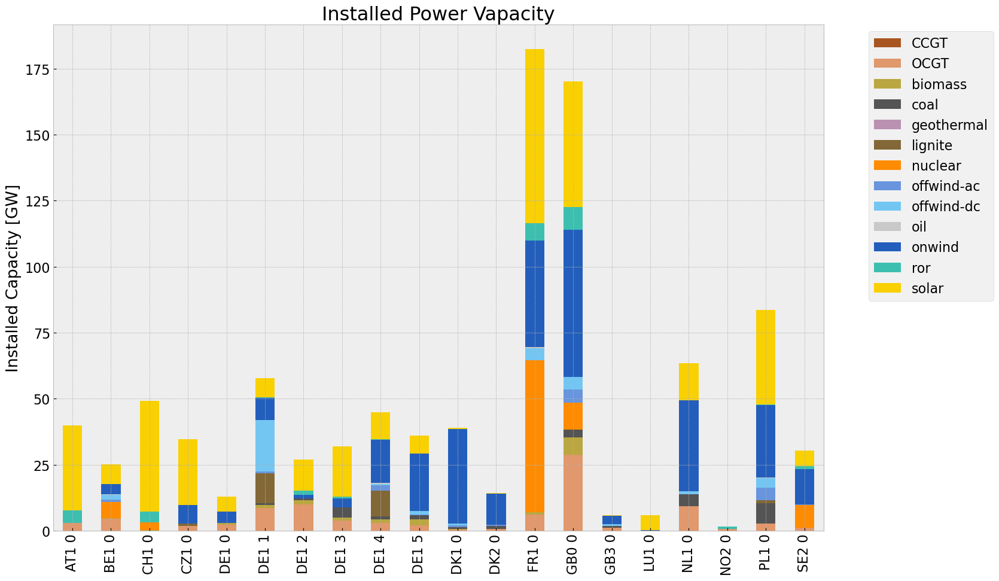

<Figure size 640x480 with 0 Axes>

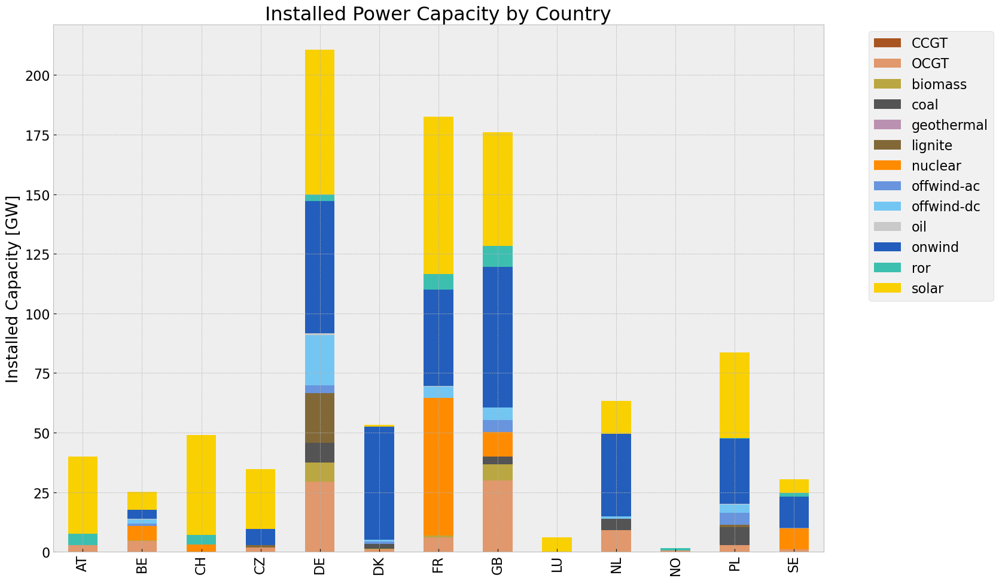

<Figure size 640x480 with 0 Axes>

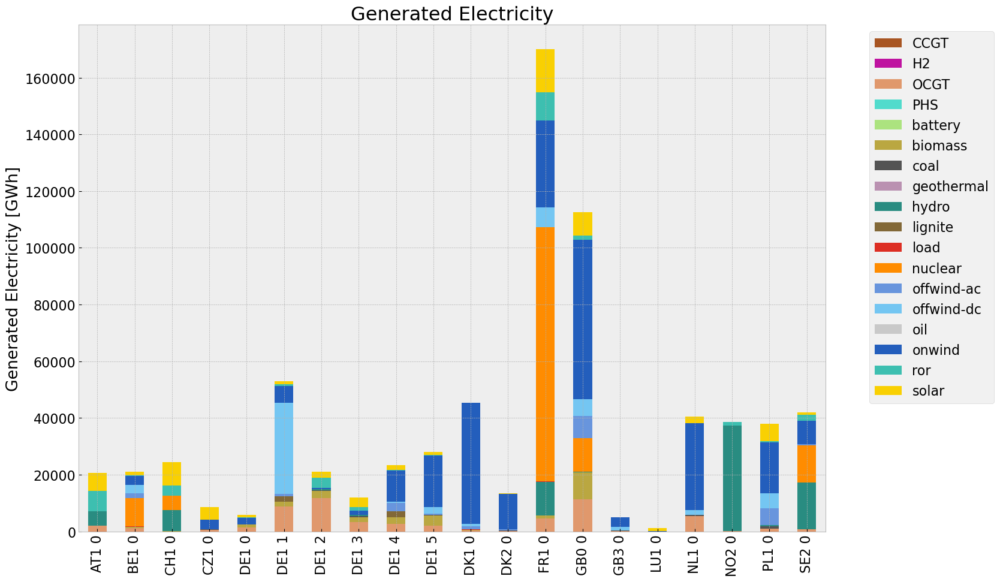

<Figure size 640x480 with 0 Axes>

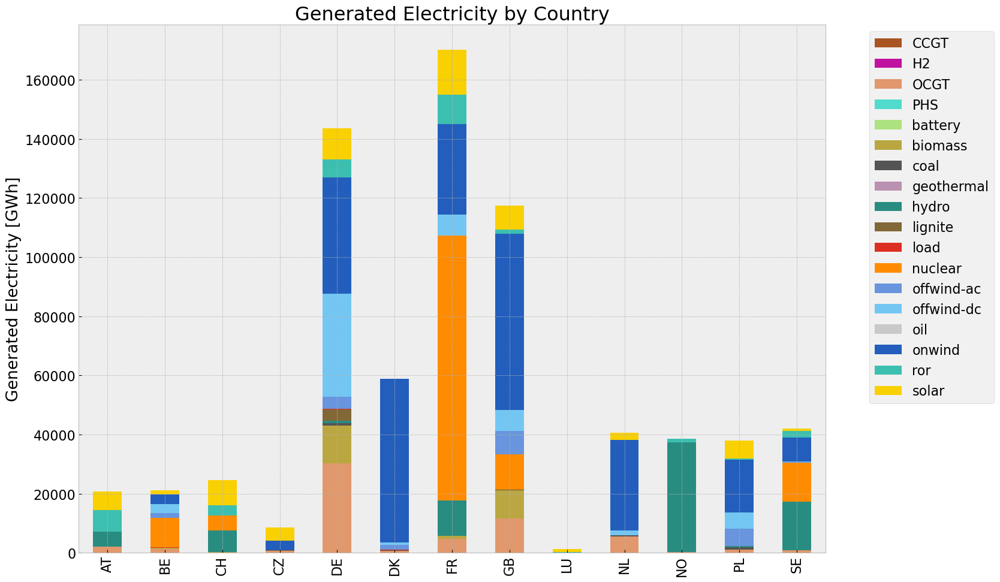

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18236\3440809909.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18236\3440809909.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18236\3440809909.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18236\3440809909.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='3H')
c:\Users\

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000e+00
OCGT,5.846210e+07,0.451621,0.1980,2.563100e+07
biomass,2.414229e+07,0.468000,0.0000,0.000000e+00
coal,2.530950e+06,0.329908,0.3361,2.578453e+06
geothermal,0.000000e+00,1.000000,0.1200,0.000000e+00
lignite,4.150001e+06,0.337285,0.4069,5.006557e+06
load,5.637157e+05,1.000000,0.0000,0.000000e+00
nuclear,1.298950e+08,0.326600,0.0000,0.000000e+00
offwind-ac,2.128545e+07,1.000000,0.0000,0.000000e+00


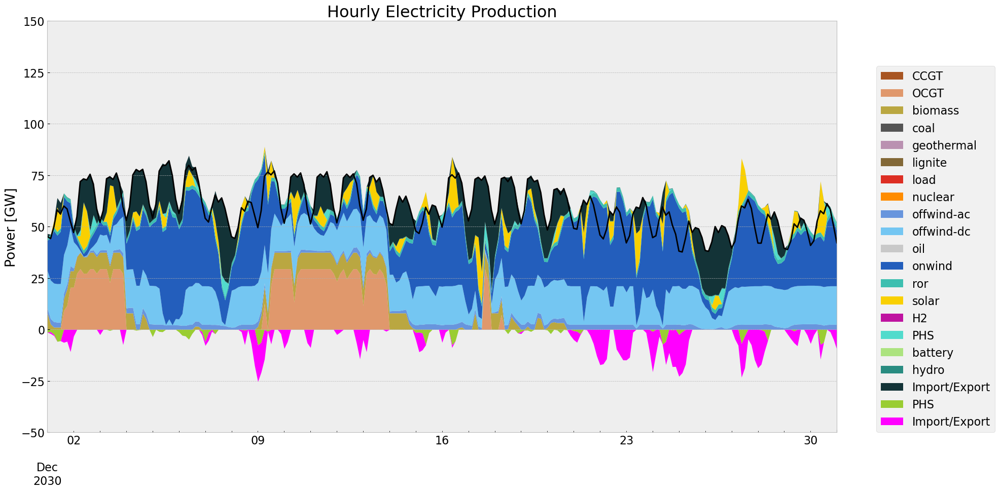

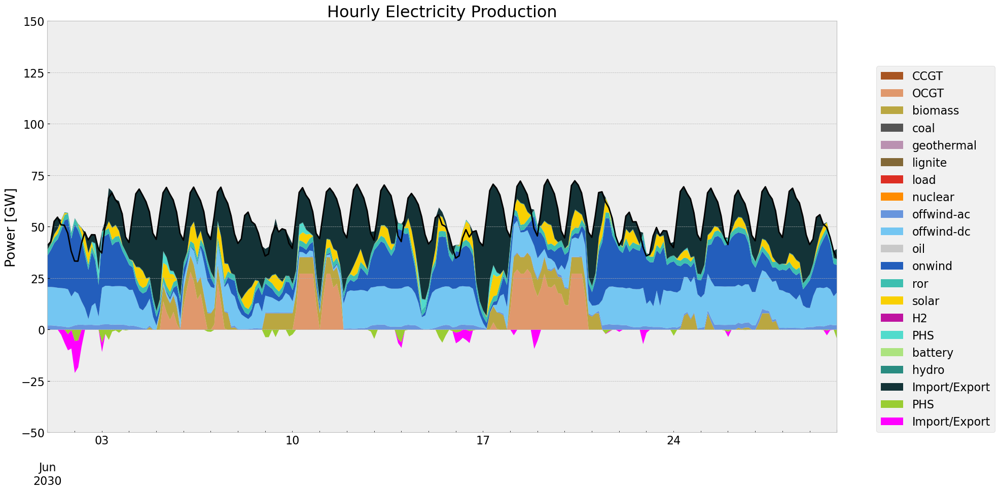

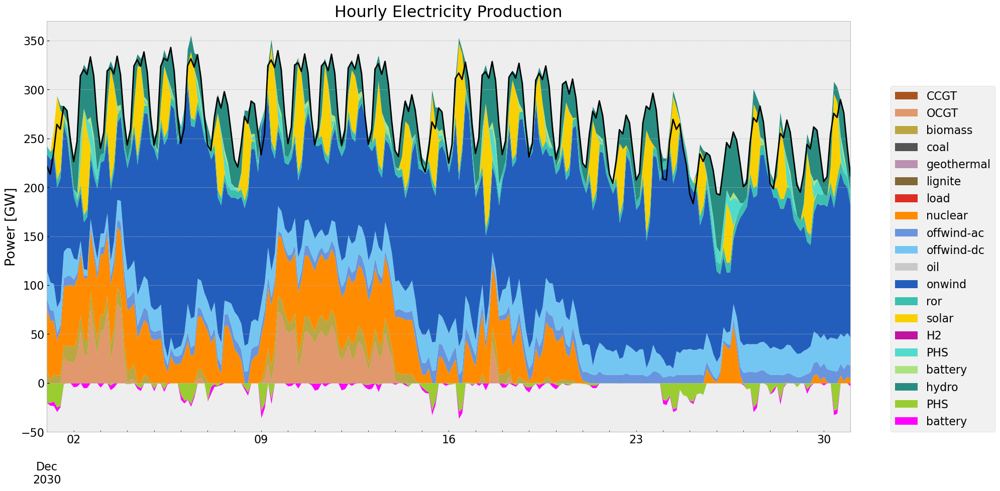

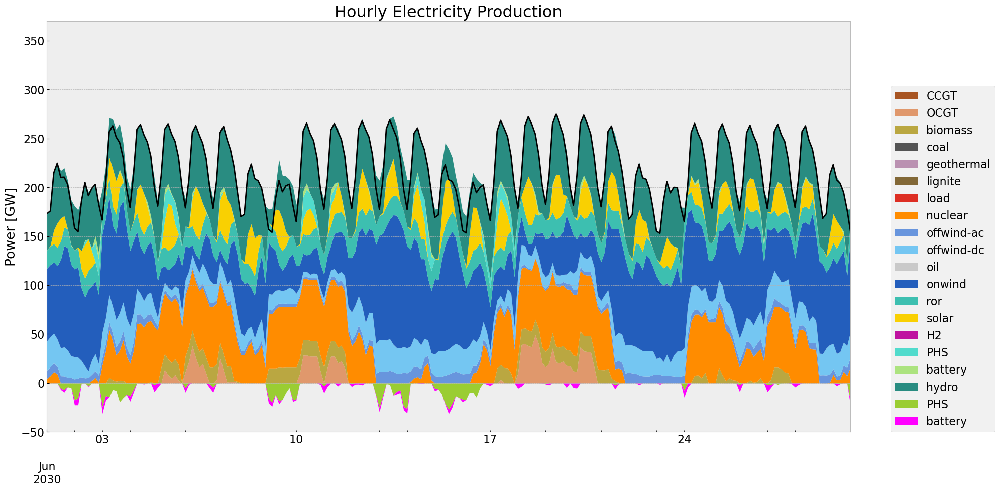

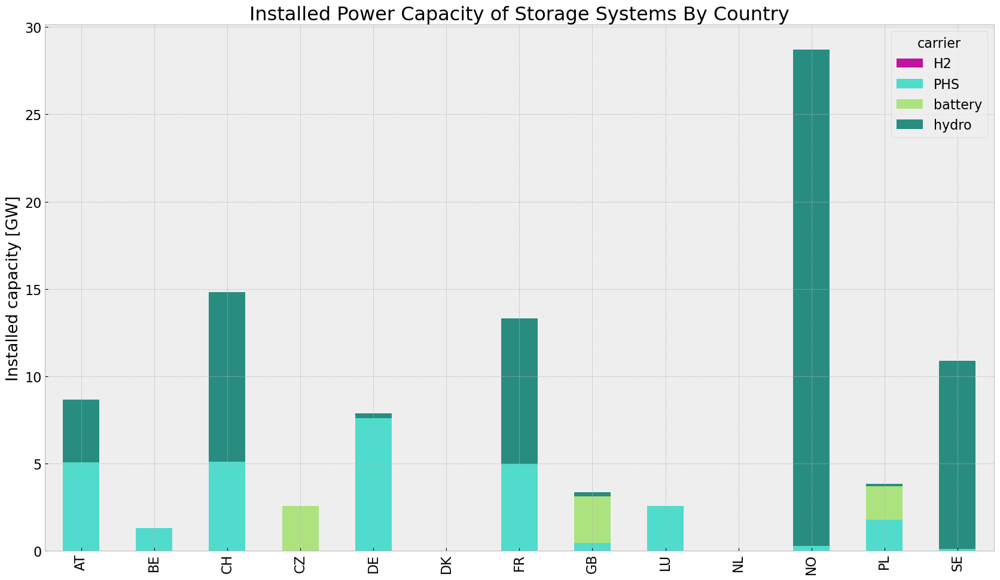

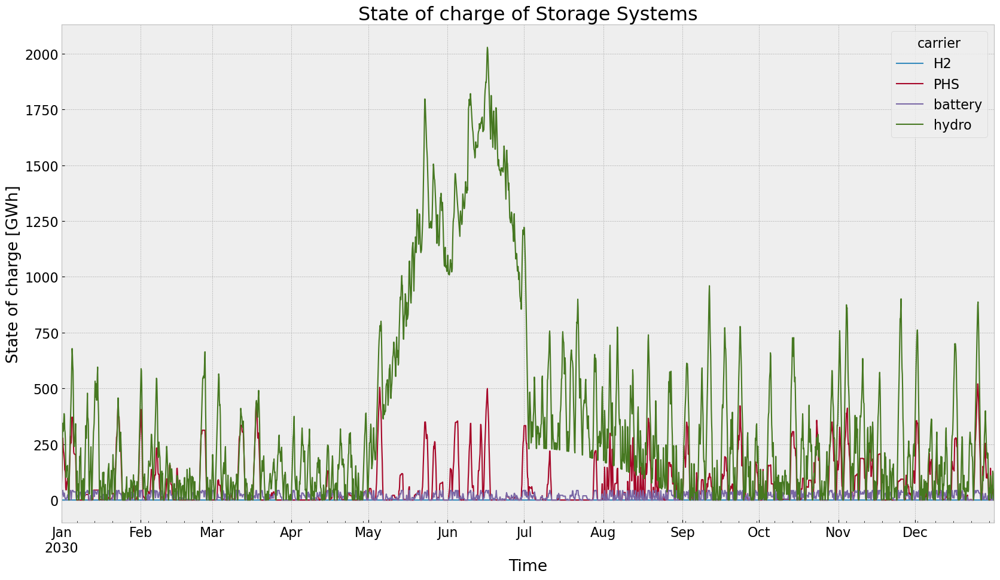

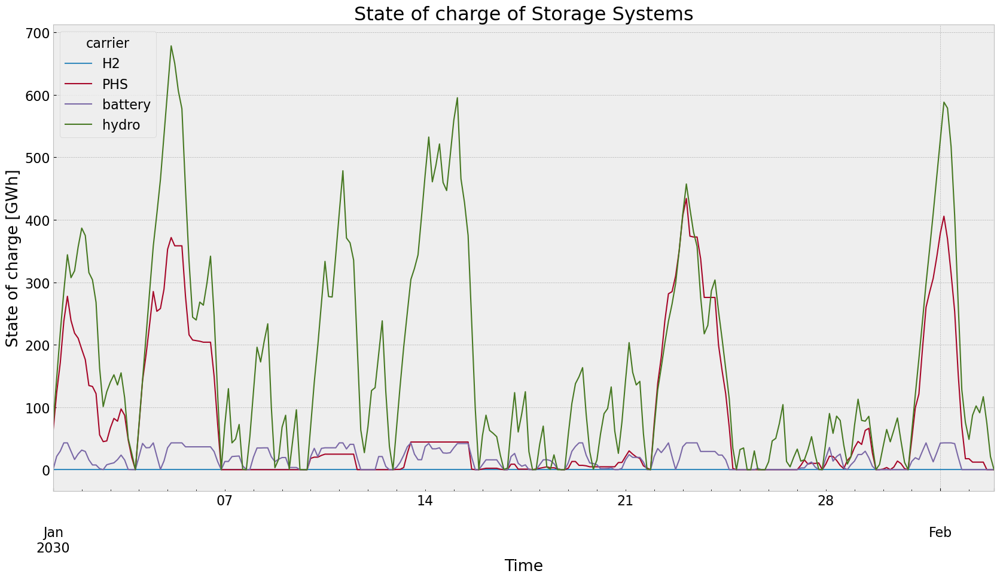

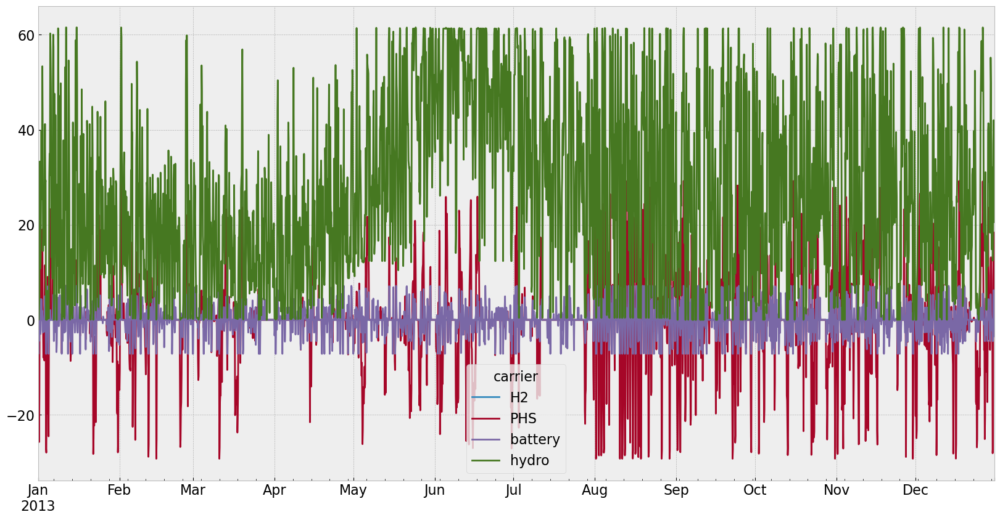

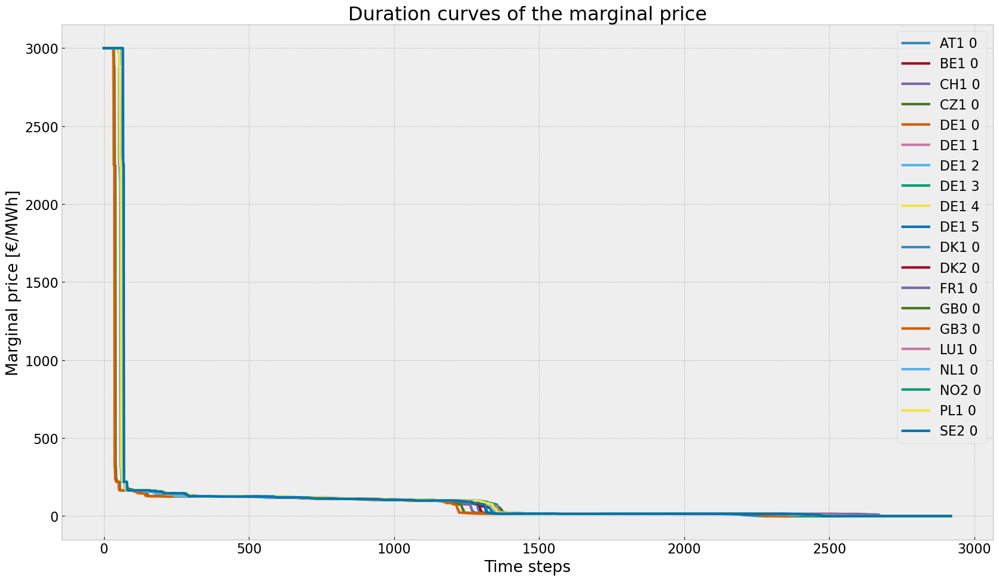

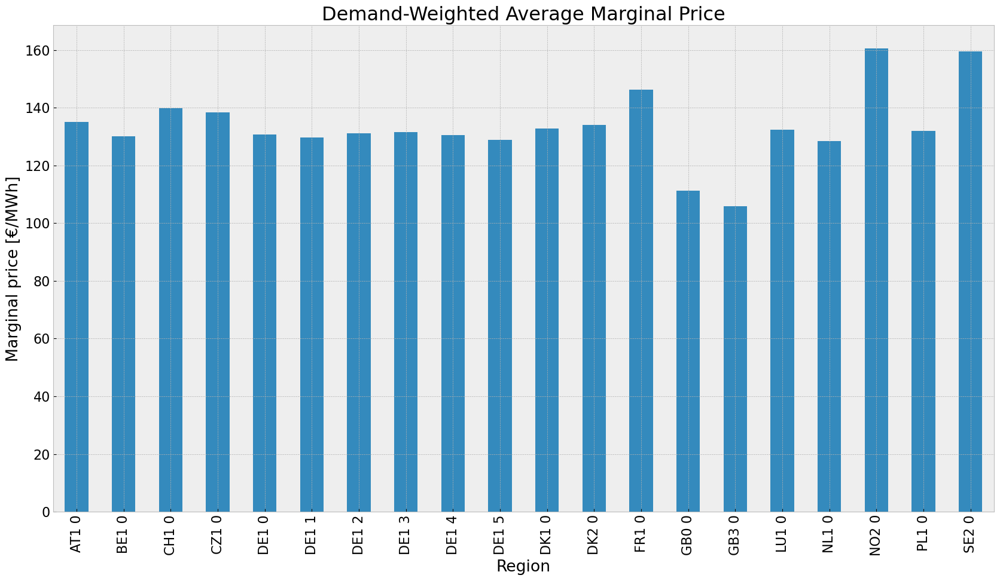

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


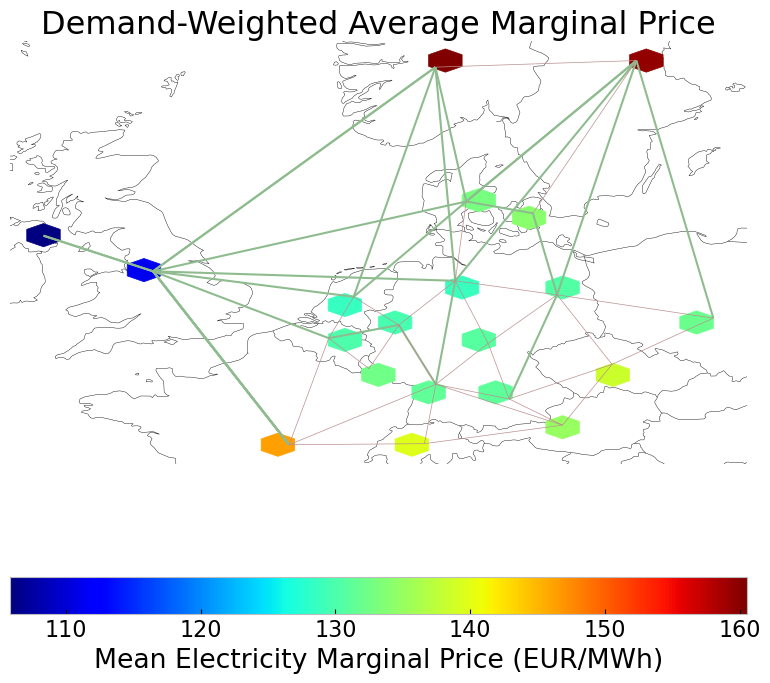

In [184]:

#capacities_noinv_roll = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_noinv_roll.fillna(0, inplace=True)
#gen = (capacities_noinv_roll.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_inv_roll = inst_cap_table(n4, color_cap)
cap_inv_roll_country = inst_cap_table_country(n4, color_cap)

#Generation table
# consolidated generation table
#carrier = n3.generators.carrier.unique()
#df_tot_generation = n3.generators_t.p.sum()

#generations = pd.Series(index = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
       # key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
               # generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
            #except KeyError:
                #print('error')
#generations.fillna(0, inplace=True)

#gen_noinv_roll =(generations.unstack()/1000)#GWh

gen_inv_roll  = gen_power_table(n4)
gen_inv_roll_country = gen_power_table_country(n4)

#Snapshot Summer and Winter
#p = n3.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
#sto = n3.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)    

gen_curve(n4, '2030-12-01', '2030-12-31', colors_gen,'DE')
gen_curve(n4, '2030-06-01', '2030-06-30', colors_gen,'DE')
#generation curve all countries
#winter
gen_curve_tot(n4, '2030-12-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n4, '2030-06-01', '2030-06-30', colors_gen)

#installed storage unit & stores
store_inv_roll = inst_store_table(n4)

#State of Charge Storage unit
state_of_charge_plot(n4, '2030-01-01 00:00', '2030-12-31 21:00')
state_of_charge_plot(n4, '2030-01-01 00:00', '2030-02-02 21:00')
n4.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3).loc[pd.date_range(start="2013-01-01", end="2013-12-31",freq='3H')].plot(figsize=(20,10))


#Electricitty Price duration curve
price_dur_curve_plot(n4)

#avg electricity price
price_regions_table(n4)
price_regions(n4)

#Emission
em_inv_roll =em_table(n4)
em_inv_roll

In [185]:
#e_balance = n3.statistics.energy_balance(aggregate_time=False, aggregate_bus=False).loc[:, :, "AC", :]
#e_balance.head()
#e_balance.to_csv('energy_balance_DE_offwind.csv', sep=',', index=True, header=True, encoding='utf-8')

# Scenario Analysis

## Installed Capacity

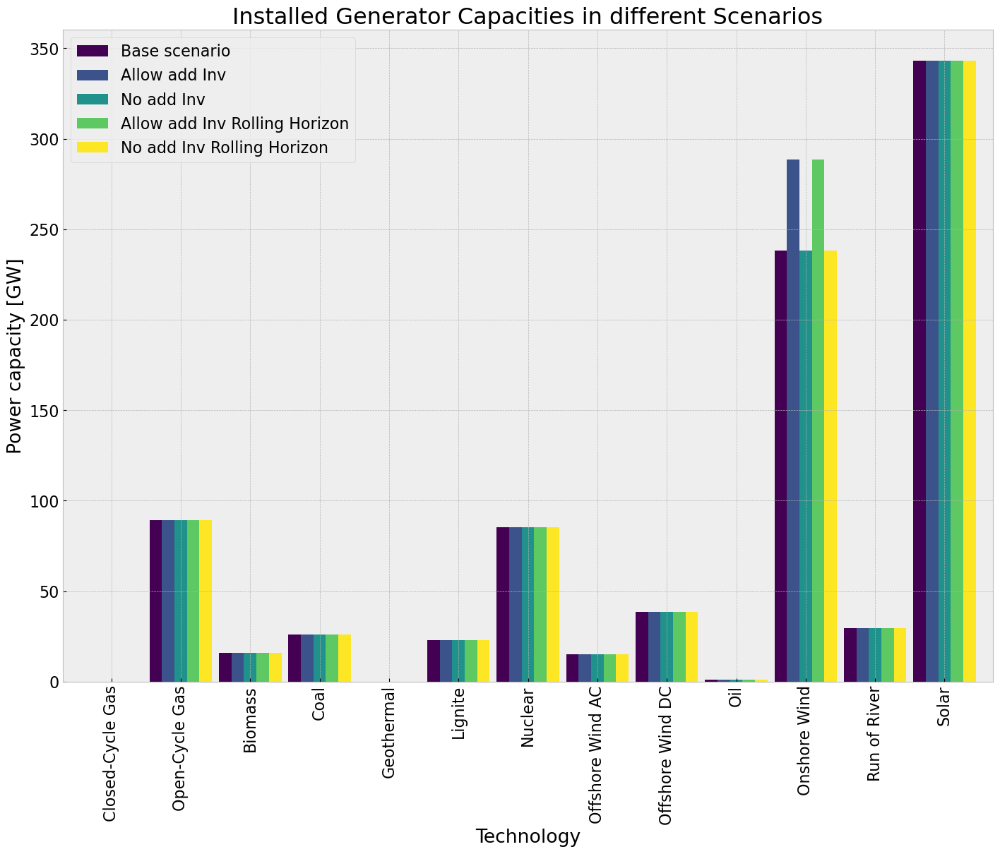

In [186]:
comp_inst_cap = pd.DataFrame(index=capacities_base.unstack().drop(columns=['load'],inplace=False).columns)

comp_inst_cap["Base scenario"] = capacities_base.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["Allow add Inv"] = capacities_inv.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["No add Inv"] = capacities_noinv.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["Allow add Inv Rolling Horizon"] = capacities_inv_roll.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["No add Inv Rolling Horizon"] = capacities_noinv_roll.groupby("carrier").sum().div(1e3).drop(index="load")

comp_inst_cap.rename(index = {"coal": "Coal"}, inplace=True)
comp_inst_cap.rename(index = {"OCGT": "Open-Cycle Gas"}, inplace=True)
comp_inst_cap.rename(index = {"CCGT": "Closed-Cycle Gas"}, inplace=True)
comp_inst_cap.rename(index = {"ror": "Run of River"}, inplace=True)
comp_inst_cap.rename(index = {"offwind-ac": "Offshore Wind AC"}, inplace=True)
comp_inst_cap.rename(index = {"offwind-dc": "Offshore Wind DC"}, inplace=True)
comp_inst_cap.rename(index = {"onwind": "Onshore Wind"}, inplace=True)
comp_inst_cap.rename(index = {"solar": "Solar"}, inplace=True)
comp_inst_cap.rename(index = {"oil": "Oil"}, inplace=True)
comp_inst_cap.rename(index = {"geothermal": "Geothermal"}, inplace=True)
comp_inst_cap.rename(index = {"nuclear": "Nuclear"}, inplace=True)
comp_inst_cap.rename(index = {"biomass": "Biomass"}, inplace=True)
comp_inst_cap.rename(index = {"lignite": "Lignite"}, inplace=True)

comp_inst_cap.fillna(0, inplace=True)

comp_inst_cap.plot.bar(figsize=(17,12),
                        color=cm.viridis(np.linspace(0, 1, len(comp_inst_cap.columns))),
                        grid=True,
                        xlabel="Technology",
                        ylabel="Power capacity [GW]",
                        title=f"Installed Generator Capacities in different Scenarios",
                        #ylim=[0,350],
                        width=0.9
)
plt.show()

### Analysis of extendable Generators

Extendable Generators: OCGT, Offshore Wind AC and DC, Onshore Wind, Solar

{'AC': '#70af1d', 'DC': '#8a1caf', 'biomass': '#baa741', 'coal': '#545454', 'lignite': '#826837', 'oil': '#c9c9c9', 'onwind': '#235ebc', 'nuclear': '#ff8c00', 'offwind-dc': '#74c6f2', 'offwind-ac': '#6895dd', 'OCGT': '#e0986c', 'CCGT': '#a85522', 'geothermal': '#ba91b1', 'solar': '#f9d002', 'hydro': '#298c81', 'PHS': '#51dbcc', 'ror': '#3dbfb0', '': '', 'battery': '#ace37f', 'H2': '#bf13a0', 'load': '#dd2e23'}


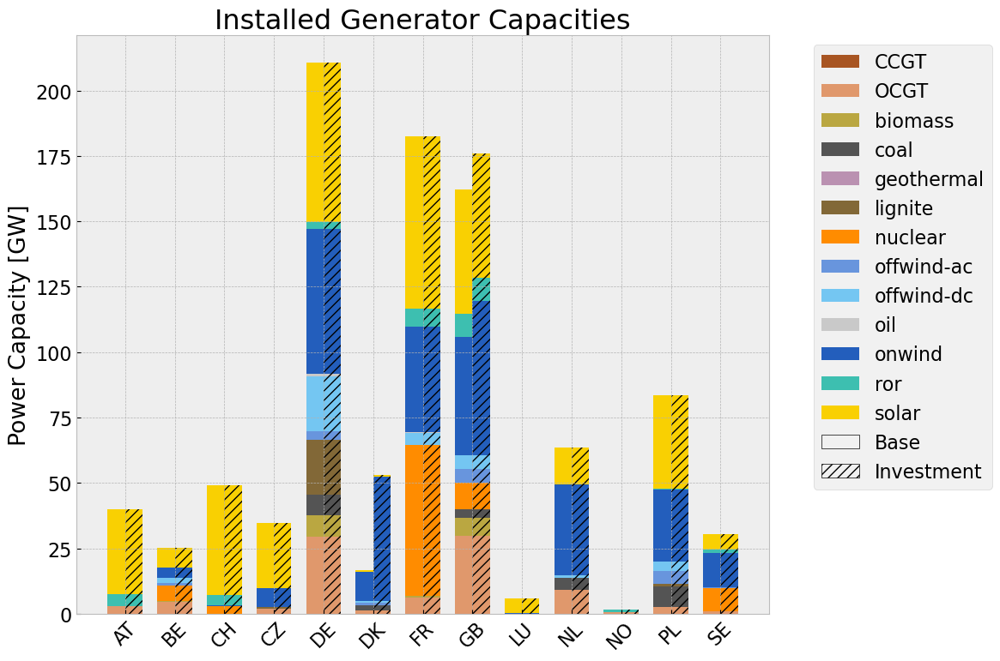

In [187]:
from matplotlib.patches import Patch

color_map = {row.name: row['color'] for _, row in n.carriers.iterrows()}
print(color_map)

base = cap_base_country
base.fillna(0, inplace=True)
inv = cap_inv_country
inv.fillna(0, inplace=True)

# Color mapping for generator types
color_map = {row.name: row['color'] for _, row in n.carriers.iterrows()}

# Setting up bar plot parameters
bar_width = 0.35
indices = np.arange(len(base.index))
base_indices = indices - bar_width / 2  # Shift slightly to the left
inv_indices = indices + bar_width / 2  # Shift slightly to the right

# Plot configuration
fig, ax = plt.subplots(figsize=(12, 8))

# Helper function to plot stacked bars with consistent colors
def plot_stack(ax, index, data, width, label_prefix, hatch_pattern):
    """Helper function to plot stacked bars."""
    bottom = np.zeros(len(index))
    for generator in data.columns:
        color = color_map.get(generator, "#7f7f7f")  # Default to grey if not specified
        ax.bar(index, data[generator], width, bottom=bottom, label=f'{generator}' if index is base_indices else "", color=color, hatch=hatch_pattern)
        bottom += data[generator]

# Plot the base DataFrame (no hatching)
plot_stack(ax, base_indices, base, bar_width, 'Base', '')

# Plot the inv DataFrame (with hatching)
plot_stack(ax, inv_indices, inv, bar_width, 'Inv', '///')

# Create custom legend entries for base and inv
custom_legend = [
    Patch(facecolor='none', edgecolor='black', label='Base', hatch=''),
    Patch(facecolor='none', edgecolor='black', label='Investment', hatch='///')
]

# Combine generator-specific legend entries with custom entries for base/inv
handles = ax.get_legend_handles_labels()[0] + custom_legend

# Add legend outside the chart to the right
ax.legend(handles=handles, bbox_to_anchor=(1.05, 1), loc='upper left')

# Adjust tick labels and grid
ax.set_title('Installed Generator Capacities')
ax.set_xticks(indices)
ax.set_xticklabels(base.index, rotation=45)
ax.set_ylabel('Power Capacity [GW]')
ax.grid(axis='y', linestyle='--', linewidth=0.5)

# Display the plot
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_cap_base_vs_inv.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)


plt.show()

## Power Generation

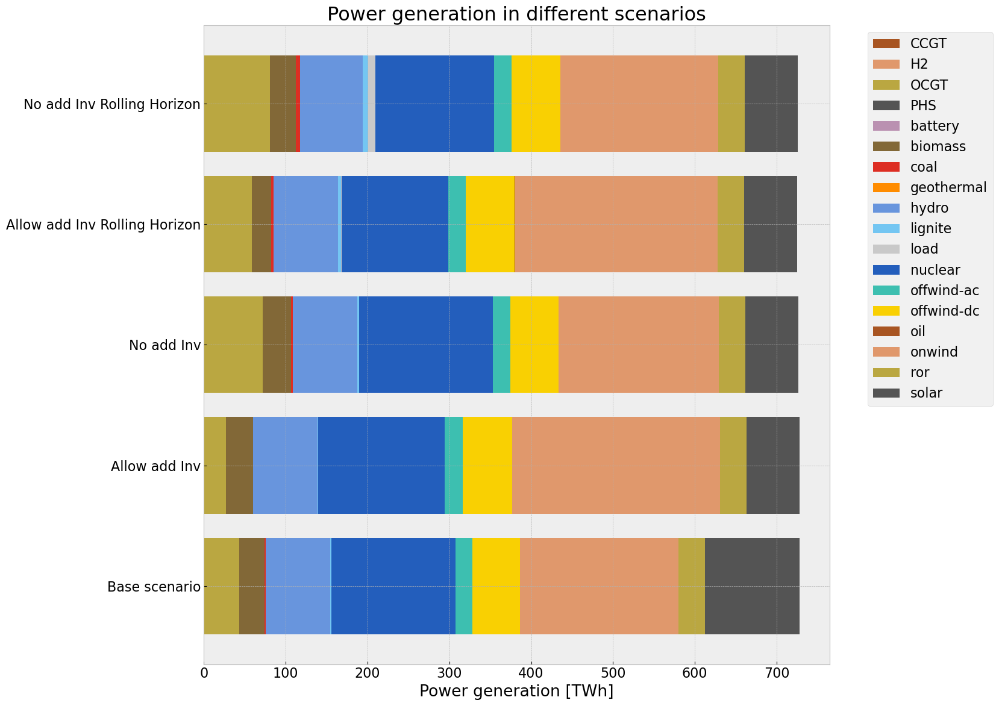

In [188]:
comp_gen_electr = pd.DataFrame(index = ["Base scenario", "Allow add Inv", "No add Inv", "Allow add Inv Rolling Horizon","No add Inv Rolling Horizon"],
                                columns = gen_base.columns.tolist())

comp_gen_electr.loc["Base scenario"] = gen_base.sum().div(1e3) # TWh/a
comp_gen_electr.loc["Allow add Inv"] = gen_inv.sum().div(1e3) # TWh/a
comp_gen_electr.loc["No add Inv"] = gen_noinv.sum().div(1e3) # TWh/a
comp_gen_electr.loc["Allow add Inv Rolling Horizon"] = gen_inv_roll.sum().div(1e3) # TWh/a
comp_gen_electr.loc["No add Inv Rolling Horizon"] = gen_noinv_roll.sum().div(1e3) # TWh/a



#comp_gen_electr.rename(columns = {"coal": "Coal"}, inplace=True)
#comp_gen_electr.rename(columns = {"gas": "Gas"}, inplace=True)
#comp_gen_electr.rename(columns = {"hydro": "Hydro"}, inplace=True)
#comp_gen_electr.rename(columns = {"offwind": "Offshore Wind"}, inplace=True)
#comp_gen_electr.rename(columns = {"onwind": "Onshore Wind"}, inplace=True)
#comp_gen_electr.rename(columns = {"solar": "Solar"}, inplace=True)
#comp_gen_electr.rename(columns = {"oil": "Oil"}, inplace=True)
#comp_gen_electr.rename(columns = {"geothermal": "Geothermal"}, inplace=True)
#comp_gen_electr.rename(columns = {"nuclear": "Nuclear"}, inplace=True)

#define color dict for tech
color_dict = {}

for index, row in n.carriers.iterrows():
    key = index
    value = row['color']
    color_dict[key] = value

#color list
colors = [color_dict[cat] for cat in gen_base.columns]

comp_gen_electr.fillna(0, inplace=True)
comp_gen_electr.plot.barh(figsize=(17,12),
                        color=colors_gen_table,
                        grid=True,
                        stacked=True, 
                        ylabel="",
                        xlabel="Power generation [TWh]",
                        title=f"Power generation in different scenarios",
                        #xlim=[0,200],
                        width=0.8
)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_generation.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)

plt.show()

In [189]:
gen_base_country

carrier,CCGT,H2,OCGT,PHS,battery,biomass,coal,geothermal,hydro,lignite,load,nuclear,offwind-ac,offwind-dc,oil,onwind,ror,solar
country,,,,,,,,,,,,,,,,,,
AT,0.0,0.000000e+00,865.913020,0.0,0.000000e+00,0.000000,0.000000,0.0,5159.572357,0.000000,0.0,0.000000,0.000000,0.000000,0.0000,0.000000,7289.373361,11081.348849
BE,0.0,0.000000e+00,964.228580,0.0,0.000000e+00,550.818142,0.000000,0.0,15.561361,0.000000,0.0,10896.408902,1552.588919,2989.766793,0.1586,3276.916266,107.989508,2339.185549
CH,0.0,0.000000e+00,0.000000,0.0,0.000000e+00,202.130398,0.000000,0.0,7392.903573,0.000000,0.0,6594.387467,0.000000,0.000000,0.0000,6.091979,3442.839747,14474.407060
CZ,0.0,0.000000e+00,1346.566258,0.0,0.000000e+00,0.000000,10.455368,0.0,0.000000,94.325523,0.0,0.000000,0.000000,0.000000,0.0000,3259.437699,0.000000,7847.710205
DE,0.0,0.000000e+00,22466.799593,0.0,1.182627e-15,18076.525851,105.900941,0.0,684.373518,1241.305060,0.0,0.000000,4056.063264,33566.237627,0.0000,40059.017877,6073.578830,19302.588478
DK,0.0,0.000000e+00,211.701190,0.0,0.000000e+00,233.939982,22.759697,0.0,0.000000,0.000000,0.0,0.000000,1649.940166,897.453503,0.0000,13096.157670,0.000000,204.423977
FR,0.0,0.000000e+00,2692.681977,0.0,0.000000e+00,1244.916182,0.000000,0.0,11867.601851,0.000000,0.0,99951.028379,0.000000,7024.052927,0.2540,30576.699143,9941.330996,26361.204826
GB,0.0,6.894561e-15,10159.546543,0.0,0.000000e+00,10617.356617,13.811947,0.0,35.717467,0.000000,0.0,13132.799823,7879.077814,6887.799427,0.0000,45407.846498,1527.470592,15297.643987
LU,0.0,0.000000e+00,0.000000,0.0,0.000000e+00,15.525340,0.000000,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.0000,61.341917,71.195324,1819.481971


## Installed Storage Capacities

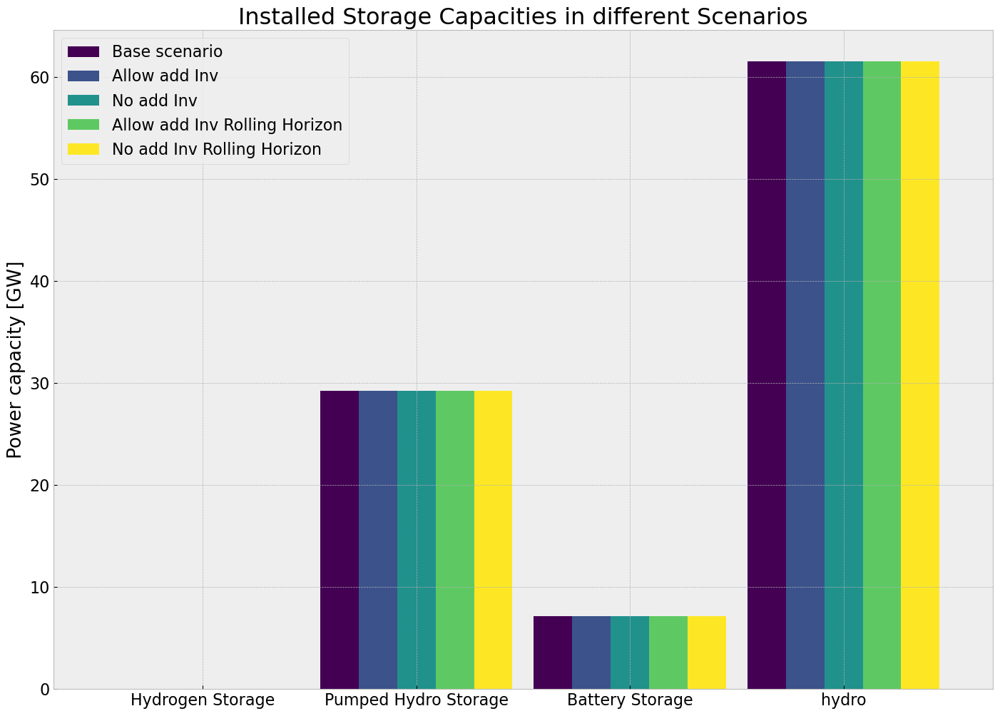

In [190]:
comp_inst_store = pd.DataFrame(index=store_base.unstack().columns)
comp_inst_store.index.name = ''

comp_inst_store["Base scenario"] = store_base.groupby("carrier").sum()
comp_inst_store["Allow add Inv"] = store_inv.groupby("carrier").sum()
comp_inst_store["No add Inv"] = store_noinv.groupby("carrier").sum()
comp_inst_store["Allow add Inv"] = store_inv_roll.groupby("carrier").sum()
comp_inst_store["Allow add Inv Rolling Horizon"] = store_inv_roll.groupby("carrier").sum()
comp_inst_store["No add Inv Rolling Horizon"] = store_noinv_roll.groupby("carrier").sum()

comp_inst_store.rename(index = {"battery": "Battery Storage"}, inplace=True)
comp_inst_store.rename(index = {"H2": "Hydrogen Storage"}, inplace=True)
comp_inst_store.rename(index = {"Hydro": "Reservoir & Dam"}, inplace=True)
comp_inst_store.rename(index = {"PHS": "Pumped Hydro Storage"}, inplace=True)


comp_inst_store.fillna(0, inplace=True)

comp_inst_store.plot.bar(figsize=(17,12),
                        color=cm.viridis(np.linspace(0, 1, len(comp_inst_store.columns))),
                        grid=True,
                        #xlabel="Technology",
                        ylabel="Power capacity [GW]",
                        title=f"Installed Storage Capacities in different Scenarios",
                        #ylim=[0,350],
                        width=0.9
)
plt.xticks(rotation=360, ha='center')
fig.tight_layout()
# Save plot to the current working directory
filename = "analysis_installed_cap.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)

plt.show()

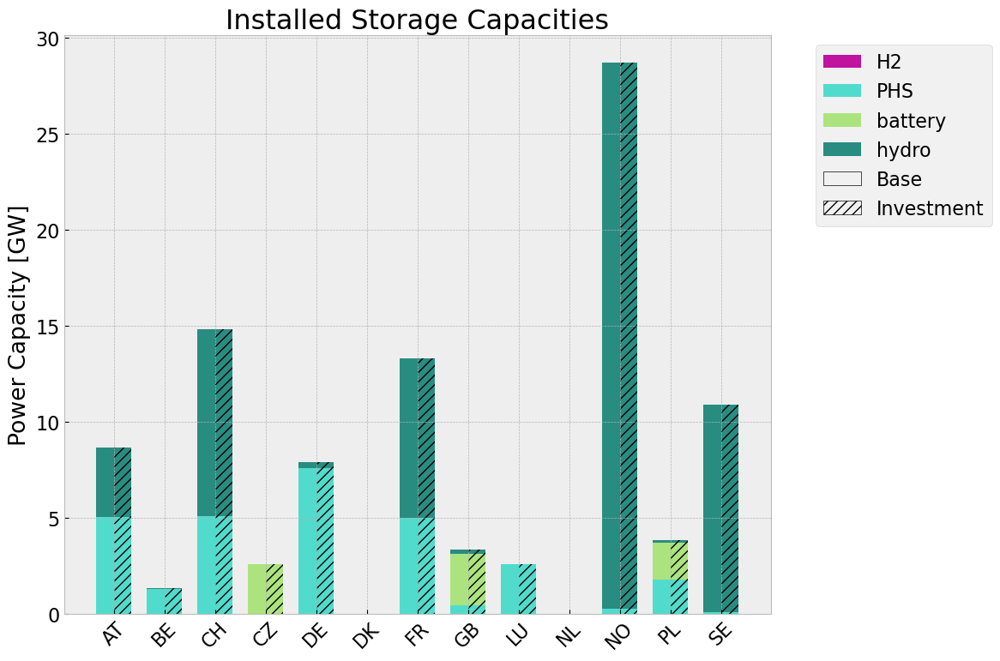

In [191]:
store_base_df = store_base.unstack()
store_inv_df = store_inv.unstack()

store_base_df.fillna(0, inplace=True)
store_inv_df.fillna(0, inplace=True)

# Setting up bar plot parameters
bar_width = 0.35
indices = np.arange(len(store_base_df.index))
base_indices = indices - bar_width / 2  # Shift slightly to the left
inv_indices = indices + bar_width / 2  # Shift slightly to the right

# Plot configuration
fig, ax = plt.subplots(figsize=(12, 8))

# Helper function to plot stacked bars with consistent colors
def plot_stack(ax, index, data, width, label_prefix, hatch_pattern):
    """Helper function to plot stacked bars."""
    bottom = np.zeros(len(index))
    for generator in data.columns:
        color = color_map.get(generator, "#7f7f7f")  # Default to grey if not specified
        ax.bar(index, data[generator], width, bottom=bottom, label=f'{generator}' if index is base_indices else "", color=color, hatch=hatch_pattern)
        bottom += data[generator]

# Plot the base DataFrame (no hatching)
plot_stack(ax, base_indices, store_base_df, bar_width, 'Base', '')

# Plot the inv DataFrame (with hatching)
plot_stack(ax, inv_indices, store_inv_df, bar_width, 'Inv', '///')

# Create custom legend entries for base and inv
custom_legend = [
    Patch(facecolor='none', edgecolor='black', label='Base', hatch=''),
    Patch(facecolor='none', edgecolor='black', label='Investment', hatch='///')
]

# Combine generator-specific legend entries with custom entries for base/inv
handles = ax.get_legend_handles_labels()[0] + custom_legend

# Add legend outside the chart to the right
ax.legend(handles=handles, bbox_to_anchor=(1.05, 1), loc='upper left')

# Adjust tick labels and grid
ax.set_title('Installed Storage Capacities')
ax.set_xticks(indices)
ax.set_xticklabels(base.index, rotation=45)
ax.set_ylabel('Power Capacity [GW]')
ax.grid(axis='y', linestyle='--', linewidth=0.5)

# Display the plot
fig.tight_layout()

# Save plot to the current working directory
filename = "analyis_storagecap_base_vs_inv.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)
plt.show()


## System Cost

In [192]:
tech_comp = system_cost_base.index.tolist()
comp_system_cost = pd.DataFrame(index = ["Base scenario", "Allow add Inv", "No add Inv", "Allow add Inv Rolling Horizon","No add Inv Rolling Horizon"],
                                columns =tech_comp)

#demand = n.snapshot_weightings.generators @ n.loads_t.p_set.sum(axis=1) # the same in each scenario

comp_system_cost.loc["Base scenario"] = system_cost_base # Million €/a
comp_system_cost.loc["Allow add Inv"] = system_cost_inv # Million €/a
#if tot_cost_0_PV > 0: 
#    comp_system_cost.loc["0% PV potential"] = system_cost_0_PV # Million €/a
#else: comp_system_cost.loc["0% PV potential"] = 0.0
#if tot_cost_20_PV > 0: 
#    comp_system_cost.loc["20% PV potential"] = system_cost_20_PV # Million €/a
#else: comp_system_cost.loc["20% PV potential"] = 0.0
comp_system_cost.loc["No add Inv"] = system_cost_noinv # Million €/a
comp_system_cost.loc["Allow add Inv Rolling Horizon"] = system_cost_inv_roll
comp_system_cost.loc["No add Inv Rolling Horizon"] = system_cost_noinv_roll # Million €/a

#if 'AC' in system_cost_base:
#   comp_system_cost.AC = comp_system_cost.AC-system_cost_base.AC # expenditure for already existing transmission lines

#comp_system_cost[comp_system_cost<0] = 0 # since we subtact the AC cost (for the 0% or 20%) 
comp_system_cost.drop('-', axis=1, inplace=True)
#comp_system_cost.iloc[0,0] = system_cost_base.AC


#comp_system_cost = comp_system_cost   #Million eur0/

#comp_system_cost.rename(columns = {"battery storage": "Battery storage"}, inplace=True)
#comp_system_cost.rename(columns = {"hydrogen storage underground": "Hydrogen storage underground"}, inplace=True)

comp_system_cost.fillna(0, inplace=True)
comp_system_cost = comp_system_cost.div(1e3) # Billion €

#move load shedding to the last col
# Specify the column name to move
column_to_move = 'Load shedding'

# Create a new list of column names without the column to move
new_columns = [col for col in comp_system_cost.columns if col != column_to_move]

# Append the column to move to the end
new_columns.append(column_to_move)

# Reorder the columns
comp_system_cost = comp_system_cost[new_columns]


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18236\3411115089.py:5: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if comp_system_cost.columns[i] == n.carriers.nice_name[j]:
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18236\3411115089.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_comp.append(n.carriers.color[j])


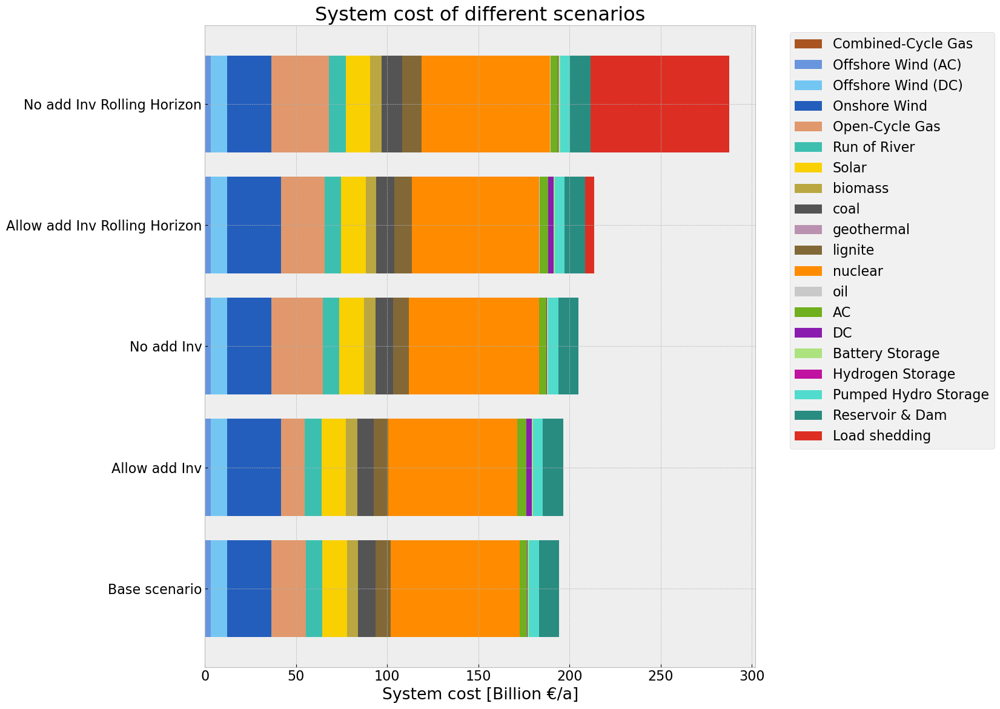

In [193]:
colors_comp = []

for i in range(len(comp_system_cost.columns)):
    for j in range(len(n.carriers.nice_name)):
        if comp_system_cost.columns[i] == n.carriers.nice_name[j]:
            colors_comp.append(n.carriers.color[j])
            #print(n.carriers.nice_name[j],comp_system_cost.columns[i],n.carriers.color[j])
            break  # break the inner loop once a match is found  



comp_system_cost.plot.barh(figsize=(17,12),
                        color=colors_comp,
                        grid=True,
                        stacked=True,
                        ylabel="",
                        xlabel="System cost [Billion €/a]",
                        title=f"System cost of different scenarios",
                        #xlim=[0,100],
                        width=0.8
)
# Move legend outside of the plot
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_system_cost.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)

plt.show()

## Curtailment

In [194]:
color_curtailment=[]

for i in range(len(comp_curtailment.columns)):
    for j in range(len(n.carriers.nice_name)):
        if comp_curtailment.columns[i] == n.carriers.nice_name[j]:
            color_curtailment.append(n.carriers.color[j])
            #print(n.carriers.nice_name[j],comp_system_cost.columns[i],n.carriers.color[j])
            break  # break the inner loop once a match is found 

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18236\3109801822.py:5: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if comp_curtailment.columns[i] == n.carriers.nice_name[j]:
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18236\3109801822.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  color_curtailment.append(n.carriers.color[j])


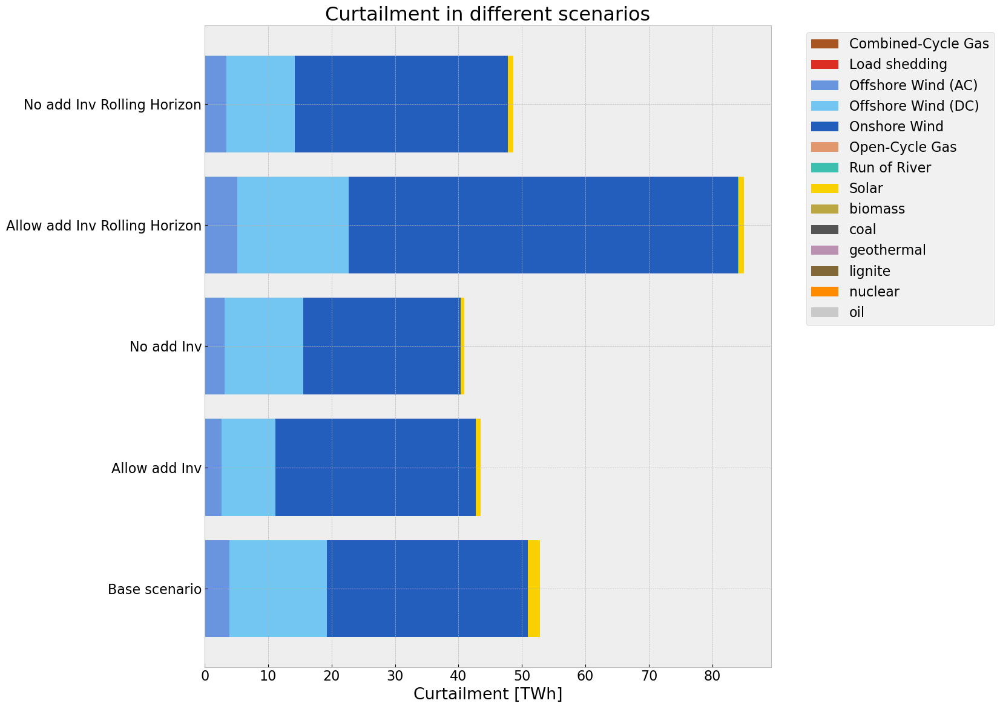

In [195]:
comp_curtailment.plot.barh(figsize=(17,12),
                        color=color_curtailment,
                        grid=True,
                        stacked=True, 
                        ylabel="",
                        xlabel="Curtailment [TWh]",
                        title=f"Curtailment in different scenarios",
                        #xlim=[0,120],
                        width=0.8
)
# Move legend outside of the plot
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_curtailment.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)
plt.show()

## Emission

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18236\1032422005.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_comp.append(n.carriers.color[j])


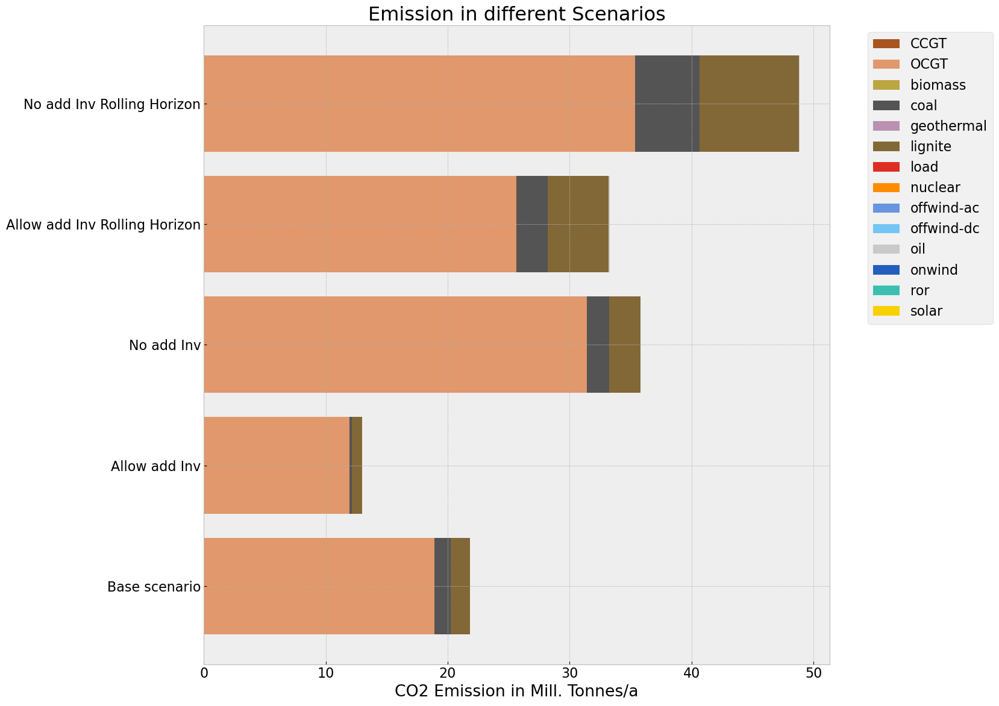

In [196]:
tech_comp = em_base.index.tolist()
comp_system_em = pd.DataFrame(index = ["Base scenario", "Allow add Inv", "No add Inv", "Allow add Inv Rolling Horizon","No add Inv Rolling Horizon"],
                                columns =tech_comp)

#demand = n.snapshot_weightings.generators @ n.loads_t.p_set.sum(axis=1) # the same in each scenario

comp_system_em.loc["Base scenario"] = em_base['emissions in Tonnes CO2']/1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["Allow add Inv"] = em_inv['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["No add Inv"] = em_noinv['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["Allow add Inv Rolling Horizon"] = em_inv_roll['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["No add Inv Rolling Horizon"] = em_noinv_roll['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a

comp_system_em.fillna(0, inplace=True)

colors_comp = []

for i in range(len(comp_system_em.columns)):
    for j in range(len(n.carriers.index)):
        if comp_system_em.columns[i] == n.carriers.index[j]:
            colors_comp.append(n.carriers.color[j])
            #print(n.carriers.nice_name[j],comp_system_cost.columns[i],n.carriers.color[j])
            break  # break the inner loop once a match is found  



comp_system_em.plot.barh(figsize=(17,12),
                        color=colors_comp,
                        grid=True,
                        stacked=True,
                        ylabel="",
                        xlabel="CO2 Emission in Mill. Tonnes/a",
                        title=f"Emission in different Scenarios",
                        #xlim=[0,100],
                        width=0.8
)
#global_constraint
#plt.axvline(x=n.global_constraints.loc['CO2Limit','constant']/1e6, color='r', linestyle='-', linewidth=2, label='CO2 cap')
# Move legend outside of the plot
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_emission.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)
plt.show()

## Transmission Lines

In [197]:
models = [n, n1, n2, n3, n4]

In [198]:
for m in models:
    #create empty df
    trans_df = {
        'Country' : cap_base_country.index,
        'AC': np.zeros(len(cap_base_country.index)),
        'DC': np.zeros(len(cap_base_country.index))
    }

    trans_df = pd.DataFrame(trans_df)
    trans_df.set_index('Country', inplace=True)
    
    #AC
    ac_df = m.lines
    ac_df['country'] = ac_df['bus0'].str[:2]
    ac_df = ac_df.groupby(['country', 'carrier']).s_nom_opt.sum()
    ac_df.fillna(0, inplace=True)
    ac_df = ac_df.unstack().div(1e3) #GVA
            
    #DC
    dc_df = m.links
    dc_df['country'] = dc_df['bus0'].str[:2]
    dc_df = dc_df.groupby(['country', 'carrier']).p_nom_opt.sum()
    dc_df.fillna(0, inplace=True)
    dc_df = dc_df.unstack().div(1e3) #GW

    #fill empty df with AC Cap
    for index, row in trans_df.iterrows():
        if index in ac_df.index:
            try:
                trans_df.loc[index, 'AC'] = ac_df.loc[index, 'AC']
            except KeyError: 
                trans_df.loc[index, 'AC'] = 0

    #fill empty df with DC Cap
    for index, row in trans_df.iterrows():
        if index in dc_df.index:
            try:
                trans_df.loc[index, 'DC'] = dc_df.loc[index, 'DC']
            except KeyError: 
                trans_df.loc[index, 'DC'] = 0


    #trans_df = pd.concat([ac_df, dc_df], axis=1)
    #trans_df.fillna(0, inplace=True)
    globals()[f'trans_{m.name}'] = trans_df

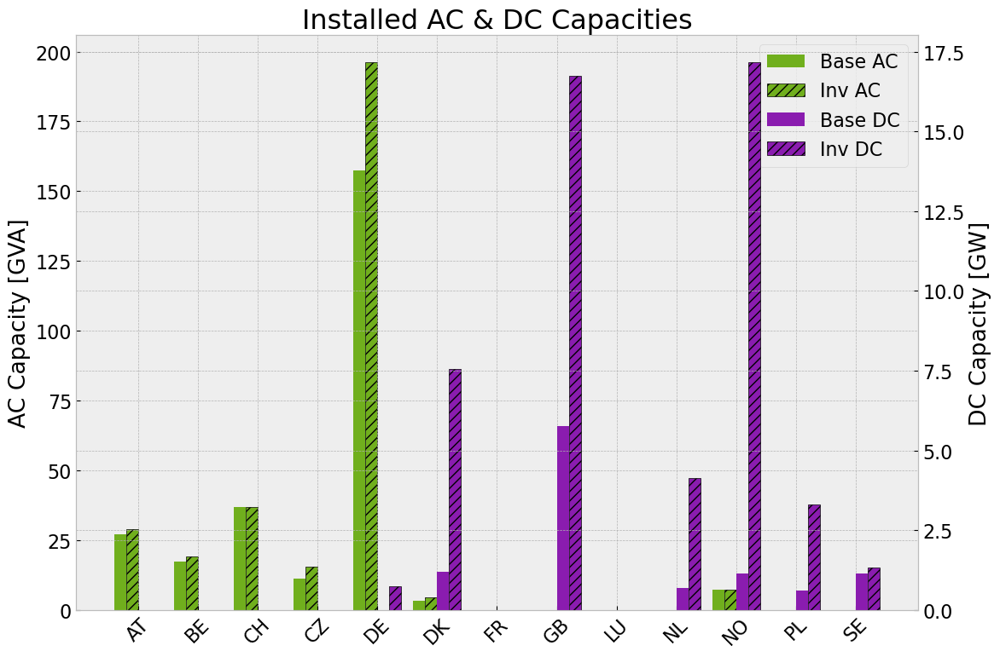

In [199]:
# Setting up bar plot parameters
bar_width = 0.2
indices = np.arange(len(trans_base_pv.index))
base_ac_indices = indices - bar_width * 1.5  # Shift slightly to the left
inv_ac_indices = indices - bar_width * 0.5  # Shift slightly to the right
base_dc_indices = indices + bar_width * 0.5
inv_dc_indices = indices + bar_width * 1.5

# Plot configuration
fig, ax = plt.subplots(figsize=(12, 8))

# Create secondary axis
ax2 = ax.twinx()

# Plot the base DataFrame (no hatching)
ax.bar(base_ac_indices, trans_base_pv.AC, bar_width, color = n.carriers.loc['AC','color'], label='Base AC')
ax2.bar(base_dc_indices, trans_base_pv.DC, bar_width, color = n.carriers.loc['DC','color'], label='Base DC')

# Plot the inv DataFrame (with hatching)
ax.bar(inv_ac_indices, trans_inv_pv.AC, bar_width, label='Inv AC', edgecolor = 'black', color = n.carriers.loc['AC','color'], hatch='///')
ax2.bar(inv_dc_indices, trans_inv_pv.DC, bar_width, label='Inv DC', edgecolor = 'black', color = n.carriers.loc['DC','color'], hatch='///')


# Create custom legend entries for base and inv
custom_legend = [
    Patch(facecolor='none', edgecolor='black', label='Base', hatch=''),
    Patch(facecolor='none', edgecolor='black', label='Investment', hatch='///')
]

# Combine generator-specific legend entries with custom entries for base/inv
handles = ax.get_legend_handles_labels()[0] + ax2.get_legend_handles_labels()[0]

# Add legend outside the chart to the right
ax.legend(handles=handles, bbox_to_anchor=(0.8, 1), loc='upper left')

# Adjust tick labels and grid
ax.set_title('Installed AC & DC Capacities')
ax.set_xticks(indices)
ax.set_xticklabels(trans_base_pv.index, rotation=45)
ax.set_ylabel('AC Capacity [GVA]')
ax2.set_ylabel('DC Capacity [GW]')
ax.grid(axis='y', linestyle='--', linewidth=0.5)

# Display the plot
fig.tight_layout()

# Save plot to the current working directory
filename = "analyis_trans_cap_base_vs_inv.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)
plt.show()

In [200]:
n.lines

,bus0,bus1,v_nom,num_parallel,length,carrier,type,s_max_pu,s_nom,capital_cost,i_nom,s_nom_max,x,r,b,x_pu_eff,r_pu_eff,s_nom_opt,g,s_nom_mod,s_nom_extendable,s_nom_min,build_year,lifetime,terrain_factor,v_ang_min,v_ang_max,sub_network,x_pu,r_pu,g_pu,b_pu,country
Line,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,AT1 0,CH1 0,380.0,4.000000,499.037419,AC,Al/St 240/40 4-bundle 380.0,0.7,6792.410447,21009.386314,2.58,26792.410447,30.690801,3.742781,0.008654,0.000213,0.000026,6792.410447,0.0,0.0,False,0.0,0,inf,1.0,-inf,inf,,0.0,0.0,0.0,0.0,AT
1,AT1 0,CZ1 0,380.0,2.578947,360.022494,AC,Al/St 240/40 4-bundle 380.0,0.7,4379.317262,15158.205183,2.58,24379.317262,34.341737,4.188017,0.004025,0.000238,0.000029,4379.317262,0.0,0.0,False,0.0,0,inf,1.0,-inf,inf,,0.0,0.0,0.0,0.0,AT
10,CZ1 0,DE1 4,380.0,2.000000,405.134372,AC,Al/St 240/40 4-bundle 380.0,0.7,3396.205223,17056.310574,2.58,23396.205223,49.831528,6.077016,0.003513,0.000345,0.000042,3396.205223,0.0,0.0,False,0.0,0,inf,1.0,-inf,inf,,0.0,0.0,0.0,0.0,CZ
11,CZ1 0,PL1 0,380.0,2.578947,412.857336,AC,Al/St 240/40 4-bundle 380.0,0.7,4379.317262,17381.012020,2.58,24379.317262,39.381534,4.802626,0.004616,0.000273,0.000033,4379.317262,0.0,0.0,False,0.0,0,inf,1.0,-inf,inf,,0.0,0.0,0.0,0.0,CZ
12,DE1 0,DE1 2,380.0,7.000000,298.512603,AC,Al/St 240/40 4-bundle 380.0,0.7,11886.718282,12570.226099,2.58,31886.718282,10.490586,1.279340,0.009059,0.000073,0.000009,11886.718282,0.0,0.0,False,0.0,0,inf,1.0,-inf,inf,,0.0,0.0,0.0,0.0,DE
13,DE1 0,DE1 3,380.0,11.000000,276.843868,AC,Al/St 240/40 4-bundle 380.0,0.7,18679.128729,11656.443924,2.58,38679.128729,6.191236,0.755029,0.013203,0.000043,0.000005,18679.128729,0.0,0.0,False,0.0,0,inf,1.0,-inf,inf,,0.0,0.0,0.0,0.0,DE
14,DE1 0,DE1 4,380.0,15.157895,338.264788,AC,Al/St 240/40 4-bundle 380.0,0.7,25739.660641,14243.912489,2.58,45739.660641,5.489756,0.669482,0.022229,0.000038,0.000005,25739.660641,0.0,0.0,False,0.0,0,inf,1.0,-inf,inf,,0.0,0.0,0.0,0.0,DE
15,DE1 0,DE1 5,380.0,6.000000,343.581418,AC,Al/St 240/40 4-bundle 380.0,0.7,10188.615670,14465.224473,2.58,30188.615670,14.086838,1.717907,0.008937,0.000098,0.000012,10188.615670,0.0,0.0,False,0.0,0,inf,1.0,-inf,inf,,0.0,0.0,0.0,0.0,DE
16,DE1 1,DE1 3,380.0,12.578947,333.524322,AC,Al/St 240/40 4-bundle 380.0,0.7,21360.343379,14045.046672,2.58,41360.343379,6.522564,0.795435,0.018189,0.000045,0.000006,21360.343379,0.0,0.0,False,0.0,0,inf,1.0,-inf,inf,,0.0,0.0,0.0,0.0,DE


In [201]:
n1.lines

,bus0,bus1,v_nom,num_parallel,length,carrier,type,s_max_pu,s_nom,capital_cost,i_nom,s_nom_max,x,r,b,x_pu_eff,r_pu_eff,s_nom_opt,g,s_nom_mod,s_nom_extendable,s_nom_min,build_year,lifetime,terrain_factor,v_ang_min,v_ang_max,sub_network,x_pu,r_pu,g_pu,b_pu,country
Line,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,AT1 0,CH1 0,380.0,4.000000,499.037419,AC,Al/St 240/40 4-bundle 380.0,0.7,6792.410447,21009.386314,2.58,26792.410447,30.690801,3.742781,0.008654,0.000213,0.000026,6792.410447,0.0,0.0,True,6792.410447,0,inf,1.0,-inf,inf,0,0.000213,0.000026,0.0,1249.652477,AT
1,AT1 0,CZ1 0,380.0,2.578947,360.022494,AC,Al/St 240/40 4-bundle 380.0,0.7,4379.317262,15158.205183,2.58,24379.317262,34.341737,4.188017,0.004025,0.000238,0.000029,5978.344877,0.0,0.0,True,4379.317262,0,inf,1.0,-inf,inf,0,0.000238,0.000029,0.0,581.257096,AT
10,CZ1 0,DE1 4,380.0,2.000000,405.134372,AC,Al/St 240/40 4-bundle 380.0,0.7,3396.205223,17056.310574,2.58,23396.205223,49.831528,6.077016,0.003513,0.000345,0.000042,5116.750228,0.0,0.0,True,3396.205223,0,inf,1.0,-inf,inf,0,0.000345,0.000042,0.0,507.253717,CZ
11,CZ1 0,PL1 0,380.0,2.578947,412.857336,AC,Al/St 240/40 4-bundle 380.0,0.7,4379.317262,17381.012020,2.58,24379.317262,39.381534,4.802626,0.004616,0.000273,0.000033,6690.730686,0.0,0.0,True,4379.317262,0,inf,1.0,-inf,inf,0,0.000273,0.000033,0.0,666.559062,CZ
12,DE1 0,DE1 2,380.0,7.000000,298.512603,AC,Al/St 240/40 4-bundle 380.0,0.7,11886.718282,12570.226099,2.58,31886.718282,10.490586,1.279340,0.009059,0.000073,0.000009,12463.290196,0.0,0.0,True,11886.718282,0,inf,1.0,-inf,inf,0,0.000073,0.000009,0.0,1308.147946,DE
13,DE1 0,DE1 3,380.0,11.000000,276.843868,AC,Al/St 240/40 4-bundle 380.0,0.7,18679.128729,11656.443924,2.58,38679.128729,6.191236,0.755029,0.013203,0.000043,0.000005,18679.128729,0.0,0.0,True,18679.128729,0,inf,1.0,-inf,inf,0,0.000043,0.000005,0.0,1906.442656,DE
14,DE1 0,DE1 4,380.0,15.157895,338.264788,AC,Al/St 240/40 4-bundle 380.0,0.7,25739.660641,14243.912489,2.58,45739.660641,5.489756,0.669482,0.022229,0.000038,0.000005,25739.660641,0.0,0.0,True,25739.660641,0,inf,1.0,-inf,inf,0,0.000038,0.000005,0.0,3209.902425,DE
15,DE1 0,DE1 5,380.0,6.000000,343.581418,AC,Al/St 240/40 4-bundle 380.0,0.7,10188.615670,14465.224473,2.58,30188.615670,14.086838,1.717907,0.008937,0.000098,0.000012,15939.984599,0.0,0.0,True,10188.615670,0,inf,1.0,-inf,inf,0,0.000098,0.000012,0.0,1290.556641,DE
16,DE1 1,DE1 3,380.0,12.578947,333.524322,AC,Al/St 240/40 4-bundle 380.0,0.7,21360.343379,14045.046672,2.58,41360.343379,6.522564,0.795435,0.018189,0.000045,0.000006,28672.805091,0.0,0.0,True,21360.343379,0,inf,1.0,-inf,inf,0,0.000045,0.000006,0.0,2626.442896,DE


In [174]:
n1.links

,bus0,bus1,carrier,geometry,length,p_nom,tags,under_construction,underground,p_min_pu,underwater_fraction,capital_cost,p_nom_max,marginal_cost,p_nom_opt,reversed,type,efficiency,build_year,lifetime,p_nom_mod,p_nom_extendable,p_nom_min,p_set,p_max_pu,marginal_cost_quadratic,stand_by_cost,terrain_factor,committable,start_up_cost,shut_down_cost,min_up_time,min_down_time,up_time_before,down_time_before,ramp_limit_up,ramp_limit_down,ramp_limit_start_up,ramp_limit_shut_down,country
Link,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
14801,DE1 1,BE1 0,DC,"LINESTRING(6.43068069229957 50.8136946409214,6...",239.848593,0.0,,True,False,-1.0,0.000000,25854.398714,30000.0,0.009166,730.820557,False,,1.0,0,inf,0.0,True,0.0,0.0,1.0,0.0,0.0,1.0,False,0.0,0.0,0,0,1,0,NaN,NaN,1.0,1.0,DE
14814,GB0 0,NL1 0,DC,"LINESTRING(4.04528166772434 51.9611233898246,2...",645.936772,1000.0,,False,False,-1.0,0.352490,51412.795403,31000.0,0.010527,4167.057531,False,,1.0,0,inf,0.0,True,1000.0,0.0,1.0,0.0,0.0,1.0,False,0.0,0.0,0,0,1,0,NaN,NaN,1.0,1.0,GB
14826,GB0 0,FR1 0,DC,"LINESTRING(1.75051314494826 50.9186901861196,1...",1013.198189,2000.0,,False,False,-1.0,0.049244,60275.254416,32000.0,0.009487,5649.369423,False,,1.0,0,inf,0.0,True,2000.0,0.0,1.0,0.0,0.0,1.0,False,0.0,0.0,0,0,1,0,NaN,NaN,1.0,1.0,GB
14805,DK2 0,DK1 0,DC,"LINESTRING(11.2853515176222 55.5308076825323,1...",205.403041,600.0,,False,True,-1.0,0.134963,25432.524245,30600.0,0.009388,600.000000,False,,1.0,0,inf,0.0,True,600.0,0.0,1.0,0.0,0.0,1.0,False,0.0,0.0,0,0,1,0,NaN,NaN,1.0,1.0,DK
14824,DK2 0,DE1 4,DC,"LINESTRING(11.9669051857726 55.421747727341,12...",432.140281,600.0,,False,False,-1.0,0.163988,36579.446436,30600.0,0.010145,6954.819433,False,,1.0,0,inf,0.0,True,600.0,0.0,1.0,0.0,0.0,1.0,False,0.0,0.0,0,0,1,0,NaN,NaN,1.0,1.0,DK
5601,SE2 0,DE1 5,DC,"LINESTRING(12.9299984288384 55.0630403498842,1...",1257.572542,600.0,"""MW""=>""None"", ""TSO""=>""None"", ""oid""=>""32550"", ""...",False,False,-1.0,0.029686,70092.252666,30600.0,0.009191,793.392139,False,,1.0,0,inf,0.0,True,600.0,0.0,1.0,0.0,0.0,1.0,False,0.0,0.0,0,0,1,0,NaN,NaN,1.0,1.0,SE
14823,PL1 0,SE2 0,DC,"LINESTRING(16.861267 54.533833,16.274872 55.09...",1362.362308,600.0,,False,False,-1.0,0.157706,81109.224571,30600.0,0.010771,3304.087422,False,,1.0,0,inf,0.0,True,600.0,0.0,1.0,0.0,0.0,1.0,False,0.0,0.0,0,0,1,0,NaN,NaN,1.0,1.0,PL
14803,NL1 0,DK1 0,DC,"LINESTRING(6.75668661933496 53.437616158174,6....",604.737909,0.0,,True,False,-1.0,0.426199,50794.620717,30000.0,0.010254,3439.873780,False,,1.0,0,inf,0.0,True,0.0,0.0,1.0,0.0,0.0,1.0,False,0.0,0.0,0,0,1,0,NaN,NaN,1.0,1.0,NL
14821,NL1 0,NO2 0,DC,"LINESTRING(6.83036734046461 53.4374933986115,6...",1221.169700,700.0,,False,False,-1.0,0.446703,87427.969265,30700.0,0.010447,700.000000,False,,1.0,0,inf,0.0,True,700.0,0.0,1.0,0.0,0.0,1.0,False,0.0,0.0,0,0,1,0,NaN,NaN,1.0,1.0,NL


In [175]:
n.links

,bus0,bus1,carrier,geometry,length,p_nom,tags,under_construction,underground,p_min_pu,underwater_fraction,capital_cost,p_nom_max,marginal_cost,p_nom_opt,reversed,type,efficiency,build_year,lifetime,p_nom_mod,p_nom_extendable,p_nom_min,p_set,p_max_pu,marginal_cost_quadratic,stand_by_cost,terrain_factor,committable,start_up_cost,shut_down_cost,min_up_time,min_down_time,up_time_before,down_time_before,ramp_limit_up,ramp_limit_down,ramp_limit_start_up,ramp_limit_shut_down,country
Link,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
14801,DE1 1,BE1 0,DC,"LINESTRING(6.43068069229957 50.8136946409214,6...",239.848593,0.0,,True,False,-1.0,0.000000,25854.398714,30000.0,0.009166,0.0,False,,1.0,0,inf,0.0,False,0.0,0.0,1.0,0.0,0.0,1.0,False,0.0,0.0,0,0,1,0,NaN,NaN,1.0,1.0,DE
14814,GB0 0,NL1 0,DC,"LINESTRING(4.04528166772434 51.9611233898246,2...",645.936772,1000.0,,False,False,-1.0,0.352490,51412.795403,31000.0,0.010527,1000.0,False,,1.0,0,inf,0.0,False,0.0,0.0,1.0,0.0,0.0,1.0,False,0.0,0.0,0,0,1,0,NaN,NaN,1.0,1.0,GB
14826,GB0 0,FR1 0,DC,"LINESTRING(1.75051314494826 50.9186901861196,1...",1013.198189,2000.0,,False,False,-1.0,0.049244,60275.254416,32000.0,0.009487,2000.0,False,,1.0,0,inf,0.0,False,0.0,0.0,1.0,0.0,0.0,1.0,False,0.0,0.0,0,0,1,0,NaN,NaN,1.0,1.0,GB
14805,DK2 0,DK1 0,DC,"LINESTRING(11.2853515176222 55.5308076825323,1...",205.403041,600.0,,False,True,-1.0,0.134963,25432.524245,30600.0,0.009388,600.0,False,,1.0,0,inf,0.0,False,0.0,0.0,1.0,0.0,0.0,1.0,False,0.0,0.0,0,0,1,0,NaN,NaN,1.0,1.0,DK
14824,DK2 0,DE1 4,DC,"LINESTRING(11.9669051857726 55.421747727341,12...",432.140281,600.0,,False,False,-1.0,0.163988,36579.446436,30600.0,0.010145,600.0,False,,1.0,0,inf,0.0,False,0.0,0.0,1.0,0.0,0.0,1.0,False,0.0,0.0,0,0,1,0,NaN,NaN,1.0,1.0,DK
5601,SE2 0,DE1 5,DC,"LINESTRING(12.9299984288384 55.0630403498842,1...",1257.572542,600.0,"""MW""=>""None"", ""TSO""=>""None"", ""oid""=>""32550"", ""...",False,False,-1.0,0.029686,70092.252666,30600.0,0.009191,600.0,False,,1.0,0,inf,0.0,False,0.0,0.0,1.0,0.0,0.0,1.0,False,0.0,0.0,0,0,1,0,NaN,NaN,1.0,1.0,SE
14823,PL1 0,SE2 0,DC,"LINESTRING(16.861267 54.533833,16.274872 55.09...",1362.362308,600.0,,False,False,-1.0,0.157706,81109.224571,30600.0,0.010771,600.0,False,,1.0,0,inf,0.0,False,0.0,0.0,1.0,0.0,0.0,1.0,False,0.0,0.0,0,0,1,0,NaN,NaN,1.0,1.0,PL
14803,NL1 0,DK1 0,DC,"LINESTRING(6.75668661933496 53.437616158174,6....",604.737909,0.0,,True,False,-1.0,0.426199,50794.620717,30000.0,0.010254,0.0,False,,1.0,0,inf,0.0,False,0.0,0.0,1.0,0.0,0.0,1.0,False,0.0,0.0,0,0,1,0,NaN,NaN,1.0,1.0,NL
14821,NL1 0,NO2 0,DC,"LINESTRING(6.83036734046461 53.4374933986115,6...",1221.169700,700.0,,False,False,-1.0,0.446703,87427.969265,30700.0,0.010447,700.0,False,,1.0,0,inf,0.0,False,0.0,0.0,1.0,0.0,0.0,1.0,False,0.0,0.0,0,0,1,0,NaN,NaN,1.0,1.0,NL


# Sensitivity Analysis

In [120]:
sens_reductionto = [0.5, reductionto,0]

sens_duration = [
    int(duration-(0.5*duration)),
    duration,
    int(duration+(0.5*duration)) 
]

#### Create and Solve Models

In [121]:
def sanitize_variable_name(name):
    """
    Sanitize a string to be used as a valid Python variable name.

    Args:
    name (str): The name to sanitize.

    Returns:
    str: A sanitized name.
    """
    # Replace periods and hyphens with underscores
    return name.replace('.', '_').replace('-', '_')

In [122]:
# Assuming sens_reductionto and sens_duration are defined and iterable

for red in sens_reductionto:
    for dur in sens_duration:
        name = f'n_{red}_{dur}'

        # Skip iteration if both conditions are met
        if red == reductionto and dur == duration:
            continue

        # Sanitize the names to be valid Python variable names
        red_sanitized = sanitize_variable_name(str(red))
        dur_sanitized = sanitize_variable_name(str(dur))

        # Variable names for models
        inv_model_name = f'n_{red_sanitized}_{dur_sanitized}_inv'
        inv_roll_model_name = f'n_{red_sanitized}_{dur_sanitized}_inv_roll'
        noinv_model_name = f'n_{red_sanitized}_{dur_sanitized}_noinv'
        noinv_roll_model_name = f'n_{red_sanitized}_{dur_sanitized}_noinv_roll'

        # Create inv model with perfect foresight
        globals()[inv_model_name] = pvscenario(n, cut_start, dur, red)
        allow_inv(globals()[inv_model_name], n)
        globals()[inv_model_name].name = inv_model_name
        print(globals()[inv_model_name].name)

        # Solve and export
        filename = f'{globals()[inv_model_name].name}.nc'
        output_path = os.path.join(os.getcwd(), filename)
        if os.path.isfile(output_path):
            globals()[inv_model_name] = import_nc_file(directory, filename)
        else:
            globals()[inv_model_name].optimize(solver_name="gurobi")
            print(f'{globals()[inv_model_name].name}.nc does not exist in current wd')
            globals()[inv_model_name].export_to_netcdf(output_path)
        

        # Create inv model rolling horizon
        globals()[inv_roll_model_name] = globals()[inv_model_name].copy()
        no_inv(globals()[inv_roll_model_name], globals()[inv_model_name])
        globals()[inv_roll_model_name].storage_units['cyclic_state_of_charge'] = False
        globals()[inv_roll_model_name].storage_units['cyclic_state_of_charge_per_period'] = False
        globals()[inv_roll_model_name].name = inv_roll_model_name
        print(globals()[inv_roll_model_name].name)

        # Solve with rolling horizon and export model
        filename = f'{globals()[inv_roll_model_name].name}.nc'
        output_path = os.path.join(os.getcwd(), filename)
        if os.path.isfile(output_path):
            globals()[inv_roll_model_name] = import_nc_file(directory, filename)
        else:
            optimize.optimize_with_rolling_horizon(globals()[inv_roll_model_name], horizon=horizon, overlap=0, solver_name='gurobi')
            print(f'{globals()[inv_roll_model_name].name}.nc does not exist in current wd')
            globals()[inv_roll_model_name].export_to_netcdf(output_path)

        # Create noinv model perfect foresight
        globals()[noinv_model_name] = pvscenario(n, cut_start, dur, red)
        no_inv(globals()[noinv_model_name], n)
        globals()[noinv_model_name].name = noinv_model_name
        print(globals()[noinv_model_name].name)

        # Solve and export
        filename = f'{globals()[noinv_model_name].name}.nc'
        output_path = os.path.join(os.getcwd(), filename)
        if os.path.isfile(output_path):
            globals()[noinv_model_name] = import_nc_file(directory, filename)
        else:
            globals()[noinv_model_name].optimize(solver_name="gurobi")
            print(f'{globals()[noinv_model_name].name}.nc does not exist in current wd')
            globals()[noinv_model_name].export_to_netcdf(output_path)

        # Create noinv model rolling horizon
        globals()[noinv_roll_model_name] = globals()[noinv_model_name].copy()
        globals()[noinv_roll_model_name].storage_units['cyclic_state_of_charge'] = False
        globals()[noinv_roll_model_name].storage_units['cyclic_state_of_charge_per_period'] = False
        globals()[noinv_roll_model_name].name = noinv_roll_model_name
        print(globals()[noinv_roll_model_name].name)

        # Solve with rolling horizon and export model
        filename = f'{globals()[noinv_roll_model_name].name}.nc'
        output_path = os.path.join(os.getcwd(), filename)
        if os.path.isfile(output_path):
            globals()[noinv_roll_model_name] = import_nc_file(directory, filename)
        else:
            optimize.optimize_with_rolling_horizon(globals()[noinv_roll_model_name], horizon=horizon, overlap=0, solver_name='gurobi')
            print(f'{globals()[noinv_roll_model_name].name}.nc does not exist in current wd')
            globals()[noinv_roll_model_name].export_to_netcdf(output_path)

n_0_5_90_inv


INFO:pypsa.io:Imported network n_0_5_90_inv.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_5_90_inv_roll


INFO:pypsa.io:Imported network n_0_5_90_inv_roll.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_5_90_noinv


INFO:pypsa.io:Imported network n_0_5_90_noinv.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_5_90_noinv_roll


INFO:pypsa.io:Imported network n_0_5_90_noinv_roll.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_5_180_inv


INFO:pypsa.io:Imported network n_0_5_180_inv.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_5_180_inv_roll


INFO:pypsa.io:Imported network n_0_5_180_inv_roll.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_5_180_noinv


INFO:pypsa.io:Imported network n_0_5_180_noinv.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_5_180_noinv_roll


INFO:pypsa.io:Imported network n_0_5_180_noinv_roll.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_5_270_inv


INFO:pypsa.io:Imported network n_0_5_270_inv.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_5_270_inv_roll


INFO:pypsa.io:Imported network n_0_5_270_inv_roll.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_5_270_noinv


INFO:pypsa.io:Imported network n_0_5_270_noinv.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_5_270_noinv_roll


INFO:pypsa.io:Imported network n_0_5_270_noinv_roll.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_25_90_inv


INFO:pypsa.io:Imported network n_0_25_90_inv.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_25_90_inv_roll


INFO:pypsa.io:Imported network n_0_25_90_inv_roll.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_25_90_noinv


INFO:pypsa.io:Imported network n_0_25_90_noinv.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_25_90_noinv_roll


INFO:pypsa.io:Imported network n_0_25_90_noinv_roll.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_25_270_inv


INFO:pypsa.io:Imported network n_0_25_270_inv.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_25_270_inv_roll


INFO:pypsa.io:Imported network n_0_25_270_inv_roll.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_25_270_noinv


INFO:pypsa.io:Imported network n_0_25_270_noinv.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_25_270_noinv_roll


INFO:pypsa.io:Imported network n_0_25_270_noinv_roll.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_90_inv


INFO:pypsa.io:Imported network n_0_90_inv.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_90_inv_roll


INFO:pypsa.io:Imported network n_0_90_inv_roll.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_90_noinv


INFO:pypsa.io:Imported network n_0_90_noinv.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_90_noinv_roll


INFO:pypsa.io:Imported network n_0_90_noinv_roll.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_180_inv


INFO:pypsa.io:Imported network n_0_180_inv.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_180_inv_roll


INFO:pypsa.io:Imported network n_0_180_inv_roll.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_180_noinv


INFO:pypsa.io:Imported network n_0_180_noinv.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_180_noinv_roll


INFO:pypsa.io:Imported network n_0_180_noinv_roll.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_270_inv


INFO:pypsa.io:Imported network n_0_270_inv.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_270_inv_roll


INFO:pypsa.io:Imported network n_0_270_inv_roll.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_270_noinv


INFO:pypsa.io:Imported network n_0_270_noinv.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_270_noinv_roll


INFO:pypsa.io:Imported network n_0_270_noinv_roll.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


In [123]:
# import initial models and give uniformed name
models =['inv', 'inv_roll', 'noinv', 'noinv_roll']

for red in sens_reductionto:
    for dur in sens_duration:
        for mod in models:
            
            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))
            
            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_{mod}' 
            
            # copy model from intial model
            if red == reductionto and dur == duration:
                if mod_name == f'n_{red_sanitized}_{dur_sanitized}_inv':
                    filename = 'inv_pv.nc'
                    globals()[mod_name] = import_nc_file(directory, filename)
                    globals()[mod_name].name = f'n_{red_sanitized}_{dur_sanitized}_inv'
                elif mod_name == f'n_{red_sanitized}_{dur_sanitized}_noinv':
                    filename = 'noinv_pv.nc'
                    globals()[mod_name] = import_nc_file(directory, filename)
                    globals()[mod_name].name = f'n_{red_sanitized}_{dur_sanitized}_noinv'
                elif mod_name == f'n_{red_sanitized}_{dur_sanitized}_noinv_roll':
                    filename = 'noinv_roll_pv.nc'
                    globals()[mod_name] = import_nc_file(directory, filename)
                    globals()[mod_name].name = f'n_{red_sanitized}_{dur_sanitized}_noinv_roll'
                elif mod_name == f'n_{red_sanitized}_{dur_sanitized}_inv_roll':
                    filename = 'inv_roll_pv.nc'
                    globals()[mod_name] = import_nc_file(directory, filename)
                    globals()[mod_name].name = f'n_{red_sanitized}_{dur_sanitized}_inv_roll'

INFO:pypsa.io:Imported network inv_pv.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units
INFO:pypsa.io:Imported network inv_roll_pv.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units
INFO:pypsa.io:Imported network noinv_pv.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units
INFO:pypsa.io:Imported network noinv_roll_pv.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


### Saved Cost by Investing

In [124]:
#create senscost df and addcost df
senscost_df = pd.DataFrame(index = sens_reductionto)
addcost_df = pd.DataFrame(index = sens_reductionto)
for i in sens_duration:
    senscost_df[f'saved cost (dur: {i} days)'] = pd.NA
    addcost_df[f'added cost (dur: {i} days)'] = pd.NA

In [125]:
 #cost saved by investment
#senscost_df.reindex(columns=sens_duration)
#addcost_df = pd.DataFrame(index = sens_reductionto) #cost saved by investment
#addcost_df.reindex(columns=sens_duration)

for red in sens_reductionto:
    for dur in sens_duration:
        #senscost_df[f'n_{red_sanitized}_{dur_sanitized}'] = [0]
        
        for mod in models:

            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))

            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_{mod}' 

            #model as variable
            model =  globals()[mod_name]

            #create cost data frame
            globals()[f'tot_cost_{mod_name}'] = model.objective/1e9 # billion €
            globals()[f'system_cost_{mod_name}'] = system_cost(model) #million€/a
            globals()[f'marg_price_{mod_name}'] = model.buses_t.marginal_price.mean()
            globals()[f'stat_{mod_name}']= model.statistics()

            if mod == 'inv_roll' or mod == 'noinv_roll':
                try:
                    # calc tot system cost for noinv_roll and inv_roll models
                    globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum'] = globals()[f'system_cost_n_{red_sanitized}_{dur_sanitized}_inv_roll'].sum()
                    #print(globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum'])
                    globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum'] = globals()[f'system_cost_n_{red_sanitized}_{dur_sanitized}_noinv_roll'].sum()
                    #print(globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum'])
                except KeyError as e:
                    print(f"KeyError: {e} not found in globals()")

            #calculate cost saved in the rolling horizon models
            #if f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum' in globals() and f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum' in globals():
                #globals()[f'saved_cost_{red_sanitized}_{dur_sanitized}_roll'] = globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum'] - globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum']
                #print(globals()[f'saved_cost_{red_sanitized}_{dur_sanitized}_roll'])
                
            #else:
                #continue

column_order = []

for red in sens_reductionto:
    for dur in sens_duration:
        # Sanitize the names to be valid Python variable names
        red_sanitized = sanitize_variable_name(str(red))
        dur_sanitized = sanitize_variable_name(str(dur))

        #print(globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum'])
        #print(globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum'])
        #calc saved cost
        globals()[f'saved_cost_{red_sanitized}_{dur_sanitized}_roll'] = (globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum'] - globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum'])/1e3 #Bill€/a
        
        #calc additional investment cost
        globals()[f'add_cost_{red_sanitized}_{dur_sanitized}_roll'] = (globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum']-system_cost_base.sum())/1e3 #Bill€/a -
        #print(globals()[f'saved_cost_{red_sanitized}_{dur_sanitized}_roll'])
        
        #addcost_df.loc[]
        
        addcost_df.loc[red,f'added cost (dur: {dur} days)'] = globals()[f'add_cost_{red_sanitized}_{dur_sanitized}_roll'] #Bill €/a

        senscost_df.loc[red,f'saved cost (dur: {dur} days)'] = globals()[f'saved_cost_{red_sanitized}_{dur_sanitized}_roll'] #Bill €/a
        

KeyError: 'system_cost_n_0_5_90_noinv_roll' not found in globals()
KeyError: 'system_cost_n_0_5_180_noinv_roll' not found in globals()
KeyError: 'system_cost_n_0_5_270_noinv_roll' not found in globals()
KeyError: 'system_cost_n_0_25_90_noinv_roll' not found in globals()
KeyError: 'system_cost_n_0_25_180_noinv_roll' not found in globals()
KeyError: 'system_cost_n_0_25_270_noinv_roll' not found in globals()
KeyError: 'system_cost_n_0_90_noinv_roll' not found in globals()
KeyError: 'system_cost_n_0_180_noinv_roll' not found in globals()
KeyError: 'system_cost_n_0_270_noinv_roll' not found in globals()


In [126]:
addcost_df

,added cost (dur: 90 days),added cost (dur: 180 days),added cost (dur: 270 days)
0.50,81.526331,79.832281,79.947221
0.25,84.077788,82.202647,82.88402
0.00,87.035416,85.966915,87.888912


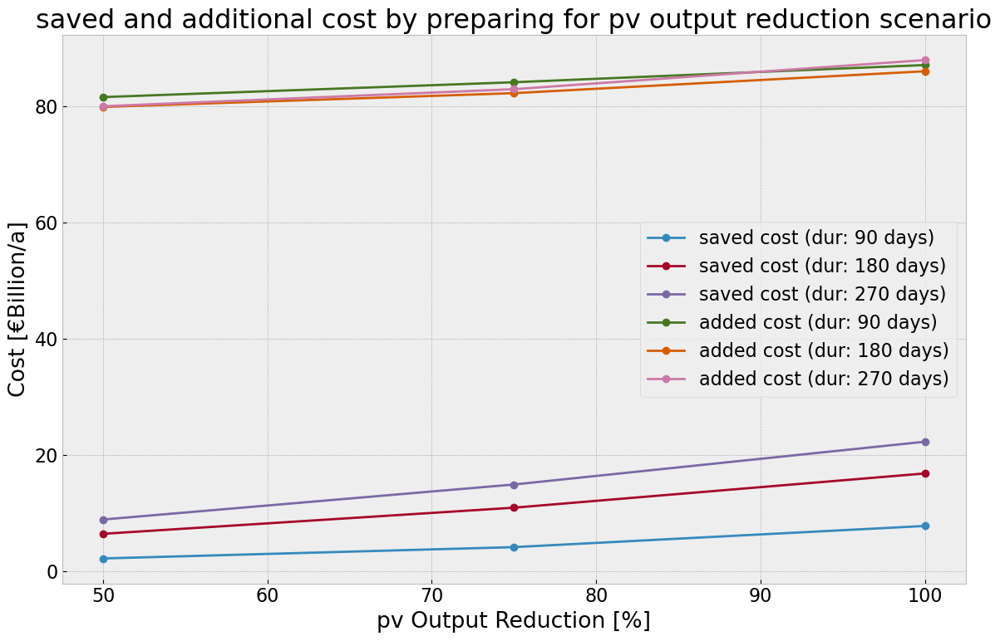

In [127]:
#rename index
cost_df = pd.concat([senscost_df, addcost_df], axis=1)

new_index = [(x - 1) * -100 for x in sens_reductionto]
cost_df.index = new_index


# Plot configuration
fig, ax = plt.subplots(figsize=(12, 8))

# Plot each column in the DataFrame
for column in cost_df.columns:
    ax.plot(cost_df.index, cost_df[column], marker='o', label=column)

# Add labels and legend
ax.set_xlabel(f'{contingency} Output Reduction [%]')
ax.set_ylabel('Cost [€Billion/a]')
ax.set_title(f'saved and additional cost by preparing for {contingency} output reduction scenario')
ax.legend()

# Show the plot
plt.xticks()  # Rotate x-axis labels if necessary
plt.tight_layout()  # Adjust layout to make room for labels

# Save plot to the current working directory
filename = f"sens_saved_cost.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)

plt.show()



### Built Generator & Storage Capacities

In [128]:
#create a country based generator capacity df for every investment models 
modname_iteration = []
red_iteration = []
dur_iteration = []

for red in sens_reductionto:
    for dur in sens_duration:
        #senscost_df[f'n_{red_sanitized}_{dur_sanitized}'] = [0]
        
        for mod in models:

            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))

            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_{mod}' 

            
            #model as variable
            model =  globals()[mod_name]

            if mod == 'inv_roll':
                #append modname list
                modname_iteration.append(f'n_{red_sanitized}_{dur_sanitized}_inv_roll')
                red_iteration.append(red)
                dur_iteration.append(dur)

                # cap table
                capacities = model.generators
                capacities['country'] = capacities['bus'].str[:2]
                capacities = capacities.groupby(['country', 'carrier']).p_nom_opt.sum()
                capacities.fillna(0, inplace=True)
                #print(capacities)
                globals()[f'{mod_name}_cap_country'] = (capacities.unstack()/1000).drop(columns=['load'],inplace=False)
                globals()[f'{mod_name}_cap_country'].fillna(0, inplace=True)

                #sto table
                storage = n.storage_units
                storage['country'] = storage['bus'].str[:2]

                globals()[f'{mod_name}_sto_country'] = (storage.groupby(['country','carrier']).p_nom_opt.sum().unstack()/1000) #GW
                globals()[f'{mod_name}_sto_country'].fillna(0, inplace=True)


                #create empty df for transmission
                trans_df = {
                    'Country' : cap_base_country.index,
                    'AC': np.zeros(len(cap_base_country.index)),
                    'DC': np.zeros(len(cap_base_country.index))
                }

                trans_df = pd.DataFrame(trans_df)
                trans_df.set_index('Country', inplace=True)
    
                #AC
                ac_df = model.lines
                ac_df['country'] = ac_df['bus0'].str[:2]
                ac_df = ac_df.groupby(['country', 'carrier']).s_nom_opt.sum()
                ac_df.fillna(0, inplace=True)
                ac_df = ac_df.unstack().div(1e3) #GVA
            
                #DC
                dc_df = model.links
                dc_df['country'] = dc_df['bus0'].str[:2]
                dc_df = dc_df.groupby(['country', 'carrier']).p_nom_opt.sum()
                dc_df.fillna(0, inplace=True)
                dc_df = dc_df.unstack().div(1e3) #GW

                #fill empty df with AC Cap
                for index, row in trans_df.iterrows():
                    if index in ac_df.index:
                        try:
                            trans_df.loc[index, 'AC'] = ac_df.loc[index, 'AC']
                        except KeyError: 
                            trans_df.loc[index, 'AC'] = 0

                #fill empty df with DC Cap
                for index, row in trans_df.iterrows():
                    if index in dc_df.index:
                        try:
                            trans_df.loc[index, 'DC'] = dc_df.loc[index, 'DC']
                        except KeyError: 
                            trans_df.loc[index, 'DC'] = 0


                #trans_df = pd.concat([ac_df, dc_df], axis=1)
                #trans_df.fillna(0, inplace=True)
                globals()[f'{mod_name}_trans'] = trans_df
                #globals()[f'{mod_name}_trans_country'] = trans_df
                

#### Bar Plot

In [129]:
# Define a color map using a color palette with 12 contrasting colors
colors = sns.color_palette("tab20", 13)  # 12 contrasting colors

# Mapping countries to colors
country_colors = {
    'AT': colors[0],
    'BE': colors[1],
    'CH': colors[2],
    'CZ': colors[3],
    'DE': colors[4],
    'DK': colors[5],
    'FR': colors[6],
    'GB': colors[7],
    'LU': colors[8],
    'NL': colors[9],
    'NO': colors[10],
    'PL': colors[11],
    'SE': colors[12]  # Reusing the first color for 'SE' to ensure there are 12 colors
}

In [130]:
extendables = ['OCGT', 'solar','onwind', 'offwind-dc', 'offwind-ac']

for e in extendables:

    e_sanitized = sanitize_variable_name(str(e))

    #Cap Sensitivity df
    globals()[f'sens_{e_sanitized}'] = {
        'Scenario' : ['Base'] + modname_iteration,
        'Days' : [0] + dur_iteration,
        'Reductionto' : [0] + red_iteration
    }

    globals()[f'{e_sanitized}_sens_df'] = pd.DataFrame(globals()[f'sens_{e_sanitized}'])

    #add column countries
    for country in cap_base_country.index:
        globals()[f'{e_sanitized}_sens_df'][country] = 0

    # Set the 'Scenario' column as the index
    globals()[f'{e_sanitized}_sens_df'].set_index('Scenario', inplace=True)
    
    # enter base capacitites
    for i in cap_base_country.index:
        globals()[f'{e_sanitized}_sens_df'].loc['Base', i] = cap_base_country.loc[i,e]

    #edit reduction to column in %
    for index, row in globals()[f'{e_sanitized}_sens_df'].iterrows():
                if index != 'Base':
                    new_red = (row['Reductionto']-1)* -100
                    globals()[f'{e_sanitized}_sens_df'].loc[index, 'Reductionto'] = new_red    

    for red in sens_reductionto:
        for dur in sens_duration:

            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))

            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_inv_roll' 

            #cap table as variable
            cap_df =  globals()[f'{mod_name}_cap_country']

            for index, row in globals()[f'{e_sanitized}_sens_df'].iterrows():
                if mod_name == index:
                    scen = index
                    for i in cap_base_country.index:
                        #condition = (cap_df['Scenario'] == mod_name)
                        #globals()[f'{e_sanitized}_sens_df'].loc[condition, i].values[0] = cap_df.loc[i,e]
                        #print(f'{scen}, {mod_name}, {index}, {i}')
                        globals()[f'{e_sanitized}_sens_df'].loc[index, i] = cap_df.loc[i, e]

    
    # Pivot the DataFrame to get the data in the right shape for stacking
    globals()[f'{e_sanitized}_pivot_df'] = globals()[f'{e_sanitized}_sens_df'].drop(columns = ['Days', 'Reductionto'])
    

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_17644\3181701580.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '2.8192' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  globals()[f'{e_sanitized}_sens_df'].loc['Base', i] = cap_base_country.loc[i,e]
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_17644\3181701580.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '4.5323' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  globals()[f'{e_sanitized}_sens_df'].loc['Base', i] = cap_base_country.loc[i,e]
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_17644\3181701580.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '1.765798178079722' has dtype incompatible with int64, 

In [131]:
extendables_plot = {'OCGT', 'solar', 'onwind', 'offwind'}
element_to_ax = {element: i for i, element in enumerate(extendables_plot)}

element_to_ax

{'onwind': 0, 'offwind': 1, 'solar': 2, 'OCGT': 3}

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_17644\2299092162.py:51: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_17644\2299092162.py:51: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_17644\2299092162.py:51: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_17644\2299092162.py:51: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=

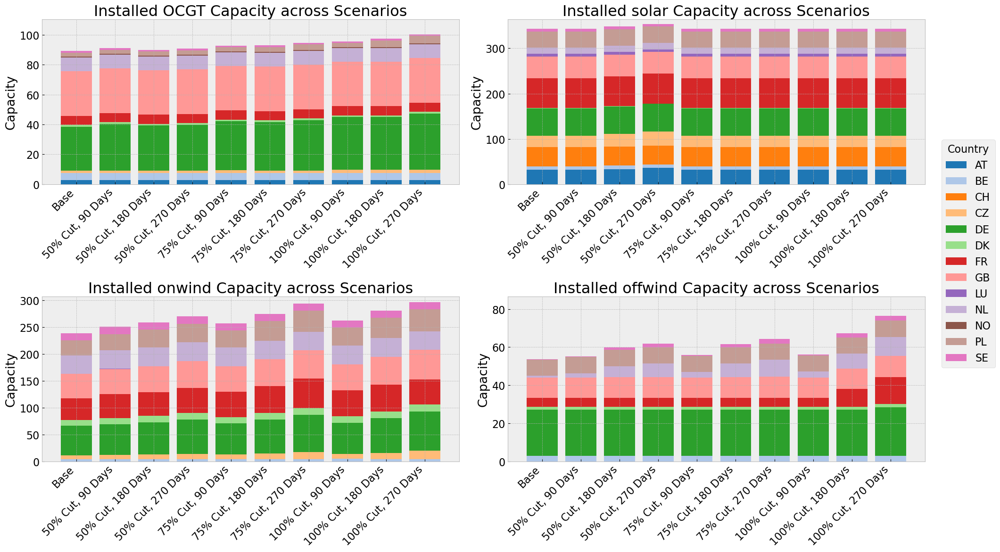

In [132]:
# combine offwind ac and dc
offwind_pivot_df = offwind_ac_pivot_df.select_dtypes(include='number') + offwind_dc_pivot_df.select_dtypes(include='number')
offwind_pivot_df

extendables_plot = ['OCGT', 'solar', 'onwind', 'offwind']

# Plotting with the legend outside and adjusting xticks
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(20,12))
axes = axes.flatten()

# Define a dictionary to map each element to a specific subplot
element_to_ax = {element: i for i, element in enumerate(extendables_plot)}

# Variable to store handles and labels for the legend
handles = []
labels = []

# Plotting each element in its corresponding subplot
for e, i in element_to_ax.items():

    ax = axes[i]
    # Plot the stacked bar chart with specified colors
    bottom = np.zeros(len(globals()[f'{e}_pivot_df']))
    for country in globals()[f'{e}_pivot_df'].columns:
        bars = ax.bar(globals()[f'{e}_pivot_df'].index, globals()[f'{e}_pivot_df'][country], label=country, color=country_colors[country], bottom=bottom)
        bottom += globals()[f'{e}_pivot_df'][country].values
    
    # Add labels, title
    ax.set_xlabel('')
    ax.set_ylabel('Capacity')
    ax.set_ylim([0, max(bottom)+10])
    ax.set_title(f'Installed {e} Capacity across Scenarios')

    # Move the legend outside the plot
    ax.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')

    # Adjust xticks so that labels are centered
    #ax.set_xticks(ax.get_xticks())

    # Set xticks
    scen_tick = []
    for index, row in offwind_ac_sens_df.iterrows():
        red = int(row['Reductionto'])
        dur = int(row['Days'])

        if red == 0 and dur == 0:
            scen_tick.append('Base')
        else:
            scen_tick.append(f'{red}% Cut, {dur} Days')    

    ax.set_xticklabels(scen_tick, rotation=45, ha='right')

    # Capture handles and labels for the legend
    handle, label = ax.get_legend_handles_labels()
    handles.extend(handle)
    labels.extend(label)
        
# Remove legend from individual subplots
for ax in axes:
    ax.legend().remove()

# Adjust layout to make room for the legend
plt.tight_layout()

# Create a single legend outside the plot
fig.legend(handles[:len(country_colors)], labels[:len(country_colors)], title='Country', bbox_to_anchor=(1, 0.75), loc='upper left')

# Save plot to the current working directory
filename = "sens_cap.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path, bbox_inches='tight')

plt.show()


### Built Storage Capacities

In [133]:
sto_type = n.storage_units.carrier.unique() 

for e in sto_type:

    #e_sanitized = sanitize_variable_name(str(e))

    #sto Sensitivity df
    globals()[f'sens_{e}'] = {
        'Scenario' : ['Base'] + modname_iteration,
        'Days' : [0] + dur_iteration,
        'Reductionto' : [0] + red_iteration
    }

    globals()[f'{e}_sens_df'] = pd.DataFrame(globals()[f'sens_{e}'])

    #add column countries
    for country in store_base_df.index:
        globals()[f'{e}_sens_df'][country] = 0

    # Set the 'Scenario' column as the index
    globals()[f'{e}_sens_df'].set_index('Scenario', inplace=True)
    
    # enter base capacitites
    for i in store_base_df.index:
        globals()[f'{e}_sens_df'].loc['Base', i] = store_base_df.loc[i,e]

    #edit reduction to column in %
    for index, row in globals()[f'{e}_sens_df'].iterrows():
                if index != 'Base':
                    new_red = (row['Reductionto']-1)* -100
                    globals()[f'{e}_sens_df'].loc[index, 'Reductionto'] = new_red    

    for red in sens_reductionto:
        for dur in sens_duration:

            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))

            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_inv_roll' 

            #cap table as variable
            sto_df =  globals()[f'{mod_name}_sto_country']

            for index, row in globals()[f'{e}_sens_df'].iterrows():
                if mod_name == index:
                    scen = index
                    for i in cap_base_country.index:
                        #condition = (cap_df['Scenario'] == mod_name)
                        #globals()[f'{e_sanitized}_sens_df'].loc[condition, i].values[0] = cap_df.loc[i,e]
                        #print(f'{scen}, {mod_name}, {index}, {i}')
                        globals()[f'{e}_sens_df'].loc[index, i] = sto_df.loc[i, e]

    
    # Pivot the DataFrame to get the data in the right shape for stacking
    globals()[f'{e}_pivot_df'] = globals()[f'{e}_sens_df'].drop(columns = ['Days', 'Reductionto'])

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_17644\278823690.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '5.057300000000001' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  globals()[f'{e}_sens_df'].loc['Base', i] = store_base_df.loc[i,e]
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_17644\278823690.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '1.308' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  globals()[f'{e}_sens_df'].loc['Base', i] = store_base_df.loc[i,e]
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_17644\278823690.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '5.089549999999999' has dtype incompatible with int64, please explicitly c

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_17644\4103942615.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_17644\4103942615.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_17644\4103942615.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_17644\4103942615.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=

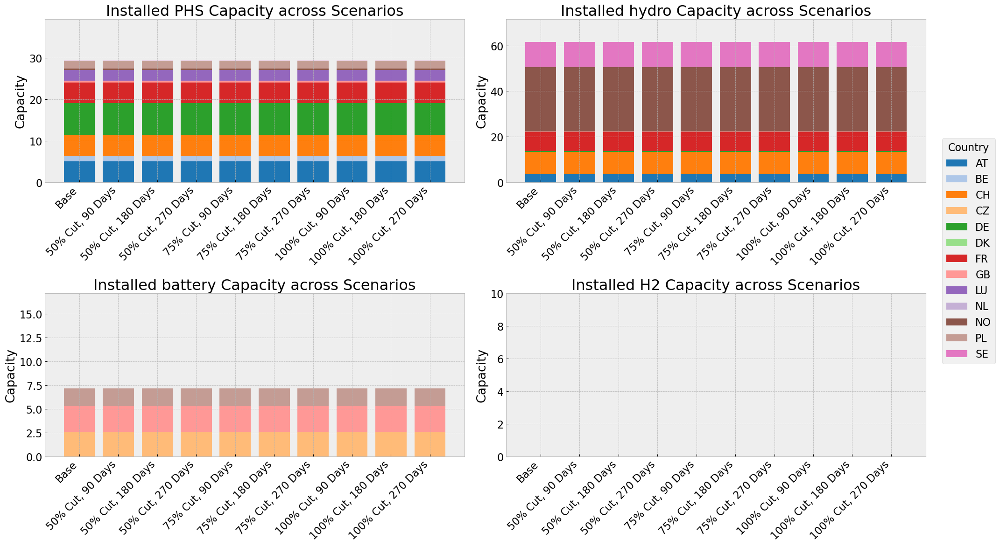

In [134]:
# Plotting with the legend outside and adjusting xticks
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(20,12))
axes = axes.flatten()

# Define a dictionary to map each element to a specific subplot
element_to_ax = {element: i for i, element in enumerate(sto_type)}

# Variable to store handles and labels for the legend
handles = []
labels = []

# Plotting each element in its corresponding subplot
for e, i in element_to_ax.items():

    ax = axes[i]
    # Plot the stacked bar chart with specified colors
    bottom = np.zeros(len(globals()[f'{e}_pivot_df']))
    for country in globals()[f'{e}_pivot_df'].columns:
        bars = ax.bar(globals()[f'{e}_pivot_df'].index, globals()[f'{e}_pivot_df'][country], label=country, color=country_colors[country], bottom=bottom)
        bottom += globals()[f'{e}_pivot_df'][country].values
    
    # Add labels, title
    ax.set_xlabel('')
    ax.set_ylabel('Capacity')
    ax.set_ylim([0, max(bottom)+10])
    ax.set_title(f'Installed {e} Capacity across Scenarios')

    # Move the legend outside the plot
    ax.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')

    # Adjust xticks so that labels are centered
    #ax.set_xticks(ax.get_xticks())

    # Set xticks
    scen_tick = []
    for index, row in offwind_ac_sens_df.iterrows():
        red = int(row['Reductionto'])
        dur = int(row['Days'])

        if red == 0 and dur == 0:
            scen_tick.append('Base')
        else:
            scen_tick.append(f'{red}% Cut, {dur} Days')    

    ax.set_xticklabels(scen_tick, rotation=45, ha='right')

    # Capture handles and labels for the legend
    handle, label = ax.get_legend_handles_labels()
    handles.extend(handle)
    labels.extend(label)
        
# Remove legend from individual subplots
for ax in axes:
    ax.legend().remove()

# Adjust layout to make room for the legend
plt.tight_layout()

# Create a single legend outside the plot
fig.legend(handles[:len(country_colors)], labels[:len(country_colors)], title='Country', bbox_to_anchor=(1, 0.75), loc='upper left')

# Save plot to the current working directory
filename = "sens_sto.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path, bbox_inches='tight')

plt.show()

### Transmission Cap

In [135]:
line_type = ['AC', 'DC']

for e in line_type:

    e_sanitized = sanitize_variable_name(str(e))

    #trans Sensitivity df
    globals()[f'trans_{e_sanitized}'] = {
        'Scenario' : ['Base'] + modname_iteration,
        'Days' : [0] + dur_iteration,
        'Reductionto' : [0] + red_iteration
    }

    globals()[f'{e_sanitized}_trans_df'] = pd.DataFrame(globals()[f'trans_{e_sanitized}'])

    #add column countries
    for country in cap_base_country.index:
        globals()[f'{e_sanitized}_trans_df'][country] = 0

    # Set the 'Scenario' column as the index
    globals()[f'{e_sanitized}_trans_df'].set_index('Scenario', inplace=True)
    
    # enter base capacitites
    for i in cap_base_country.index:
        globals()[f'{e_sanitized}_trans_df'].loc['Base', i] = trans_base_pv.loc[i,e]

    #edit reduction to column in %
    for index, row in globals()[f'{e_sanitized}_trans_df'].iterrows():
                if index != 'Base':
                    new_red = (row['Reductionto']-1)* -100
                    globals()[f'{e_sanitized}_trans_df'].loc[index, 'Reductionto'] = new_red    

    for red in sens_reductionto:
        for dur in sens_duration:

            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))

            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_inv_roll' 

            #cap table as variable
            cap_df =  globals()[f'{mod_name}_trans']

            for index, row in globals()[f'{e_sanitized}_trans_df'].iterrows():
                if mod_name == index:
                    scen = index
                    for i in cap_base_country.index:
                        #condition = (cap_df['Scenario'] == mod_name)
                        #globals()[f'{e_sanitized}_sens_df'].loc[condition, i].values[0] = cap_df.loc[i,e]
                        #print(f'{scen}, {mod_name}, {index}, {i}')
                        globals()[f'{e_sanitized}_trans_df'].loc[index, i] = cap_df.loc[i, e]

    
    # Pivot the DataFrame to get the data in the right shape for stacking
    globals()[f'{e_sanitized}_pivot_df'] = globals()[f'{e_sanitized}_trans_df'].drop(columns = ['Days', 'Reductionto'])

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_17644\1851231033.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '27.214328698683715' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  globals()[f'{e_sanitized}_trans_df'].loc['Base', i] = trans_base_pv.loc[i,e]
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_17644\1851231033.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '17.249147582416935' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  globals()[f'{e_sanitized}_trans_df'].loc['Base', i] = trans_base_pv.loc[i,e]
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_17644\1851231033.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '36.91138834993883' has dtype incom

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_17644\3519662137.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_17644\3519662137.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')


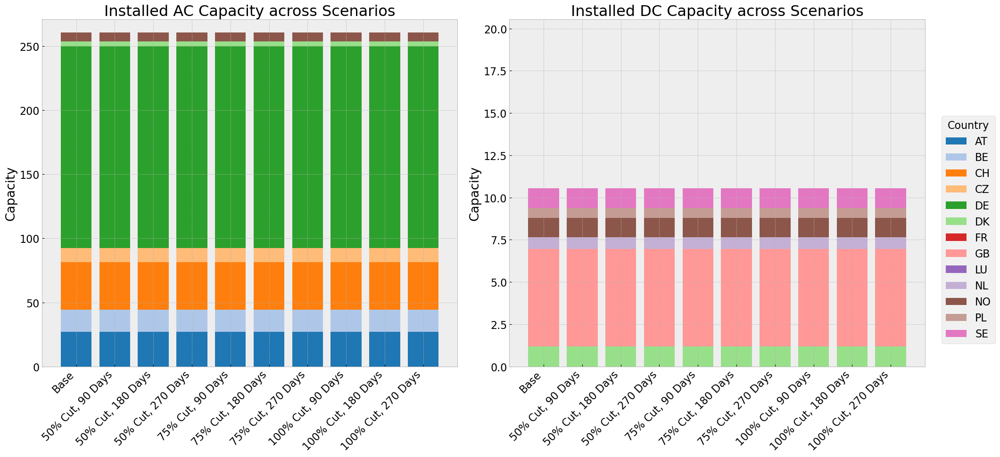

In [136]:
# Plotting with the legend outside and adjusting xticks
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(20,10))
axes = axes.flatten()

# Define a dictionary to map each element to a specific subplot
element_to_ax = {element: i for i, element in enumerate(line_type)}

# Variable to store handles and labels for the legend
handles = []
labels = []

# Plotting each element in its corresponding subplot
for e, i in element_to_ax.items():

    ax = axes[i]
    # Plot the stacked bar chart with specified colors
    bottom = np.zeros(len(globals()[f'{e}_pivot_df']))
    for country in globals()[f'{e}_pivot_df'].columns:
        bars = ax.bar(globals()[f'{e}_pivot_df'].index, globals()[f'{e}_pivot_df'][country], label=country, color=country_colors[country], bottom=bottom)
        bottom += globals()[f'{e}_pivot_df'][country].values
    
    # Add labels, title
    ax.set_xlabel('')
    ax.set_ylabel('Capacity')
    ax.set_ylim([0, max(bottom)+10])
    ax.set_title(f'Installed {e} Capacity across Scenarios')

    # Move the legend outside the plot
    ax.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')

    # Adjust xticks so that labels are centered
    #ax.set_xticks(ax.get_xticks())

    # Set xticks
    scen_tick = []
    for index, row in offwind_ac_sens_df.iterrows():
        red = int(row['Reductionto'])
        dur = int(row['Days'])

        if red == 0 and dur == 0:
            scen_tick.append('Base')
        else:
            scen_tick.append(f'{red}% Cut, {dur} Days')    

    ax.set_xticklabels(scen_tick, rotation=45, ha='right')

    # Capture handles and labels for the legend
    handle, label = ax.get_legend_handles_labels()
    handles.extend(handle)
    labels.extend(label)
        
# Remove legend from individual subplots
for ax in axes:
    ax.legend().remove()

# Adjust layout to make room for the legend
plt.tight_layout()

# Create a single legend outside the plot
fig.legend(handles[:len(country_colors)], labels[:len(country_colors)], title='Country', bbox_to_anchor=(1, 0.75), loc='upper left')

# Save plot to the current working directory
filename = "sens_sto.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path, bbox_inches='tight')

plt.show()